In [1]:
# import libraries
import numpy as np
import awkward as ak
import pandas as pd 
import os, h5py
import matplotlib.pyplot as plt
import matplotlib as mpl
import warnings
warnings.filterwarnings("ignore")
from scipy import stats
from jason import jason_plotting as plotting
mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('/Users/jasonwu/Programs/codes/def.mplstyle')
plotting.plot_prettier(dpi=400,usetex=False)
%matplotlib inline
import uproot

# Reading file

In [2]:
file = uproot.open("/Users/jasonwu/Programs/Fermilab/run_data/pfSamples_230803/pf/pf.piM_0p1_4GeV.10k.2part.3cm.root")

In [3]:
file.keys()

['LDMX_Events;9', 'LDMX_Events;8', 'LDMX_Run;1']

In [4]:
file['LDMX_Events'].keys()

['EventHeader',
 'EventHeader/eventNumber_',
 'EventHeader/run_',
 'EventHeader/timestamp_',
 'EventHeader/timestamp_/timestamp_.fSec',
 'EventHeader/timestamp_/timestamp_.fNanoSec',
 'EventHeader/weight_',
 'EventHeader/isRealData_',
 'EventHeader/intParameters_',
 'EventHeader/intParameters_/intParameters_.first',
 'EventHeader/intParameters_/intParameters_.second',
 'EventHeader/floatParameters_',
 'EventHeader/floatParameters_/floatParameters_.first',
 'EventHeader/floatParameters_/floatParameters_.second',
 'EventHeader/stringParameters_',
 'EventHeader/stringParameters_/stringParameters_.first',
 'EventHeader/stringParameters_/stringParameters_.second',
 'PFEcalClusters_pf',
 'PFEcalClusters_pf/PFEcalClusters_pf.hitIDs_',
 'PFEcalClusters_pf/PFEcalClusters_pf.energy_',
 'PFEcalClusters_pf/PFEcalClusters_pf.nHits_',
 'PFEcalClusters_pf/PFEcalClusters_pf.centroidX_',
 'PFEcalClusters_pf/PFEcalClusters_pf.centroidY_',
 'PFEcalClusters_pf/PFEcalClusters_pf.centroidZ_',
 'PFEcalCluste

In [5]:
ps = ['PFTruth_pf/PFTruth_pf.first',
 'PFTruth_pf/PFTruth_pf.second.energy_',
 'PFTruth_pf/PFTruth_pf.second.pdgID_',
 'PFTruth_pf/PFTruth_pf.second.genStatus_',
 'PFTruth_pf/PFTruth_pf.second.time_',
 'PFTruth_pf/PFTruth_pf.second.x_',
 'PFTruth_pf/PFTruth_pf.second.y_',
 'PFTruth_pf/PFTruth_pf.second.z_',
 'PFTruth_pf/PFTruth_pf.second.endX_',
 'PFTruth_pf/PFTruth_pf.second.endY_',
 'PFTruth_pf/PFTruth_pf.second.endZ_',
 'PFTruth_pf/PFTruth_pf.second.px_',
 'PFTruth_pf/PFTruth_pf.second.py_',
 'PFTruth_pf/PFTruth_pf.second.pz_',
 'PFTruth_pf/PFTruth_pf.second.endpx_',
 'PFTruth_pf/PFTruth_pf.second.endpy_',
 'PFTruth_pf/PFTruth_pf.second.endpz_',
 'PFTruth_pf/PFTruth_pf.second.mass_',
 'PFTruth_pf/PFTruth_pf.second.charge_',
 'PFTruth_pf/PFTruth_pf.second.daughters_',
 'PFTruth_pf/PFTruth_pf.second.parents_',
 'PFTruth_pf/PFTruth_pf.second.processType_',
 'PFTruth_pf/PFTruth_pf.second.vertexVolume_']
for p in ps:
    prop = file['LDMX_Events'][p].array(library='ak')
    print(p, ak.any(ak.ravel(prop)))

PFTruth_pf/PFTruth_pf.first True
PFTruth_pf/PFTruth_pf.second.energy_ True
PFTruth_pf/PFTruth_pf.second.pdgID_ True
PFTruth_pf/PFTruth_pf.second.genStatus_ True
PFTruth_pf/PFTruth_pf.second.time_ False
PFTruth_pf/PFTruth_pf.second.x_ True
PFTruth_pf/PFTruth_pf.second.y_ True
PFTruth_pf/PFTruth_pf.second.z_ False
PFTruth_pf/PFTruth_pf.second.endX_ True
PFTruth_pf/PFTruth_pf.second.endY_ True
PFTruth_pf/PFTruth_pf.second.endZ_ True
PFTruth_pf/PFTruth_pf.second.px_ True
PFTruth_pf/PFTruth_pf.second.py_ True
PFTruth_pf/PFTruth_pf.second.pz_ True
PFTruth_pf/PFTruth_pf.second.endpx_ True
PFTruth_pf/PFTruth_pf.second.endpy_ True
PFTruth_pf/PFTruth_pf.second.endpz_ True
PFTruth_pf/PFTruth_pf.second.mass_ True
PFTruth_pf/PFTruth_pf.second.charge_ True
PFTruth_pf/PFTruth_pf.second.daughters_ True
PFTruth_pf/PFTruth_pf.second.parents_ False
PFTruth_pf/PFTruth_pf.second.processType_ False
PFTruth_pf/PFTruth_pf.second.vertexVolume_ [True, True, True, True, True, True, True]


In [6]:
p = "PFEcalClusters_pf/PFEcalClusters_pf.energy_"
test_prop = file['LDMX_Events'][p].array(library='ak')
for prop in test_prop:
    print(len(prop), prop)

2 [588, 561]
1 [1.23e+03]
2 [747, 563]
2 [743, 698]
3 [363, 313, 184]
2 [642, 153]
2 [657, 124]
1 [1.31e+03]
2 [657, 632]
2 [635, 282]
3 [890, 268, 94.4]
1 [1.22e+03]
2 [741, 317]
2 [486, 434]
6 [1.52e+03, 686, 344, 92.9, 53.2, 20.7]
2 [766, 603]
3 [679, 322, 56.2]
3 [763, 717, 10.6]
3 [661, 350, 230]
2 [876, 544]
2 [801, 672]
2 [1.43e+03, 15]
4 [342, 255, 155, 92.2]
2 [400, 14.2]
2 [742, 375]
2 [754, 616]
3 [345, 163, 94]
2 [1.05e+03, 709]
3 [451, 232, 161]
2 [327, 224]
3 [286, 269, 233]
2 [731, 544]
2 [654, 515]
4 [2.82e+03, 184, 24.3, 15.1]
3 [598, 482, 68.9]
2 [885, 363]
2 [750, 291]
2 [584, 196]
3 [715, 207, 30]
2 [715, 566]
2 [617, 499]
3 [548, 195, 155]
3 [556, 157, 116]
2 [561, 467]
2 [1.72e+03, 907]
2 [606, 606]
3 [542, 121, 20.1]
2 [762, 485]
2 [506, 63.3]
2 [589, 10.1]
2 [612, 311]
2 [603, 313]
5 [512, 196, 110, 37.8, 30.2]
3 [911, 544, 183]
2 [619, 611]
2 [638, 573]
3 [572, 509, 246]
2 [782, 662]
2 [611, 49.2]
3 [324, 283, 184]
3 [701, 272, 259]
3 [702, 549, 76.9]
4 [945, 2

In [7]:
mask = ak.argmax(test_prop, axis=1, keepdims=True, mask_identity=True)
mask

<Array [[0], [0], [0], [0], ..., [0], [0], [0], [0]] type='10000 * 1 * ?int64'>

In [8]:
p = "PFEcalClusters_pf/PFEcalClusters_pf.centroidX_"
test_prop_ = file['LDMX_Events'][p].array(library='ak')
test_prop_[ak.from_regular(mask)]

<Array [[169], [-66.8], ..., [-130], [-63]] type='10000 * var * ?float64'>

## Systematically reading the file

In [9]:
def get_data(file_name = 'pf.ele_0p1_4GeV.10k.2part.3cm.root',
             root_trial = 'pfSamples_230720',
             root_dir = '/Users/jasonwu/Programs/Fermilab/run_data',
             # the branches to include in the output
             included_branches = ['PFEcalClusters_pf', 'PFHcalClusters_pf', 'PFTracks_pf', 'PFCandidates_pf', 'PFTruth_pf', 'PFTruthTarget_pf', 'PFTruthEcal_pf', 'PFTruthHcal_pf'],
             # the branches to save directly
             saved_branches = ['EcalTotalEnergy_pf', 'HcalTotalEnergy_pf', 'PFTruth_pf/PFTruth_pf.second.vertexVolume_'],
             # if True, generates leading cluster properties
             lead_clust = False,
             # the branches to do leading cluster on
             lead_clust_branches = ['PFEcalClusters_pf', 'PFHcalClusters_pf'],
             lead_clust_override = False,
             # if True, prints type and number of points in each property
             verbose = False):
    file = uproot.open(f'{root_dir}/{root_trial}/pf/{file_name}')
    events = file['LDMX_Events']
    # all the keys in events
    keys = np.array(events.keys())
    save_mask = np.array([1 if (branch in saved_branches) else 0 for branch in keys]).astype(bool)
    keys = np.delete(keys, save_mask)
    # branches
    branch_mask = np.array([0 if ('/' in branch) else 1 for branch in keys]).astype(bool)
    branches = keys[branch_mask]
    branch_ind = np.append(np.where(branch_mask == 1)[0], -1)
                 
    if lead_clust_override:
        suffix_new = ''
        suffix_og = '_og'
    else:
        suffix_new = '_lc'
        suffix_og = ''
                 
    prop_dict = {}


    # save the branches directly
    for branch in saved_branches:  # check if within directly saved branch
        if verbose: print(f'{branch} is saved directly')
        saved_prop = np.array(events[branch])
        prop_dict[branch.replace('_pf', '')] = saved_prop
        
    for i in range(len(branches)):
        branch = branches[i]
        if branch in included_branches:  # check if within included branch
            if verbose: print(f'{branch} is included')
            # get all the nodes of the branch
            branch_nodes = keys[branch_ind[i]+1:] if branch_ind[i+1] == -1 else keys[branch_ind[i]+1 : branch_ind[i+1]]
            if verbose: print(branch_nodes)

            # get the energy indices for leading cluster anlaysis
            if lead_clust and (branch in lead_clust_branches):
                energy_node = f'{branch}/{branch}.energy_'  # string of the energy node
                # the awkward array corresponding to energy
                energy_prop = events[energy_node].array(library='ak')
                energy_prop = ak.values_astype(energy_prop, np.float64)
                # the indices corresponding to maximum energy (in case unsorted)
                max_ind = ak.argmax(energy_prop, axis=1, keepdims=True, mask_identity=True)
                
            # for each node in the branch
            for branch_node in branch_nodes:
                # make the awkward array
                prop = events[branch_node].array(library='ak')
                # pad the array with at least one entry
                prop = ak.pad_none(prop, 1, axis=1)

                # check if consisting of empty arrays
                if len(ak.ravel(prop)) == 0 or not ak.any(ak.ravel(prop)):  # effectively empty
                    # flatten the array into zeros
                    if verbose: print(f'Empty array at {branch_node}, reduced to zeroes')
                    prop_flat = np.zeros(len(prop))
                    if verbose: print(prop_flat.shape)

                    prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_')] = prop_flat
                elif len(ak.ravel(prop)) == len(prop):  # effectively one-dimensional
                    if verbose: print(f'One-dimensional array at {branch_node}, reduced to numpy')
                    prop_flat = ak.to_numpy(ak.ravel(prop), allow_missing=True).astype(float).filled(np.nan)
                    if verbose: print(prop_flat.shape)

                    prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_')] = prop_flat
                else:
                    # if the array is truly jagged
                    if verbose: print(f'Jagged/partially empty array at {branch_node}')
                    prop_flat = prop
                    if verbose: print(prop_flat.type)

                    # construct a leading cluster array
                    if lead_clust and (branch in lead_clust_branches):
                        # mask the array with max energy indices
                        max_prop = prop_flat[ak.from_regular(max_ind)]
                        # flatten, convert to numpy array, and fill with nan
                        # handles hit info
                        if 'hit' in branch_node:
                            # unravel max_prop
                            max_prop = ak.Array([np.array(_[0]) for _ in max_prop])
                            prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_') + suffix_new] = max_prop  # take out into lc data
                            prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_') + suffix_og] = prop_flat
                        else:
                            max_prop_flat = ak.to_numpy(ak.ravel(max_prop), allow_missing=True).astype(float)
                            max_prop_flat = max_prop_flat.filled(np.nan)
                            prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_') + suffix_new] = max_prop_flat  # lc data
                            prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_') + suffix_og] = prop_flat
                    else:  # no leading cluster array
                        prop_dict[branch_node.split('/')[1].replace('_pf', '')[:-1].replace('.', '_')] = prop_flat

        else:
            if verbose: print(f'{branch} is not included')
    return prop_dict

In [11]:
root_trial = 'pfSamples_230803'
test_part = get_data(file_name='pf.ele_0p1_1GeV.10k.2part.3cm.root', root_trial=root_trial,
                     lead_clust=True, lead_clust_branches=['PFEcalClusters_pf'], lead_clust_override=False)
list(test_part.keys())

['EcalTotalEnergy',
 'HcalTotalEnergy',
 'PFTruth/PFTruth.second.vertexVolume_',
 'PFEcalClusters_hitIDs',
 'PFEcalClusters_energy_lc',
 'PFEcalClusters_energy',
 'PFEcalClusters_nHits_lc',
 'PFEcalClusters_nHits',
 'PFEcalClusters_centroidX_lc',
 'PFEcalClusters_centroidX',
 'PFEcalClusters_centroidY_lc',
 'PFEcalClusters_centroidY',
 'PFEcalClusters_centroidZ_lc',
 'PFEcalClusters_centroidZ',
 'PFEcalClusters_rmsX_lc',
 'PFEcalClusters_rmsX',
 'PFEcalClusters_rmsY_lc',
 'PFEcalClusters_rmsY',
 'PFEcalClusters_rmsZ_lc',
 'PFEcalClusters_rmsZ',
 'PFEcalClusters_DXDZ_lc',
 'PFEcalClusters_DXDZ',
 'PFEcalClusters_DYDZ_lc',
 'PFEcalClusters_DYDZ',
 'PFEcalClusters_errDXDZ_lc',
 'PFEcalClusters_errDXDZ',
 'PFEcalClusters_errDYDZ_lc',
 'PFEcalClusters_errDYDZ',
 'PFEcalClusters_hitX_lc',
 'PFEcalClusters_hitX',
 'PFEcalClusters_hitY_lc',
 'PFEcalClusters_hitY',
 'PFEcalClusters_hitZ_lc',
 'PFEcalClusters_hitZ',
 'PFEcalClusters_hitE_lc',
 'PFEcalClusters_hitE',
 'PFHcalClusters_hitIDs',
 'P

In [12]:
np.hypot(test_part['PFTruthEcal_x'], test_part['PFTruthEcal_y']) 
np.sum(ak.all(np.hypot(test_part['PFTruthEcal_x'], test_part['PFTruthEcal_y']) < 200, axis=1))

9229

# Load Particles

In [13]:
labels_keys = 'electrons neutrons photons pions protons electrons_hcal neutrons_hcal photons_hcal pions_hcal protons_hcal'.split(' ')
labels_values = [
    r'Electrons $e^{\minus}$',
    r'Neutrons $n^{o}$',
    r'Photons $\gamma$',
    r'Pions $\pi^{\minus}$',
    r'Protons $p^{\plus}$',
    r'Electrons $e^{\minus}$ HCal',
    r'Neutrons $n^{o}$ HCal',
    r'Photons $\gamma$ HCal',
    r'Pions $\pi^{\minus}$ HCal',
    r'Protons $p^{\plus}$ HCal'
]

labels_dict = {labels_keys[i]: labels_values[i] for i in range(len(labels_keys))}

## Particles Class

In [15]:
# initiate a particle class
class Particles():
    def __init__(self, prop_dict, inc_radius=None):
        # a list of properties
        self.propdict = prop_dict
        if inc_radius:
            self._clean_props(inc_radius=inc_radius)
    
    # clean the data set
    def _clean_props(self, inc_radius=200):
        # inclusion mask for the criteria radius
        x = self.get('PFTruthEcal_x')  # x and y positions in the ecal face
        y = self.get('PFTruthEcal_y')
        inc_mask = ak.all(np.abs(np.hypot(x, y)) < inc_radius, axis=1)  # include all within the radius

        # valid particles mask: two particles
        val_mask = [True if len(_)==2 else False for _ in x]
        
        for prop in list(self.propdict.keys()):
            # select with criteria
            self.propdict[prop] = self.propdict[prop][np.logical_and(inc_mask, val_mask)]
                
        print('\n')

        # also replace dictionary labels
        self.propdict['PFCandidates_ecalCalEnergy'] = self.propdict.pop('PFCandidates_ecalEnergy')
        self.propdict['PFCandidates_ecalEnergy'] = self.propdict.pop('PFCandidates_ecalRawEnergy')
        self.propdict['PFCandidates_hcalCalEnergy'] = self.propdict.pop('PFCandidates_hcalEnergy')
        self.propdict['PFCandidates_hcalEnergy'] = self.propdict.pop('PFCandidates_hcalRawEnergy')
    
    # return a property
    def get(self, prop = None):
        if prop is not None:  # if specific property(ies) are given
            if isinstance(prop, list):
                prop_list = []
                for single_prop in prop:
                    prop_list.append(self.propdict[single_prop])
                return prop_list
            else:
                assert prop in list(self.propdict.keys())
                return self.propdict[prop]
        else:
            return self.propdict
    
    # account for mass of particle
    def acc_mass(self, mass, columns=[]):
        # subtract mass
        for column in columns:
            # clipped to zero
            # therefore, 0 -> 0, mass + energy -> energy
            self.propdict[column] = np.clip(self.propdict[column] - mass, 0, None)
    
    # return a list of all properties
    def list_props(self):        
        print(f'{"Property Name":<30}{"Number of Entries":<20}{"Unique Entries":<20}{"Range":<30}{"Mean"}')
        
        for prop in list(self.propdict.keys()):
            print(f'{prop: <30}{len(self.propdict[prop]):<20}{len(np.unique(self.propdict[prop])):<8}\
            {np.nanmin(self.propdict[prop]):<10.2f}{np.nanmax(self.propdict[prop]):>8.2f}\
            {np.nanmean(self.propdict[prop]):<.2f}')
        print('\n')
        return list(self.propdict.keys())
    
    # apply a correction to the ecal and hcal energy measurements
    def o1corr_energy(self, verbose=True, scheme='nearest',  # three schemes 'none', 'nearest' and 'spline'
                      energy_bins_ecal=[0, 6e3], o1corr_ecal=[1],
                      energy_bins_hcal=[0, 6e3], o1corr_hcal=[1],
                      ecal_label='EcalTotalEnergy', hcal_label='HcalTotalEnergy',  #ecal_label='PFCandidates_ecalEnergy', hcal_label='PFCandidates_hcalEnergy',
                      numbins=20, gev=True, label=labels_dict['photons']):
        # correct the energies
        match scheme:  # different schemes to handle values outside of measured bins
            case 'none':  # set to NaN, breaks plots
                # ecal
                o1corr_ecal = pd.cut(self.get(ecal_label), bins=energy_bins_ecal,
                                     include_lowest=True, labels=o1corr_ecal).to_numpy()
                # hcal
                o1corr_hcal = pd.cut(self.get(hcal_label), bins=energy_bins_hcal,
                                     include_lowest=True, labels=o1corr_hcal).to_numpy()
            case 'nearest':  # sets to value of nearest bin
                def nearest_cut(data, bins=[0, 6e3], labels=[1]):
                    # assigns labels to data based on bins
                    label_ind = np.digitize(data, bins=bins, right=True)
                    # contains 0 and len(labels)
                    label_ind[label_ind == 0] = 1  # label_ind will start at 1
                    label_ind[label_ind == len(bins)] = len(labels)  # set to maximum ind
                    return labels[label_ind - 1]
                # ecal
                o1corr_ecal = nearest_cut(self.get(ecal_label), bins=energy_bins_ecal, labels=o1corr_ecal)
                # hcal
                o1corr_hcal = nearest_cut(self.get(hcal_label), bins=energy_bins_hcal, labels=o1corr_hcal)
            case 'spline':
                def spline_cut(data, bins=[0, 6e3], labels=[1]):
                    # construct spline object for bin centers
                    bin_centers = [(a + b) / 2 for a, b in zip(bins[::], bins[1::])] # average of two consecutive elements in bins
                    # calculate splined values for data
                    splined_coeff, _ = plotting.spline_xy(bin_centers, labels, data)
                    return splined_coeff
                    
                # ecal
                o1corr_ecal = spline_cut(self.get(ecal_label), bins=energy_bins_ecal, labels=o1corr_ecal)
                # hcal
                o1corr_hcal = spline_cut(self.get(hcal_label), bins=energy_bins_hcal, labels=o1corr_hcal)
                
        energy_o1corr_ecal = self.get(ecal_label) * o1corr_ecal
        energy_o1corr_hcal = self.get(hcal_label) * o1corr_hcal
        
        
        # total
        energy_o1corr_total = energy_o1corr_ecal + energy_o1corr_hcal
        
        # set the dictionary entries
        self.propdict['PFCandidates_ecalEnergy_o1corr'] = energy_o1corr_ecal
        self.propdict['PFCandidates_hcalEnergy_o1corr'] = energy_o1corr_hcal
        self.propdict['PFCandidates_energy_o1corr'] = energy_o1corr_total
        
        # O(1) correction comparison plot with both energies
        if verbose:
            fig, ax = plt.subplots(figsize=(5, 3), dpi=200)
            # set the truth energy depending on the type of particle simulation
            if (label is not None) and \
               ('HCal' in label):
                # if the particle went through both ecal and hcal
                print('HCal energy set to truth')
                energy_truth_total = self.get('PFTruthHcal_energy')  # the pre-hcal energy is set to truth
            else:
                print('Target energy set to truth')
                energy_truth_total = self.get('PFTruthTarget_energy')  # the pre-target energy is set to truth

            if gev:  # plot x axis in gev instead
                plt.xlim([0, 4])
                plt.xlabel('Truth Total Energy [GeV]')
                x = energy_truth_total/1e3
                textx = 3.5
            else:  # plot x axis in mev
                plt.xlim([0, 4000])
                plt.xlabel('Truth Total Energy [MeV]')
                x = energy_truth_total
                textx = 3500
            y1 = self.get('PFCandidates_energy')/energy_truth_total  # measured ratio
            y2 = energy_o1corr_total/energy_truth_total  # reconstructed ratio
            _ = plotting.percentile(x, y1, numbins=numbins, style=style,
                                    color='red', label='Measured', textpos=[textx, 1.5])
            _ = plotting.percentile(x, y2, numbins=numbins, style=style,
                                    color='blue', label='$\mathcal{O}(1)$ Reconstructed')
            plt.ylabel('Reconstructed / Truth Total Energy', fontsize=10)
            plt.legend(loc='upper right')
            plt.ylim([0, 2])
            plt.annotate(text=label, xy=(-50, -30), xycoords='axes points', fontsize=7, weight='bold')

        return energy_o1corr_ecal, energy_o1corr_hcal, energy_o1corr_total

In [16]:
import os

# all branches
included_branches = ['PFEcalClusters_pf', 'PFHcalClusters_pf', 'PFTracks_pf', 'PFCandidates_pf', 'PFTruthTarget_pf', 'PFTruthEcal_pf', 'PFTruthHcal_pf']
root_dir = '/Users/jasonwu/Programs/Fermilab/run_data'
root_trial = 'pfSamples_230803'

fname_list = np.sort(os.listdir(f'{root_dir}/{root_trial}/pf'))

fname_list_3cm, fname_list_5cm, fname_list_7cm, fname_list_10cm, fname_list_15cm, fname_list_20cm = [], [], [], [], [], []
for fname in fname_list:
    if '20cm' in fname:
        fname_list_20cm.append(fname)
    elif '15cm' in fname:
        fname_list_15cm.append(fname)
    elif '10cm' in fname:
        fname_list_10cm.append(fname)
    elif '7cm' in fname:
        fname_list_7cm.append(fname)
    elif '5cm' in fname:
        fname_list_5cm.append(fname)
    elif '3cm' in fname:
        fname_list_3cm.append(fname)
    else:
        print(f'{fname} is skipped')
fname_list_3cm, fname_list_5cm, fname_list_7cm, fname_list_10cm, fname_list_15cm, fname_list_20cm

.DS_Store is skipped


(['pf.ele_0p1_1GeV.10k.2part.3cm.root',
  'pf.neu_0p1_4GeV.10k.2part.3cm.root',
  'pf.pho_0p1_4GeV.10k.2part.3cm.root',
  'pf.piM_0p1_4GeV.10k.2part.3cm.root',
  'pf.pro_0p1_1GeV.10k.2part.3cm.root'],
 ['pf.ele_0p1_1GeV.10k.2part.5cm.root',
  'pf.neu_0p1_4GeV.10k.2part.5cm.root',
  'pf.pho_0p1_4GeV.10k.2part.5cm.root',
  'pf.piM_0p1_4GeV.10k.2part.5cm.root',
  'pf.pro_0p1_1GeV.10k.2part.5cm.root'],
 ['pf.ele_0p1_1GeV.10k.2part.7cm.root',
  'pf.neu_0p1_4GeV.10k.2part.7cm.root',
  'pf.pho_0p1_4GeV.10k.2part.7cm.root',
  'pf.piM_0p1_4GeV.10k.2part.7cm.root',
  'pf.pro_0p1_1GeV.10k.2part.7cm.root'],
 ['pf.ele_0p1_1GeV.10k.2part.10cm.root',
  'pf.neu_0p1_4GeV.10k.2part.10cm.root',
  'pf.pho_0p1_4GeV.10k.2part.10cm.root',
  'pf.piM_0p1_4GeV.10k.2part.10cm.root',
  'pf.pro_0p1_1GeV.10k.2part.10cm.root'],
 ['pf.ele_0p1_1GeV.10k.2part.15cm.root',
  'pf.neu_0p1_4GeV.10k.2part.15cm.root',
  'pf.pho_0p1_4GeV.10k.2part.15cm.root',
  'pf.piM_0p1_4GeV.10k.2part.15cm.root',
  'pf.pro_0p1_1GeV.10k.2par

In [17]:
# ECal + HCal particles
particles_dict_3cm = {
    'electrons': None,
    'neutrons': None,
    'photons': None,
    'pions': None,
    'protons': None
}
particles_dict_5cm = particles_dict_3cm.copy()
particles_dict_7cm = particles_dict_3cm.copy()
particles_dict_10cm = particles_dict_5cm.copy()
particles_dict_15cm = particles_dict_5cm.copy()
particles_dict_20cm = particles_dict_3cm.copy()

In [18]:
# load the particles
root_dir = '/Users/jasonwu/Programs/Fermilab/run_data'
root_trial = 'pfSamples_230803'
# all branches
included_branches = ['PFEcalClusters_pf', 'PFHcalClusters_pf', 'PFTracks_pf', 'PFCandidates_pf', 'PFTruth_pf', 'PFTruthTarget_pf', 'PFTruthEcal_pf', 'PFTruthHcal_pf']
target_ecal_ind = ['PFTruthTarget_energy', 'PFTruthEcal_energy']

particles_name_list = 'electrons neutrons photons pions protons'.split(' ')
for i, part_name in enumerate(particles_name_list):
    # set particle
    print(f'Setting for 3cm {fname_list_3cm[i]}')
    particles_dict_3cm[part_name] = Particles(get_data(file_name=fname_list_3cm[i], root_trial=root_trial,
                                                       included_branches=included_branches,
                                                       lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                       lead_clust_override=False), inc_radius=200)
    print(f'Setting for 5cm {fname_list_5cm[i]}')
    particles_dict_5cm[part_name] = Particles(get_data(file_name=fname_list_5cm[i], root_trial=root_trial,
                                                       included_branches=included_branches,
                                                       lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                       lead_clust_override=False), inc_radius=200)
    print(f'Setting for 7cm {fname_list_7cm[i]}')
    particles_dict_7cm[part_name] = Particles(get_data(file_name=fname_list_7cm[i], root_trial=root_trial,
                                                       included_branches=included_branches,
                                                       lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                       lead_clust_override=False), inc_radius=200)
    print(f'Setting for 10cm {fname_list_10cm[i]}')
    particles_dict_10cm[part_name] = Particles(get_data(file_name=fname_list_10cm[i], root_trial=root_trial,
                                                        included_branches=included_branches,
                                                        lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                        lead_clust_override=False), inc_radius=200)
    print(f'Setting for 15cm {fname_list_5cm[i]}')
    particles_dict_15cm[part_name] = Particles(get_data(file_name=fname_list_15cm[i], root_trial=root_trial,
                                                       included_branches=included_branches,
                                                       lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                       lead_clust_override=False), inc_radius=200)
    print(f'Setting for 20cm {fname_list_20cm[i]}')
    particles_dict_20cm[part_name] = Particles(get_data(file_name=fname_list_20cm[i], root_trial=root_trial,
                                                        included_branches=included_branches,
                                                        lead_clust=True, lead_clust_branches=['PFEcalClusters_pf', 'PFHcalClusters_pf'],
                                                        lead_clust_override=False), inc_radius=200)

Setting for 3cm pf.ele_0p1_1GeV.10k.2part.3cm.root


Setting for 5cm pf.ele_0p1_1GeV.10k.2part.5cm.root


Setting for 7cm pf.ele_0p1_1GeV.10k.2part.7cm.root


Setting for 10cm pf.ele_0p1_1GeV.10k.2part.10cm.root


Setting for 15cm pf.ele_0p1_1GeV.10k.2part.5cm.root


Setting for 20cm pf.ele_0p1_1GeV.10k.2part.20cm.root


Setting for 3cm pf.neu_0p1_4GeV.10k.2part.3cm.root


Setting for 5cm pf.neu_0p1_4GeV.10k.2part.5cm.root


Setting for 7cm pf.neu_0p1_4GeV.10k.2part.7cm.root


Setting for 10cm pf.neu_0p1_4GeV.10k.2part.10cm.root


Setting for 15cm pf.neu_0p1_4GeV.10k.2part.5cm.root


Setting for 20cm pf.neu_0p1_4GeV.10k.2part.20cm.root


Setting for 3cm pf.pho_0p1_4GeV.10k.2part.3cm.root


Setting for 5cm pf.pho_0p1_4GeV.10k.2part.5cm.root


Setting for 7cm pf.pho_0p1_4GeV.10k.2part.7cm.root


Setting for 10cm pf.pho_0p1_4GeV.10k.2part.10cm.root


Setting for 15cm pf.pho_0p1_4GeV.10k.2part.5cm.root


Setting for 20cm pf.pho_0p1_4GeV.10k.2part.20cm.root


Setting for 3cm pf.piM_0p1_4GeV

# Energy Correction

In [19]:
particles_name_list = 'electrons neutrons photons pions protons'.split(' ')

In [20]:
ele_energy_bins_ecal = np.array([0., 500., 1000., 1500., 2000., 2500., 3000., 3500., 4000., 4500., 5000., 5500., 6000.])
avg_o1corr_ecal = np.array([1.18987852, 1.02952459, 0.99478492, 0.98629969, 0.98273146, 0.9760755 , 0.96378225, 0.93880792, 0.87393644, 0.80097519, 0.72741938, 0.66352241])
ext_bins_hcal = np.array([0., 50., 100., 150., 200., 250., 300., 350., 400., 450., 500., 550., 600., 650.]) * 10
pe_o1corr_hcal = np.array([8.4280355 ,  7.37783051,  7.75777364,  8.53401804,  9.46895409, 10.44644213, 10.46670198,  9.70749855,  8.87022924,  8.25057888, 8.25057888,  8.25057888,  8.25057888])

In [21]:
scheme = 'spline'
style = 1

In [22]:
particles_dicts_list = [
    particles_dict_3cm,
    particles_dict_5cm,
    particles_dict_7cm,
    particles_dict_10cm,
    particles_dict_15cm,
    particles_dict_20cm
]

for particles in particles_name_list:
    particles_dict_3cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                  energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                  verbose=False)
    particles_dict_5cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                  energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                  verbose=False)
    particles_dict_7cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                  energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                  verbose=False)
    particles_dict_10cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                   energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                   verbose=False)
    particles_dict_15cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                   energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                   verbose=False)
    particles_dict_20cm[particles].o1corr_energy(energy_bins_ecal=ele_energy_bins_ecal, o1corr_ecal=avg_o1corr_ecal,
                                   energy_bins_hcal=ext_bins_hcal, o1corr_hcal=pe_o1corr_hcal,
                                   verbose=False)

In [87]:
list(particles_dict_20cm['electrons'].propdict.keys())

['EcalTotalEnergy',
 'HcalTotalEnergy',
 'PFTruth/PFTruth.second.vertexVolume_',
 'PFEcalClusters_hitIDs',
 'PFEcalClusters_energy_lc',
 'PFEcalClusters_energy',
 'PFEcalClusters_nHits_lc',
 'PFEcalClusters_nHits',
 'PFEcalClusters_centroidX_lc',
 'PFEcalClusters_centroidX',
 'PFEcalClusters_centroidY_lc',
 'PFEcalClusters_centroidY',
 'PFEcalClusters_centroidZ_lc',
 'PFEcalClusters_centroidZ',
 'PFEcalClusters_rmsX_lc',
 'PFEcalClusters_rmsX',
 'PFEcalClusters_rmsY_lc',
 'PFEcalClusters_rmsY',
 'PFEcalClusters_rmsZ_lc',
 'PFEcalClusters_rmsZ',
 'PFEcalClusters_DXDZ_lc',
 'PFEcalClusters_DXDZ',
 'PFEcalClusters_DYDZ_lc',
 'PFEcalClusters_DYDZ',
 'PFEcalClusters_errDXDZ_lc',
 'PFEcalClusters_errDXDZ',
 'PFEcalClusters_errDYDZ_lc',
 'PFEcalClusters_errDYDZ',
 'PFEcalClusters_hitX_lc',
 'PFEcalClusters_hitX',
 'PFEcalClusters_hitY_lc',
 'PFEcalClusters_hitY',
 'PFEcalClusters_hitZ_lc',
 'PFEcalClusters_hitZ',
 'PFEcalClusters_hitE_lc',
 'PFEcalClusters_hitE',
 'PFHcalClusters_hitIDs',
 'P

In [102]:
np.median(particles_dict_20cm['photons'].get('PFCandidates_ecalEnergy_o1corr'))

3633.204328400303

# Count Statistics

In [23]:
def calc_stats(particles_dict=particles_dict_5cm, good_thres=5):
    for particles in particles_name_list:
        # energy bins
        from matplotlib import cm
    
        # cluster count
        hits_count = {}
        clusters_count = []  # all clusters count
        good_clusters_count = []  # good cluster count
        for clusters_nhits in particles_dict[particles].get('PFEcalClusters_nHits'):
            if np.any(clusters_nhits):
                num_clusters = len(clusters_nhits)
                num_good_clusters = np.sum(clusters_nhits >= good_thres)
                good_clusters_count.append(num_good_clusters)
                clusters_count.append(num_clusters)
                try:
                    hits_count[num_clusters] = np.hstack([hits_count[num_clusters], clusters_nhits])
                except KeyError:
                    hits_count[num_clusters] = []
            else:
                good_clusters_count.append(0)  # no clusters
                clusters_count.append(0)
        # number of clusters
        particles_dict[particles].propdict['PFEcalClusters_hits_count'] = hits_count
        print(list(particles_dict[particles].get('PFEcalClusters_hits_count').keys()))
        # all clusters
        particles_dict[particles].propdict['PFEcalClusters_count'] = np.array(clusters_count)
        print(np.unique(particles_dict[particles].get('PFEcalClusters_count'), return_counts=True))
        # good clusters
        particles_dict[particles].propdict['PFEcalClusters_good_count'] = np.array(good_clusters_count)
        print(np.unique(particles_dict[particles].get('PFEcalClusters_good_count'), return_counts=True))

In [24]:
# the dictionary of minimum hits
good_cluster_crit_dict = {
    3:22,
    5:20,
    7:16,  # the first one good for protons
    10:13,
    15:5,
    20:1
}

calc_stats(particles_dict_3cm, good_thres=good_cluster_crit_dict[3])
calc_stats(particles_dict_5cm, good_thres=good_cluster_crit_dict[5])
calc_stats(particles_dict_7cm, good_thres=good_cluster_crit_dict[7])
calc_stats(particles_dict_10cm, good_thres=good_cluster_crit_dict[10])
calc_stats(particles_dict_15cm, good_thres=good_cluster_crit_dict[15])
calc_stats(particles_dict_20cm, good_thres=good_cluster_crit_dict[20])

[2, 3, 4, 6, 9, 5, 7, 8, 1, 10]
(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10]), array([  86, 1911, 2946, 2313, 1250,  507,  144,   49,    7,    1]))
(array([0, 1, 2]), array([6356, 2675,  183]))
[6, 1, 3, 4, 2, 5, 9, 10, 7, 8, 11, 13, 20, 14, 12, 15, 17]
(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 17,
       20]), array([ 857, 1392, 1563, 1497, 1222,  974,  685,  484,  300,  173,  113,
         49,   41,   19,   12,    7,    2,    1]))
(array([0, 1, 2, 3]), array([6238, 2853,  299,    1]))
[2, 5, 7, 4, 6, 3, 8, 12, 9, 10, 11, 1, 13, 15, 16]
(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 15, 16]), array([  47,  500, 1163, 1636, 1739, 1532, 1171,  692,  433,  208,  100,
         53,   13,    2,    1]))
(array([0, 1, 2]), array([ 646, 4047, 4597]))
[2, 1, 3, 6, 4, 5, 7, 8, 9, 13, 12]
(array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 12, 13]), array([ 197, 5995, 2228,  582,  129,   70,   25,   13,    7,    2,    1]))
(array([0, 1, 2, 3]), array([ 596, 4

## Clusters vs choice of good cluster threshold

Calculating for 5cm electrons

In [25]:
particles_dict_dict = {
    3 : particles_dict_3cm,
    5 : particles_dict_5cm,
    7 : particles_dict_7cm,
    10 : particles_dict_10cm,
    15 : particles_dict_15cm,
    20 : particles_dict_20cm
}

In [26]:
def plot_good_clust_choice(particles_name='electrons', min_sep=3, good_thres_list=[3, 5, 7, 10, 15, 20, 25, 30]):
    import seaborn as sns
    
    num_clust_list = []  # number of good clusters
    frac_erg_list = []  # fraction of energy collection
    
    # different choices of good threshold
    for good_thres in good_thres_list:
        particles = particles_dict_dict[min_sep][particles_name]
        
        # number of clusters
        good_clusters_count = []  # good cluster count
        for clusters_nhits in particles.get('PFEcalClusters_nHits'):
            # number of hits in all clusters
            if np.any(clusters_nhits):  # yes clusters
                num_good_clusters = np.sum(clusters_nhits >= good_thres)
                good_clusters_count.append(num_good_clusters)
            else:  # no clusters
                good_clusters_count.append(0)
        num_clust_list.append(good_clusters_count)
    
        # fractional energy collection
        ecal_good_erg = [np.nansum(_) for _ in particles.get('PFEcalClusters_energy')[particles.get('PFEcalClusters_nHits') >= good_thres]]
        ecal_tot_erg = particles.get('EcalTotalEnergy')
        ecal_good_erg_frac = ecal_good_erg/ecal_tot_erg
        frac_erg_list.append(ecal_good_erg_frac * 100)
    
    # make into df
    good_thres_list_full = []
    for good_thres, frac_erg in zip(good_thres_list, frac_erg_list):
        good_thres_list_full = np.hstack([good_thres_list_full,
                                          np.tile(good_thres, len(frac_erg))])
    df = pd.DataFrame(dict(good_thres_list_full=good_thres_list_full, frac_erg_list=np.hstack(frac_erg_list)))
    
    # we generate a color palette with Seaborn.color_palette()
    sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})
    plt.style.use('/Users/jasonwu/Programs/codes/def.mplstyle')
    plotting.plot_prettier(dpi=400,usetex=False)
    pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
    
    # in the sns.FacetGrid class, the 'hue' argument is the one that is the one that will be represented by colors with 'palette'
    g = sns.FacetGrid(df, row='good_thres_list_full', hue='good_thres_list_full', aspect=10, height=0.75, palette=pal)
    
    # then we add the densities kdeplots for each month
    g.map(sns.histplot, 'frac_erg_list',
          stat='density', binwidth=1, fill=True, alpha=1, lw=1)
    
    # here we add a white line that represents the contour of each kdeplot
    g.map(sns.kdeplot, 'frac_erg_list', 
          bw_adjust=1, clip_on=False, 
          alpha=0.5, lw=2)
    
    # here we add a horizontal line for each plot
    g.map(plt.axhline, y=0,
          lw=2, clip_on=False)
    
    # we loop over the FacetGrid figure axes (g.axes.flat) and add the month as text with the right color
    # notice how ax.lines[-1].get_color() enables you to access the last line's color in each matplotlib.Axes
    for i, ax in enumerate(g.axes.flat):
        ax.set_ylabel('')
        ax.set_ylim(0, 0.2)
        ax.tick_params(axis=u'both', which=u'both', length=0)
        # cluster parameter label
        ax.text(-21, 0.05, good_thres_list[i],
                fontsize=15, ha='right',
                color='black')
        ax.text(0, 0.05, f'{np.mean(num_clust_list[i]):.2f}',
                fontsize=15, ha='right',
                color=ax.lines[-1].get_color())
        
        # cluster number
        axt = ax.twiny()  # twin axis
        if i == int(len(g.axes.flat)/2):  # middle one
            ax.set_ylabel('Good Cluster Parameter \n', fontsize=15)
        elif i == len(g.axes.flat)-1:  # last one
            # bottom x label
            ax.set_xlim(-20, 120)
            ax.set_xlabel('Percentage of energy reconstructed [hist]', fontsize=15)
            ax.annotate(text=f'{labels_dict[particles_name]} {min_sep}cm', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
        if i == 0:  # first one
            # top x label
            axt.set_xlabel('Number of clusters [box & whisker]', fontsize=15)
            ax.text(0, 0.1, 'Mean # of clusts',
                fontsize=10, ha='right',
                color=ax.lines[-1].get_color())
            
        else:
            axt.get_xaxis().set_ticks([])
            axt.spines['top'].set_visible(False)
            axt.set_xlabel('')
        axt.grid(visible=False)
        axt.spines['bottom'].set_visible(False)
        axt.spines['left'].set_visible(False)
        b = axt.boxplot(num_clust_list[i], positions=[0.07], widths=0.1, vert=False, showmeans=True, showcaps=False, patch_artist=True, showfliers=False)['boxes'][0]
        b.set_facecolor(ax.lines[-1].get_color())
        b.set_alpha(0.8)
        axt.set_xlim(0, 5)  # top axis x limit
        axt.tick_params(axis=u'both', which=u'both', length=0)
        
    # we use matplotlib.Figure.subplots_adjust() function to get the subplots to overlap
    g.fig.subplots_adjust(hspace=-0.3)
    
    # eventually we remove axes titles, yticks and spines
    g.set_titles("")
    g.set(yticks=[])
    # g.despine(bottom=True, left=True)
    plt.setp(g.axes.flat[0].get_xticklabels(), fontsize=15)
    plt.show()
    
    mpl.rcParams.update(mpl.rcParamsDefault)
    plotting.plot_prettier(dpi=400,usetex=False)
    plt.style.use('/Users/jasonwu/Programs/codes/def.mplstyle')

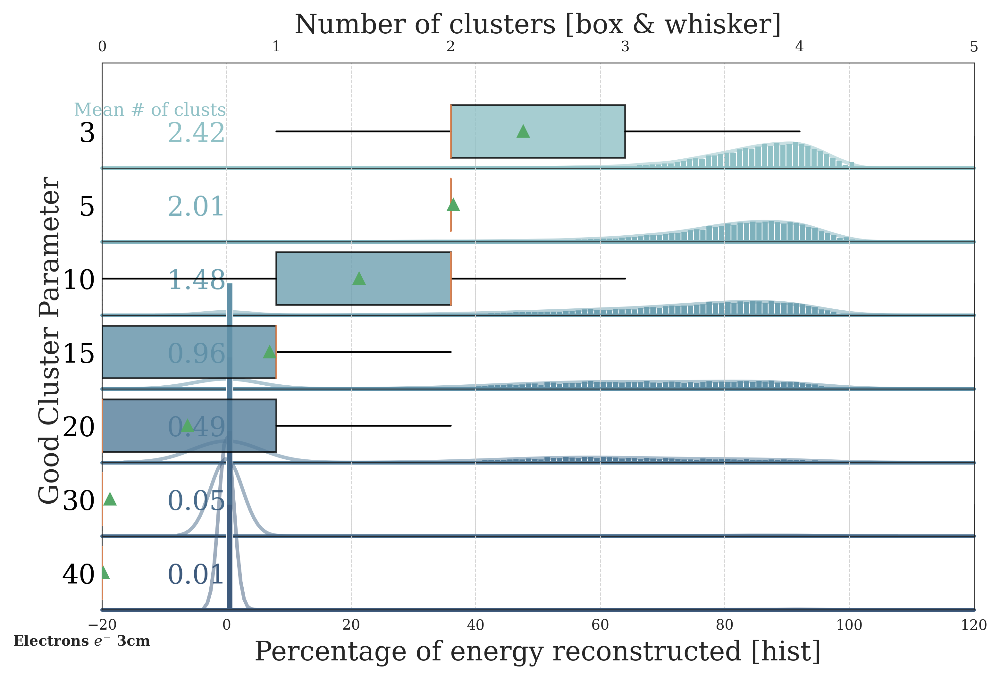

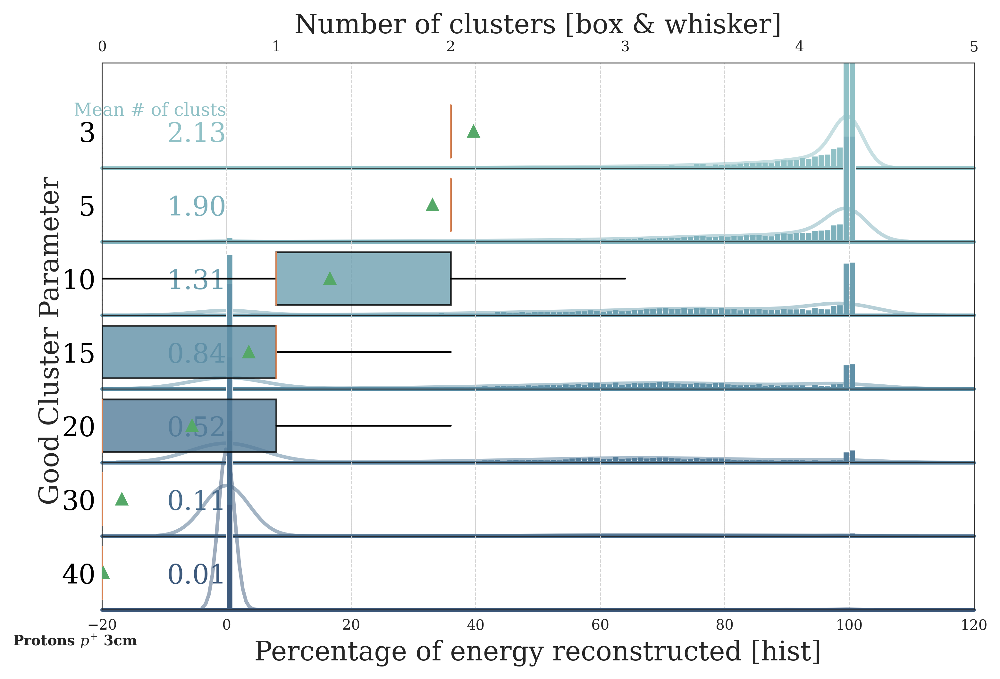

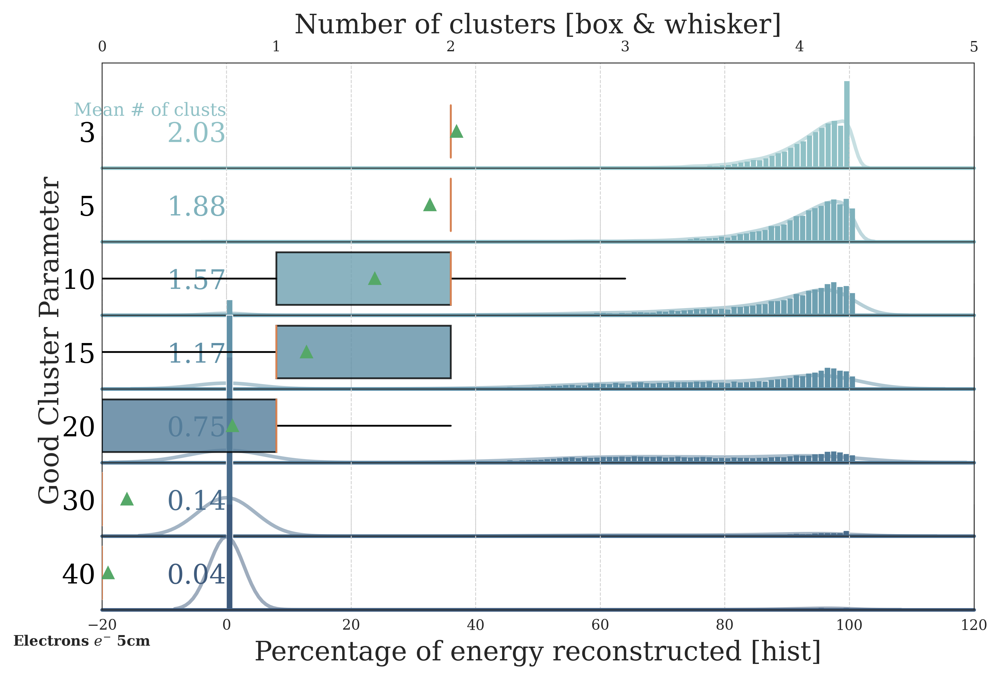

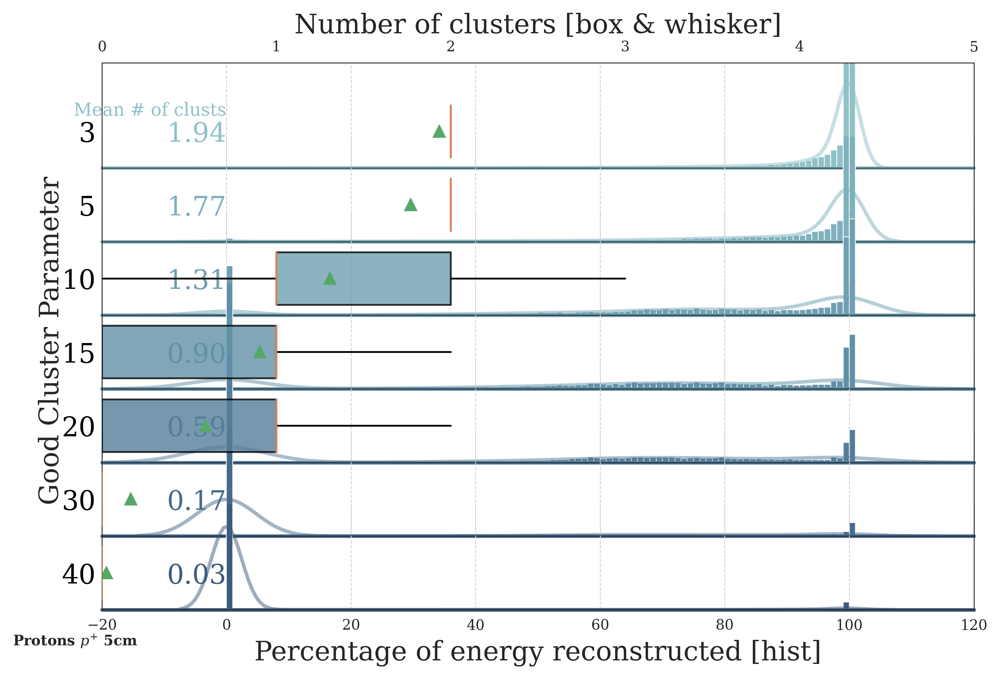

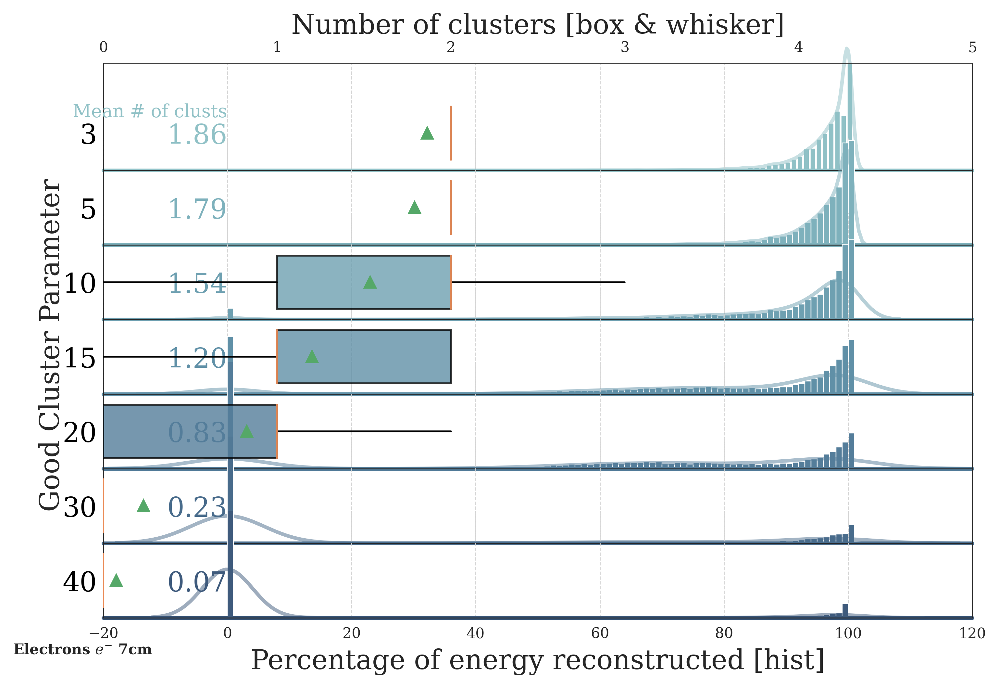

...

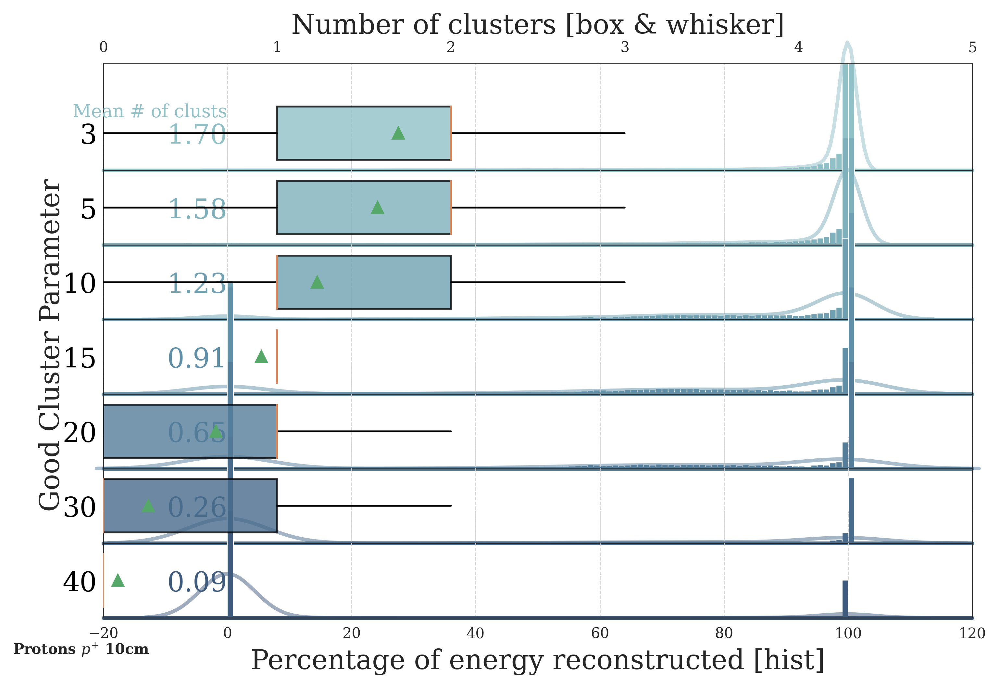

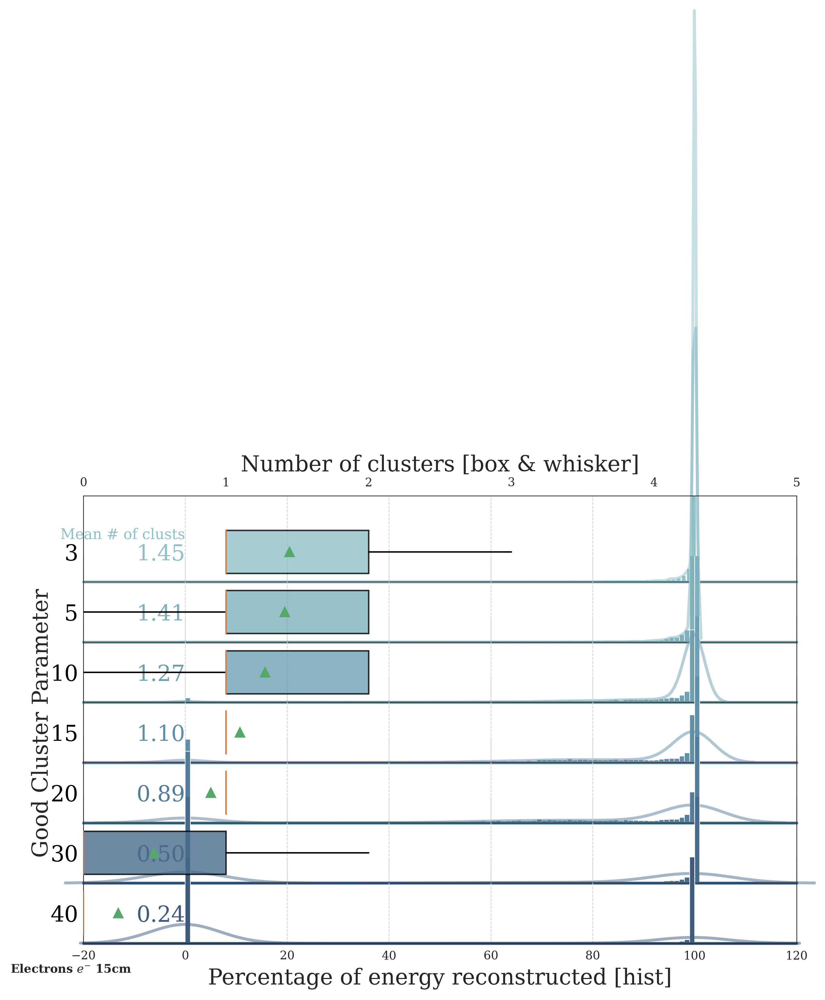

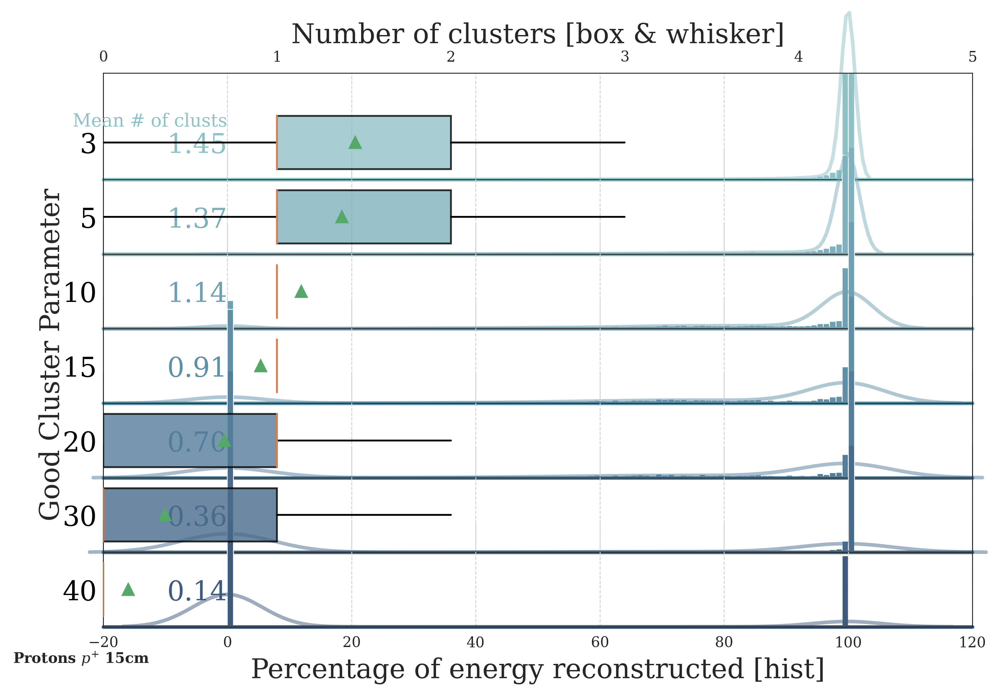

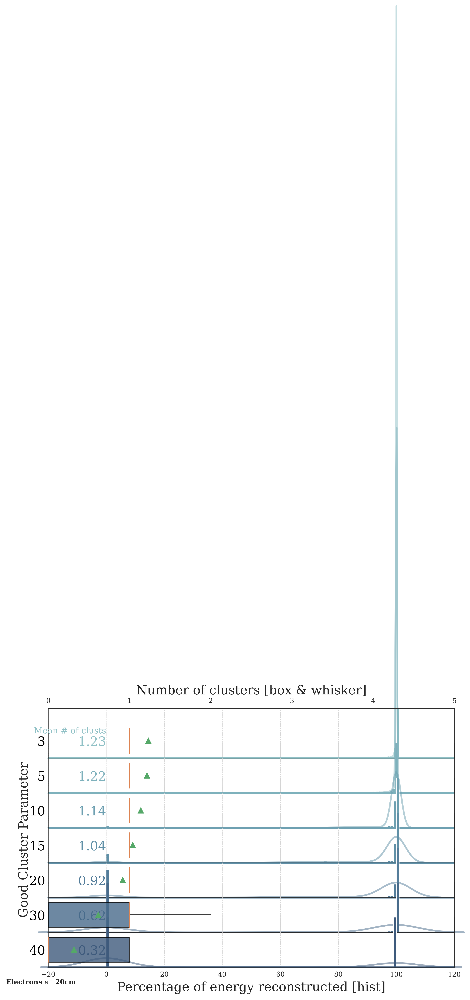

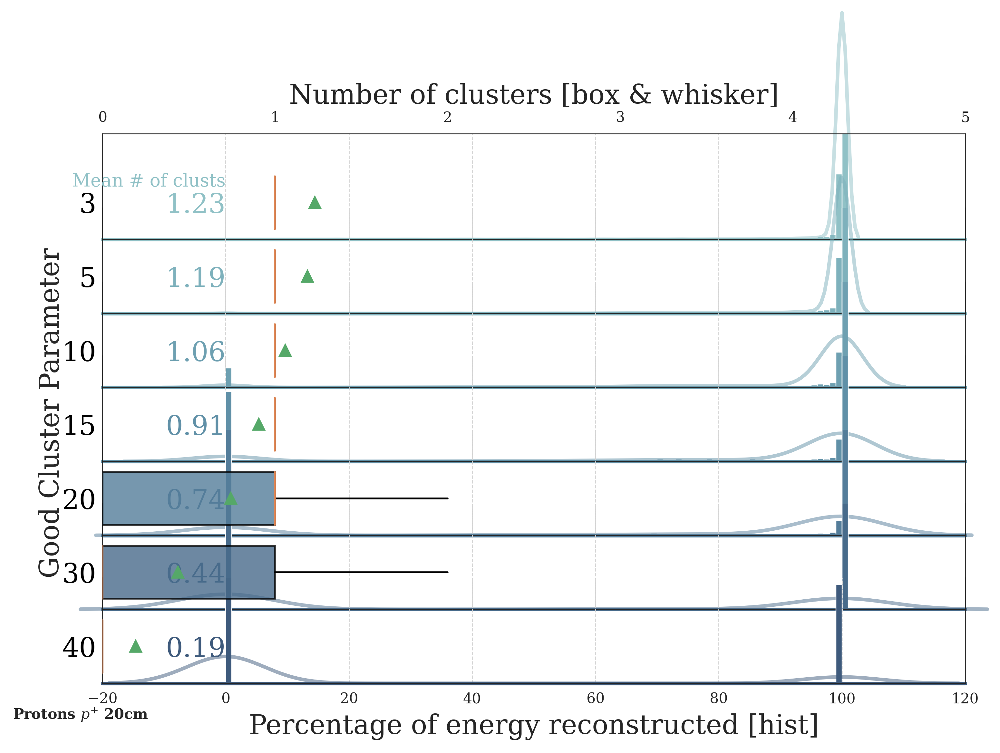

In [27]:
min_sep_list = [3, 5, 7, 10, 15, 20]
good_thres_list = [3, 5, 10, 15, 20, 30, 40]
for min_sep in min_sep_list:
    plot_good_clust_choice(particles_name='electrons', min_sep=min_sep, good_thres_list=good_thres_list)
    plot_good_clust_choice(particles_name='protons', min_sep=min_sep, good_thres_list=good_thres_list)

## Hits per cluster

In [28]:
def plot_hits_count(particles_dict=particles_dict_5cm, min_sep=5):
    for particles in particles_name_list:
        import seaborn as sns

        # hits counts per cluster count
        hits_count = particles_dict[particles].get('PFEcalClusters_hits_count')
        df_list = []
        for key, value in hits_count.items():
            # key is # of clusters
            # value is # of hits
            df = pd.DataFrame({'clusters' : key, 'hits' : value})
            df_list.append(df)
        part_df = pd.concat(df_list)
        
        # plot setup
        sns.set(style="whitegrid")
        plt.style.use('/Users/jasonwu/Programs/codes/def.mplstyle')
        plotting.plot_prettier(dpi=400,usetex=False)
        mpl.rcParams['scatter.marker'] = 'o'
        fig, ax = plt.subplots(figsize=(5, 3), dpi=200)
        ax.grid(visible=True)
        sns.violinplot(data=part_df, x='clusters', y='hits', linewidth=1)
        
        ax.annotate(text=f'{labels_dict[particles]} {min_sep}cm', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
        ax.set_xlabel('Number of Clusters', fontsize=10)
        ax.set_ylabel('Number of Hits', fontsize=10)
        # ax.legend(fontsize=10, loc='lower left')
        plt.show()
    mpl.rcParams.update(mpl.rcParamsDefault)
    plotting.plot_prettier(dpi=400,usetex=False)
    plt.style.use('/Users/jasonwu/Programs/codes/def.mplstyle')

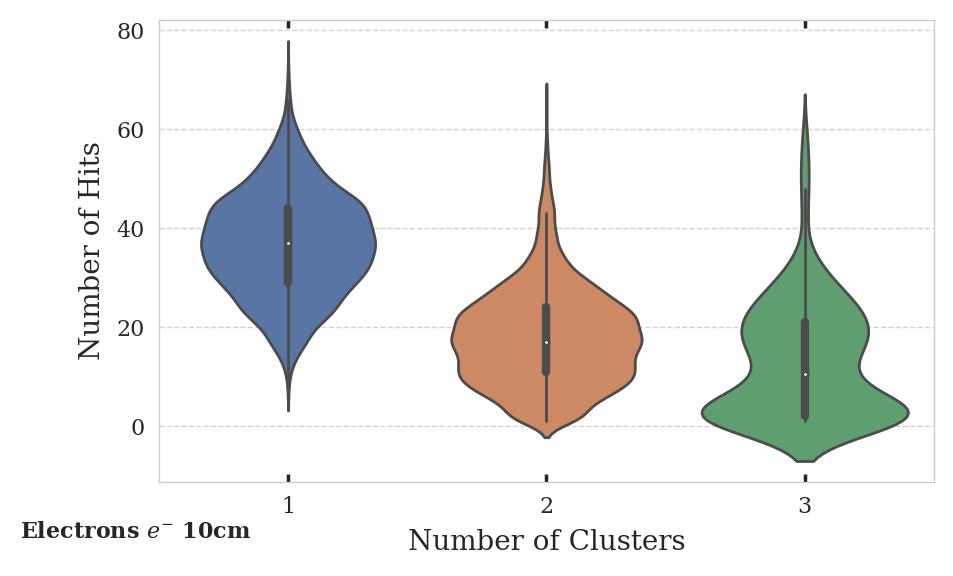

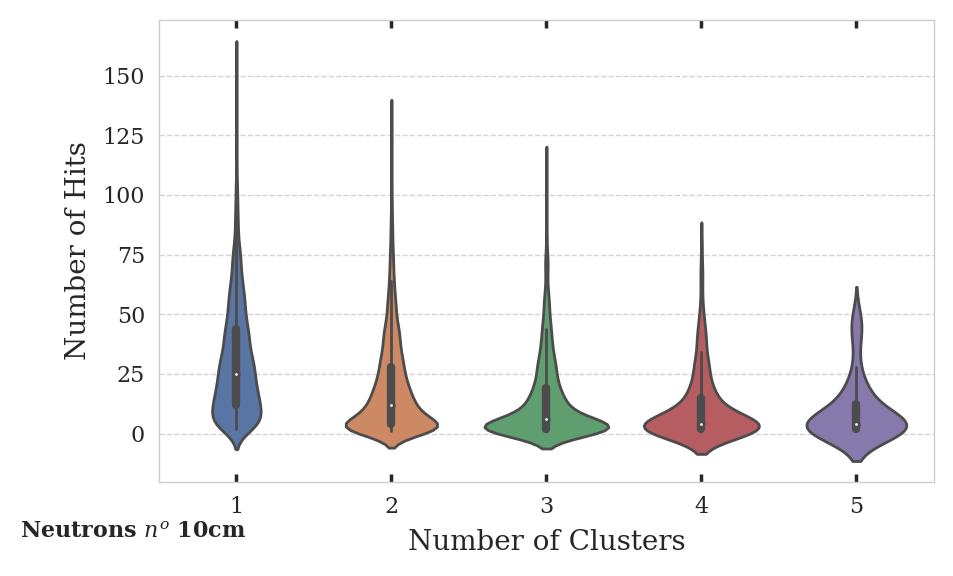

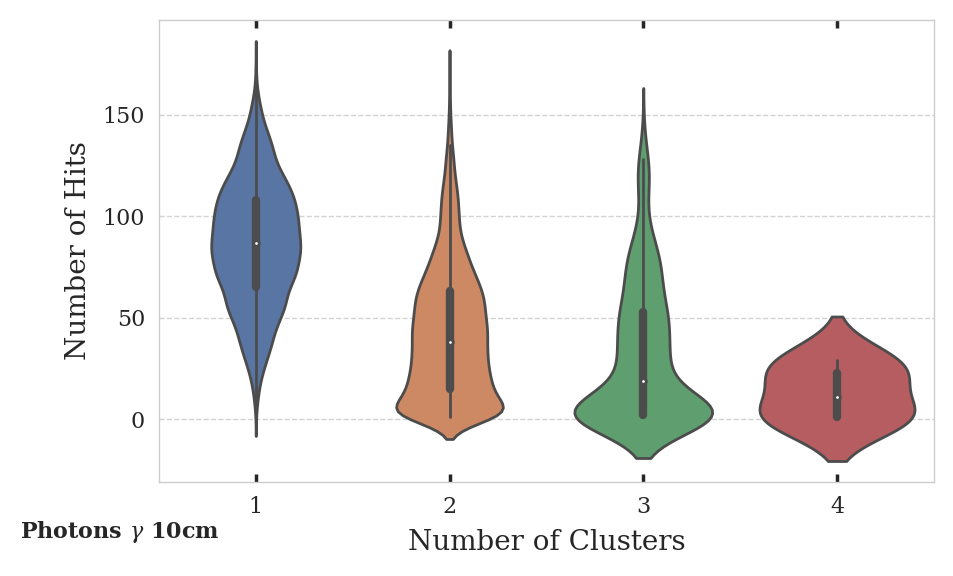

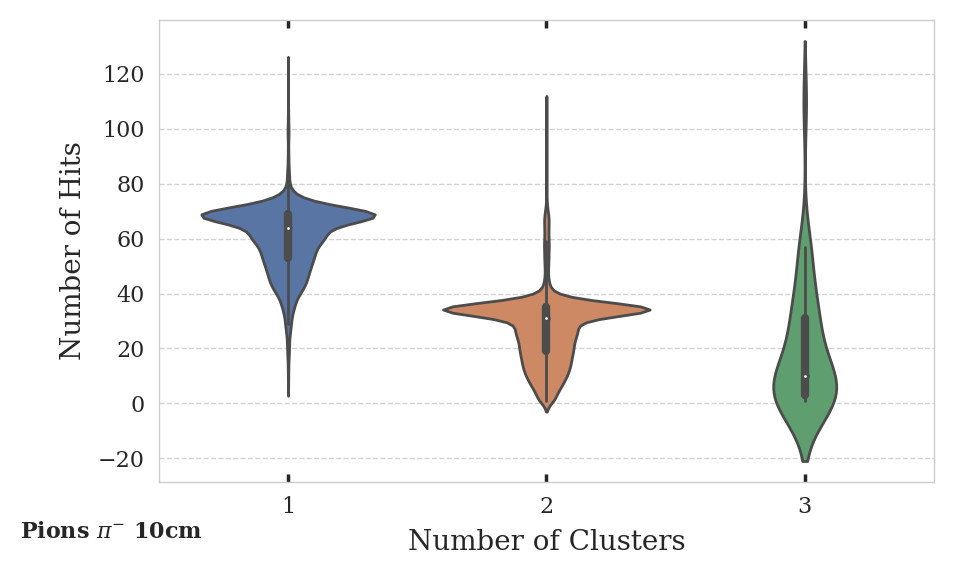

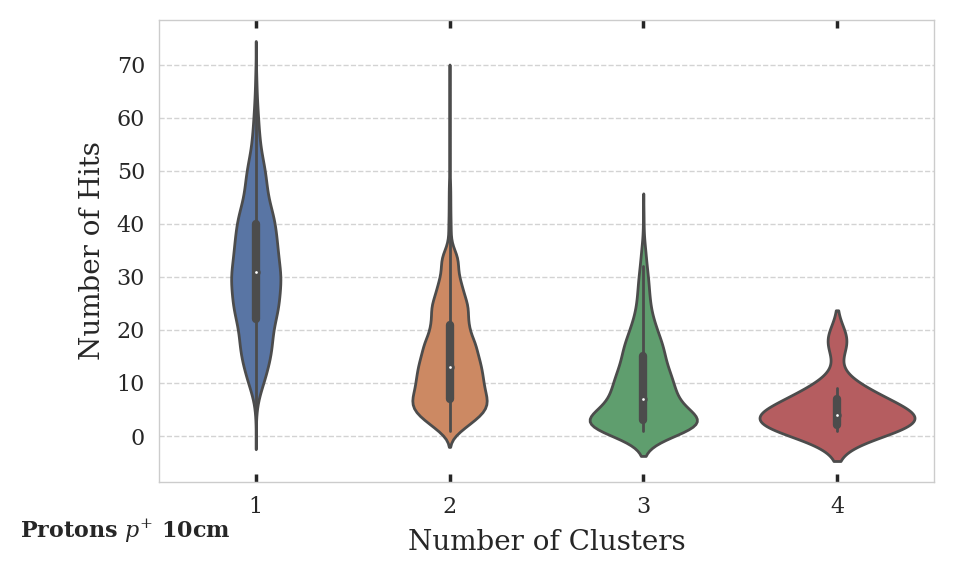

In [29]:
plot_hits_count(particles_dict_15cm, 10)

In [30]:
# number of samples that fell outside eca    
np.sum([0 if np.any(_) else 1 for _ in particles_dict_3cm['electrons'].propdict['PFTruthEcal_energy']]),\
np.sum([0 if np.any(_) else 1 for _ in particles_dict_5cm['electrons'].propdict['PFTruthEcal_energy']]),\
np.sum([0 if np.any(_) else 1 for _ in particles_dict_7cm['electrons'].propdict['PFTruthEcal_energy']]),\
np.sum([0 if np.any(_) else 1 for _ in particles_dict_10cm['electrons'].propdict['PFTruthEcal_energy']]),\
np.sum([0 if np.any(_) else 1 for _ in particles_dict_15cm['electrons'].propdict['PFTruthEcal_energy']]),\
np.sum([0 if np.any(_) else 1 for _ in particles_dict_20cm['electrons'].propdict['PFTruthEcal_energy']])

(0, 0, 0, 0, 0, 0)

## Clusters per events (two particles)

In [31]:
def plot_cluster_count(particles_dict=particles_dict_5cm, min_sep=5, cmap='tab10', max_cluster_count=10, fs=8):
    for particles in particles_name_list:
        # energy bins
        from matplotlib import cm
    
        # energy bins
        energy_bins = [0, 1, 2, 3, 4, 5]
        energy = particles_dict[particles].get('PFCandidates_ecalEnergy_o1corr')
        cluster_count = particles_dict[particles].get('PFEcalClusters_good_count')#.get('PFEcalClusters_count')
        
        # plot setup
        full_cmap = cm.get_cmap(cmap)
        color_list = [full_cmap(i)[:3] for i in range(full_cmap.N)]*10
        fig, ax = plt.subplots(figsize=(5, 3), dpi=200)
        ax.grid(visible=False)
        
        for i, min_energy in enumerate(energy_bins[:-1]):
            mask = np.logical_and(energy > min_energy*1e3, energy <= energy_bins[i+1]*1e3)
            entries, counts = np.unique(cluster_count[mask], return_counts=True)
            print(entries, counts)
            
            bottom = 0
            norm = len(cluster_count[mask])/100
            for (_, entry), count in zip(enumerate(entries), counts):
                # max and above
                if entry == max_cluster_count:
                    sum_count = np.sum(counts[_:])
                    ax.bar(i, sum_count/norm, color=color_list[entry], ec='black', lw=0.2, bottom=bottom, align='edge', width=1, alpha=0.8)
                    break
                ax.bar(i, count/norm, color=color_list[entry], ec='black', lw=0.2, bottom=bottom, align='edge', width=1, alpha=0.8)
                bottom += count/norm
        
        ax.annotate(text=f'{labels_dict[particles]} {min_sep}cm', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
        
        for j in range(np.max(particles_dict[particles].get('PFEcalClusters_good_count')+1)):
            if j == max_cluster_count:
                ax.bar(0, 0, color_list[j], ec='black', label=f'{j} and above')
                break
            ax.bar(0, 0, color_list[j], ec='black', label=j)
        ax.set_xlabel('Energy Bins [GeV]', fontsize=10)
        ax.set_ylabel('Number of Clusters [%]', fontsize=10)
        ax.legend(fontsize=fs, loc='lower left')
        plt.show()

[0 1] [3406  268]
[0 1 2] [2917 2248  119]
[0 1 2] [ 33 158  64]
[1] [1]
[] []


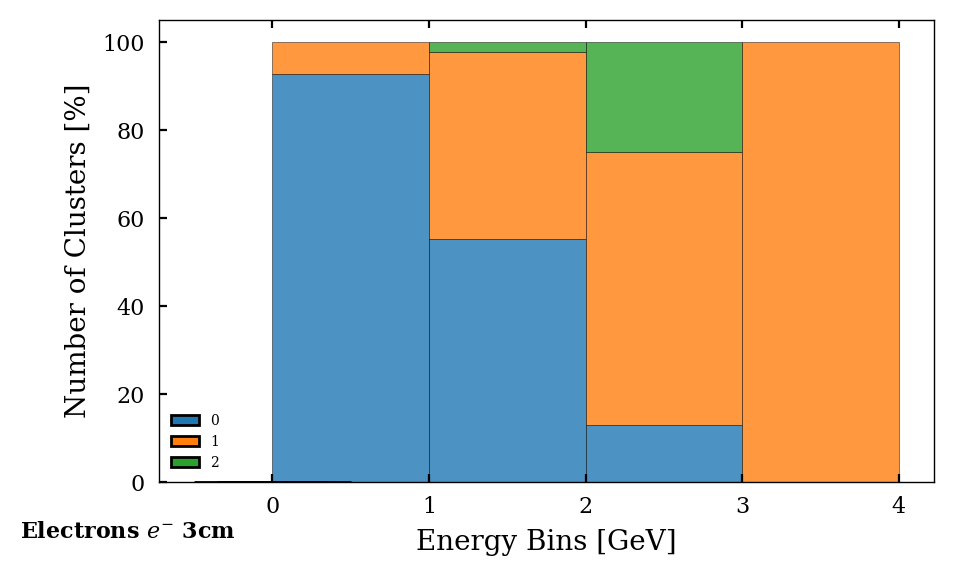

[0 1] [2296   72]
[0 1 2] [1942  703   11]
[0 1 2] [ 959 1000   69]
[0 1 2 3] [553 959 195   1]
[0 1 2] [45 74 15]


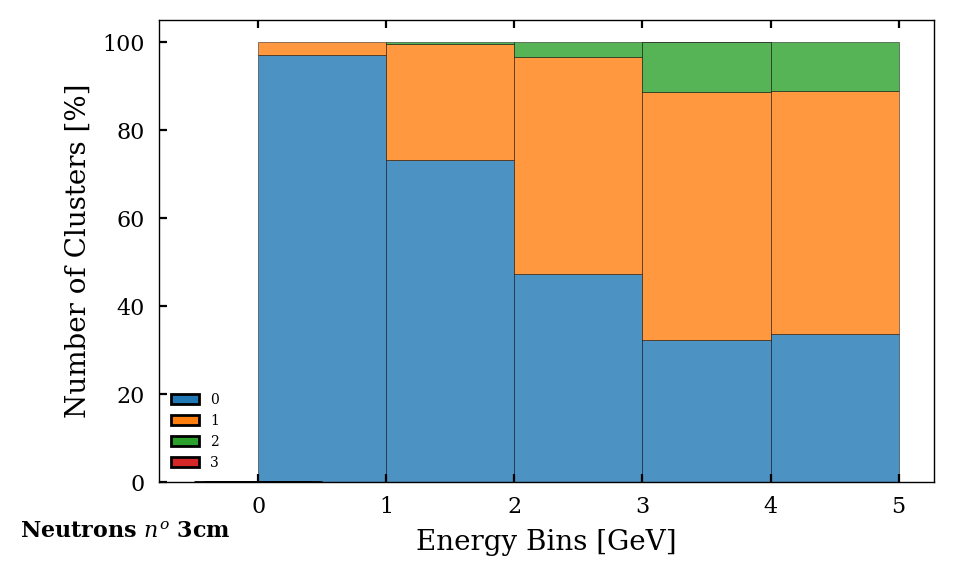

[0 1] [228   3]
[0 1 2] [370 544   9]
[0 1 2] [  46 1233  259]
[0 1 2] [   2 2141 3146]
[1 2] [ 105 1000]


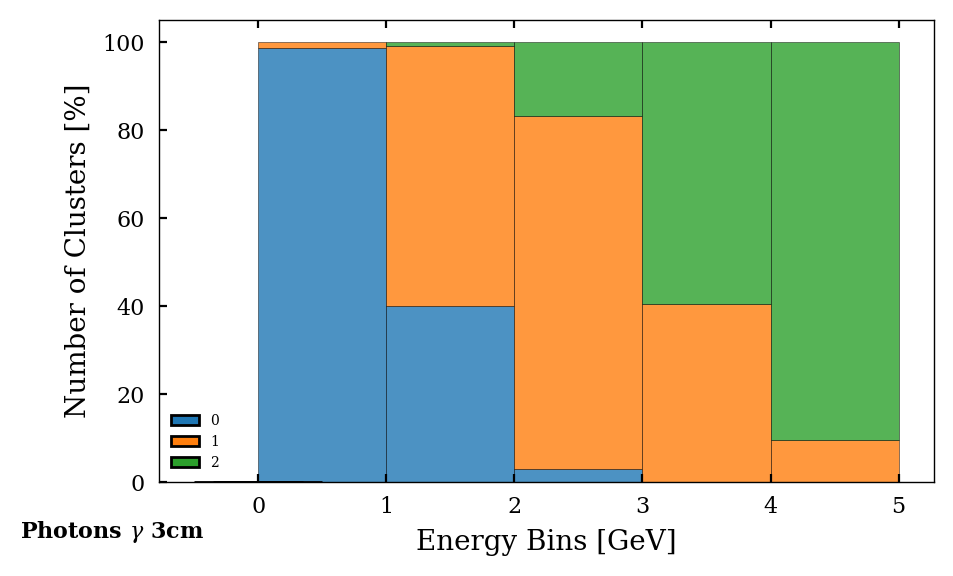

[0 1 2] [ 536 2232  353]
[0 1 2] [  59 1790 4103]
[0 1 2] [ 1 35 76]
[1 2 3] [23 35  1]
[2 3] [3 1]


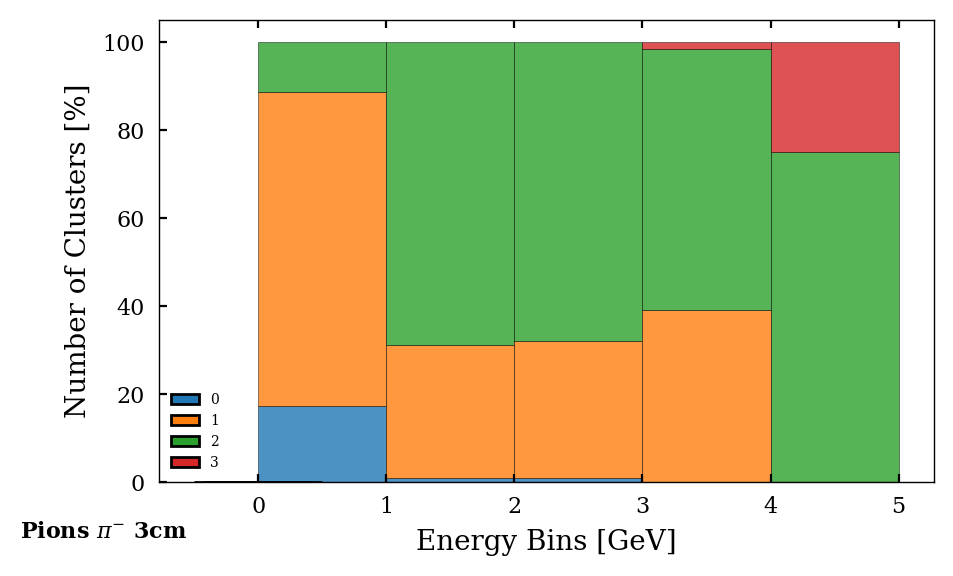

[0 1 2] [3784  673    2]
[0 1 2] [1827 2293  275]
[0 1 2] [131 183  50]
[0 1 2] [57 53  6]
[0 1] [2 4]


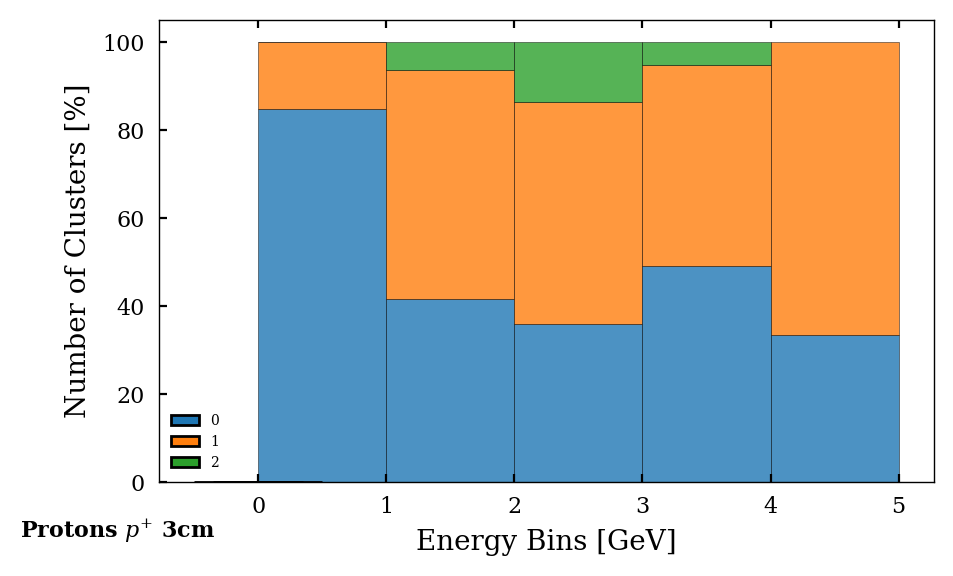

In [32]:
plot_cluster_count(particles_dict_3cm, 3, 'tab10', fs=5)

[0 1 2] [2559 1113    2]
[0 1 2] [ 781 3639  864]
[0 1 2] [  1  90 164]
[1] [1]
[] []


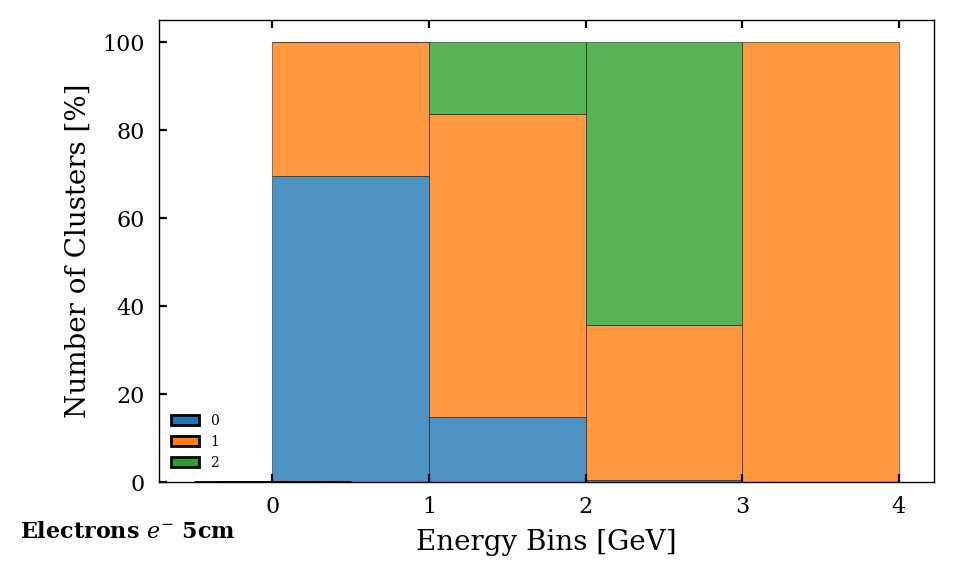

[0 1] [2205  163]
[0 1 2] [1426 1206   24]
[0 1 2] [ 528 1326  174]
[0 1 2 3] [ 258 1073  373    4]
[0 1 2 3] [23 75 35  1]


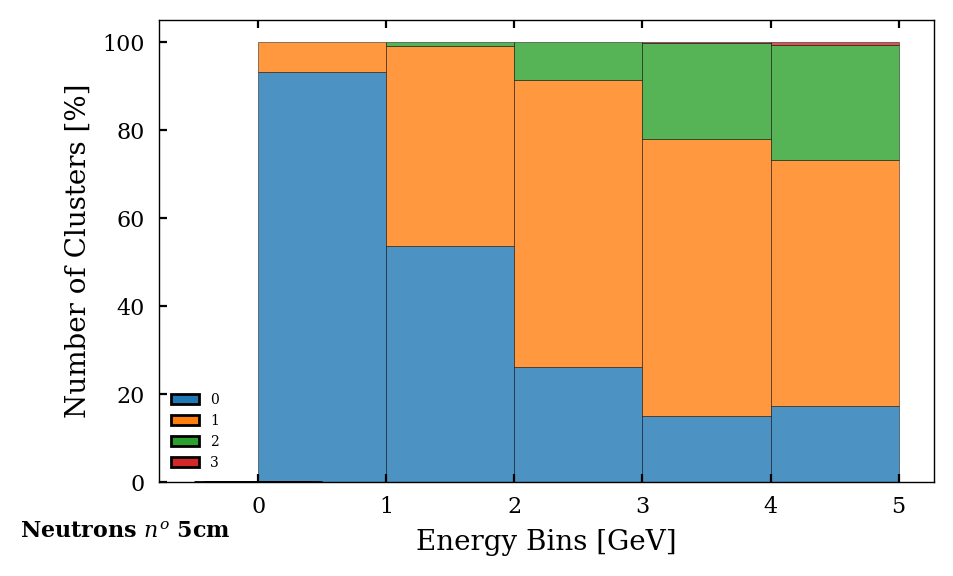

[0 1] [186  45]
[0 1 2] [121 722  80]
[0 1 2] [   3 1017  518]
[1 2] [1979 3310]
[1 2] [219 886]


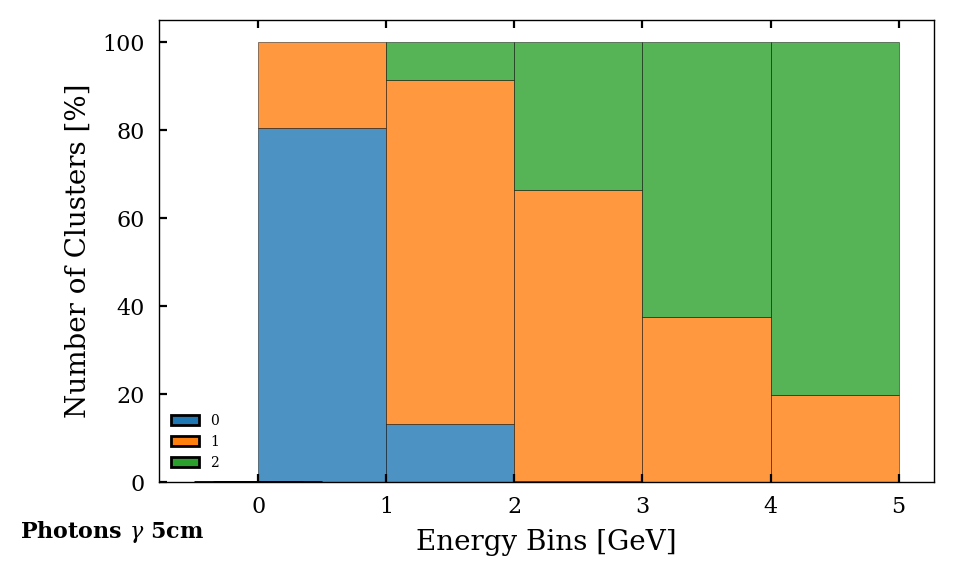

[0 1 2] [ 264 2177  680]
[0 1 2] [   2 1371 4579]
[0 1 2] [ 1 28 83]
[1 2] [17 42]
[2] [4]


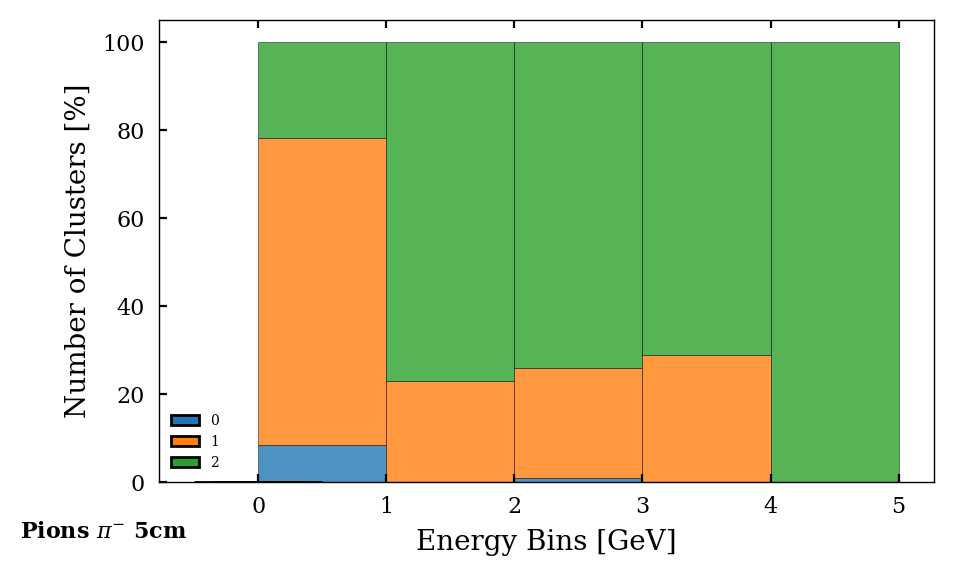

[0 1 2] [3268 1177   14]
[0 1 2] [1046 2813  536]
[0 1 2] [ 83 198  83]
[0 1 2] [43 55 18]
[1] [6]


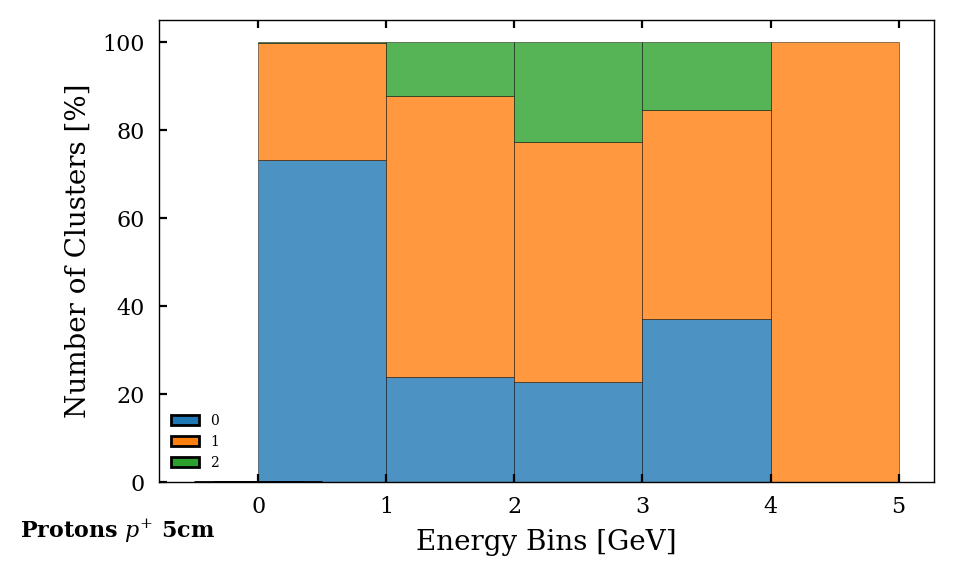

In [33]:
plot_cluster_count(particles_dict_5cm, 5, 'tab10', fs=5)

[0 1 2] [1229 2318  127]
[0 1 2] [  30 3145 2109]
[1 2] [ 68 187]
[1] [1]
[] []


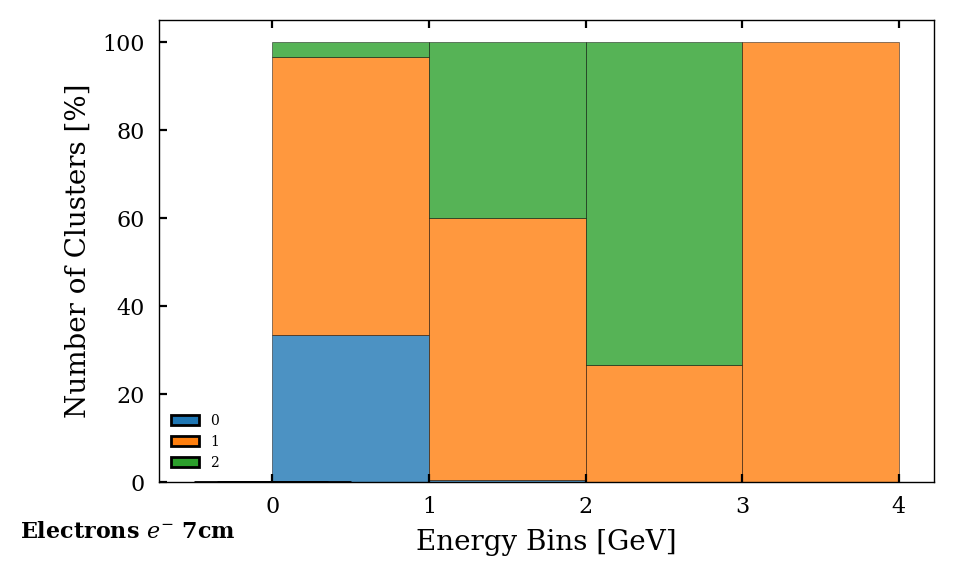

[0 1 2] [1980  386    2]
[0 1 2] [ 879 1692   85]
[0 1 2] [ 259 1473  296]
[0 1 2 3] [ 128 1060  513    7]
[0 1 2] [ 8 81 45]


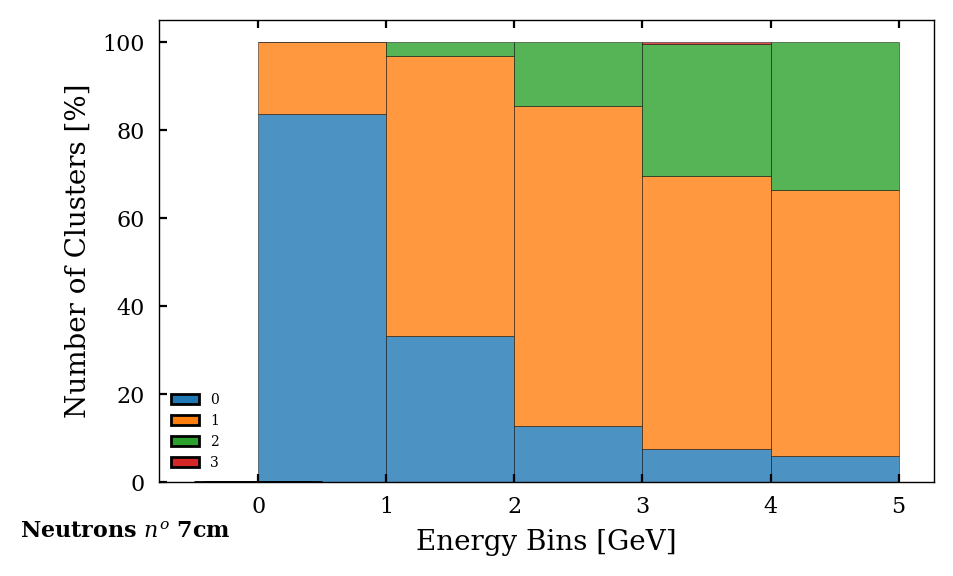

[0 1] [129 102]
[0 1 2] [ 17 694 212]
[1 2] [863 675]
[1 2 3] [2059 3228    2]
[1 2] [322 783]


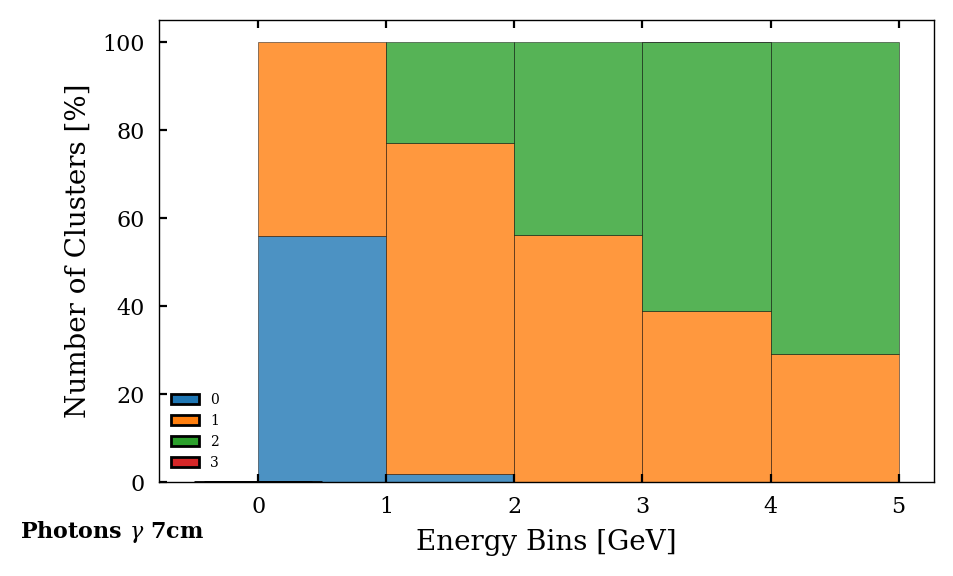

[0 1 2] [ 115 1810 1196]
[0 1 2] [   1 1565 4386]
[0 1 2] [ 1 39 72]
[1 2] [16 43]
[1 2] [1 3]


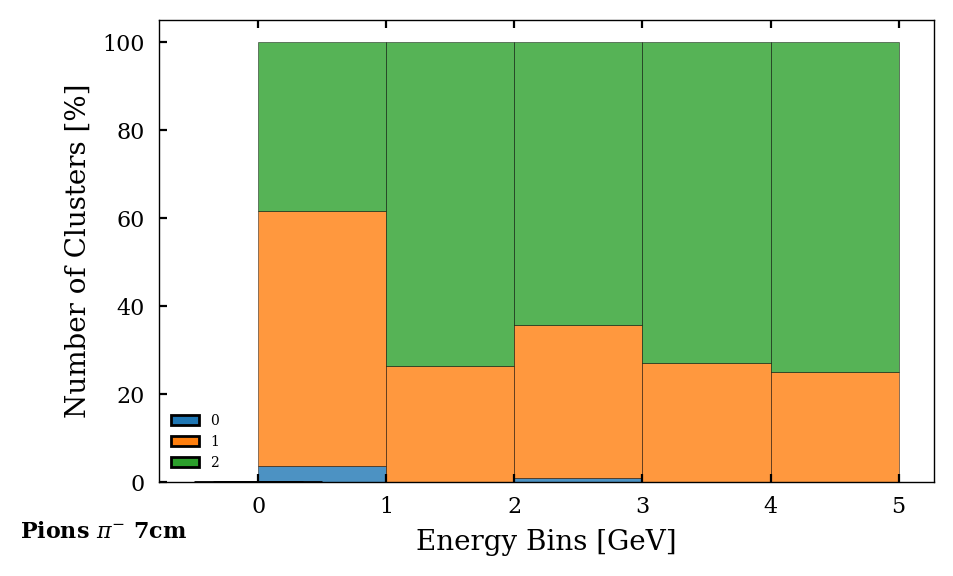

[0 1 2] [2229 2124  106]
[0 1 2] [ 408 2919 1068]
[0 1 2] [ 26 219 119]
[0 1 2] [21 65 30]
[1] [6]


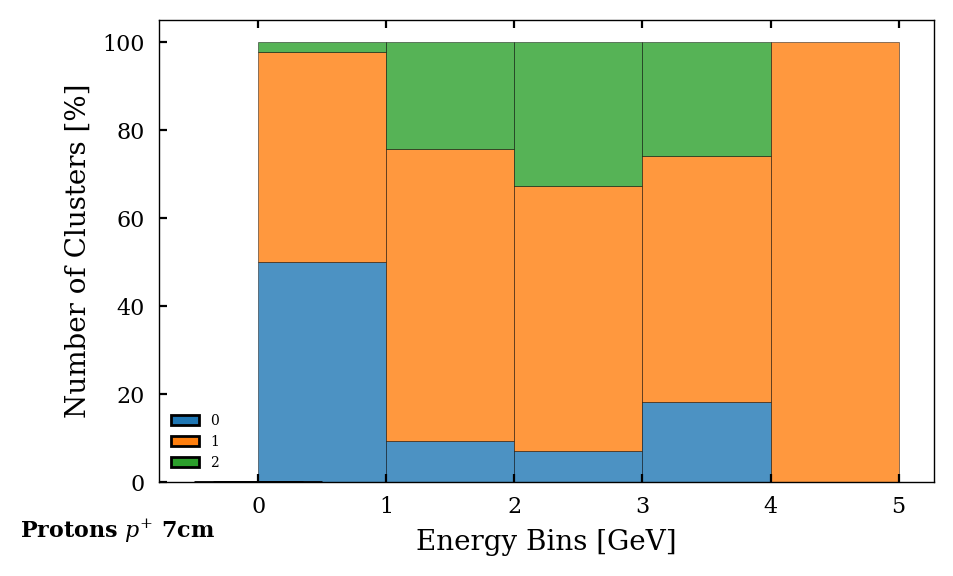

In [34]:
plot_cluster_count(particles_dict_7cm, 7, 'tab10', fs=5)

[0 1 2] [ 429 2769  476]
[0 1 2] [   3 2889 2392]
[1 2] [101 154]
[1] [1]
[] []


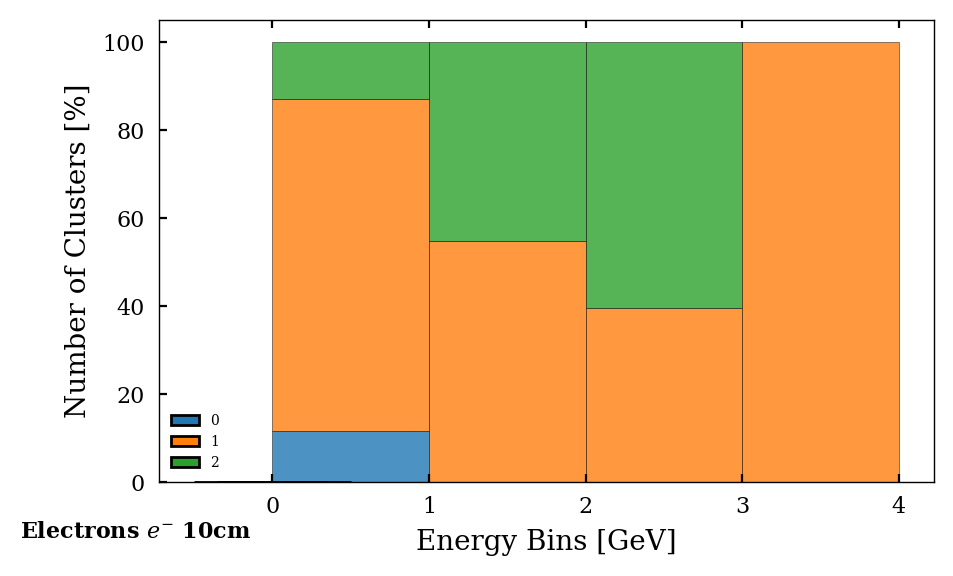

[0 1 2] [1708  654    6]
[0 1 2] [ 508 1982  166]
[0 1 2 3] [ 143 1494  388    3]
[0 1 2 3] [  61 1127  508   12]
[0 1 2 3] [ 3 91 39  1]


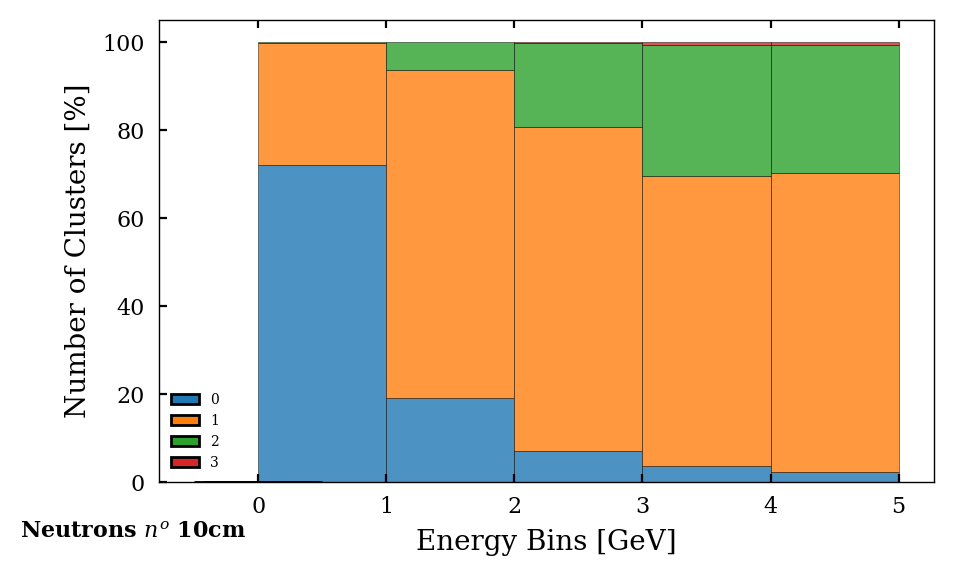

[0 1 2] [ 61 162   8]
[0 1 2] [  3 629 291]
[1 2] [880 658]
[1 2 3] [2610 2675    4]
[1 2 3] [473 630   2]


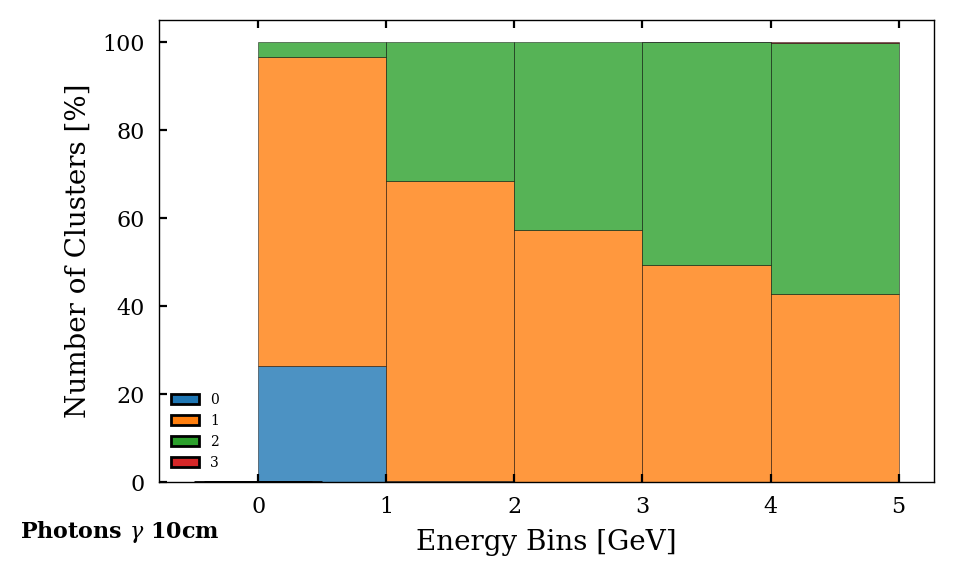

[0 1 2] [  57 1590 1474]
[0 1 2] [   1 2373 3578]
[1 2] [53 59]
[1 2] [23 36]
[1 2] [2 2]


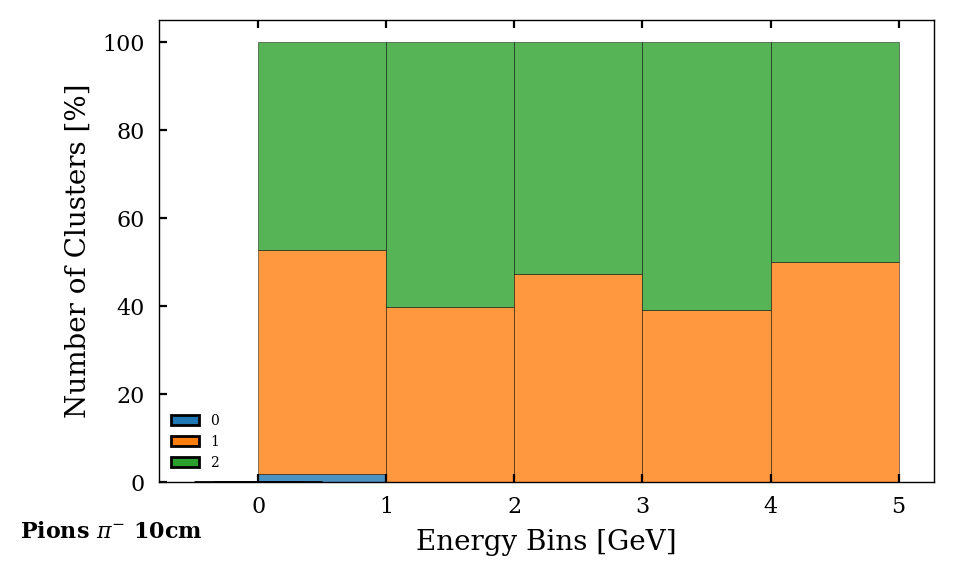

[0 1 2] [1338 2840  281]
[0 1 2] [ 145 2913 1337]
[0 1 2] [ 12 226 126]
[0 1 2] [10 78 28]
[1] [6]


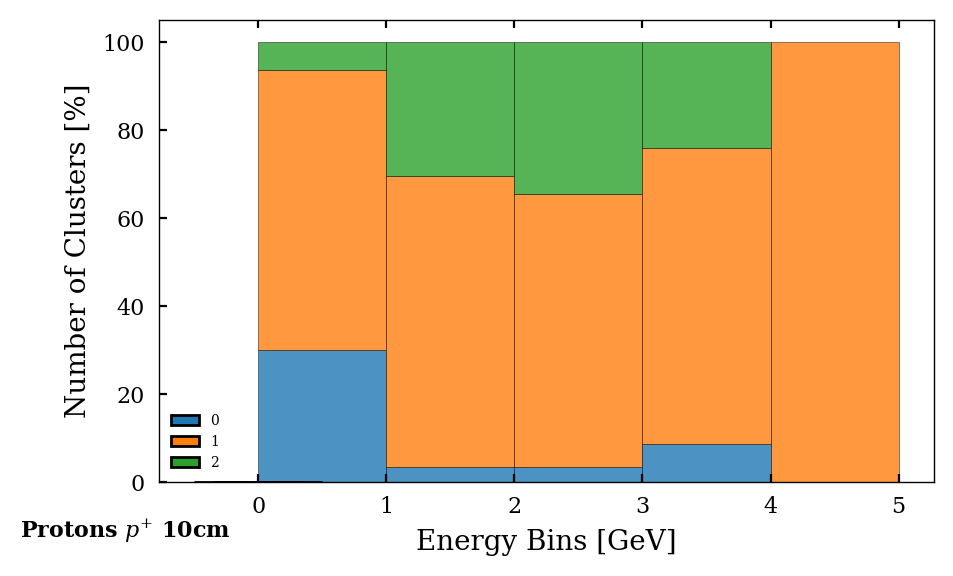

In [35]:
plot_cluster_count(particles_dict_10cm, 10, 'tab10', fs=5)

[0 1 2] [   1 2105 1568]
[1 2] [3161 2123]
[1 2] [142 113]
[1] [1]
[] []


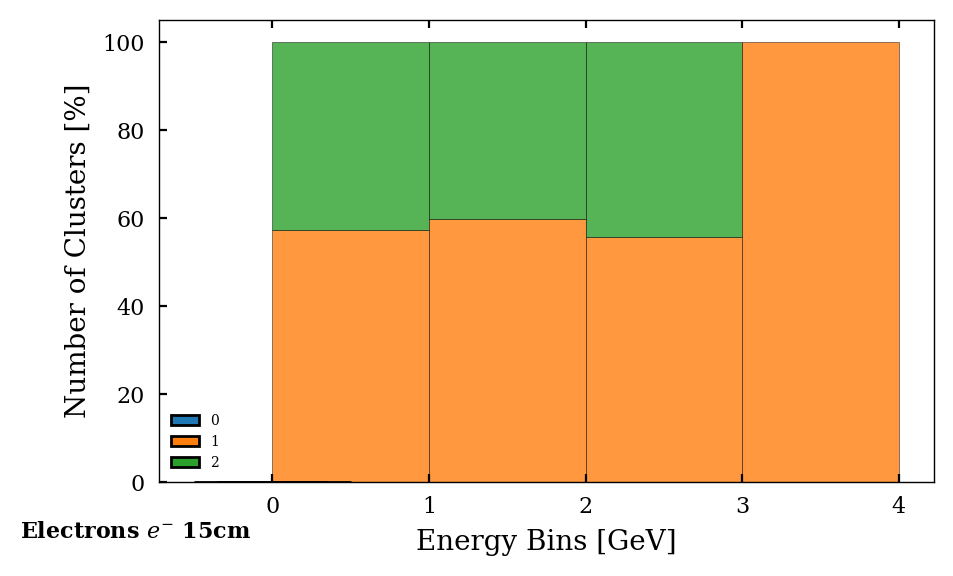

[0 1 2] [ 734 1488  146]
[0 1 2 3] [  42 2001  598   15]
[0 1 2 3] [  15 1398  585   30]
[0 1 2 3 4] [   6 1148  525   28    1]
[0 1 2 3] [ 1 99 30  4]


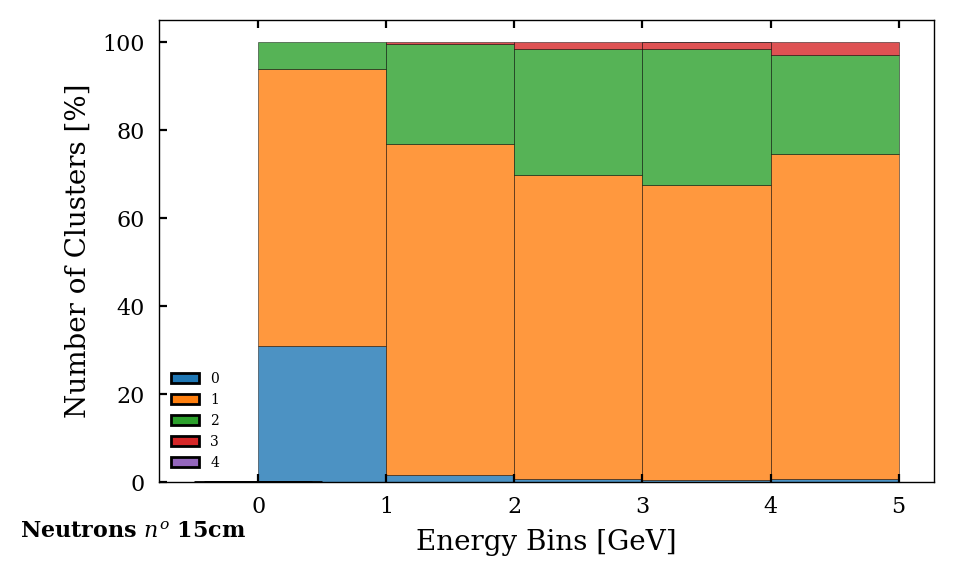

[0 1 2] [  1 157  73]
[1 2] [559 364]
[1 2 3] [953 583   2]
[1 2 3] [3303 1981    5]
[1 2 3] [691 413   1]


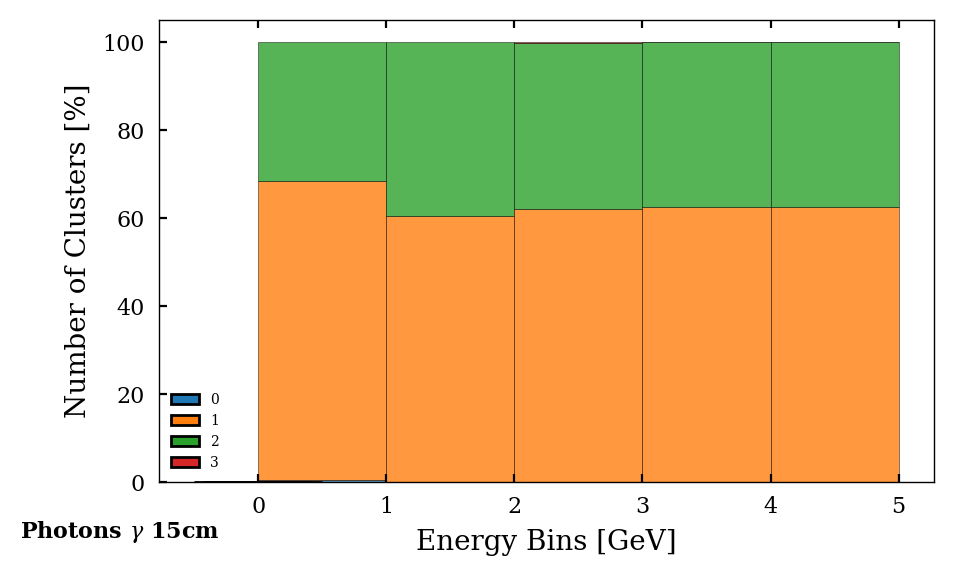

[1 2 3] [1377 1743    1]
[1 2] [3722 2230]
[1 2] [78 34]
[1 2] [35 24]
[1] [4]


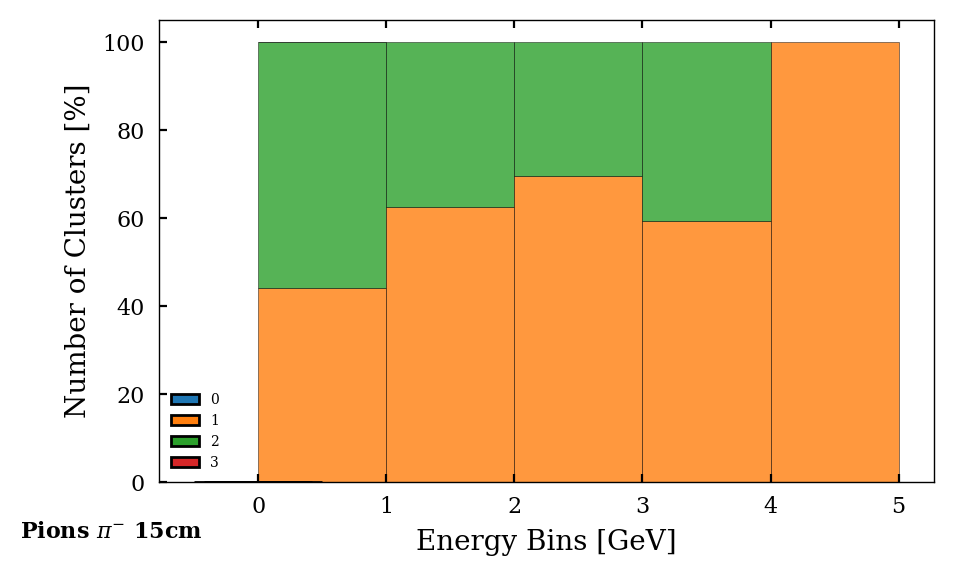

[0 1 2 3] [  33 2781 1643    2]
[1 2 3] [2717 1668   10]
[1 2] [237 127]
[1 2] [71 45]
[1 2] [2 4]


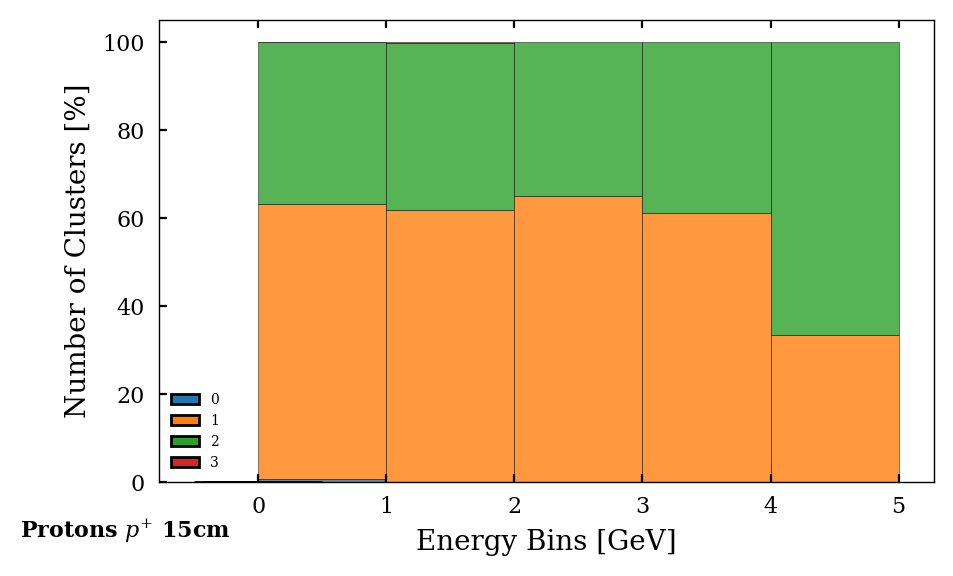

In [36]:
plot_cluster_count(particles_dict_15cm, 15, 'tab10', fs=5)

[1 2 3] [2673  999    2]
[1 2 3] [4025 1252    7]
[1 2] [195  60]
[1] [1]
[] []


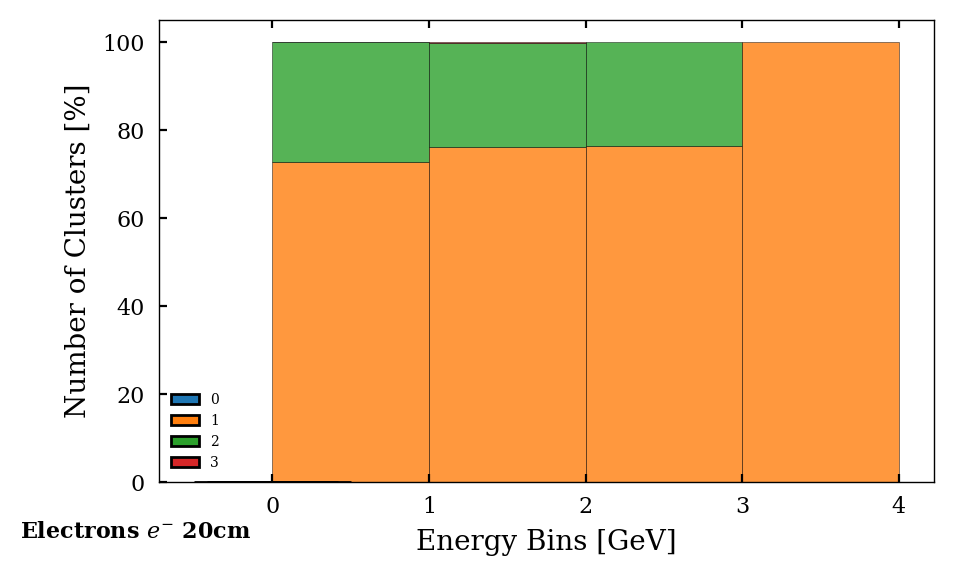

[0 1 2 3] [ 251 1699  396   22]
[0 1 2 3 4] [   3 1810  767   72    4]
[1 2 3 4] [1346  618   62    2]
[0 1 2 3 4] [   1 1122  526   57    2]
[1 2 3] [87 46  1]


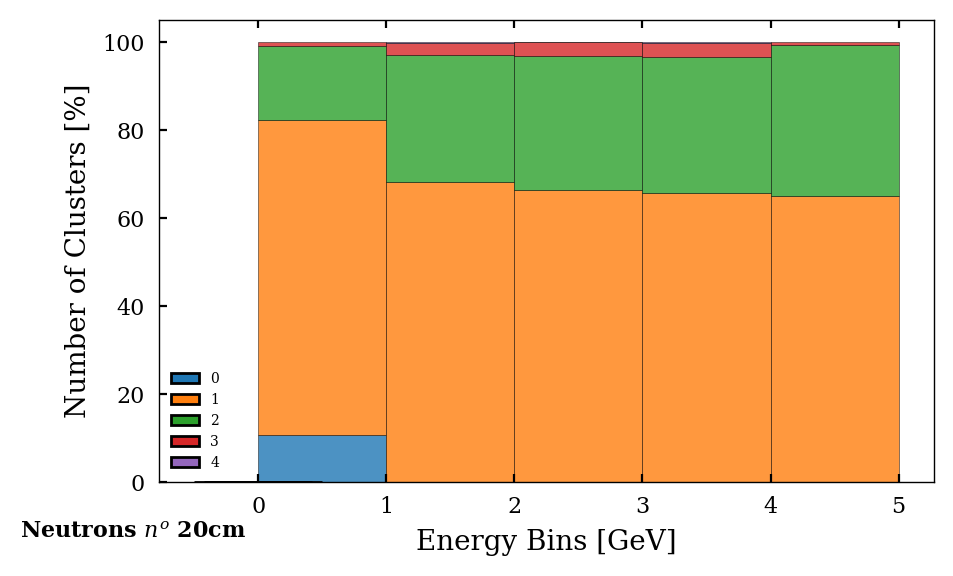

[1 2] [172  59]
[1 2 3] [659 262   2]
[1 2 3] [1159  377    2]
[1 2 3] [3899 1375   15]
[1 2 3] [822 282   1]


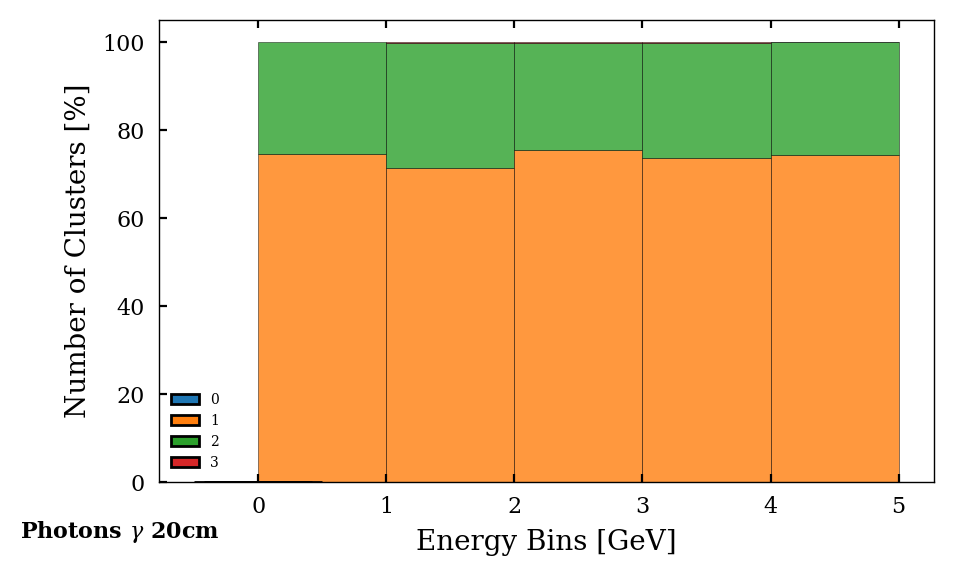

[1 2 3] [1944 1174    3]
[1 2] [4902 1050]
[1 2 3] [84 27  1]
[1 2 3] [45 13  1]
[1] [4]


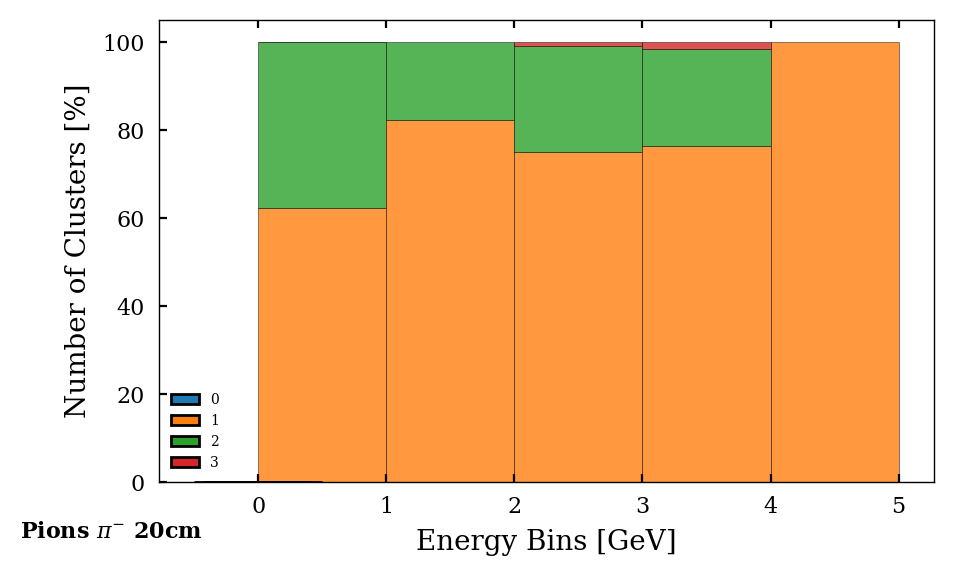

[1 2 3] [3175 1264   20]
[1 2 3] [3432  938   25]
[1 2 3] [286  76   2]
[1 2 3] [89 26  1]
[1 2] [3 3]


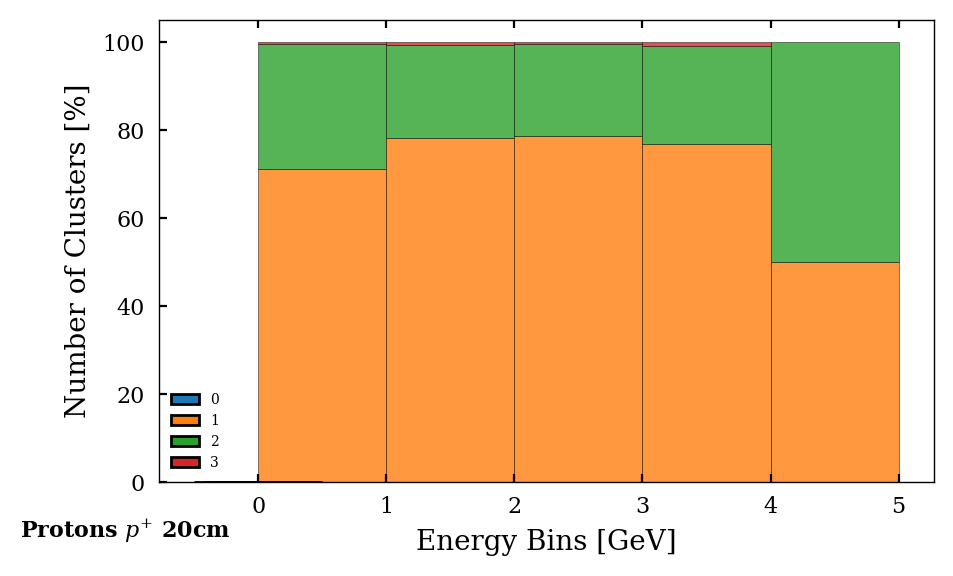

In [37]:
plot_cluster_count(particles_dict_20cm, 20, 'tab10', fs=5)

In [38]:
particles_dict_20cm['electrons'].get('EcalTotalEnergy')

array([1200.4155 ,  957.65344, 1369.3466 , ...,  700.76886, 2090.4233 ,
        679.7557 ], dtype=float32)

In [39]:
particles_dict_20cm['electrons'].get('PFCandidates_ecalEnergy')

array([1200.41552734,  957.65344238, 1369.34655762, ...,  700.76885986,
       1405.43457031,  679.75567627])

In [40]:
particles_dict_20cm['electrons'].get('PFCandidates_ecalEnergy_o1corr')

array([1194.15526434,  985.92776763, 1362.20530577, ...,  721.45877314,
       2054.32478078,  699.82518391])

# Spatial Distributions

In [41]:
# global variables
ECALZ_MIN = 247.9
ECALZ_MAX = 749.1
ECALW = 520

BHCALZ_MIN = 879
SHCALZ_MIN = 240
SHCALZ_MAX = 800
SHCALX_MIN = 500
SHCALX_MAX = 1500

# the style used for the confidence range plots
# 0: area
# 1: error bars
style = 1

def plot_ecal_box(ax, label=False):
    box_label = 'ECal' if label else ''
    ax.add_patch(plt.Rectangle((ECALZ_MIN, -ECALW/2), ECALZ_MAX - ECALZ_MIN, ECALW, fc=(0, 0, 0, 0), ec='red', label=box_label))
    
def plot_hcal_box(ax, label=False):
    box_label = 'HCal' if label else ''
    ax.add_patch(plt.Rectangle((SHCALZ_MIN, SHCALX_MIN), SHCALZ_MAX - SHCALZ_MIN, SHCALX_MAX - SHCALX_MIN, fc=(0, 0, 0, 0), ec='red', label=box_label))
    ax.add_patch(plt.Rectangle((SHCALZ_MIN, -SHCALX_MAX), SHCALZ_MAX - SHCALZ_MIN, SHCALX_MAX - SHCALX_MIN, fc=(0, 0, 0, 0), ec='red', label=box_label))
    ax.axvline(x=BHCALZ_MIN, lw=1, ls='--', color='red', label=box_label)

# plot the cluster distribution
def plot_cluster_dist(particles_dict=particles_dict_5cm, min_sep=5, spec_part=None, ipart=None, # particle parameters
                      factor=10, length=50, extend=False, xlim=3000, ylim=1000, # line parameters
                      plot_track=False, plot_ecal=True, plot_hcal=False, plot_energy=False, angle_label=True, # plotting booleans
                      cmap='tab20', track_color='black', ecal_color='slateblue', hcal_color='orange'):  # color parameters
    from matplotlib.patches import Polygon
    from matplotlib import cm
    # for each particle
    for particles_name in particles_name_list:
        if spec_part and particles_name not in spec_part:
            continue
        i = ipart
        # get parameters
        particles = particles_dict[particles_name]
        cluster_count = particles.get('PFEcalClusters_good_count')
        track_Pz = particles.get('PFCandidates_trackPz')
        track_Px = particles.get('PFCandidates_trackPx')
        track_posX = particles.get('PFCandidates_posEcalX')
        ecal_clusterZ = particles.get('PFEcalClusters_centroidZ')
        ecal_clusterX = particles.get('PFEcalClusters_centroidX')
        ecal_clusterEZ = particles.get('PFEcalClusters_rmsZ')
        ecal_clusterEX = particles.get('PFEcalClusters_rmsX')
        ecal_clusterDXDZ = particles.get('PFEcalClusters_DXDZ')
        hcal_clusterZ = particles.get('PFHcalClusters_centroidZ')
        hcal_clusterX = particles.get('PFHcalClusters_centroidX')
        hcal_clusterEZ = particles.get('PFHcalClusters_rmsZ')
        hcal_clusterEX = particles.get('PFHcalClusters_rmsX')
        hcal_clusterDXDZ = particles.get('PFHcalClusters_DXDZ')

        if plot_ecal:
            ecal_hitsX = particles.get('PFEcalClusters_hitX')
            ecal_hitsY = particles.get('PFEcalClusters_hitY')
            ecal_hitsZ = particles.get('PFEcalClusters_hitZ')
        if plot_hcal:
            hcal_hitsX = particles.get('PFHcalClusters_hitX')
            hcal_hitsY = particles.get('PFHcalClusters_hitY')
            hcal_hitsZ = particles.get('PFHcalClusters_hitZ')
        
        # get the index of max number of clusters
        if not i:
            i = np.argmax(cluster_count)

        print(cluster_count[i])
        
        # setting up plot
        fig, ax = plt.subplots(figsize=(5, 5), dpi=200)
        full_cmap = cm.get_cmap(cmap)
        color_list = [full_cmap(i)[:3] for i in range(full_cmap.N)]*10

        """Track Momentum"""
        if plot_track:
            # add triangle
            Pz = track_Pz[i]/factor
            Px = track_Px[i]/factor
            xy = [[ECALZ_MIN, track_posX[i]], [ECALZ_MIN+Pz, track_posX[i]], [ECALZ_MIN+Pz, track_posX[i]+Px]]
            momentum = Polygon(xy=xy, fc='None', ec=track_color, ls='--', label='Track')
            ax.add_patch(momentum)
            # add annotation
            track_angle = np.rad2deg(np.arctan(Px/Pz))
            ax.text(ECALZ_MIN+Pz/2, ECALW/2+20, fr'Track {track_angle:.2f} $\deg$', color=track_color, ha='center')
            # extend
            if extend:
                ax.axline(xy1=[ECALZ_MIN, track_posX[i]], xy2=[ECALZ_MIN + Pz * 10, track_posX[i] + Px * 10], lw=1, ls='--', alpha=0.5, color=track_color)
        
        """Ecal Box"""
        if plot_ecal:
            # clusters
            ecal_z = ecal_clusterZ[i]
            ecal_x = ecal_clusterX[i]
            ecal_ez = ecal_clusterEZ[i]
            print(ecal_ez)
            ecal_ex = ecal_clusterEX[i]
            ecal_tan = ecal_clusterDXDZ[i]
            # hits
            ecal_hx = ecal_hitsX[i]
            ecal_hy = ecal_hitsY[i]
            ecal_hz = ecal_hitsZ[i]
                
            # plot the hits
            markers = ['.', 'o', 'v', '^', '<', '>', '8', 's', 'p', 'h', 'H', 'D', 'd', 'P'] * 10
            i = 0
            for ecal_hx, ecal_hy, ecal_hz in zip(ecal_hx, ecal_hy, ecal_hz):
                ax.scatter(x=ecal_hz, y=ecal_hx, s=5, c=color_list[i], alpha=0.8, lw=1, marker=markers[i])
                i += 1
            
            # check for multiple clusters
            if np.isscalar(ecal_z):
                ecal_z = [ecal_z]
                ecal_x = [ecal_x]
                ecal_ez = [ecal_ez]
                ecal_ex = [ecal_ex]
                ecal_tan = [ecal_tan]

            i = 0
            for ecal_z, ecal_x, ecal_ez, ecal_ex, ecal_tan in zip(ecal_z, ecal_x, ecal_ez, ecal_ex, ecal_tan):
                [ecal_z, ecal_x, ecal_ez, ecal_ex, ecal_tan] = [0 if not _ else _ for _ in [ecal_z, ecal_x, ecal_ez, ecal_ex, ecal_tan]]
                ax.errorbar(x=ecal_z, y=ecal_x, xerr=[[ecal_ez], [ecal_ez]], yerr=[[ecal_ex], [ecal_ex]], color=color_list[i], elinewidth=1, fmt='-', label='ECal Cluster')
                # the angle
                ecal_angle = np.rad2deg(np.arctan(ecal_tan))
                if abs(ecal_angle) > 5:
                    ax.plot([ecal_z+ecal_ez, ecal_z-ecal_ez], [ecal_x+ecal_tan*ecal_ez, ecal_x-ecal_tan*ecal_ez], color=color_list[i], lw=1, ls='--', alpha=0.8)
                    if angle_label:
                        ax.text(ecal_z, -ylim, f'{ecal_angle:.2f}', color=color_list[i], ha='center')
                    # extend
                    if extend:
                        ax.axline(xy1=[ecal_z, ecal_x], xy2=[ecal_z + length * 10, ecal_x + length * 10 * ecal_tan], lw=1, ls='--', alpha=0.5, color=color_list[i])
                i += 1
        
        """Hcal Box"""
        if plot_hcal:
            hcal_z = hcal_clusterZ[i]
            hcal_x = hcal_clusterX[i]
            hcal_ez = hcal_clusterEZ[i]
            hcal_ex = hcal_clusterEX[i]
            hcal_tan = hcal_clusterDXDZ[i]

            hcal_hx = hcal_hitsX[i]
            hcal_hy = hcal_hitsY[i]
            hcal_hz = hcal_hitsZ[i]
            
            # plot the hits
            markers = ['.', 'o', 'v', '^', '<', '>', '8', 's', 'p', 'h', 'H', 'D', 'd', 'P'] * 10
            i = 0
            for hcal_hx, hcal_hy, hcal_hz in zip(hcal_hx, hcal_hy, hcal_hz):
                ax.scatter(x=hcal_hz, y=hcal_hx, s=5, c=color_list[i], alpha=0.8, lw=1, marker=markers[i])
                i += 1
            
            # check for multiple clusters
            if np.isscalar(hcal_z):
                hcal_z = [hcal_z]
                hcal_x = [hcal_x]
                hcal_ez = [hcal_ez]
                hcal_ex = [hcal_ex]
                hcal_tan = [hcal_tan]

            i = 0
            for hcal_z, hcal_x, hcal_ez, hcal_ex, hcal_tan in zip(hcal_z, hcal_x, hcal_ez, hcal_ex, hcal_tan):
                [hcal_z, hcal_x, hcal_ez, hcal_ex, hcal_tan] = [0 if not _ else _ for _ in [hcal_z, hcal_x, hcal_ez, hcal_ex, hcal_tan]]
                ax.errorbar(x=hcal_z, y=hcal_x, xerr=[[hcal_ez], [hcal_ez]], yerr=[[hcal_ex], [hcal_ex]], color=color_list[i], elinewidth=1, fmt='-', label='HCal Cluster')
                # the angle
                hcal_angle = np.rad2deg(np.arctan(hcal_tan))
                if abs(hcal_angle) > 5:
                    ax.plot([hcal_z+hcal_ez, hcal_z-hcal_ez], [hcal_x+hcal_tan*hcal_ez, hcal_x-hcal_tan*hcal_ez], color=color_list[i], lw=1, ls='--', alpha=0.8)
                    if angle_label:
                        ax.text(hcal_z, -ylim, f'{hcal_angle:.2f}', color=color_list[i], ha='center')
                    # extend
                    if extend:
                        ax.axline(xy1=[hcal_z, hcal_x], xy2=[hcal_z + length * 10, hcal_x + length * 10 * hcal_tan], lw=1, ls='--', alpha=0.5, color=color_list[i])
                i += 1
    
        """Energy"""
        if plot_energy:
            measure_ecal_energy = particles.get("PFCandidates_ecalEnergy")[i]
            measure_hcal_energy = particles.get("PFCandidates_hcalEnergy")[i]
            recon_ecal_energy = particles.get("PFCandidates_ecalEnergy_o1corr")[i]
            recon_hcal_energy = particles.get("PFCandidates_hcalEnergy_o1corr")[i]
            truth_ecal_energy = particles.get("PFTruthEcal_energy")[i]
            truth_hcal_energy = particles.get("PFTruthHcal_energy")[i]
            energy_text_x = 1490
            # ax.text(energy_text_x, -450, f'Ecal {measure_ecal_energy:.2f} MeV', ha='right')
            # ax.text(energy_text_x, -550, f'Hcal {measure_hcal_energy:.2f} MeV', ha='right')
            ax.text(energy_text_x, -650, f'Ecal Recon {recon_ecal_energy:.2f} MeV', ha='right')
            ax.text(energy_text_x, -750, f'Hcal Recon {recon_hcal_energy:.2f} MeV', ha='right')
            ax.text(energy_text_x, -850, f'Ecal Truth {truth_ecal_energy:.2f} MeV', ha='right')
            ax.text(energy_text_x, -950, f'Hcal Truth {truth_hcal_energy:.2f} MeV', ha='right')

        # axis
        ax.set_xlabel('Detector z')
        ax.set_ylabel('Detector x')
        ax.set_xlim(200, xlim)
        ax.set_ylim(-ylim, ylim)
            
        # boxes
        plot_ecal_box(ax, 0)
        plot_hcal_box(ax, 0)
        ax.annotate(text=f'{min_sep}cm', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
        ax.annotate(text=labels_dict[particles_name], xy=(-20, -20), xycoords='axes points', fontsize=8, weight='bold')
        # plt.legend(fontsize=10)
        plt.show()

## Figures

For each particle type, the event with the most clusters is plotted first, followed by ten more randomly selected events:

### Photons

In [42]:
# take radius within 200
particles_dict_3cm['photons'].get('PFTruthEcal_x')

<Array [[-30.8, 151], [...], ..., [-29.8, 152]] type='9290 * var * ?float32'>

2
[31.7, 31.4]


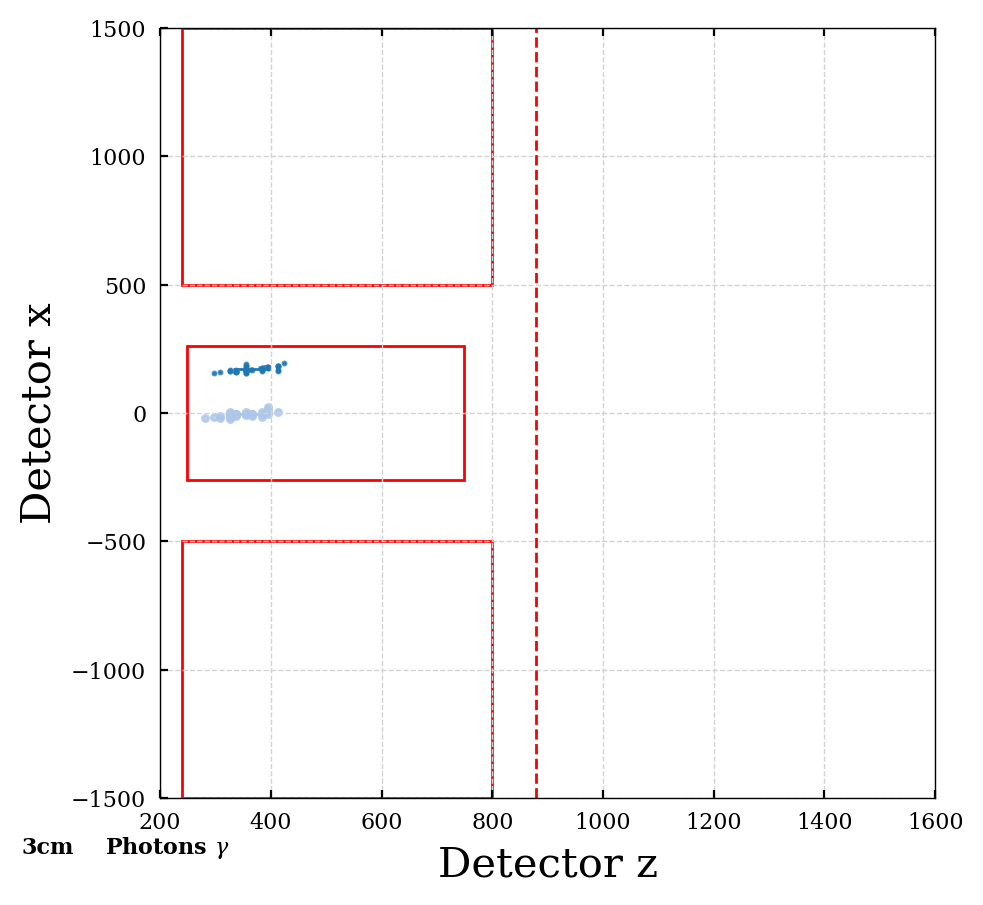

1
[46.3, 4.88, 0.0762, 0.14]


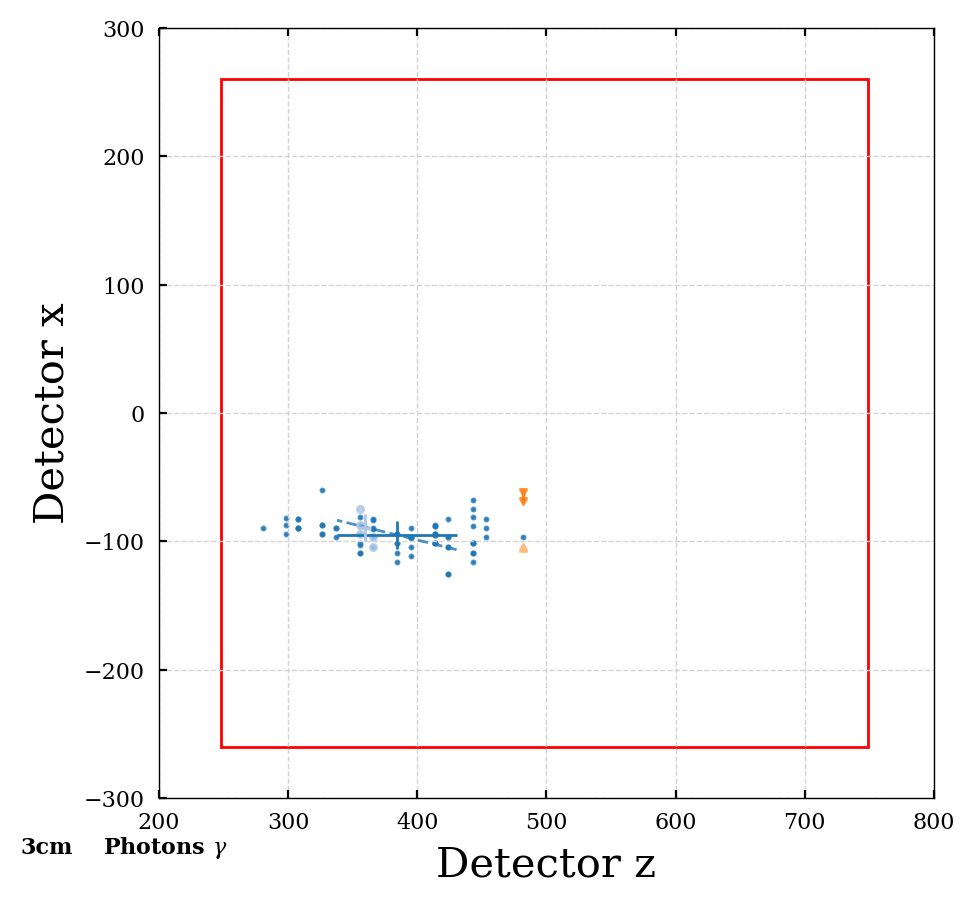

1
[37, 16.8, 12.4, 0.14]


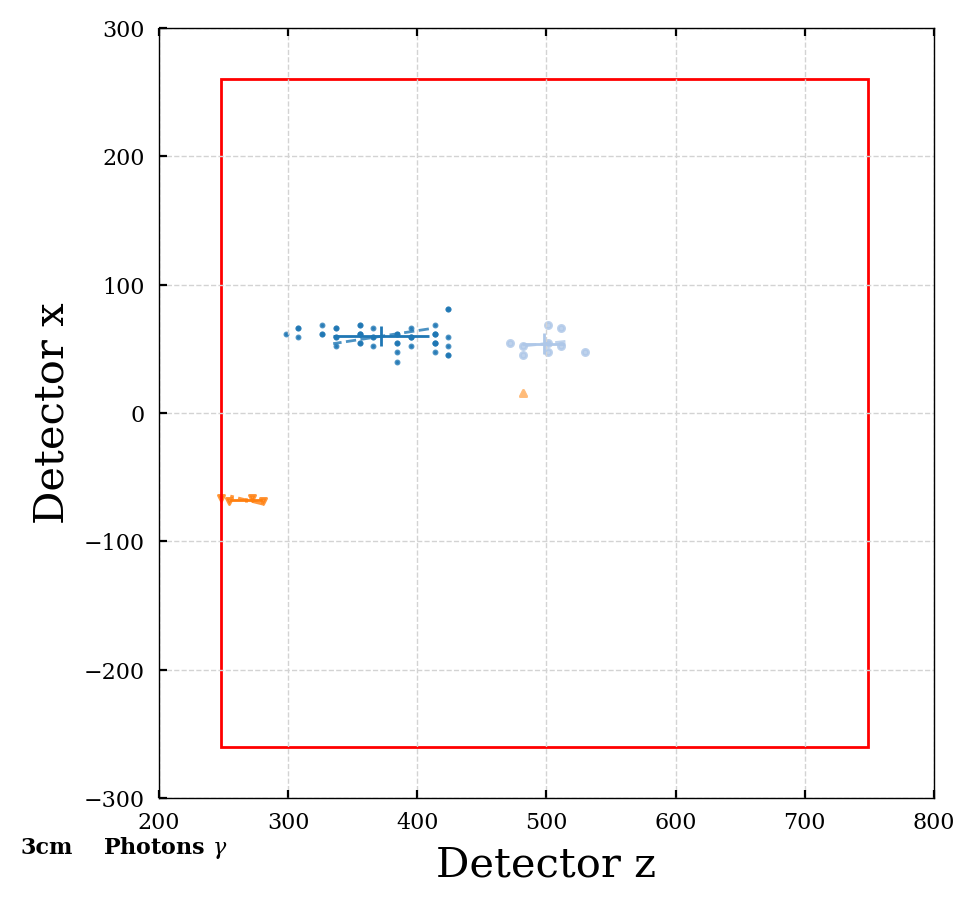

1
[37.3, nan, nan, 5.09, 0.0399, 9.41]


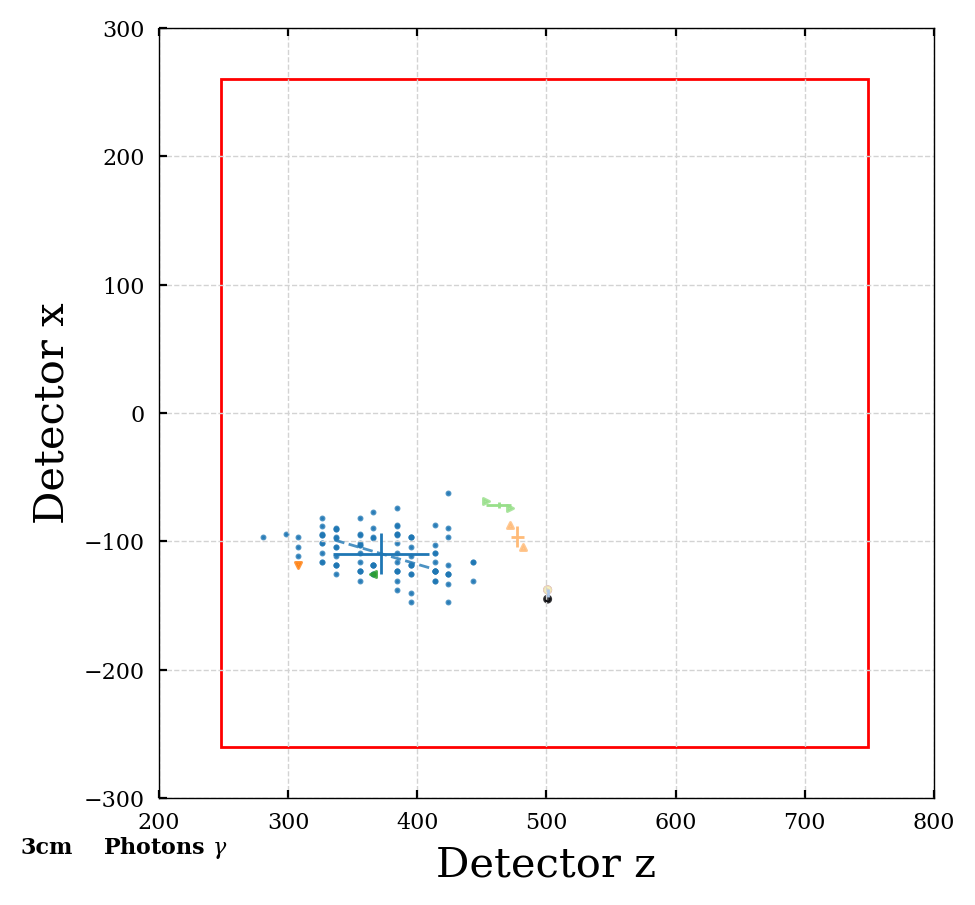

1
[34.7, 17.2, nan, 4.26, nan]


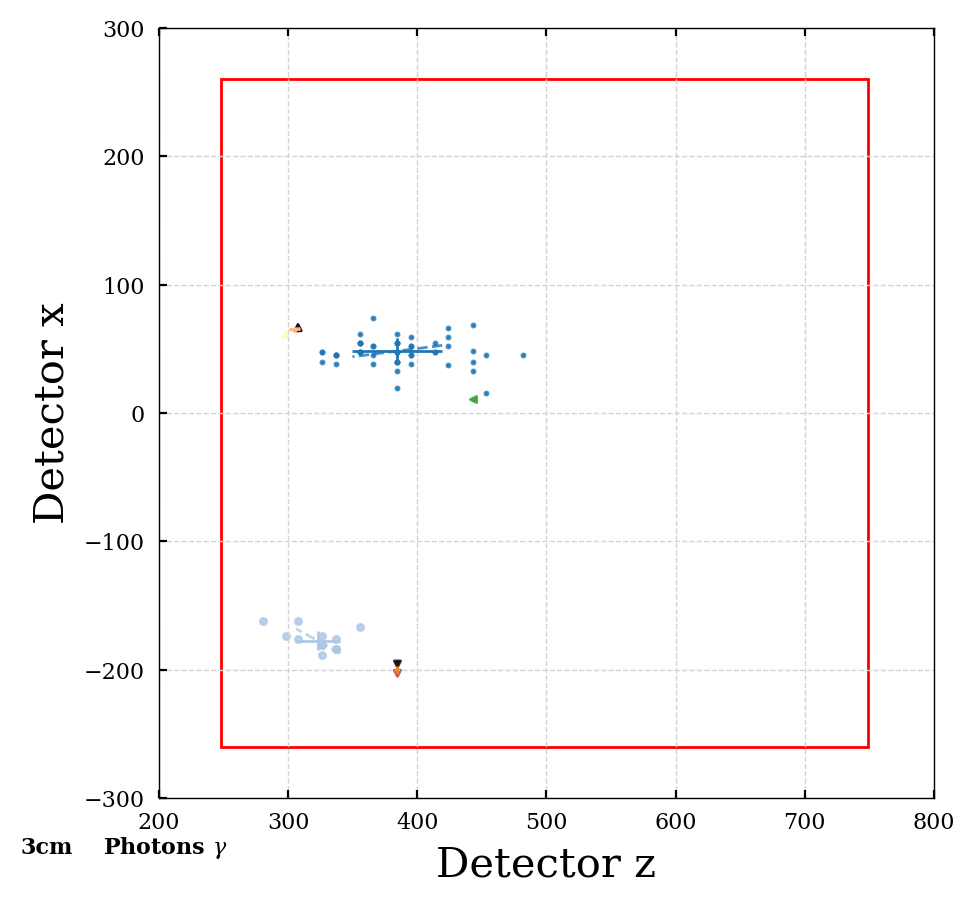

2
[41, 32.1, 4.96, nan, 0.159, nan, nan, 8.59]


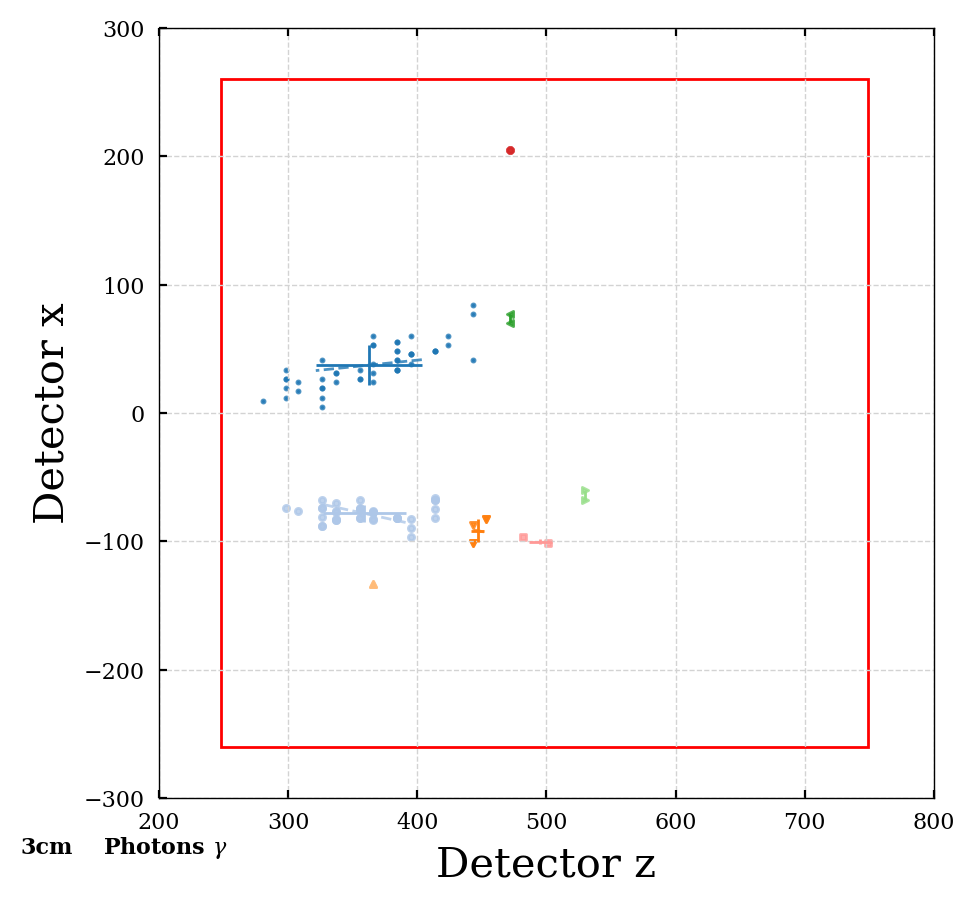

1
[36, 0.0632, 9.39, 12.4, 19.4, nan, nan, nan, nan, 0.0961]


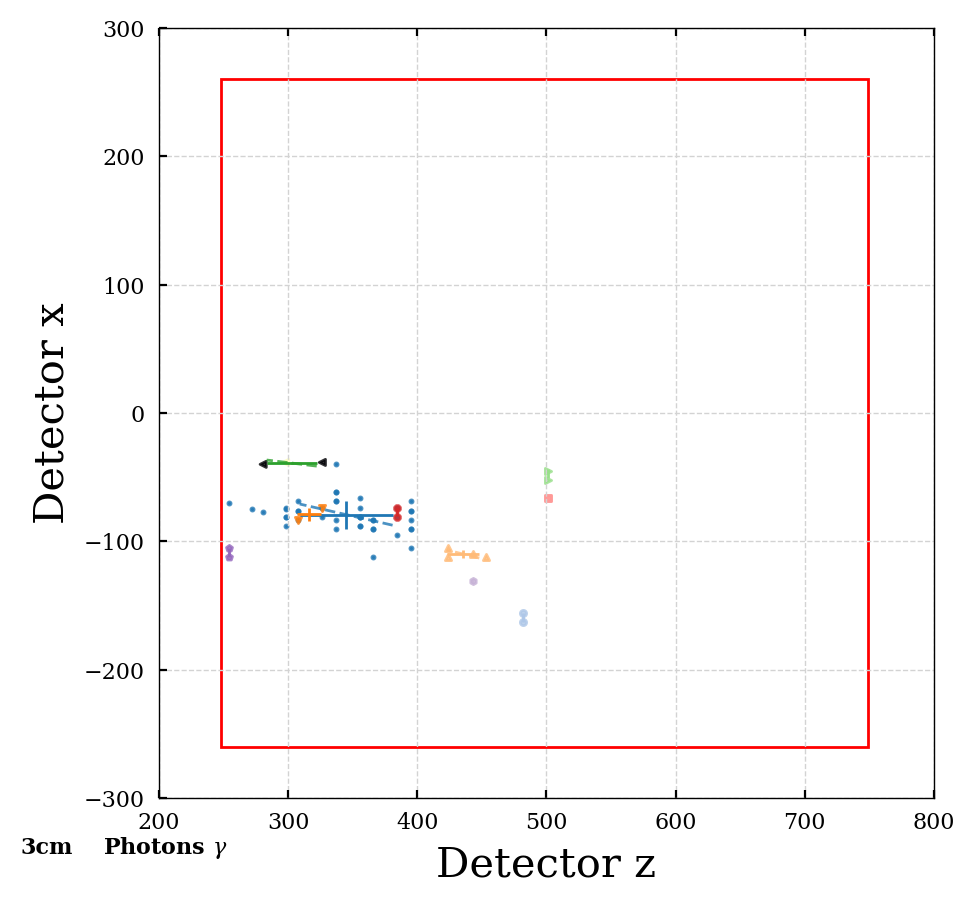

2
[47.9, 40.8, 0.0961, 0.0878, 0.14, 0.0373]


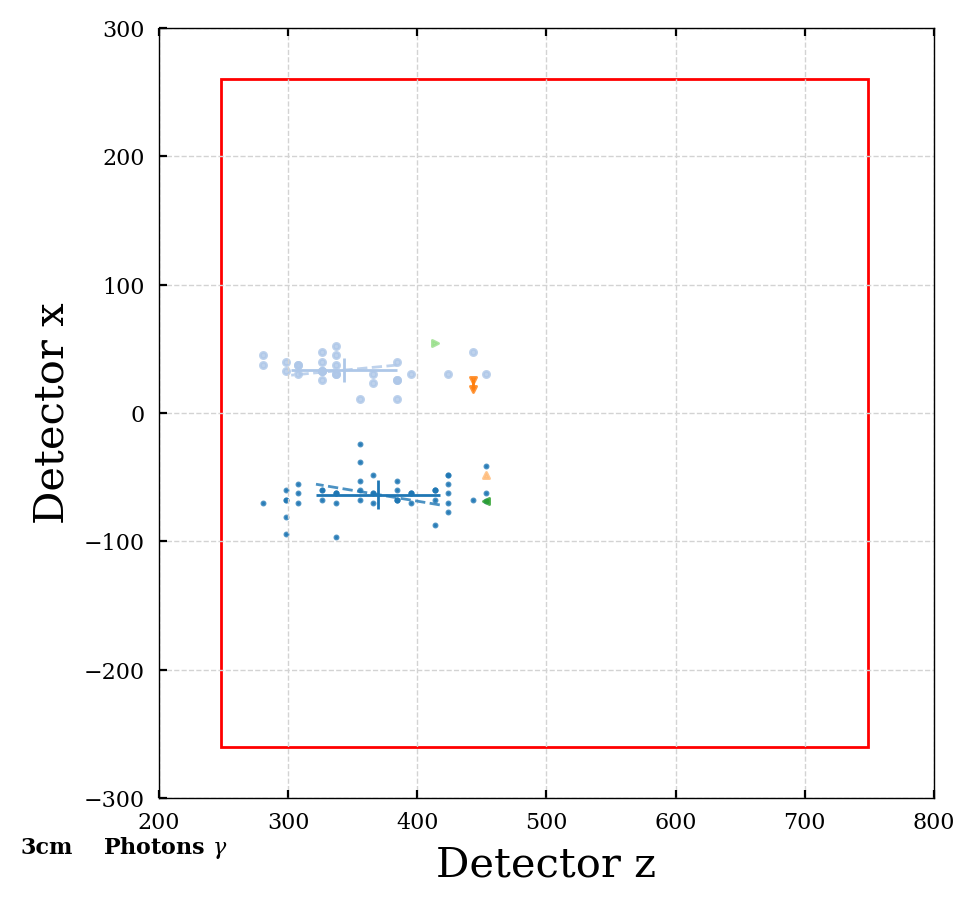

0
[17.2, 21.1]


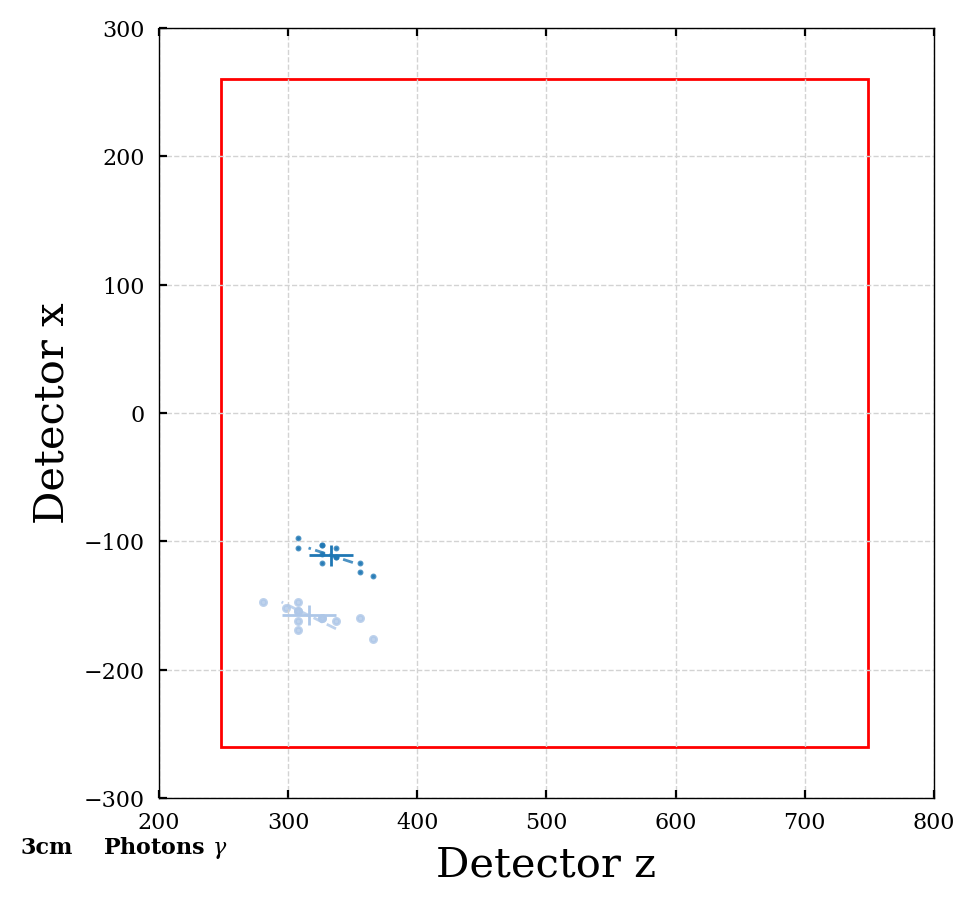

1
[46.7, nan, 5.05, nan, 5.07, 14.5, nan, nan]


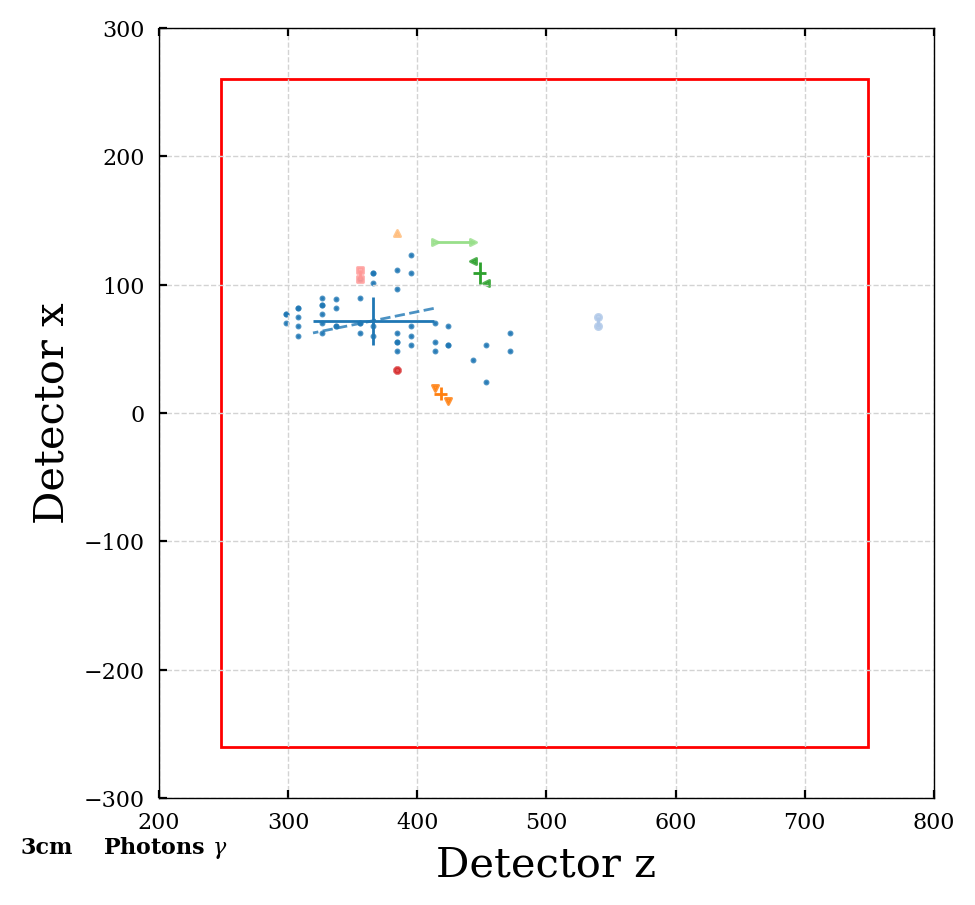

2
[32.7, 44.1, nan, nan, 9.42, nan, nan]


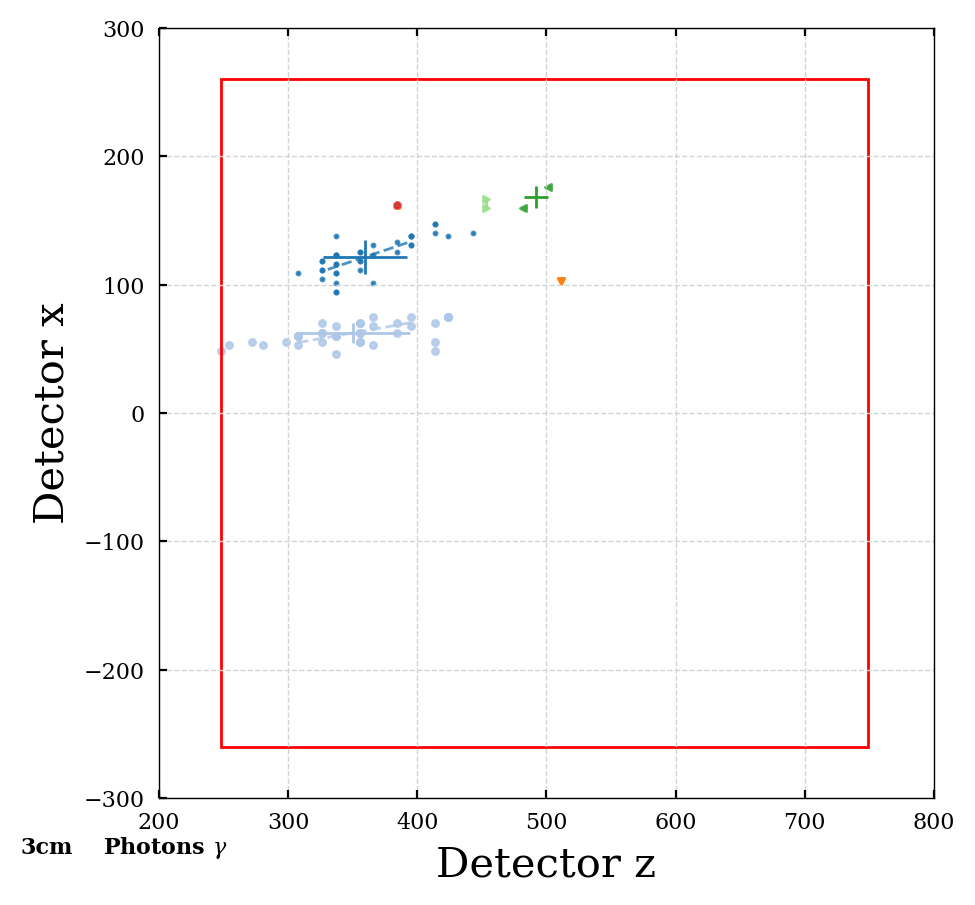

In [43]:
plot_cluster_dist(particles_dict_3cm, 3, spec_part='photons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_3cm, 3, spec_part='photons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[33.8, 34.7]


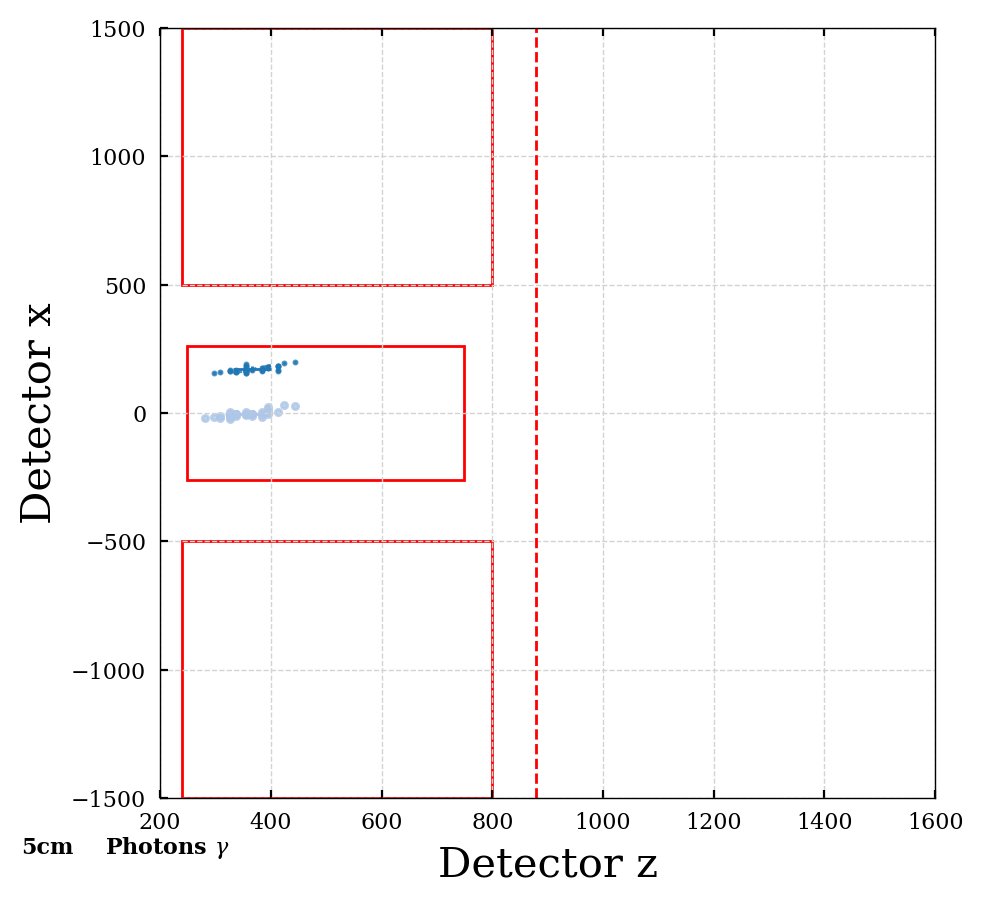

1
[52.2, 28.2, nan]


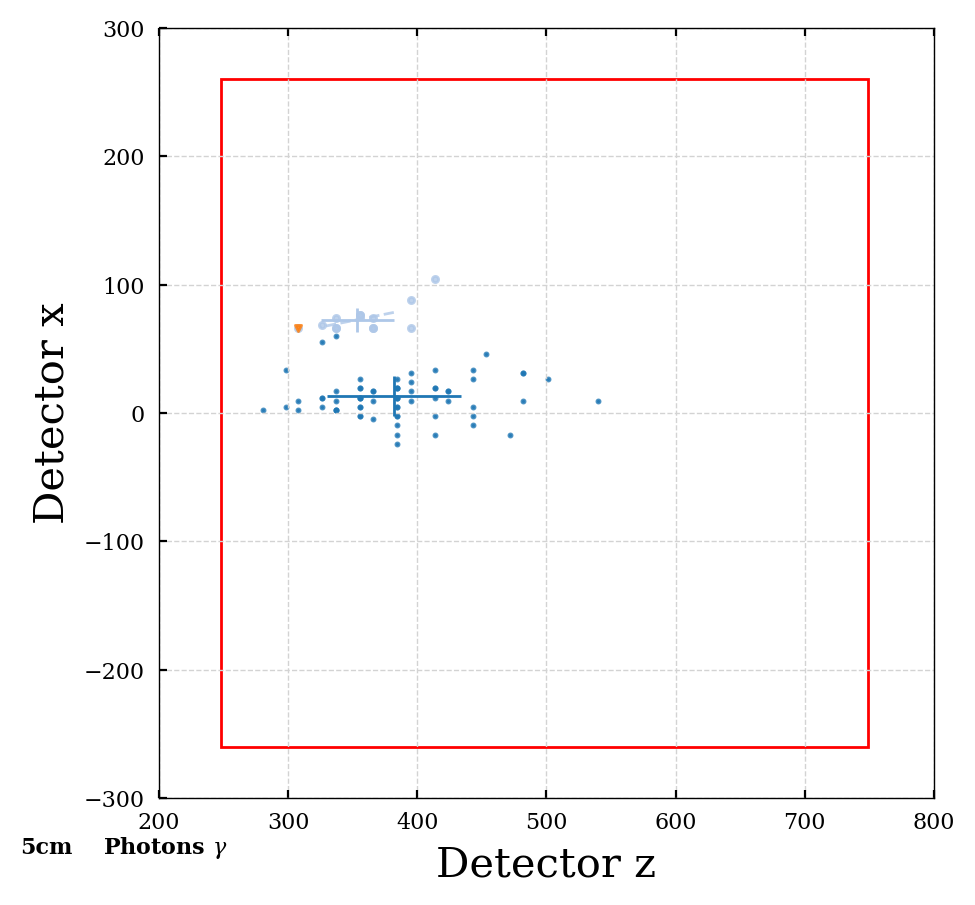

1
[49.6, 40.3, nan, nan]


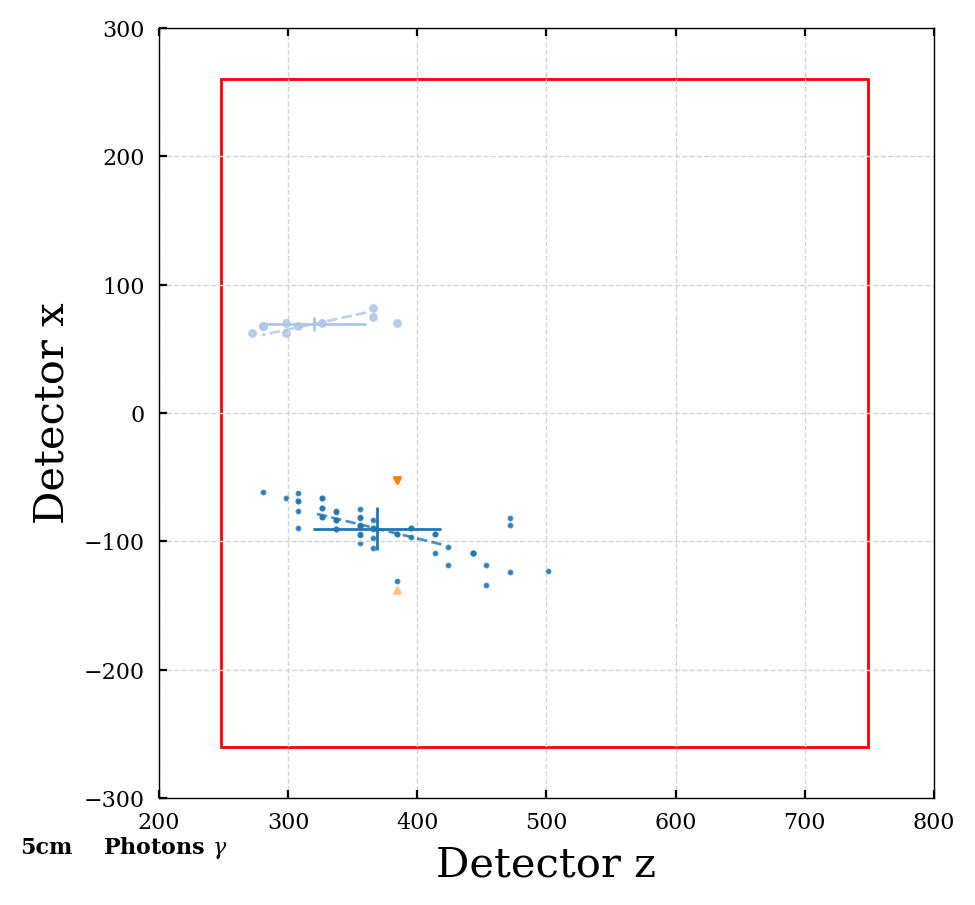

2
[48.7, 33.8, 0.14]


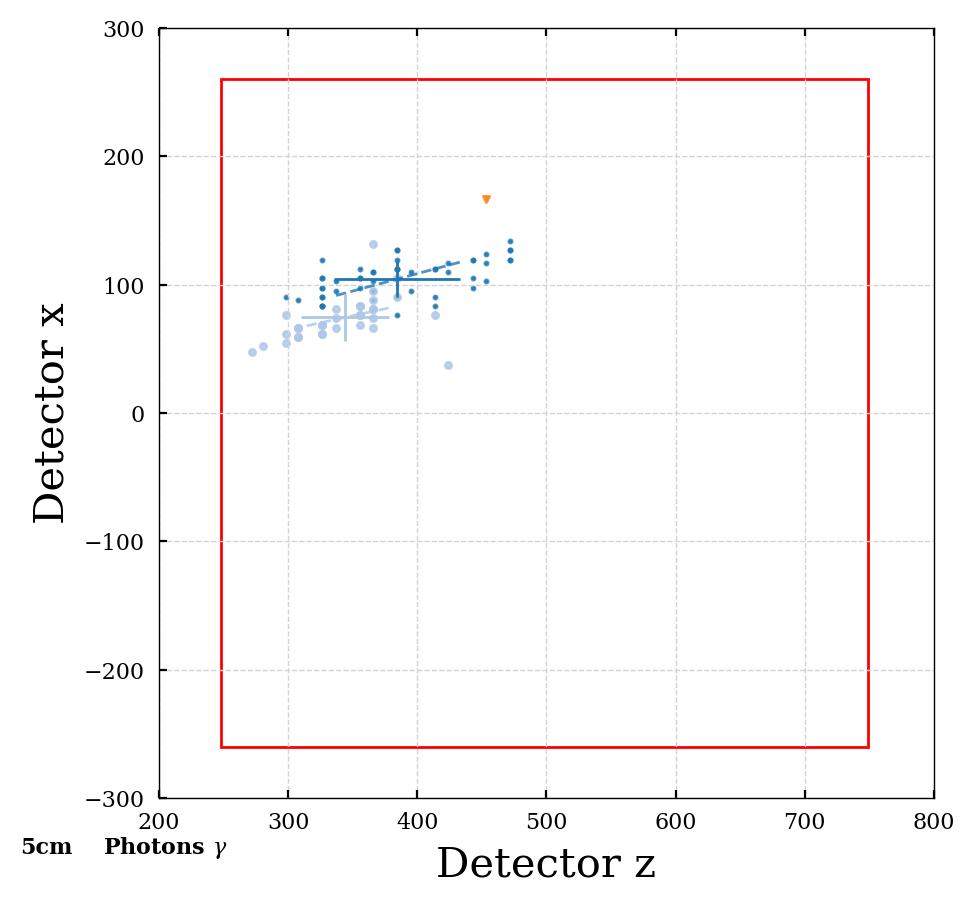

2
[34.6, 39.6, 0.0878]


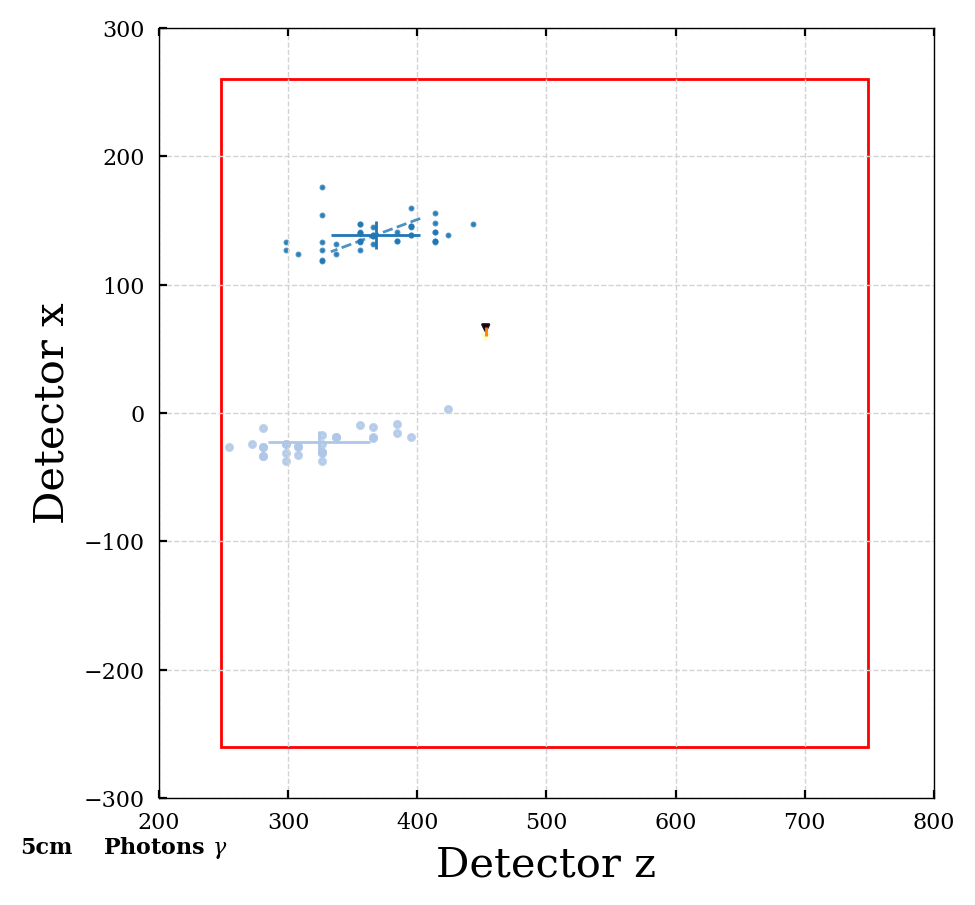

1
[40.5, 11.9]


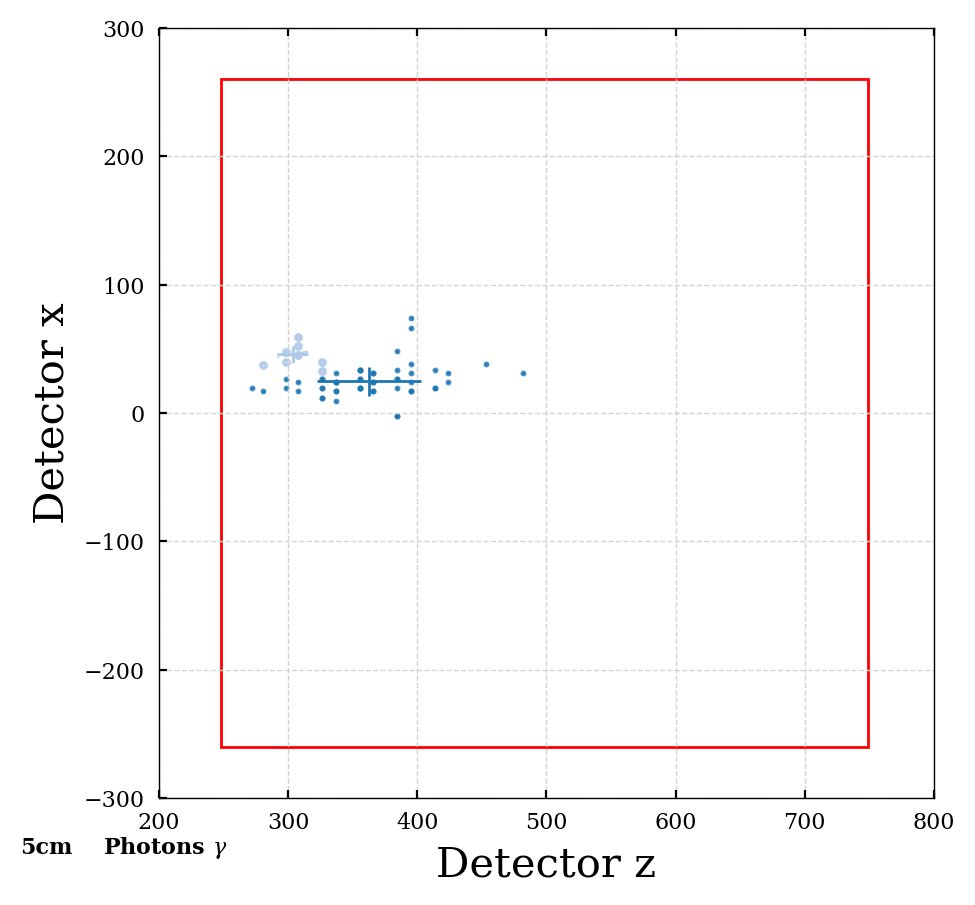

1
[45.8, 0.13]


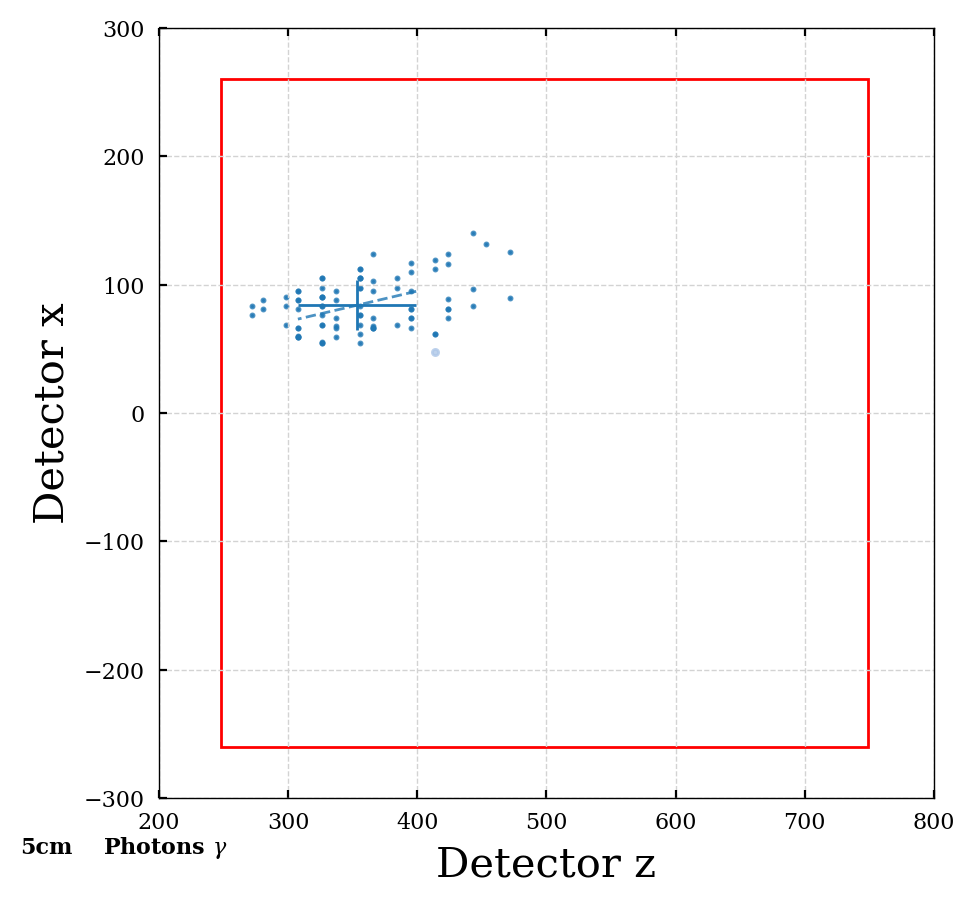

1
[39.7, 10.2, nan]


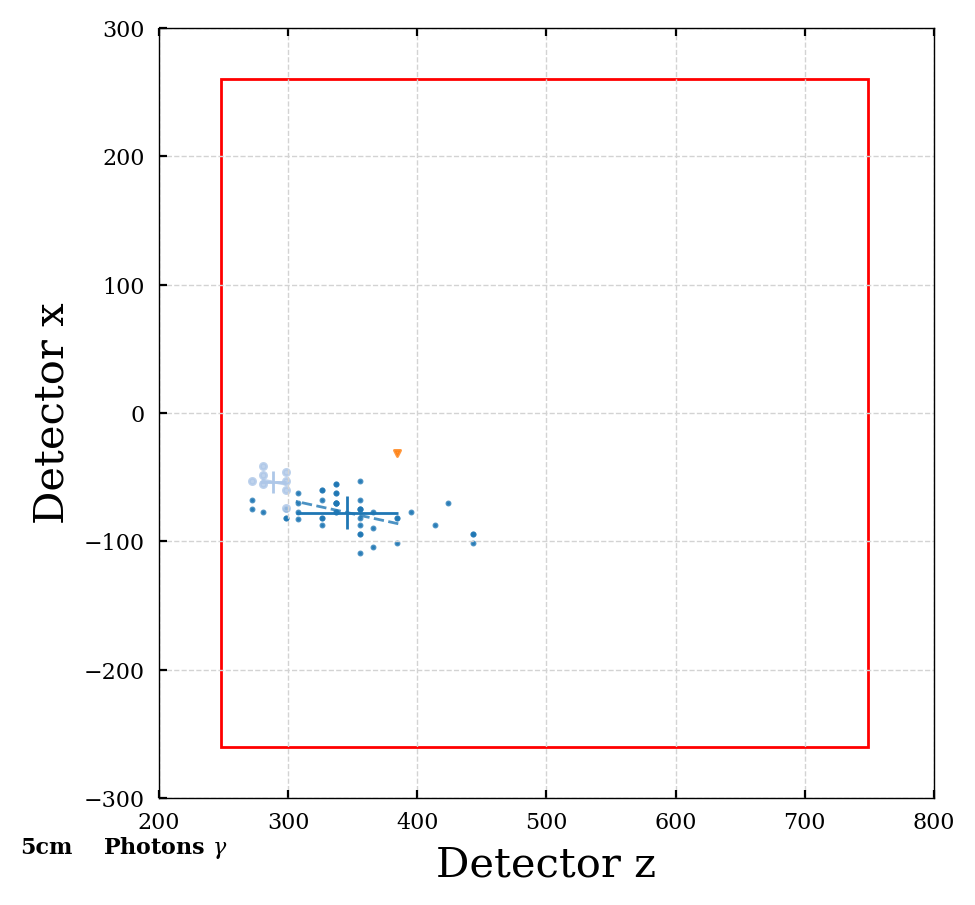

1
[35.3, 10.2, 11.9]


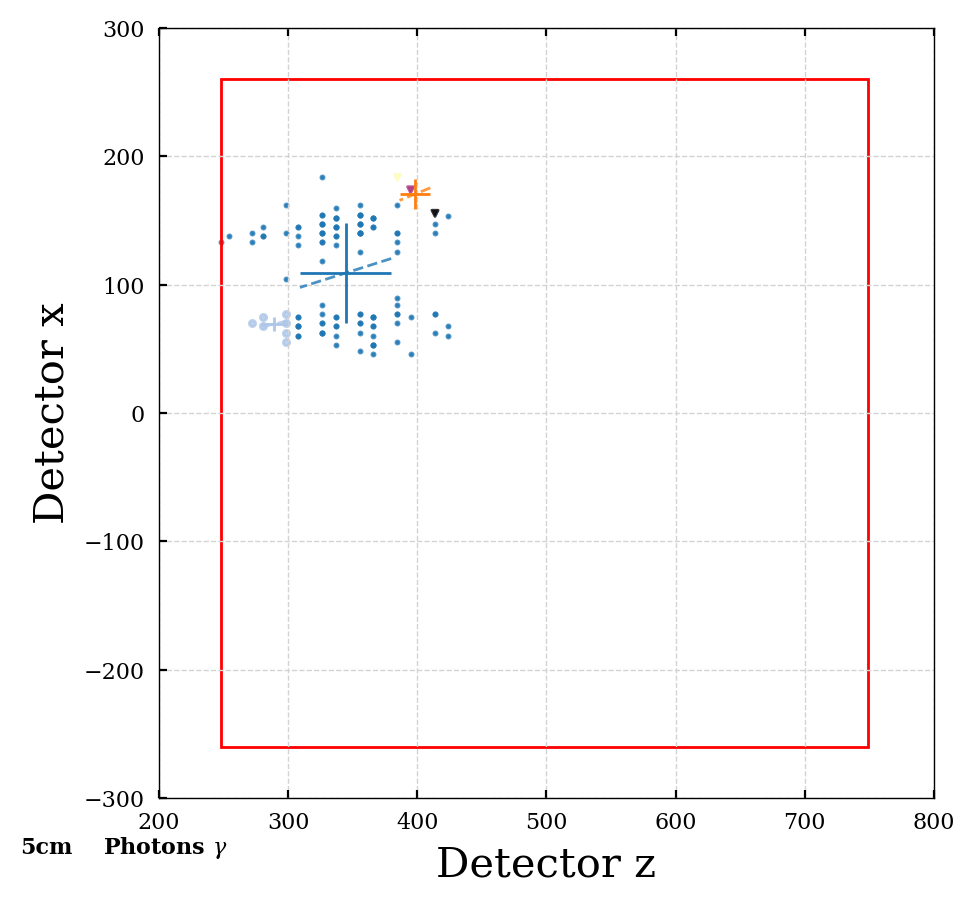

1
[45, 11.4, 5.06, nan]


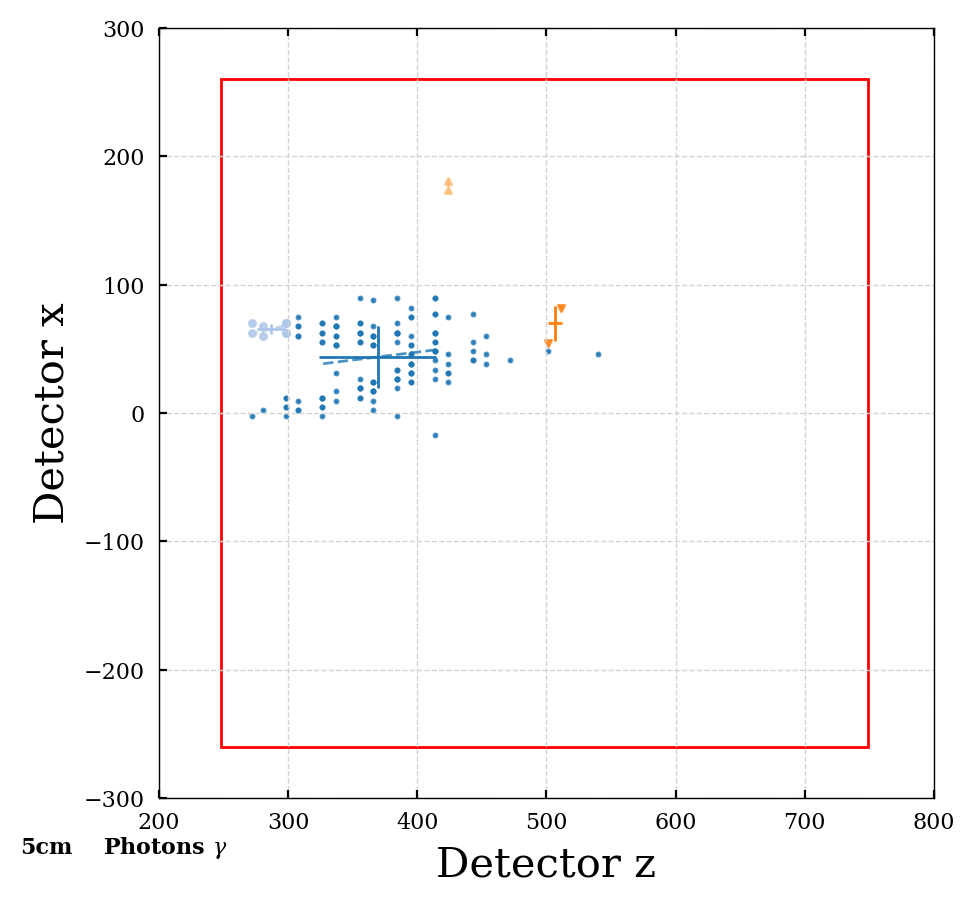

2
[45.6, 15.3, 0.16]


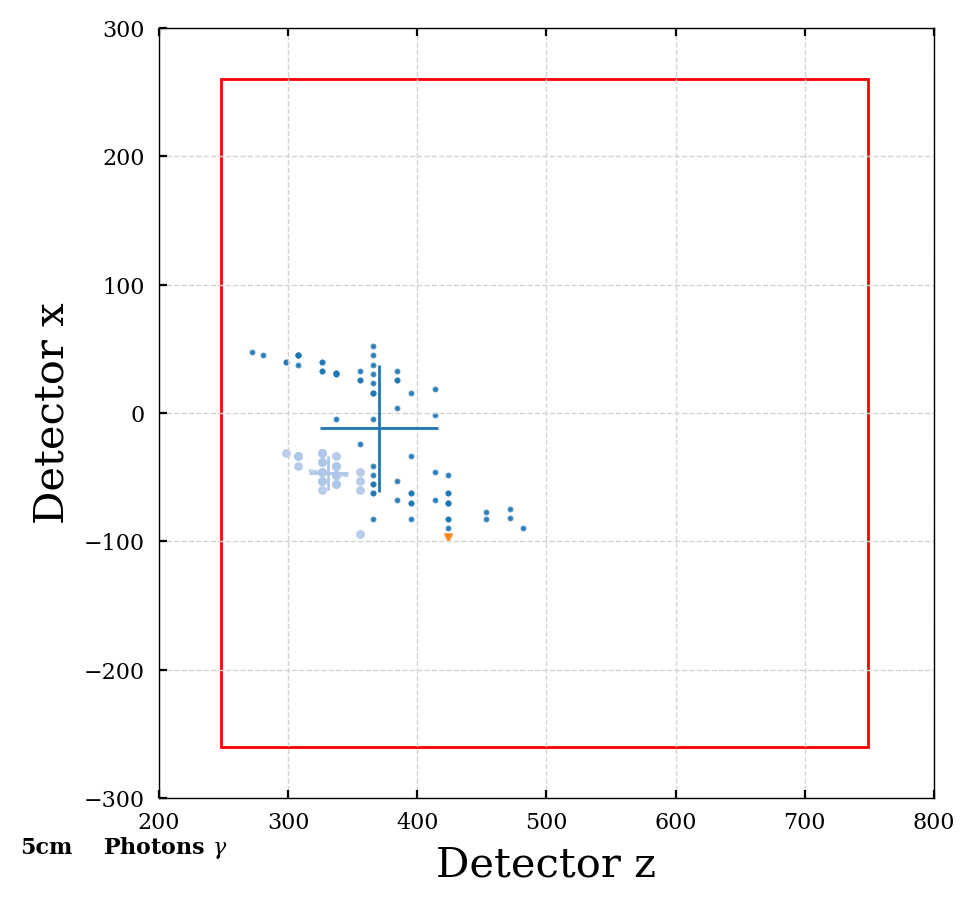

In [44]:
plot_cluster_dist(particles_dict_5cm, 5, spec_part='photons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_5cm, 5, spec_part='photons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

3
[35, 24.3, 16.6, 0.0878, 0.0961]


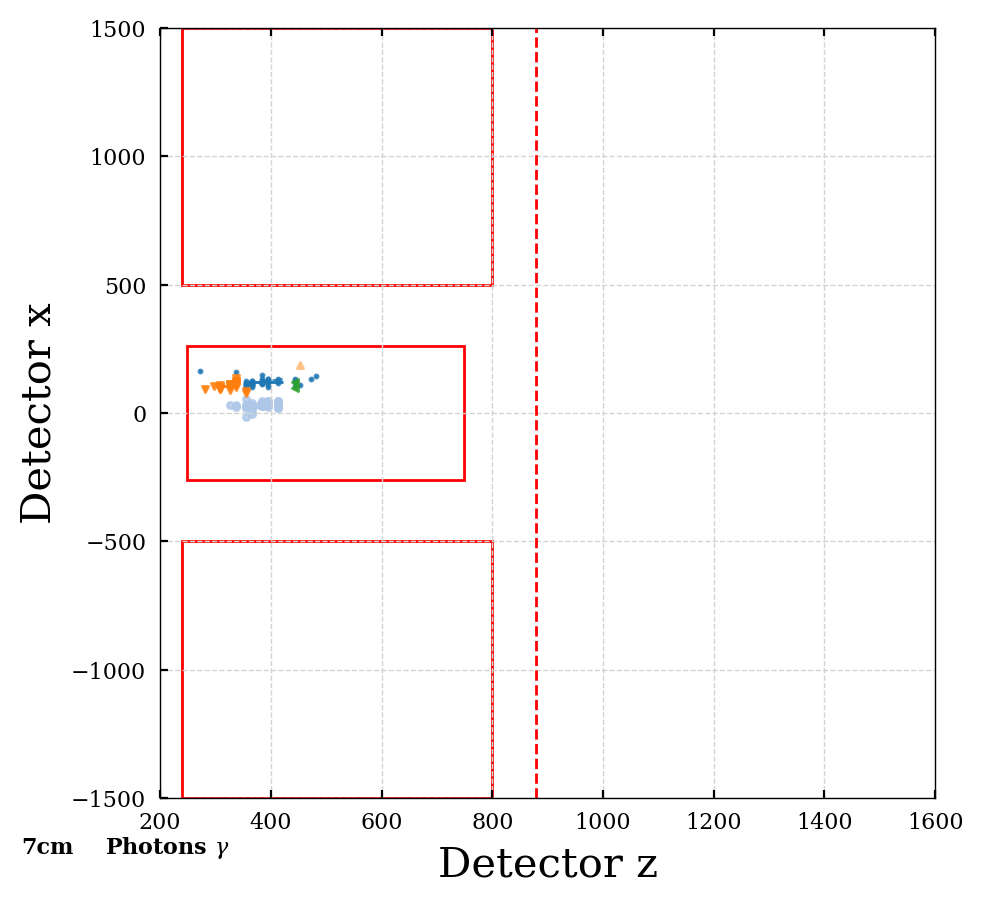

2
[50.8, 48.1, 0.0961, 0.0235]


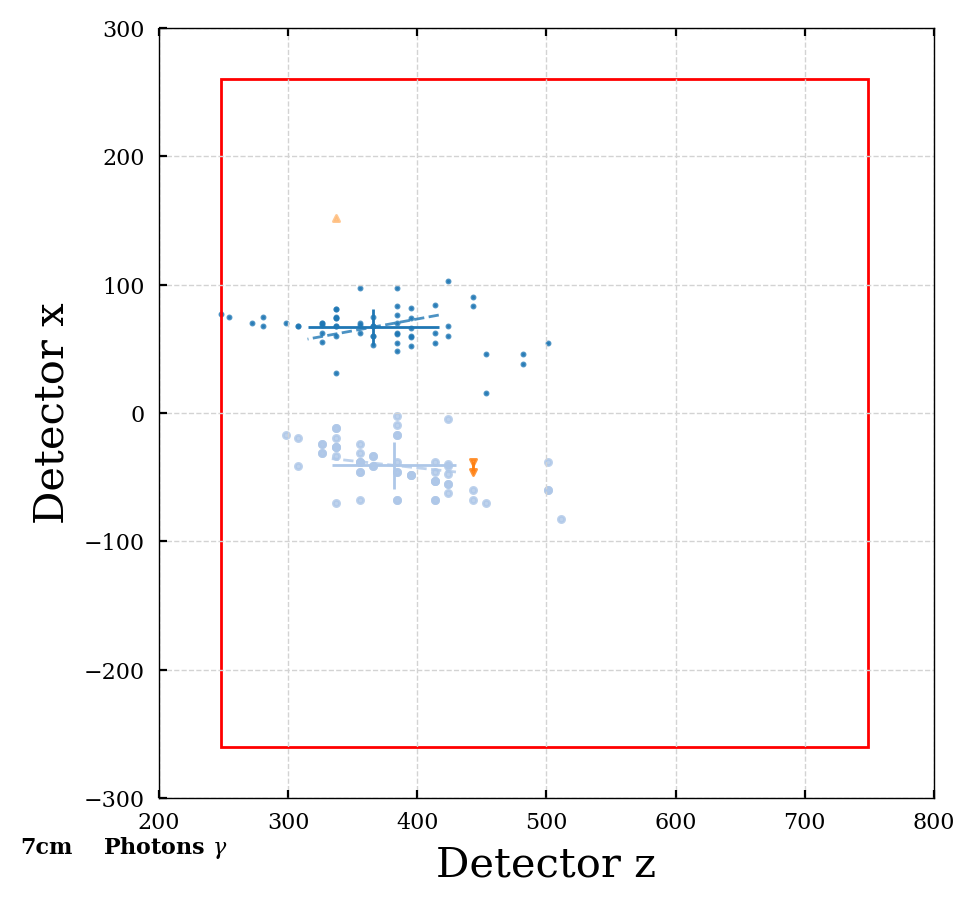

1
[38.1, 18.3]


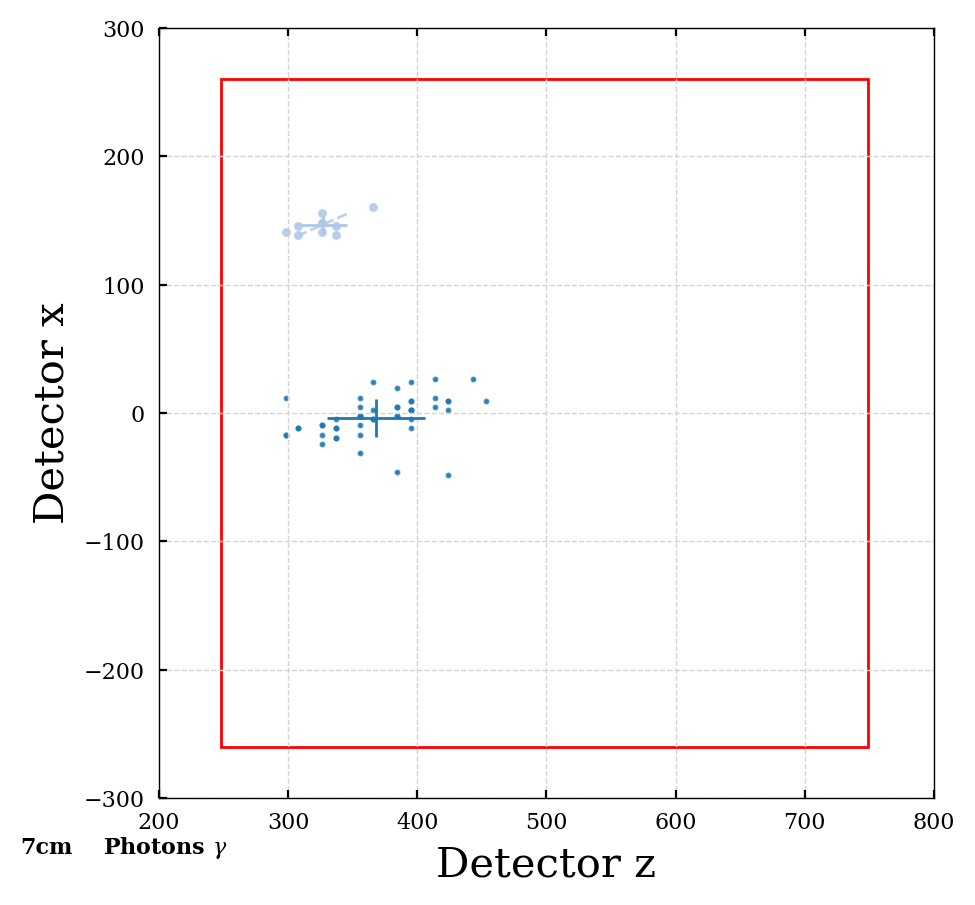

1
[49.9]


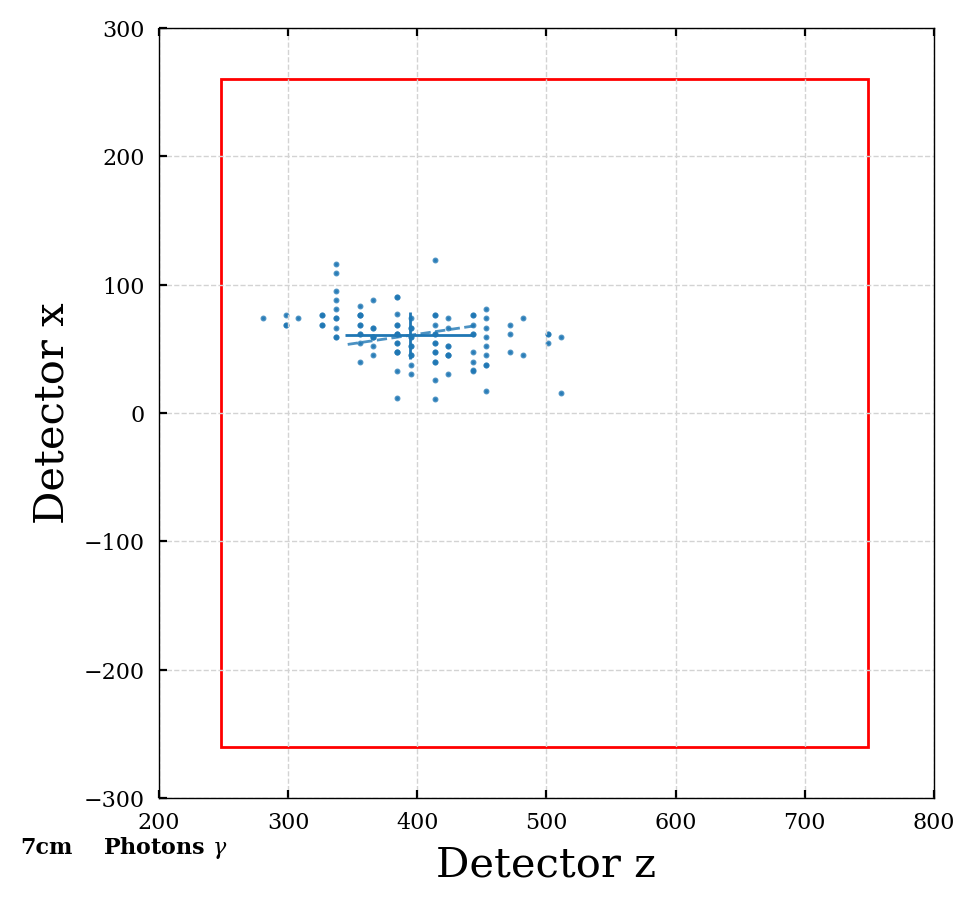

2
[40.9, 41.8]


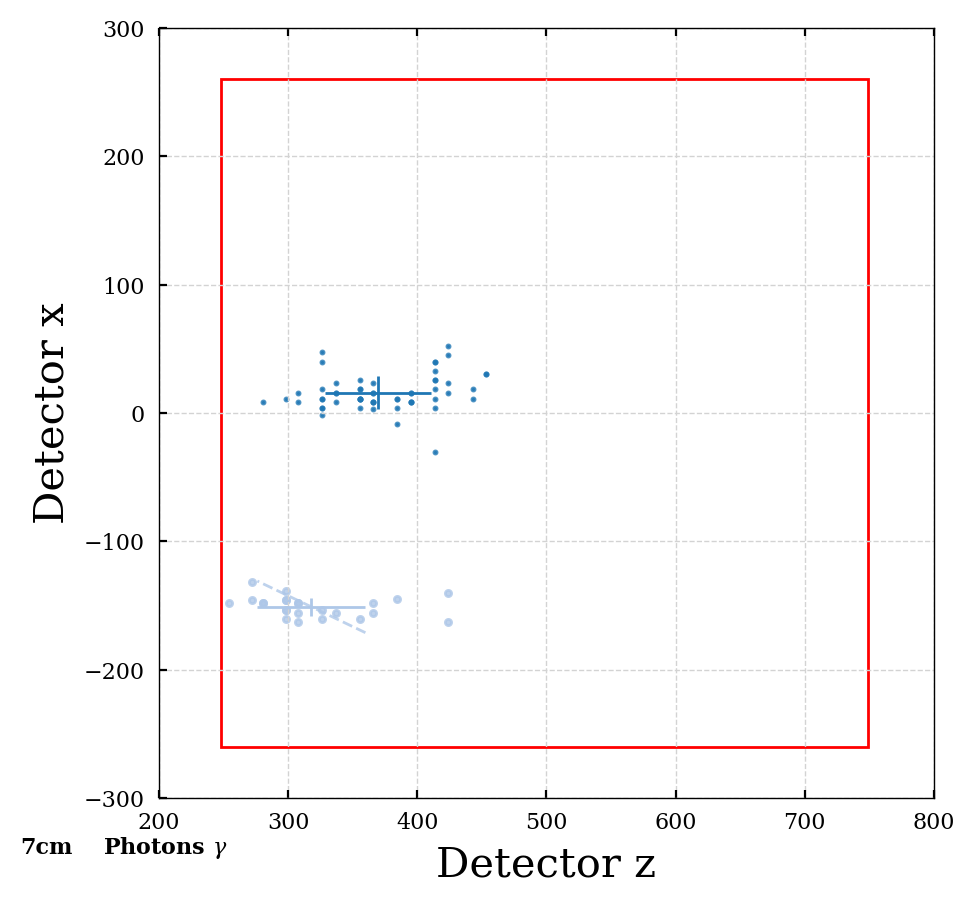

1
[47.2, 21.2]


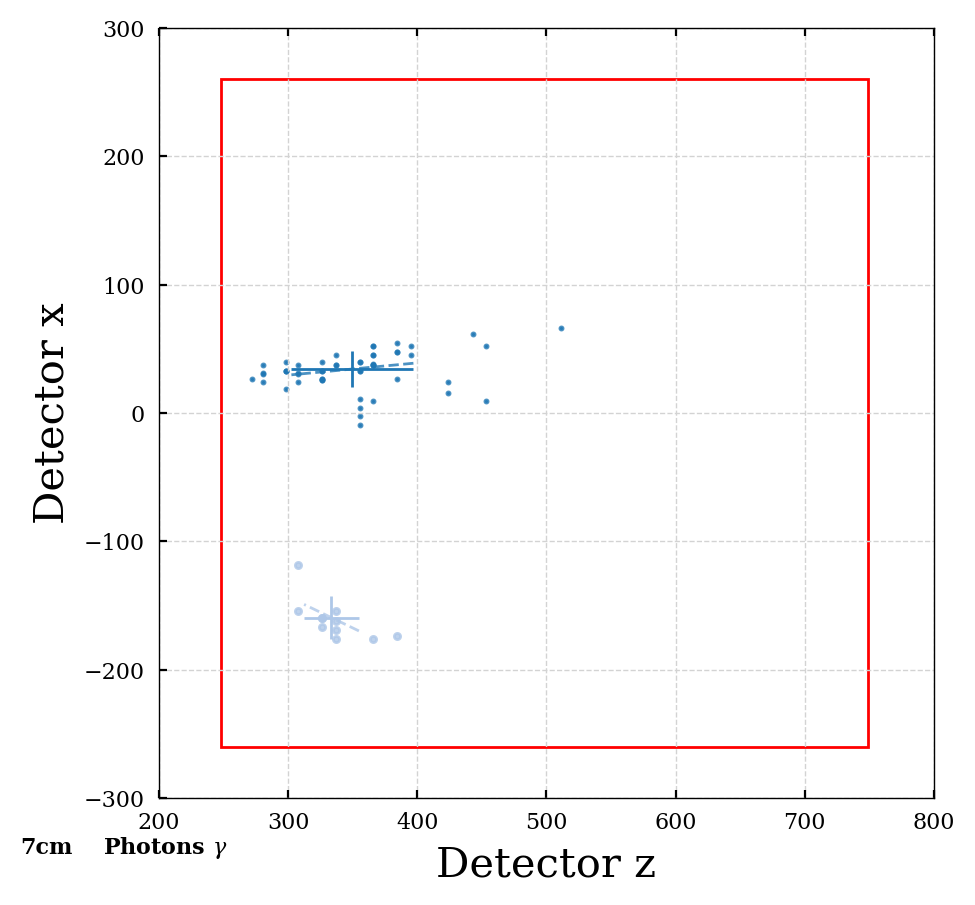

2
[31.4, 36.7, 0.0988]


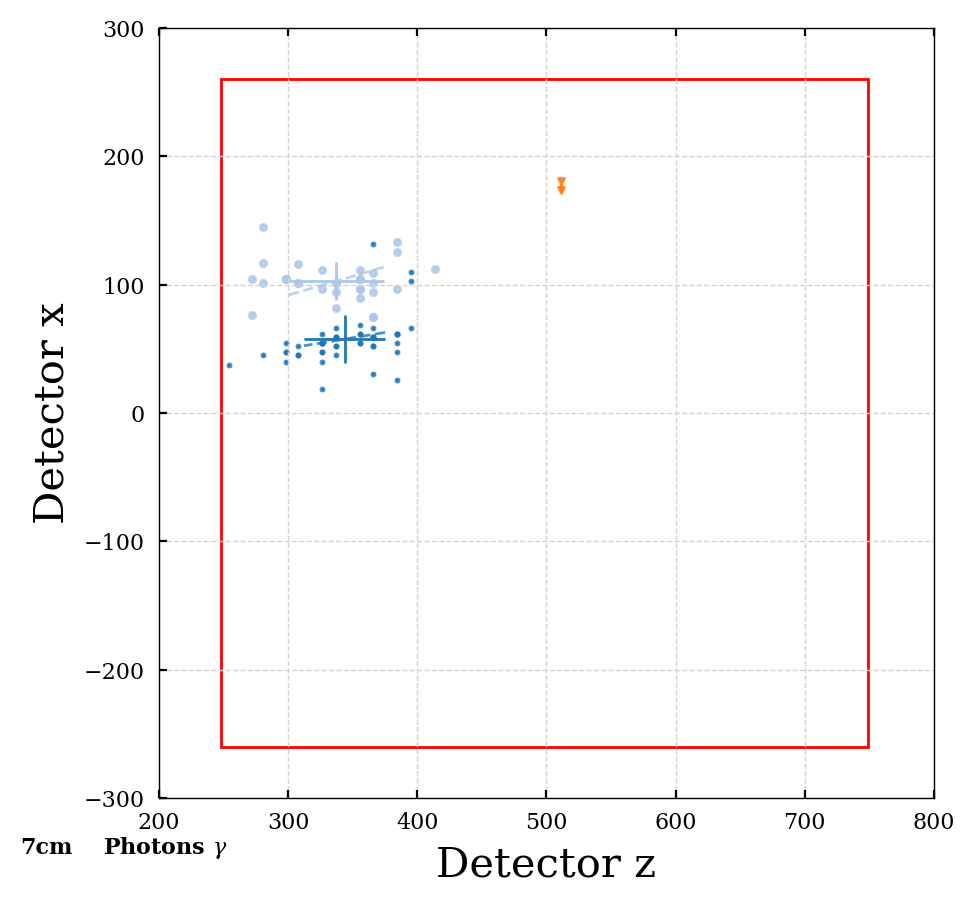

1
[42.7, 27.9]


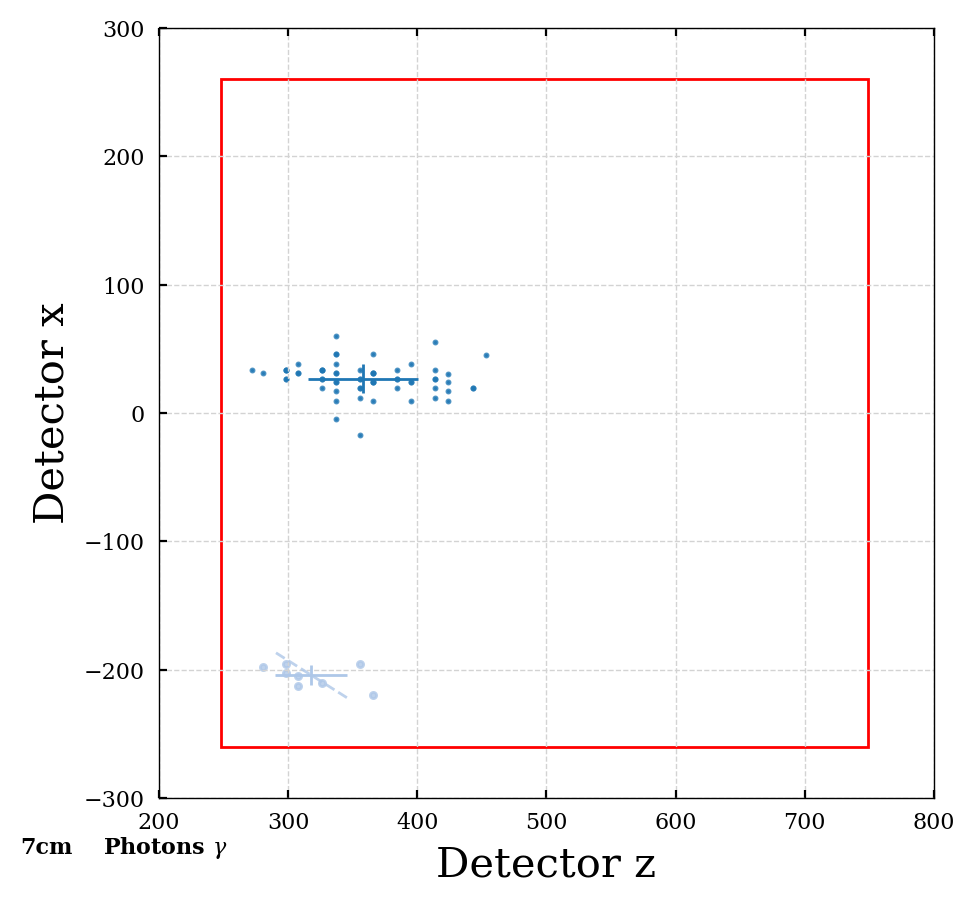

2
[34.3, 49.9]


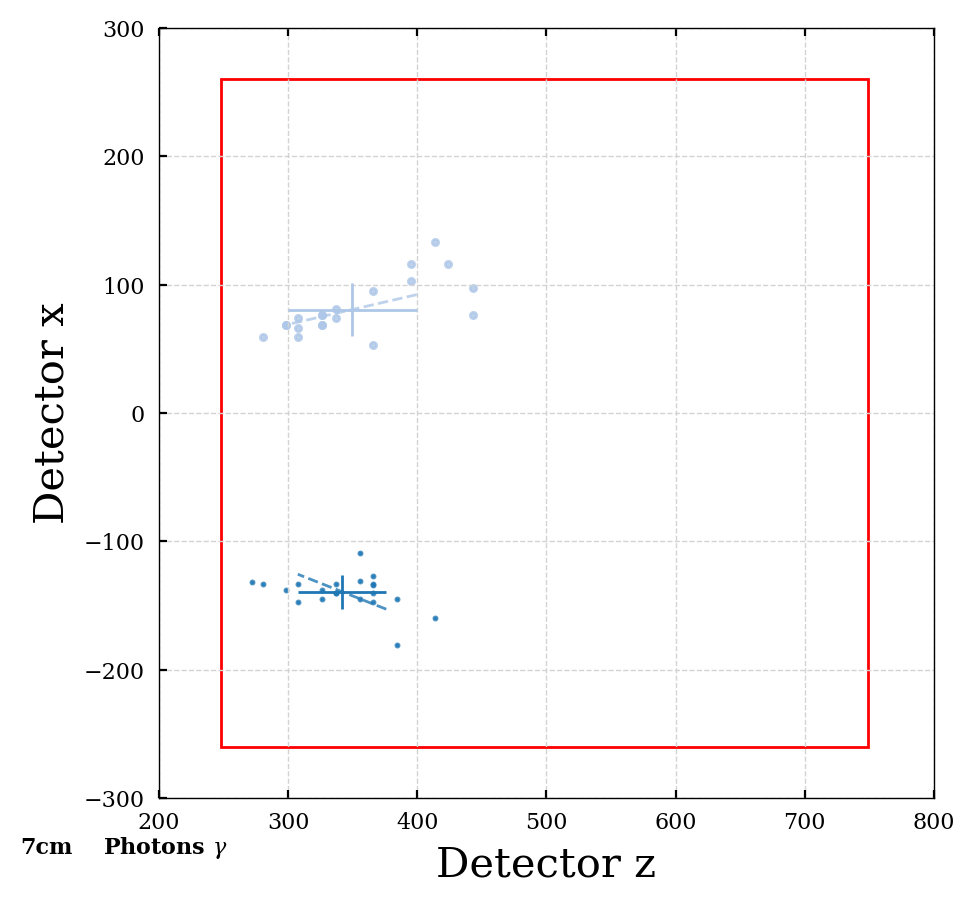

2
[45.1, 52.9, 23.6]


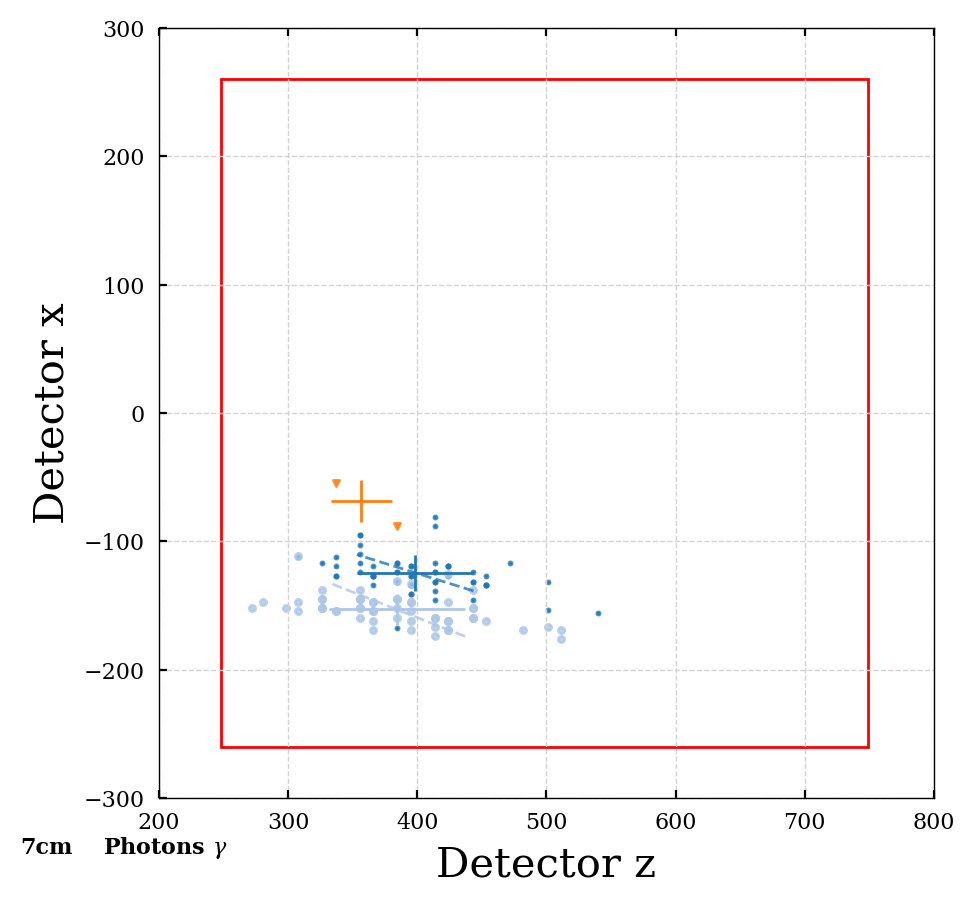

2
[38.4, 27.4]


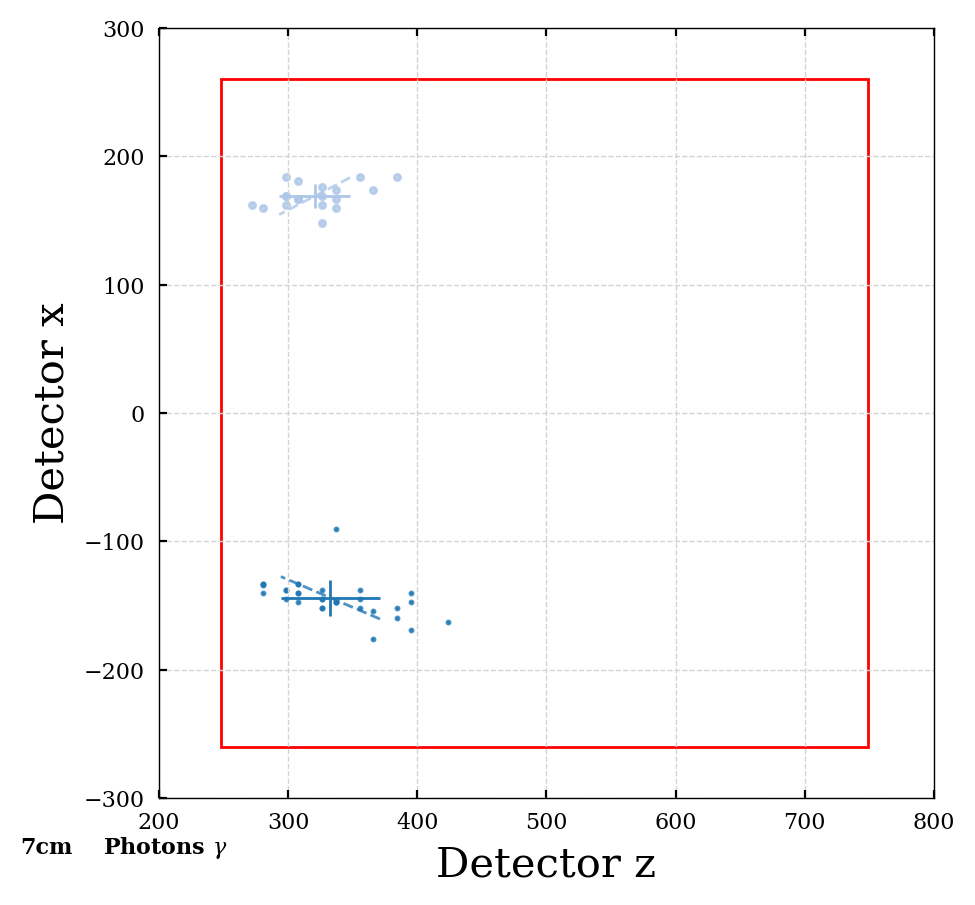

In [45]:
plot_cluster_dist(particles_dict_7cm, 7, spec_part='photons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_7cm, 7, spec_part='photons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

3
[51.4, 19.1, 16.3]


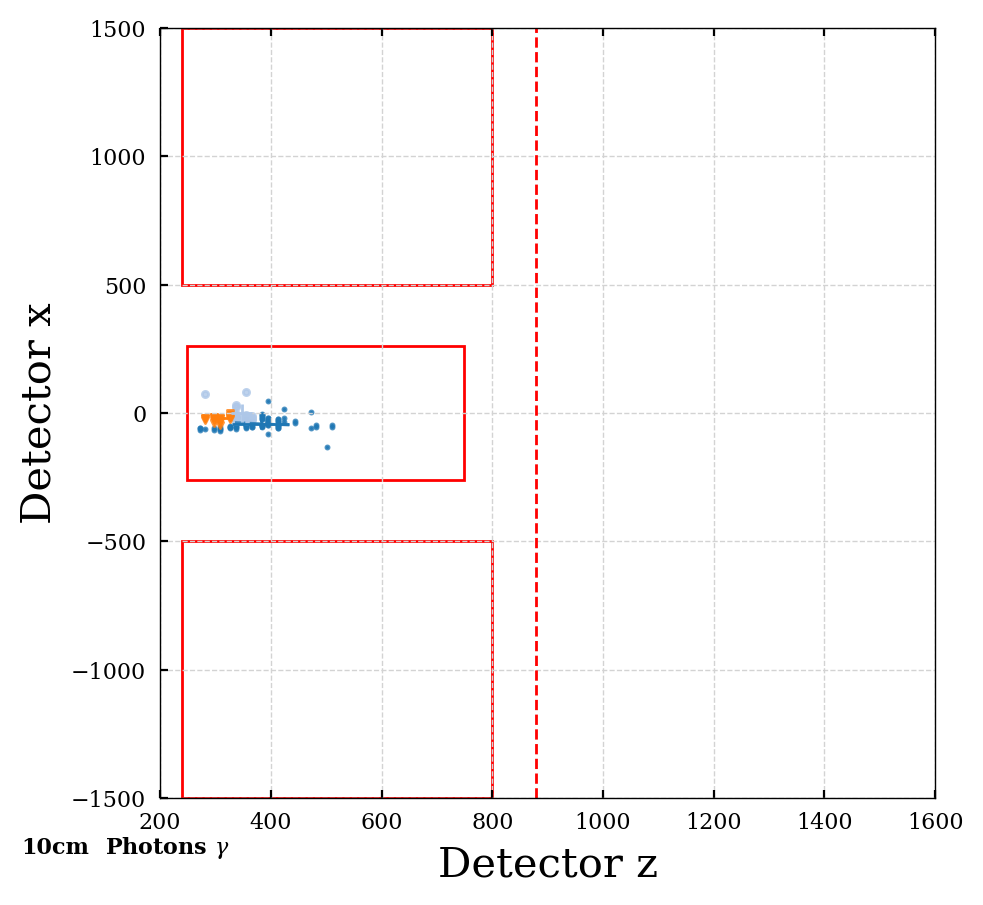

2
[22.7, 65, 5.08]


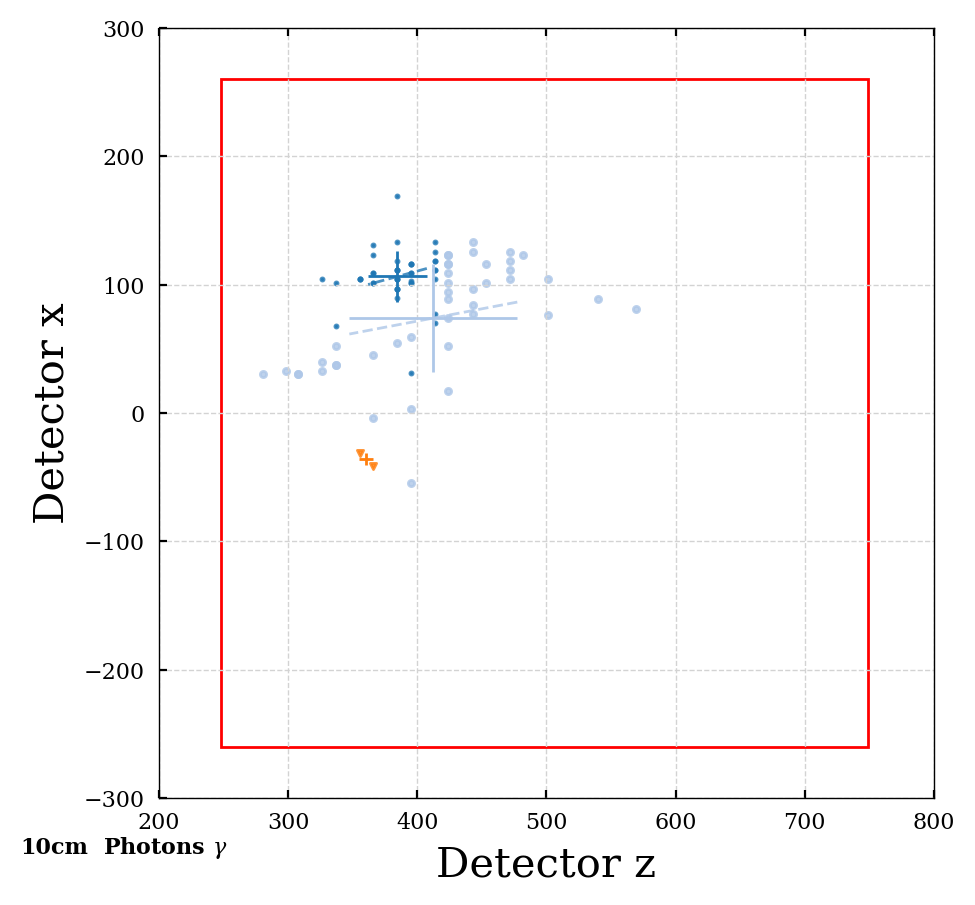

1
[30.3, 20.6]


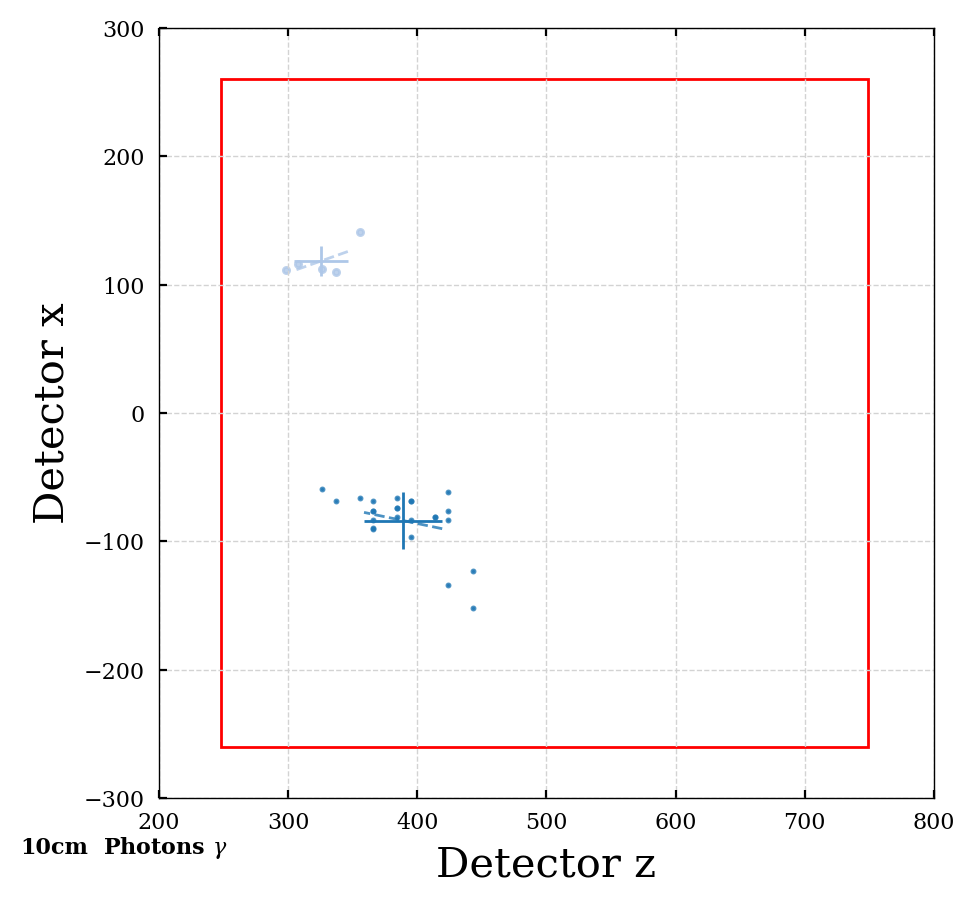

1
[64.7, 26.8]


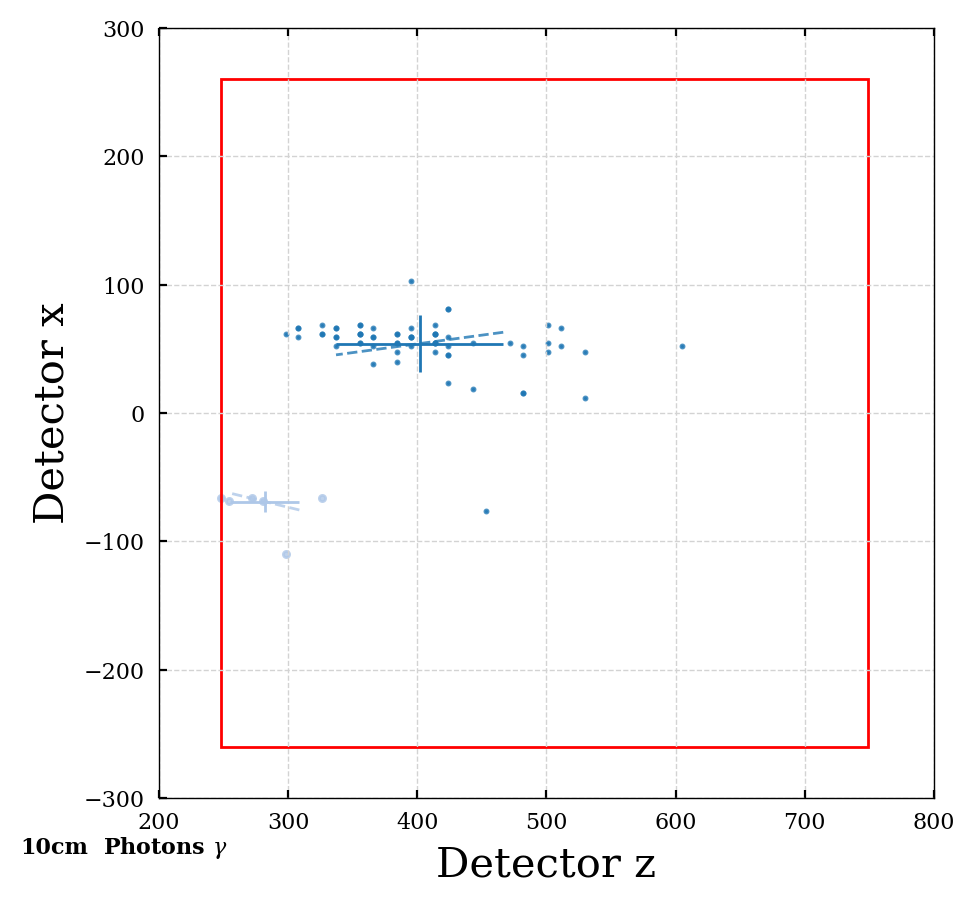

1
[57.2]


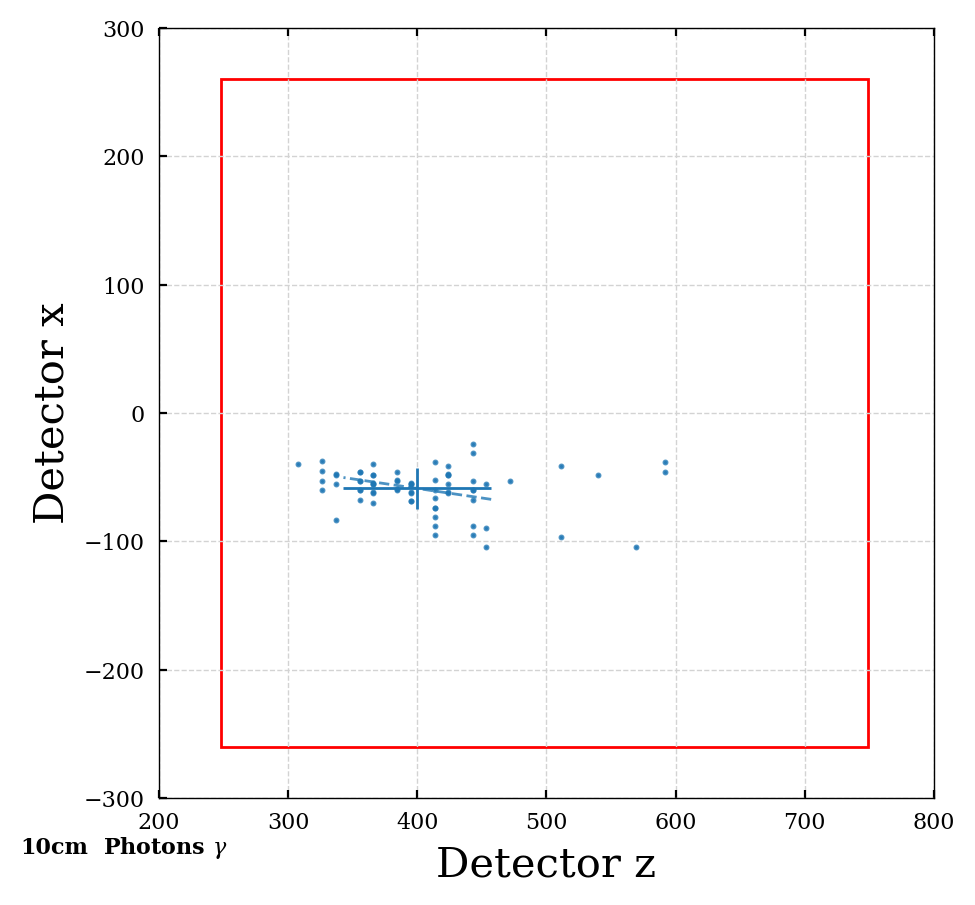

1
[53.6]


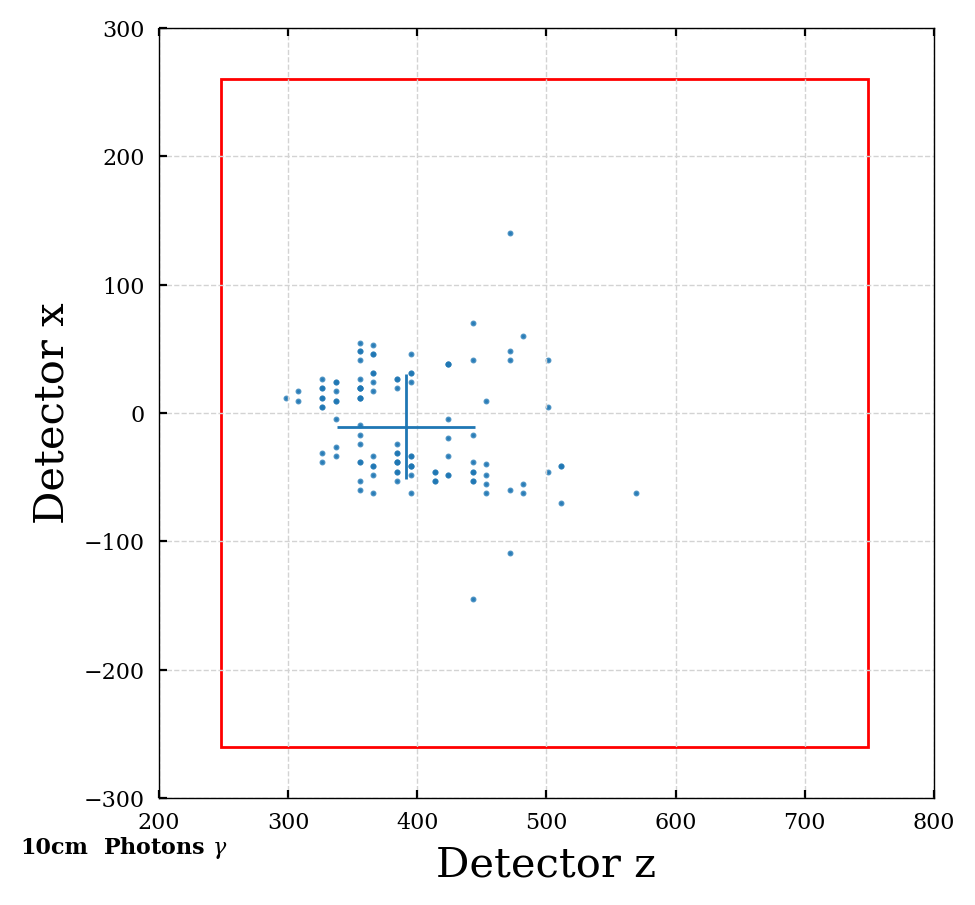

1
[55.4]


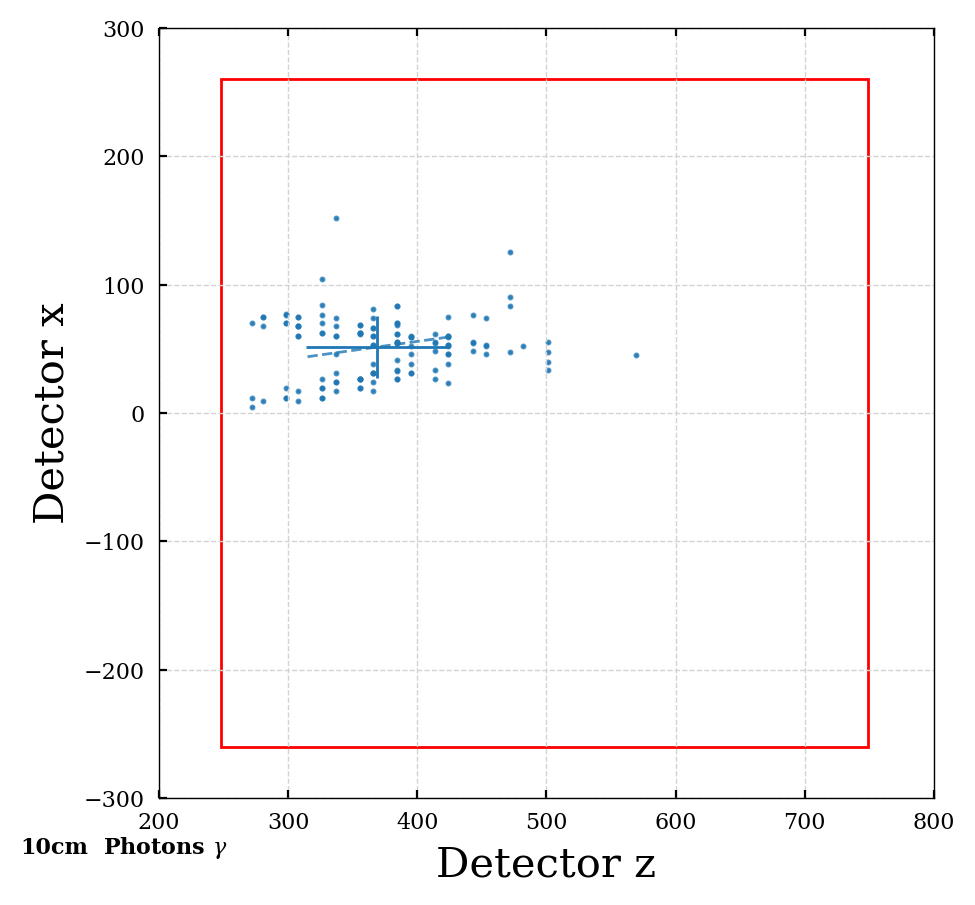

2
[56.4, 22.5]


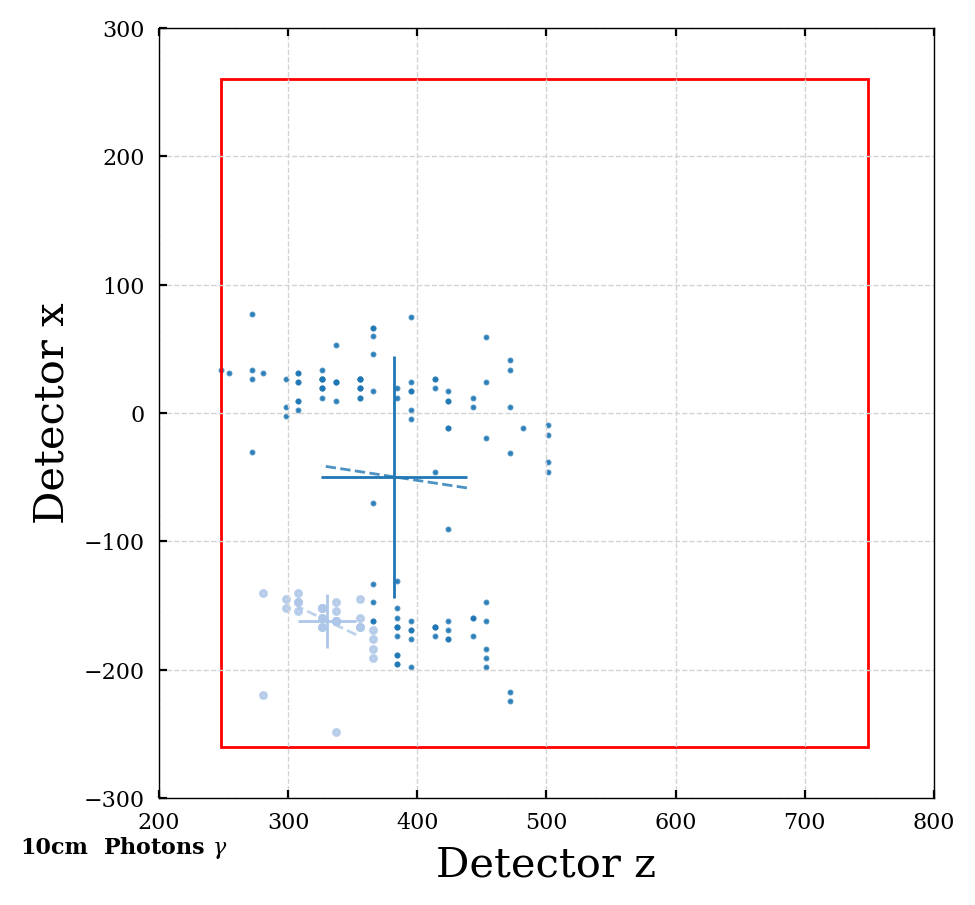

1
[52.1, 4.49, 0.0235]


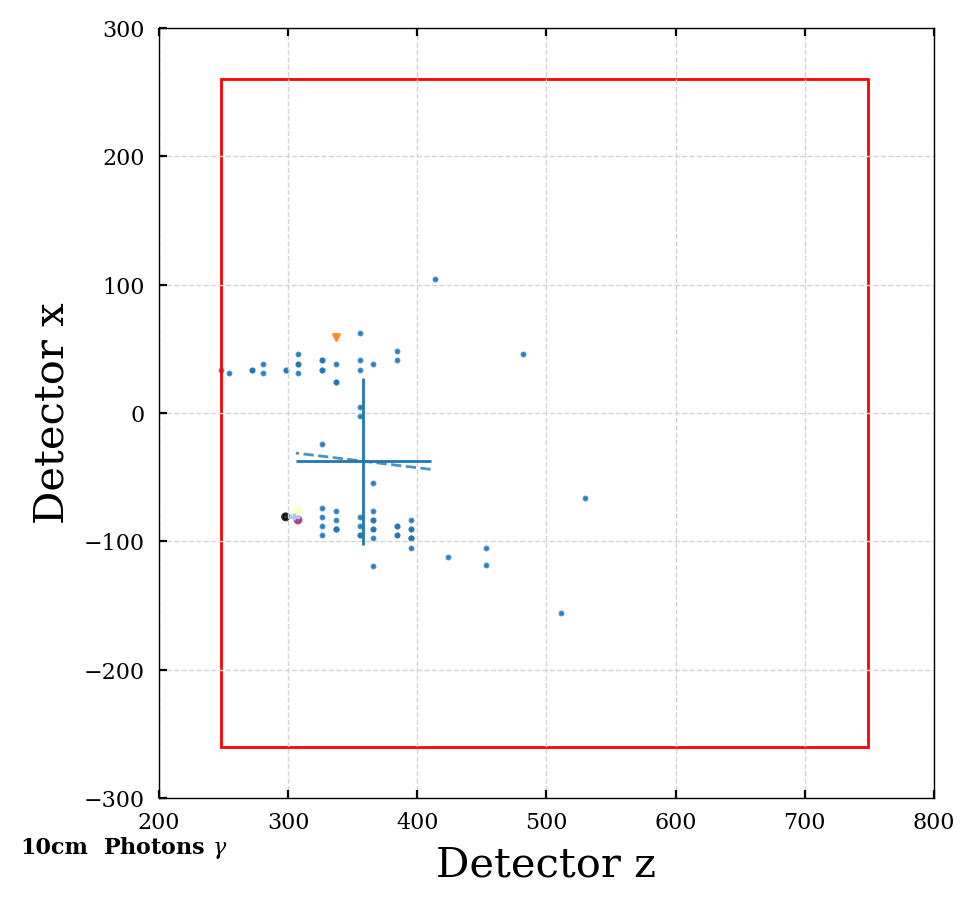

2
[40.2, 42.2, nan]


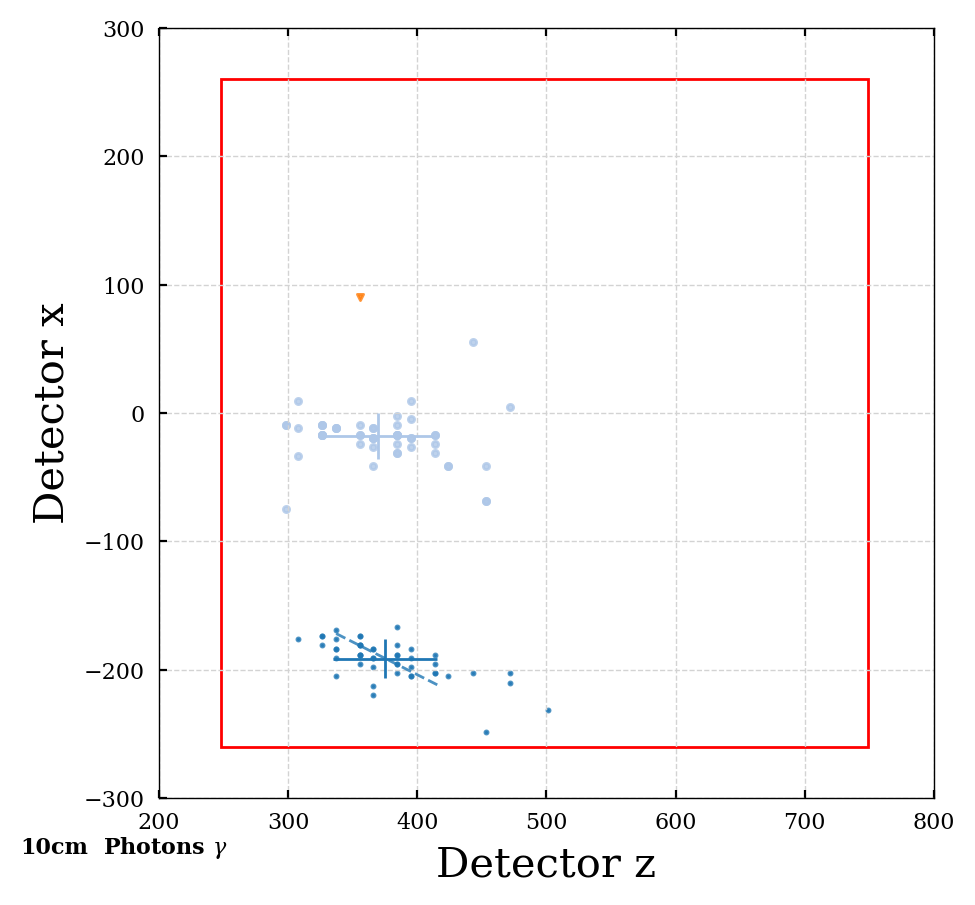

1
[48, 18.5]


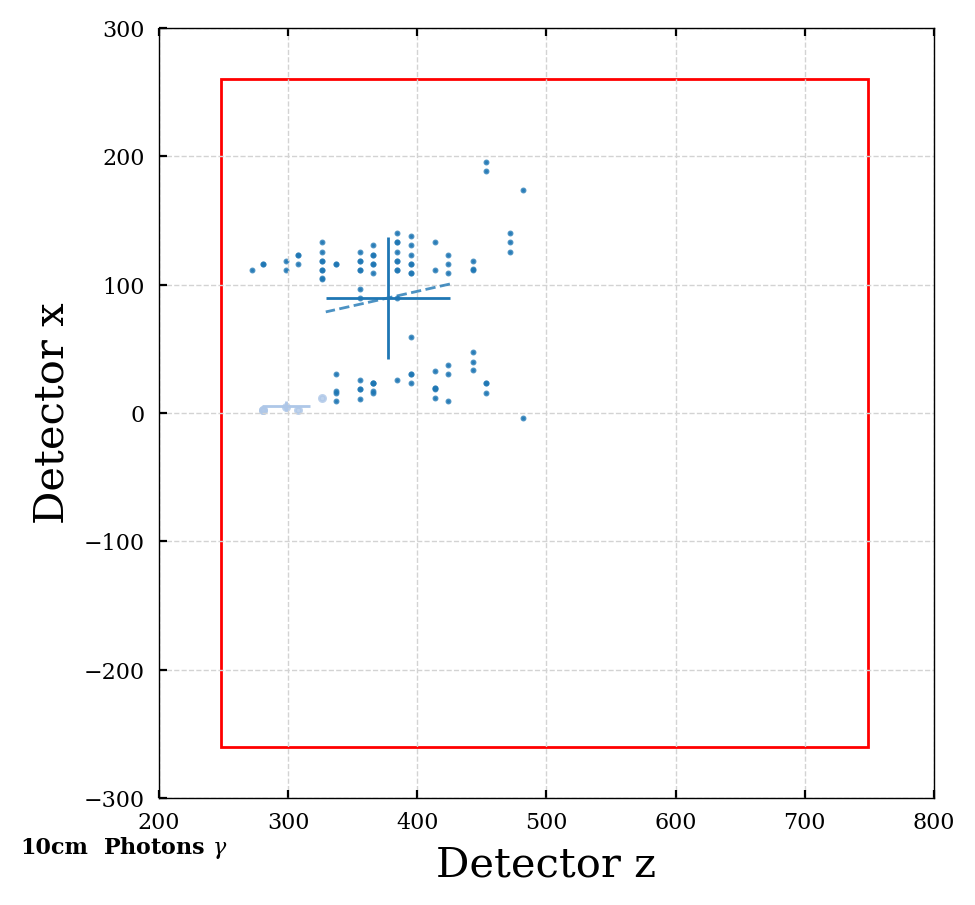

In [46]:
plot_cluster_dist(particles_dict_10cm, 10, spec_part='photons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_10cm, 10, spec_part='photons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

### Electrons

2
[27.8, 34.8]


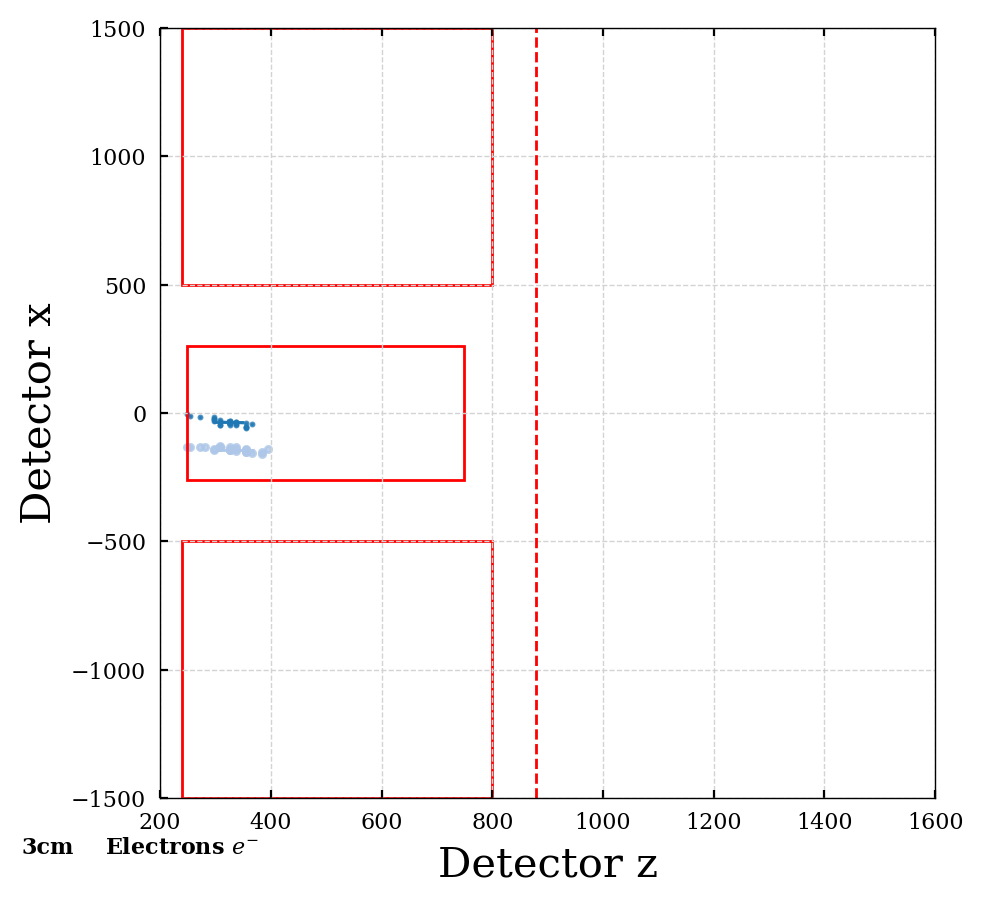

0
[33, 16.7, nan]


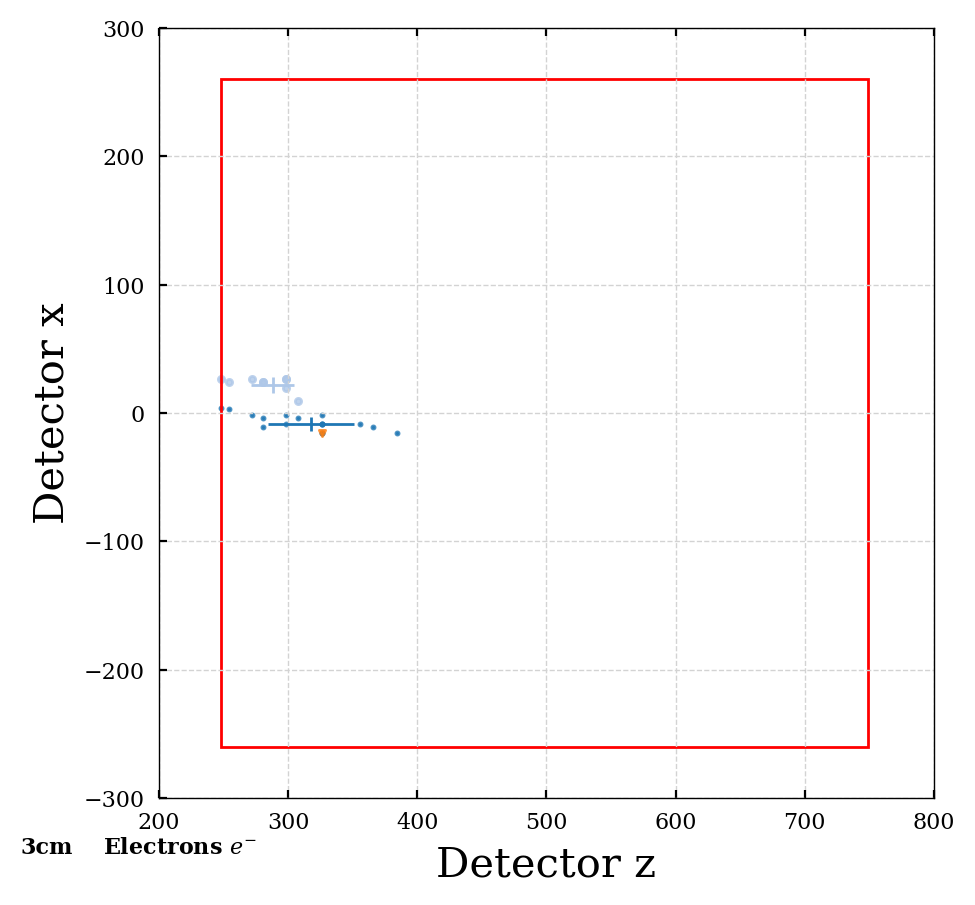

0
[24.4, 20.4]


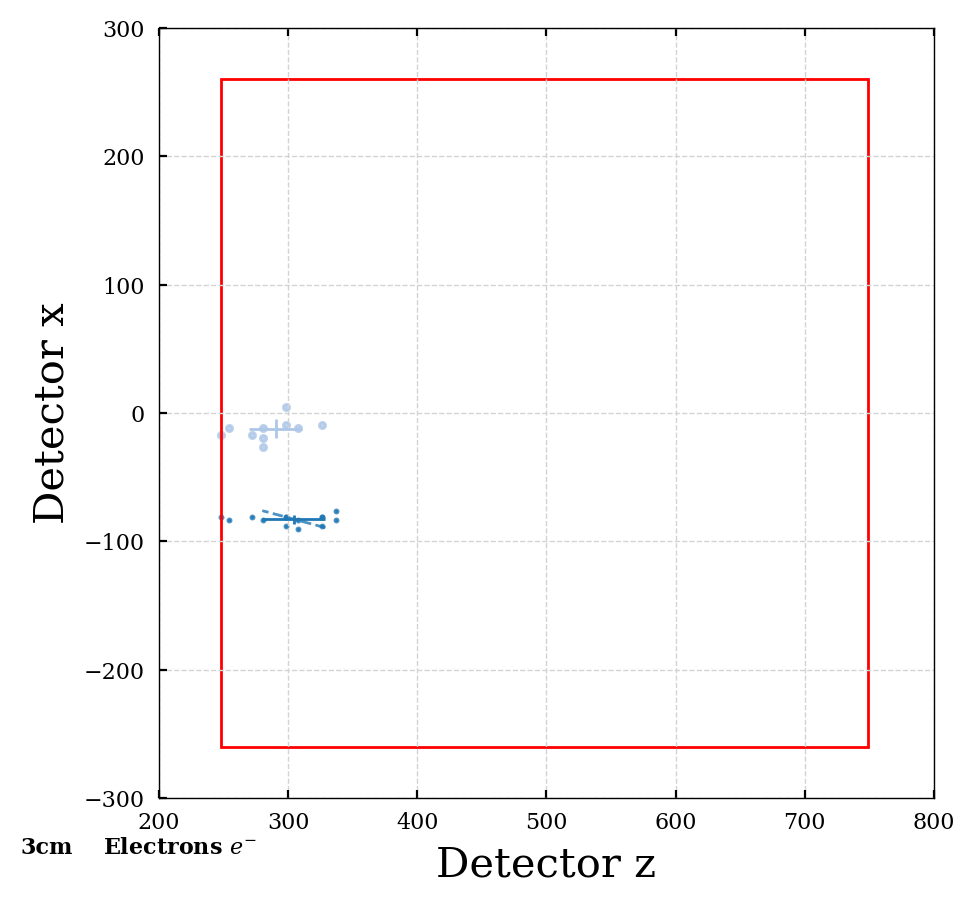

0
[25.4, 21, nan, 9.2, 0.0715]


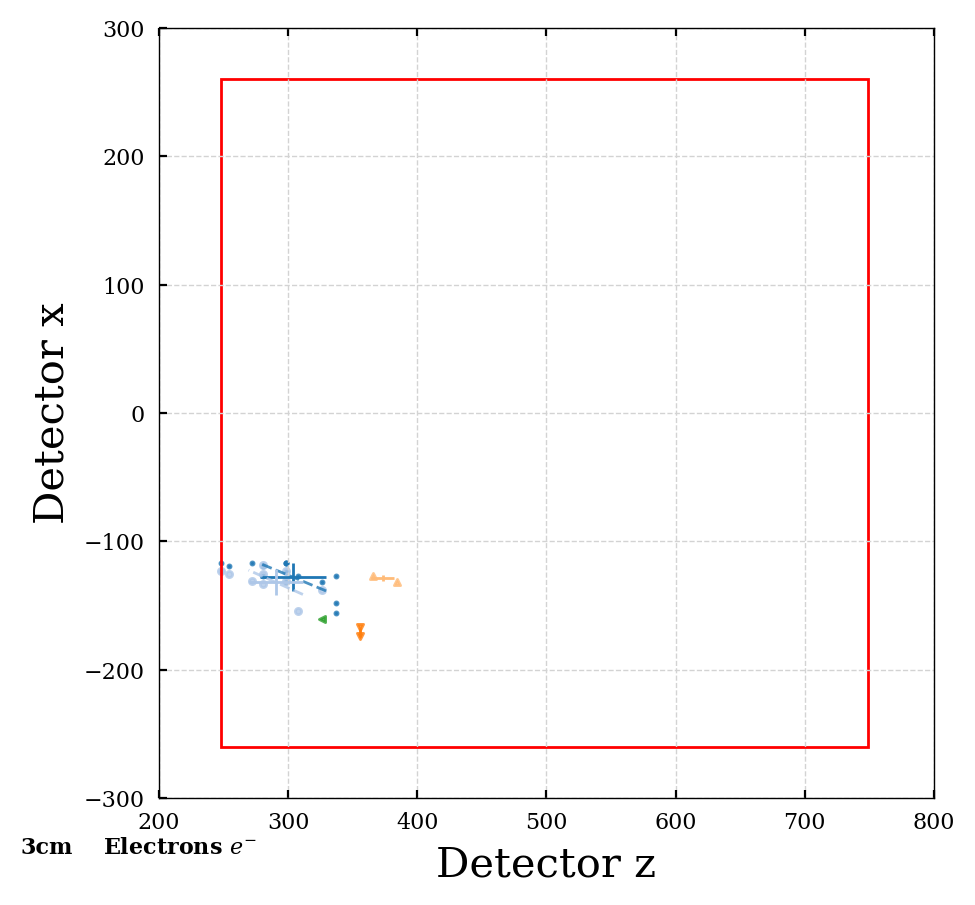

0
[26.4, 8.53]


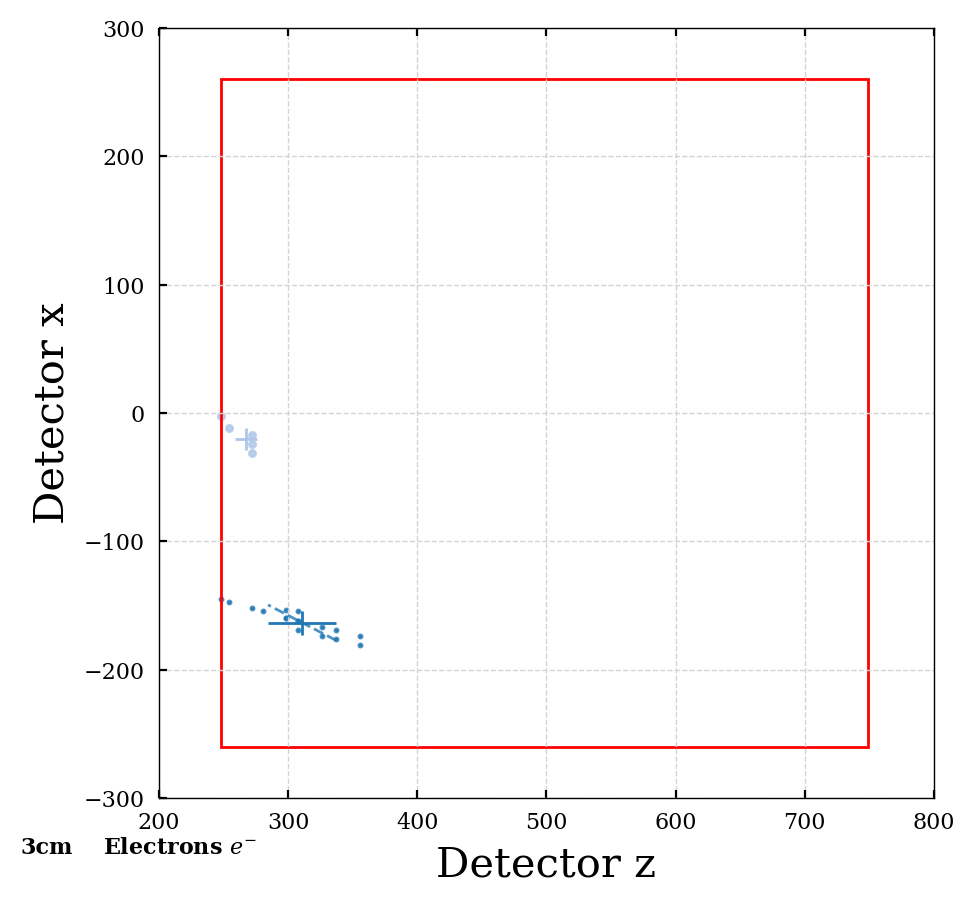

0
[33, 10.4]


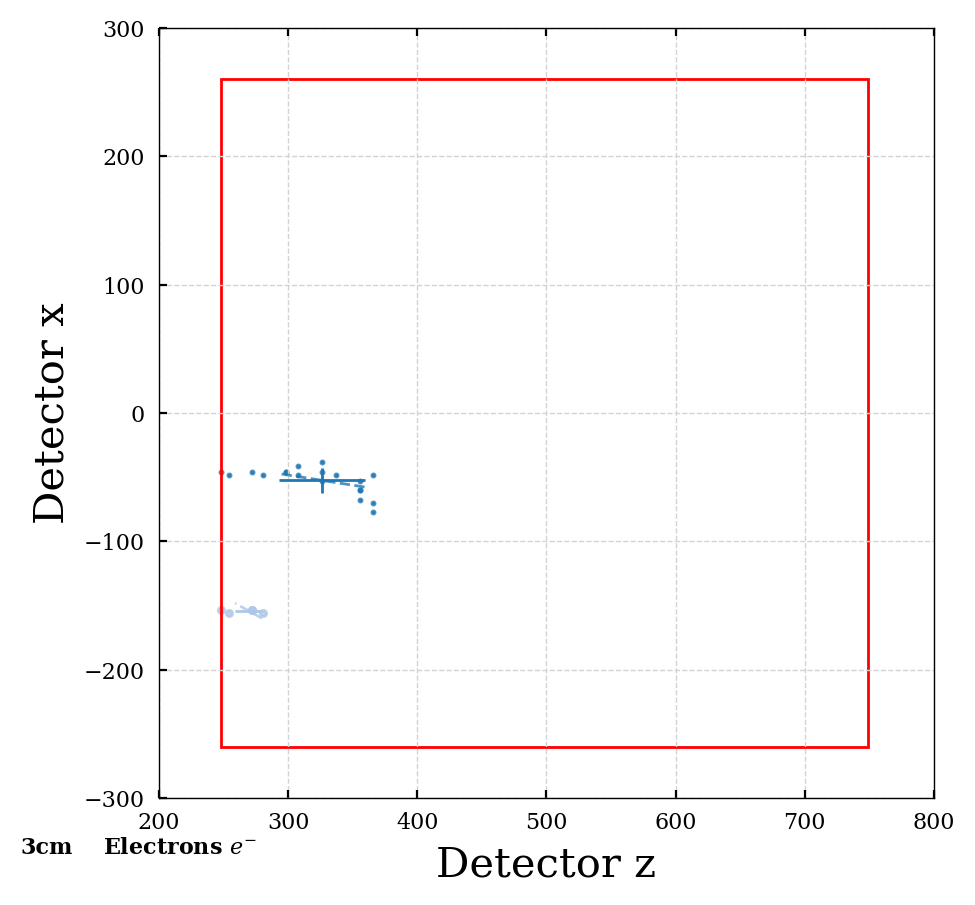

0
[22.2, 29.3, 19.4, nan, 5.08]


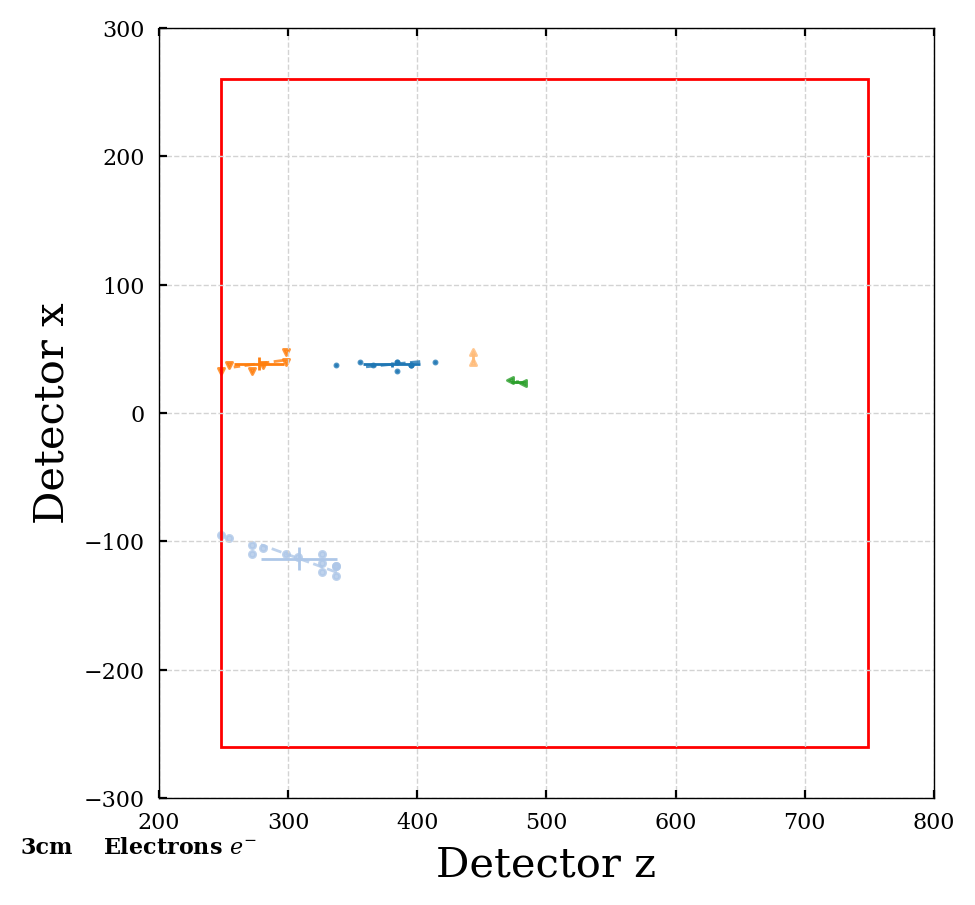

0
[19.3, 15.3, 0.0506]


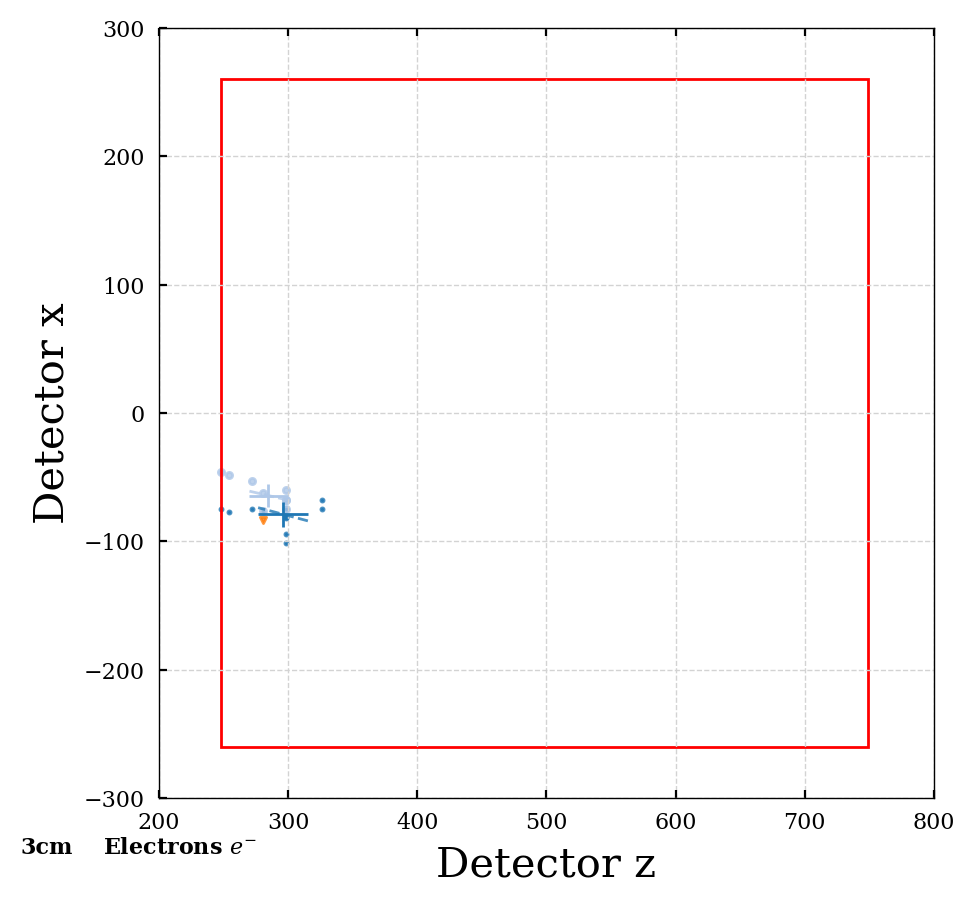

0
[34.4, 24.8]


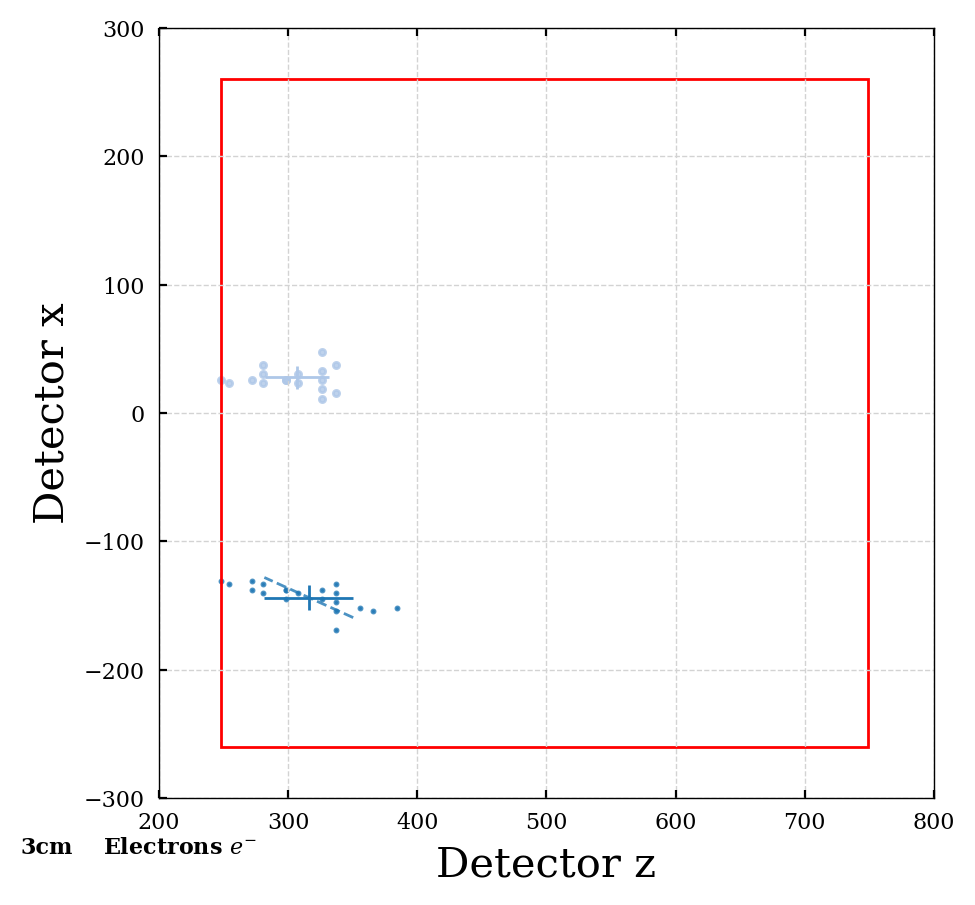

0
[40.4, 18.9, nan]


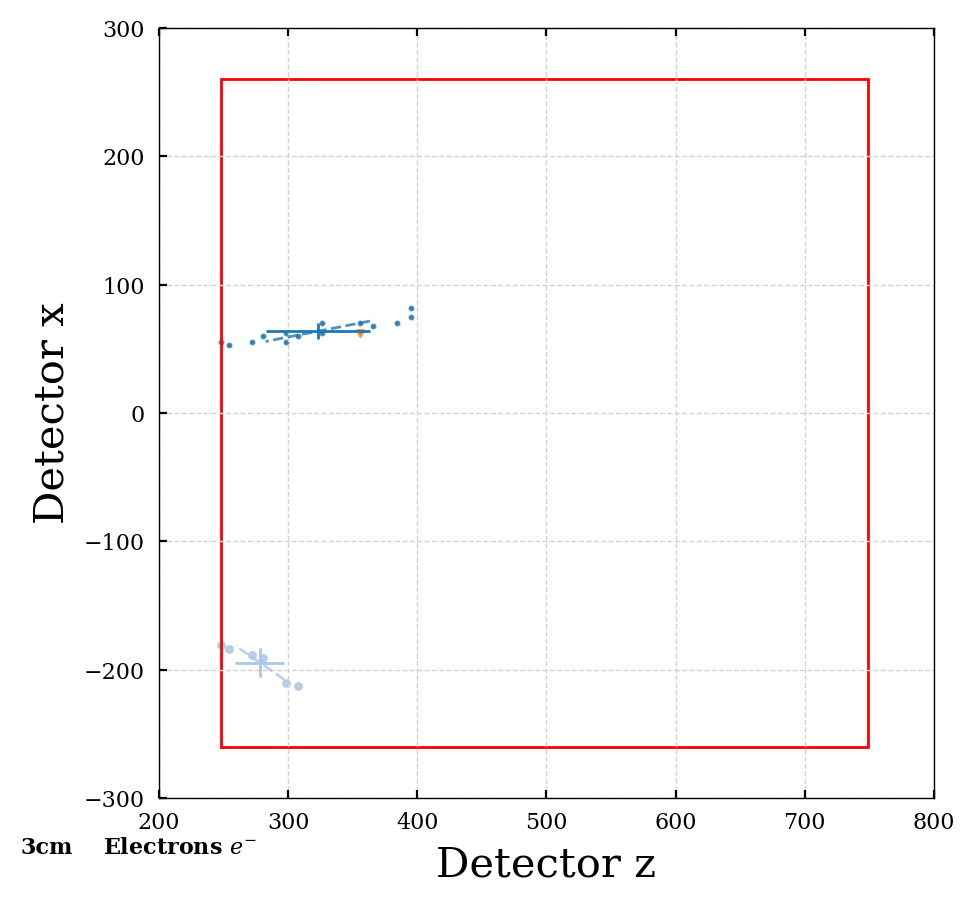

0
[27.1, 34, 0.131, 12.3, 5, 5.06]


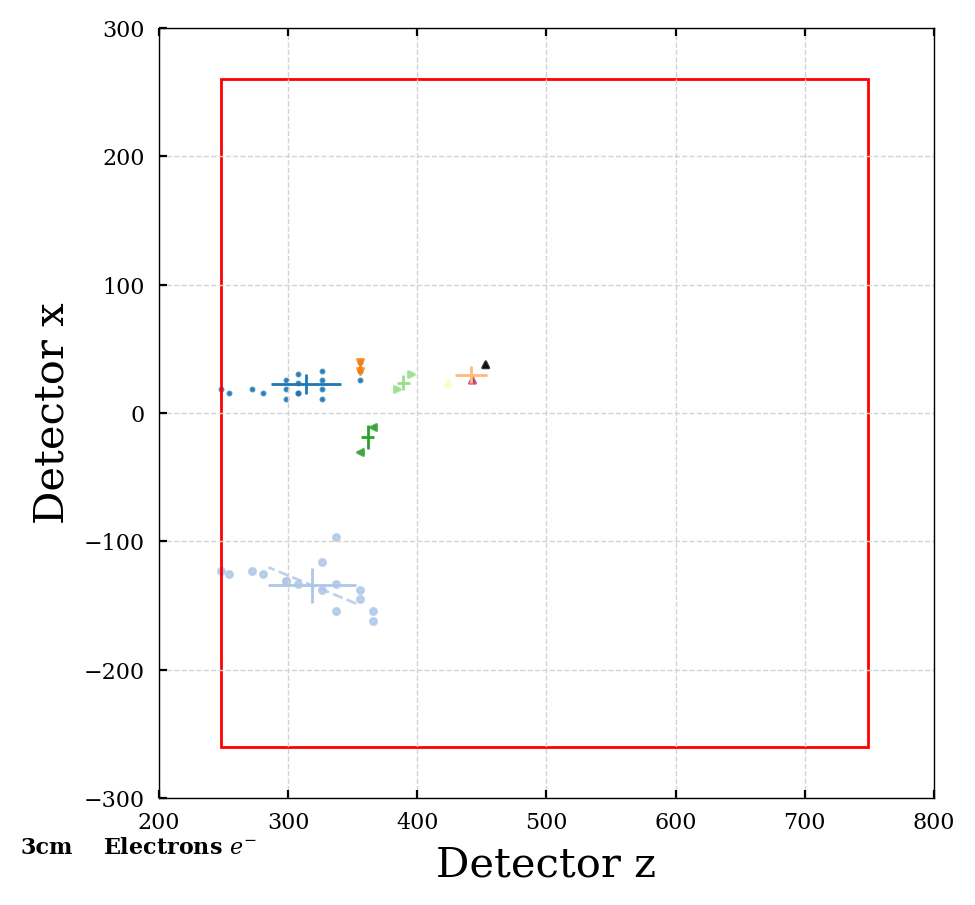

In [47]:
plot_cluster_dist(particles_dict_3cm, 3, spec_part='electrons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_3cm, 3, spec_part='electrons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[35.2, 44.6]


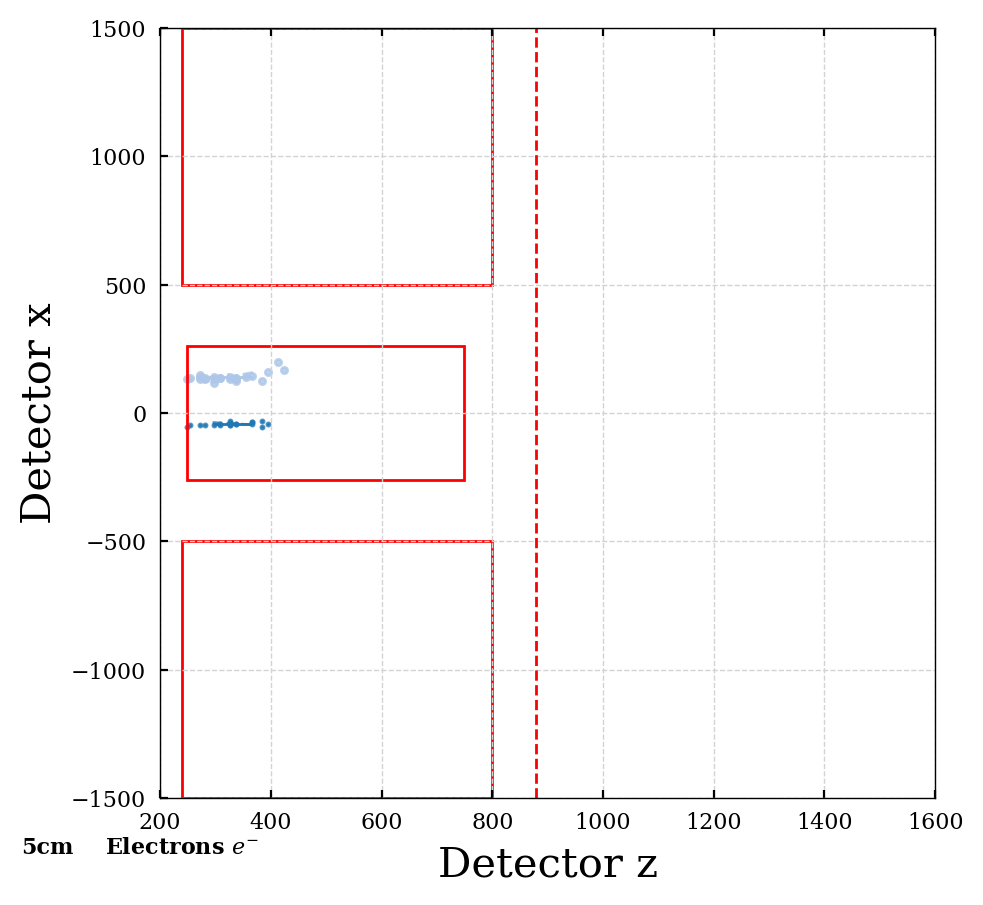

0
[33.1, 16]


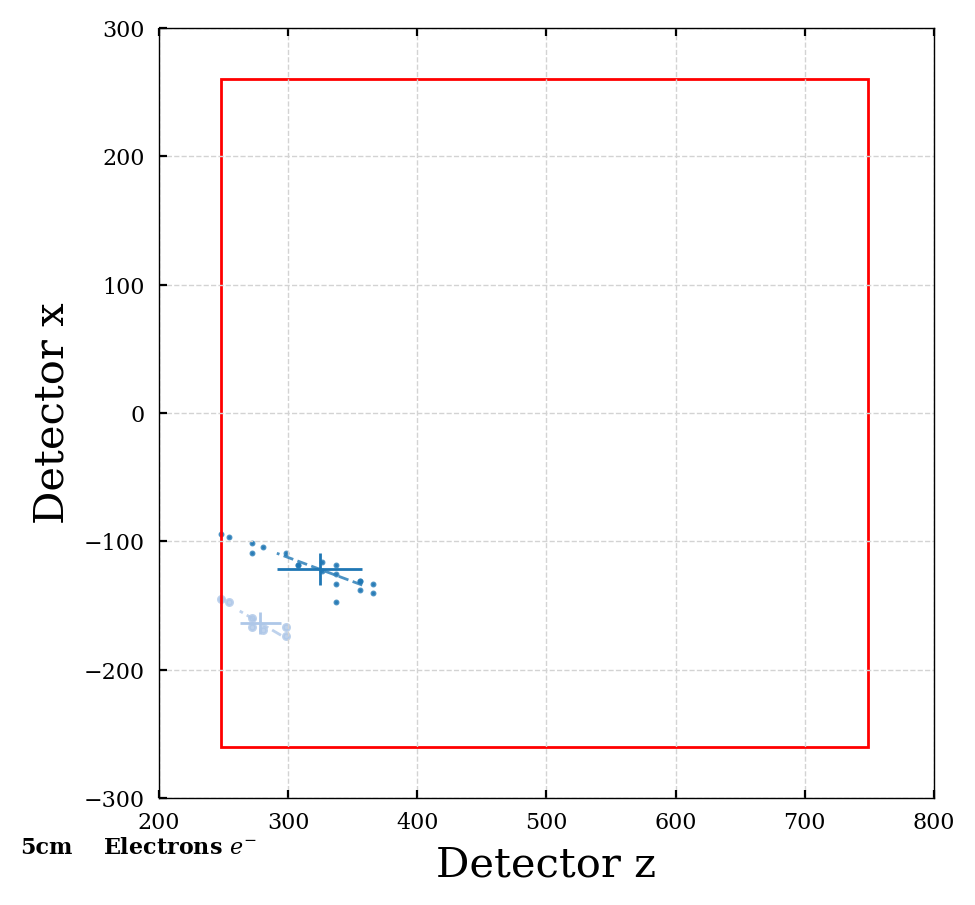

0
[38.1, 39.8, 0.14]


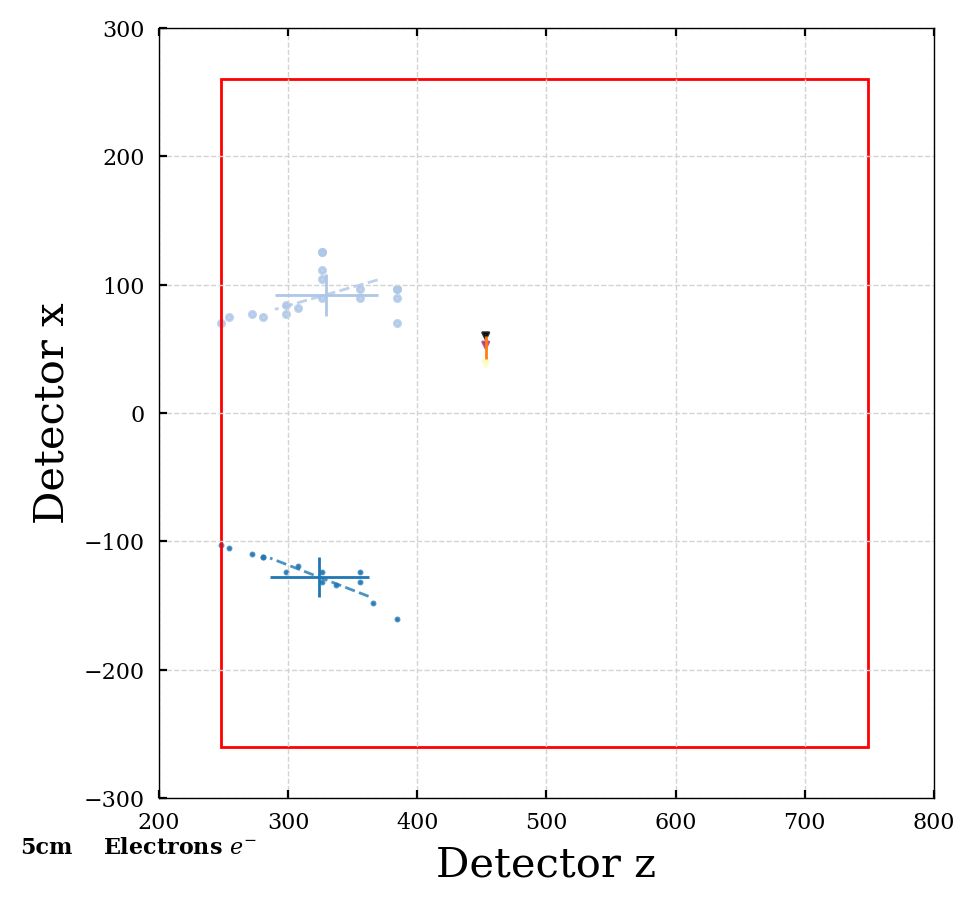

1
[22.9, 26.3]


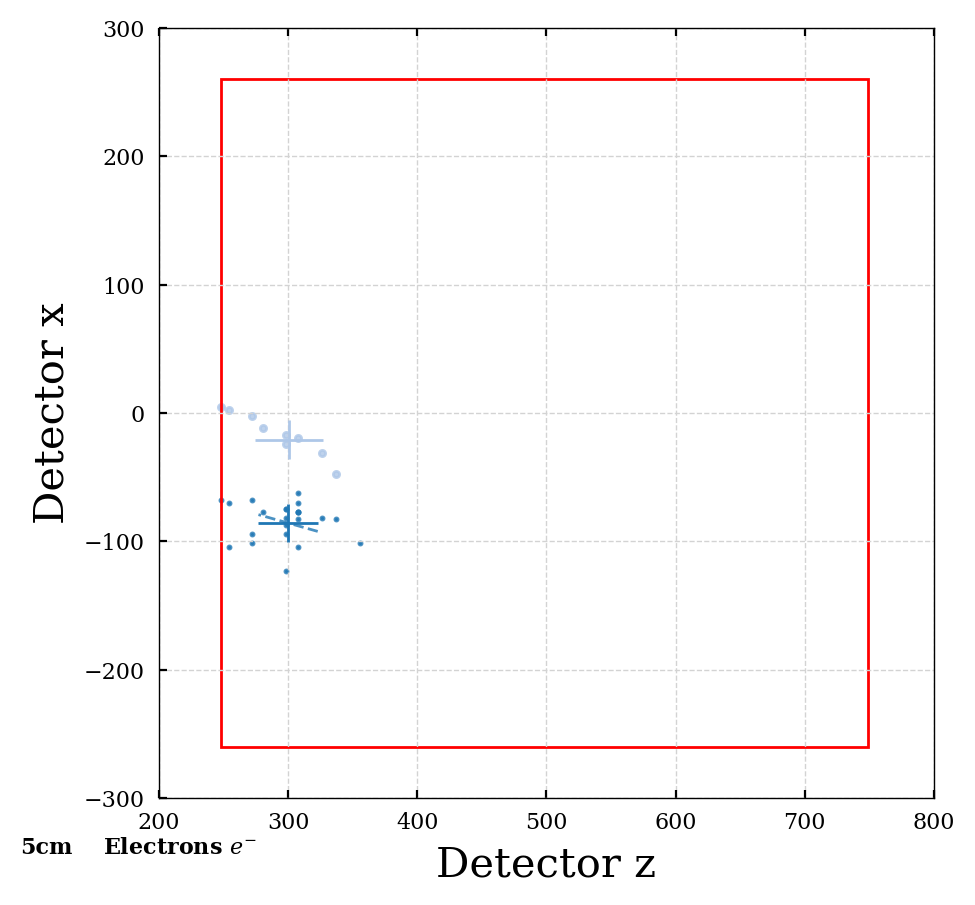

1
[35.1, 35.6, nan]


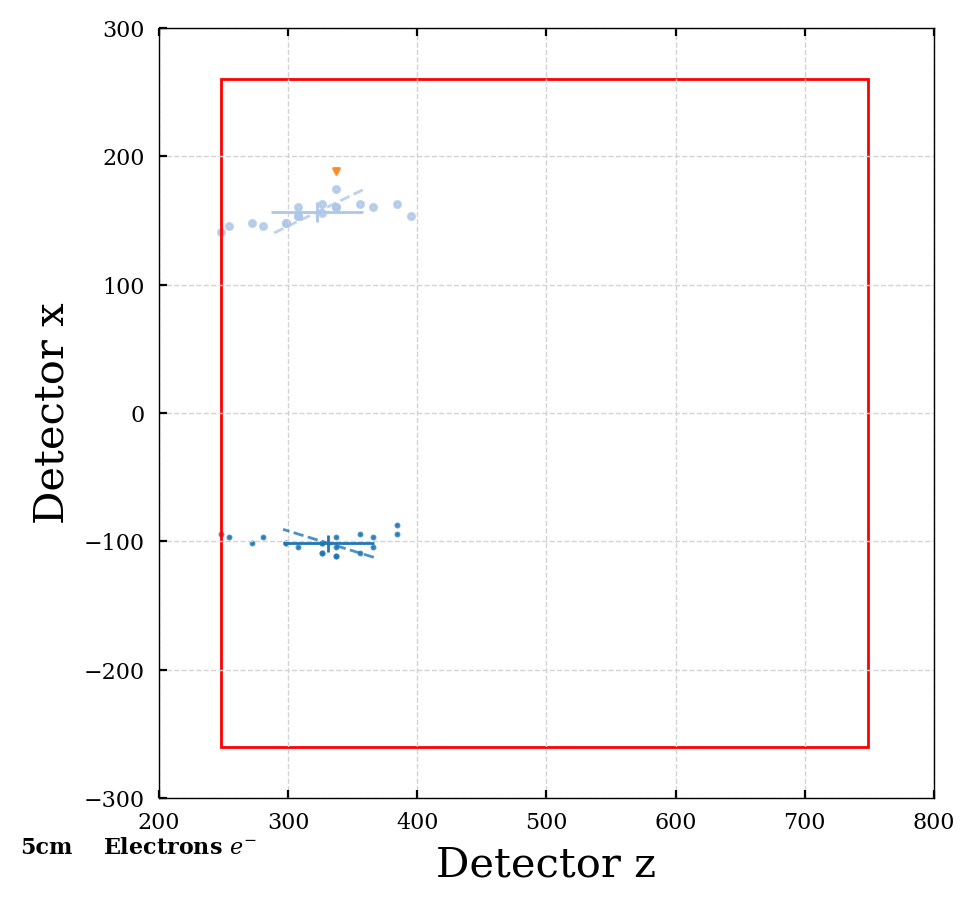

0
[48.1, 48.3, 9.4]


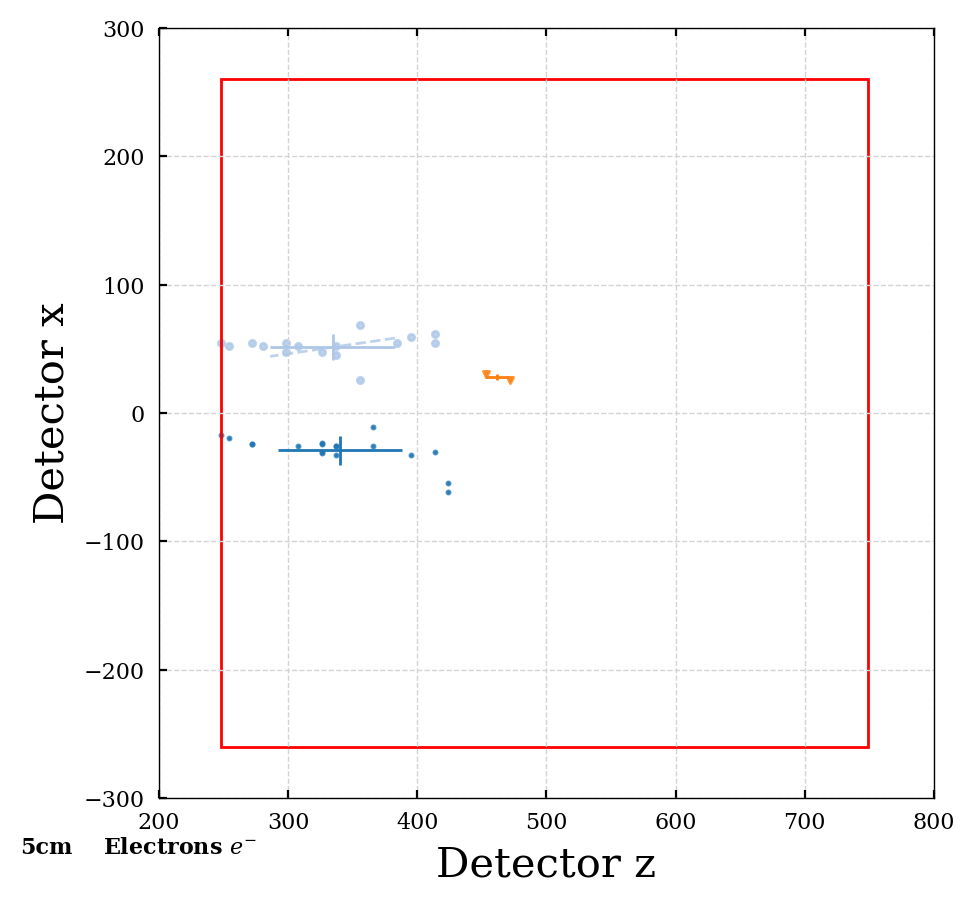

1
[38.6, 15.5]


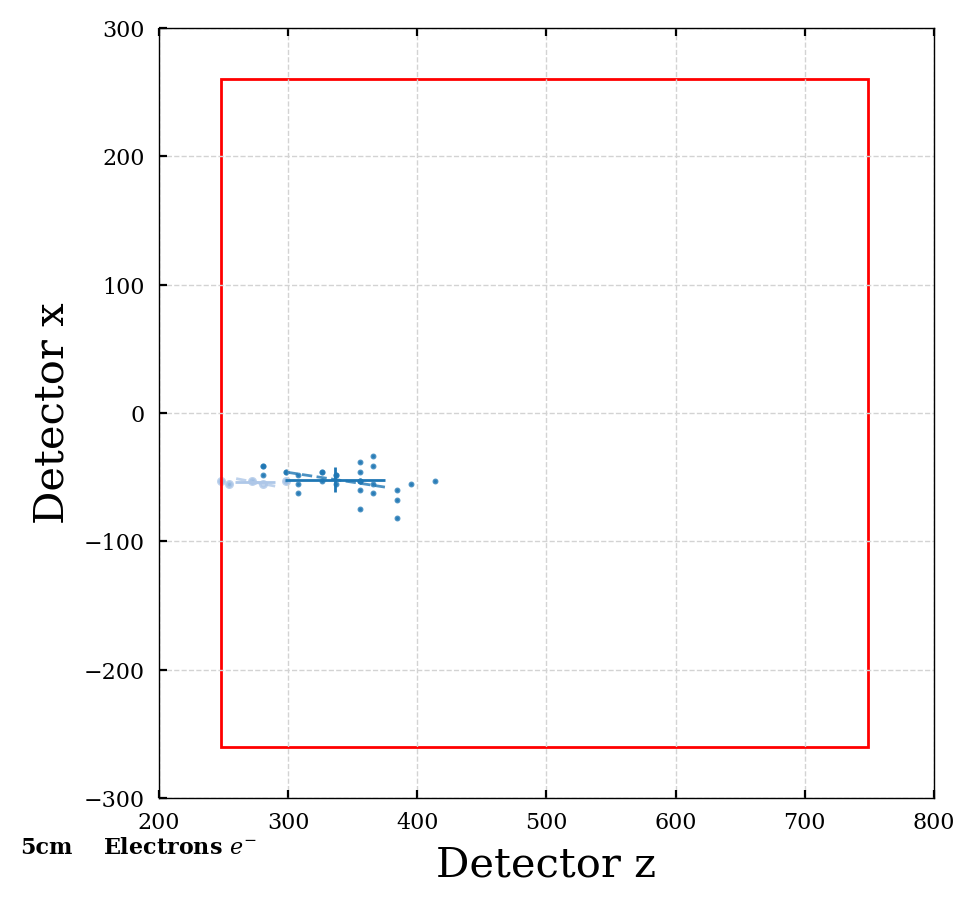

1
[31.8, 28.3]


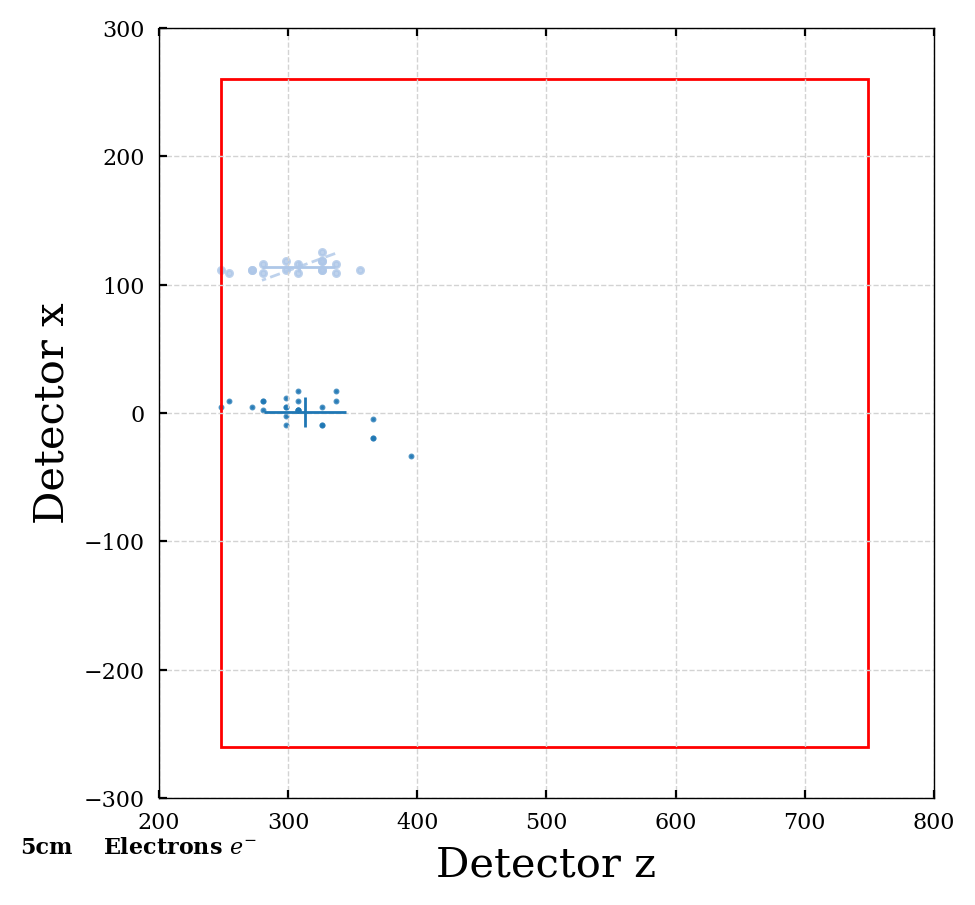

1
[45.5, 36.3, 0.14]


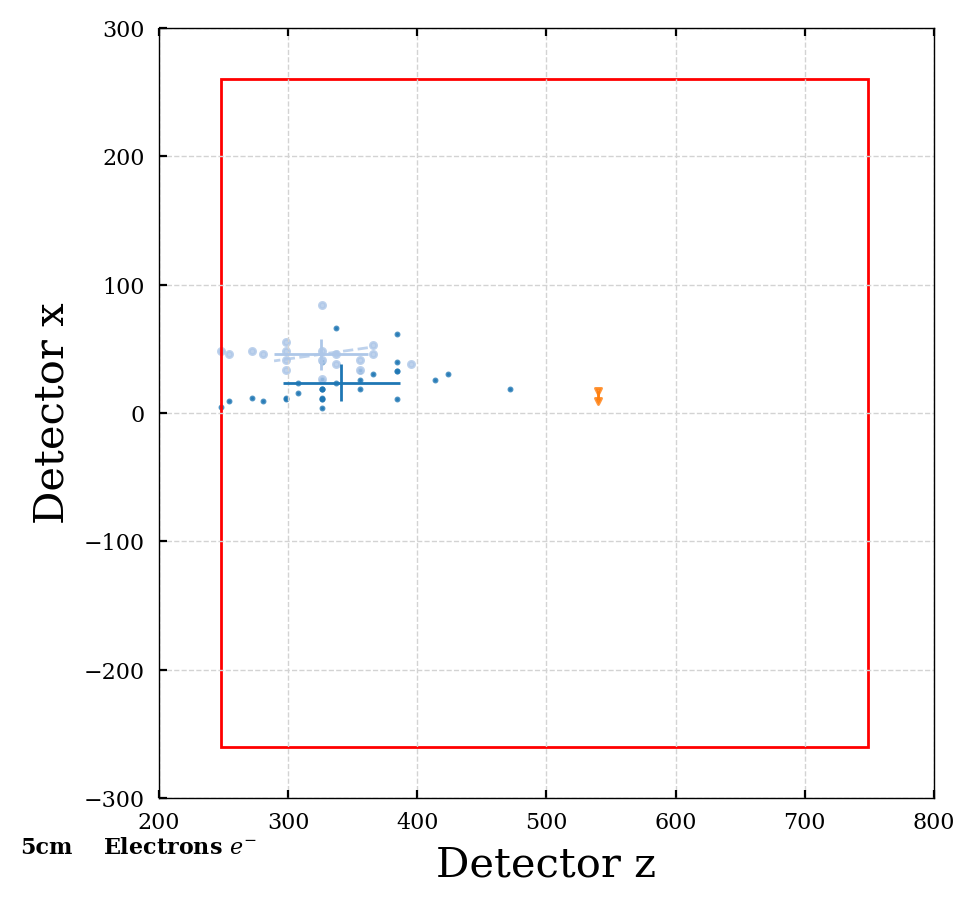

1
[38.8, 33.7]


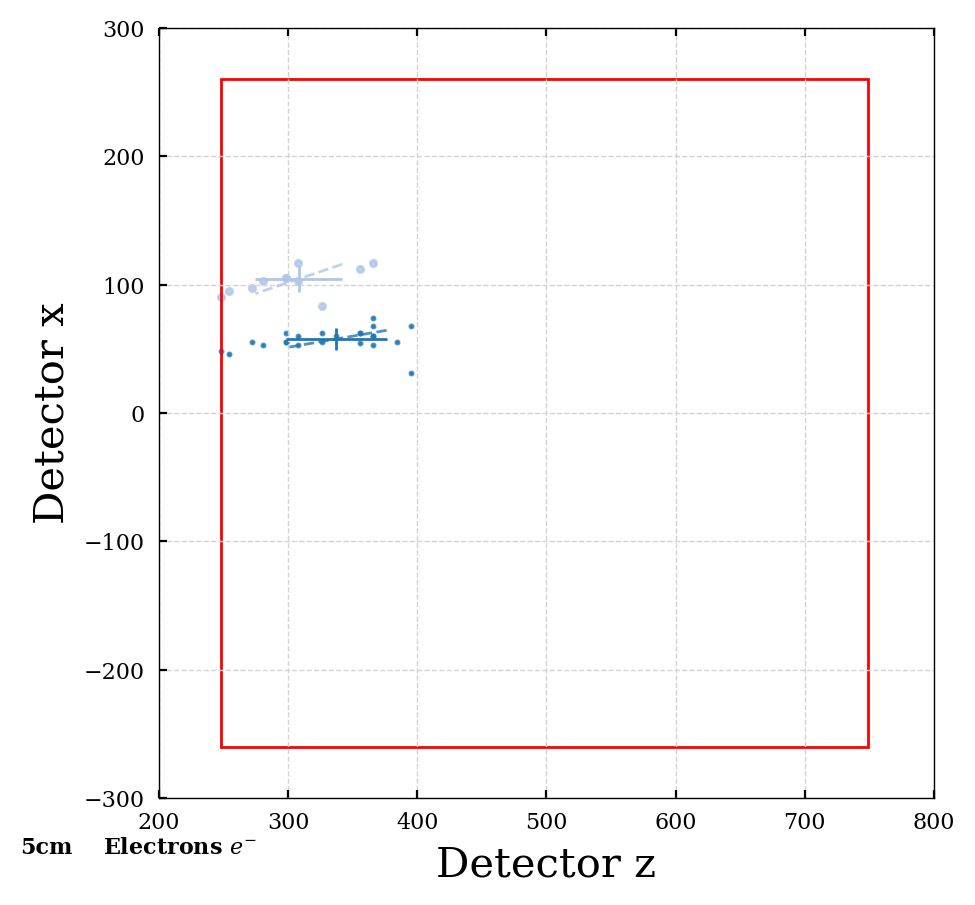

1
[29.7, nan, 3.21]


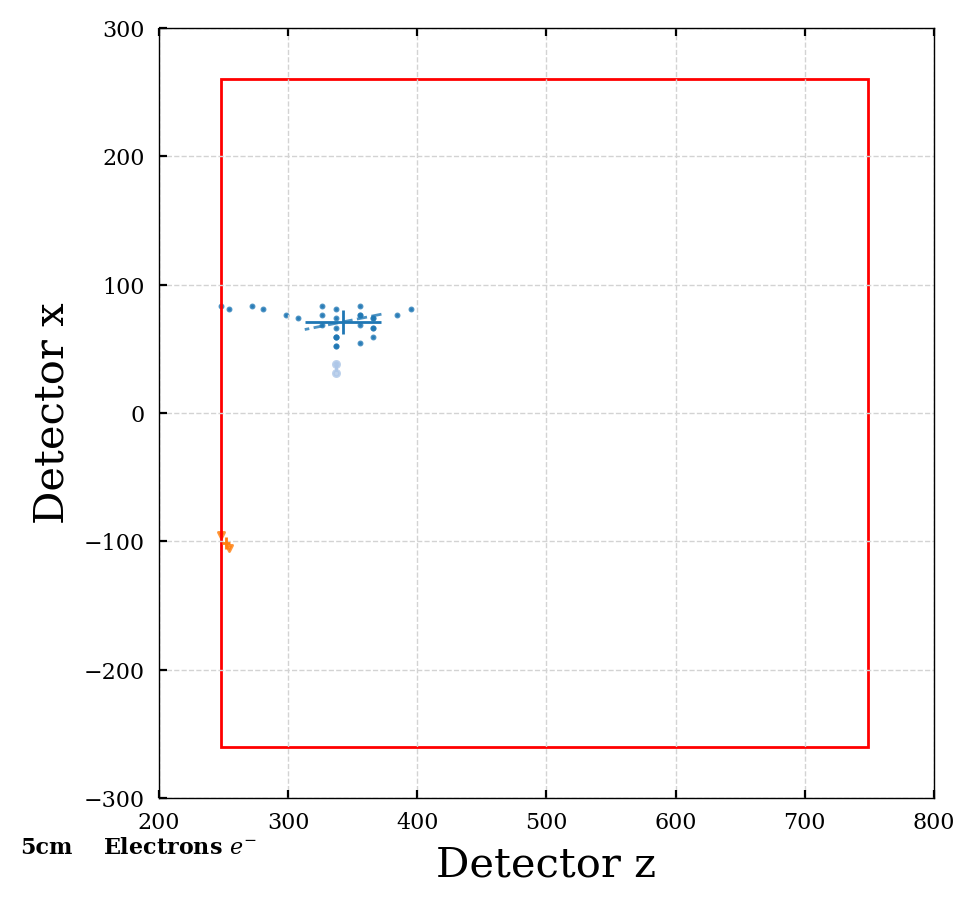

In [48]:
plot_cluster_dist(particles_dict_5cm, 5, spec_part='electrons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_5cm, 5, spec_part='electrons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[38, 44.6]


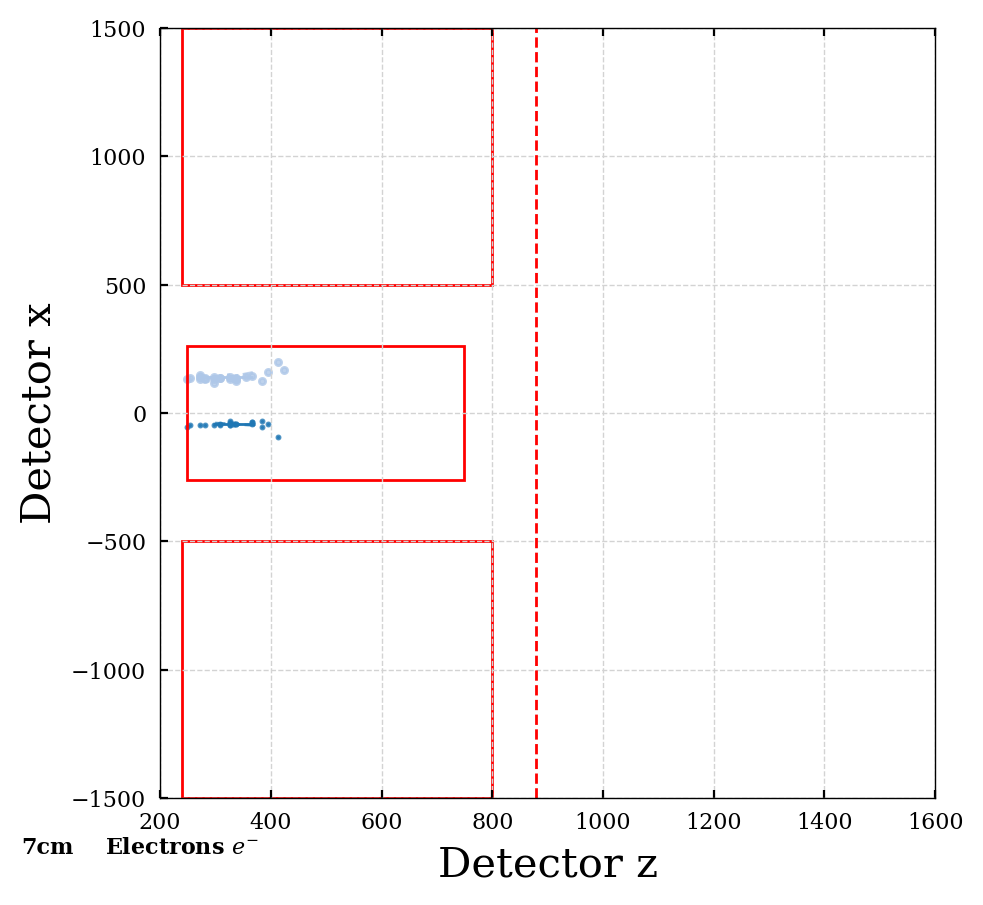

1
[42.6]


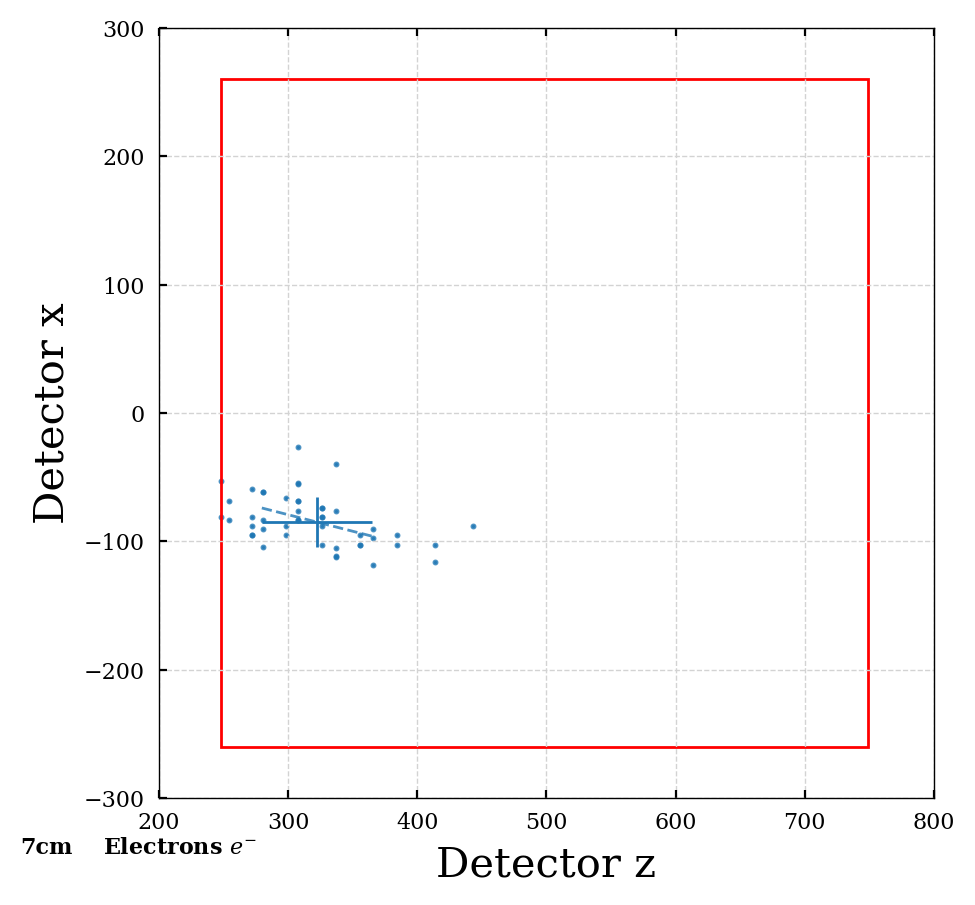

2
[45.9, 38]


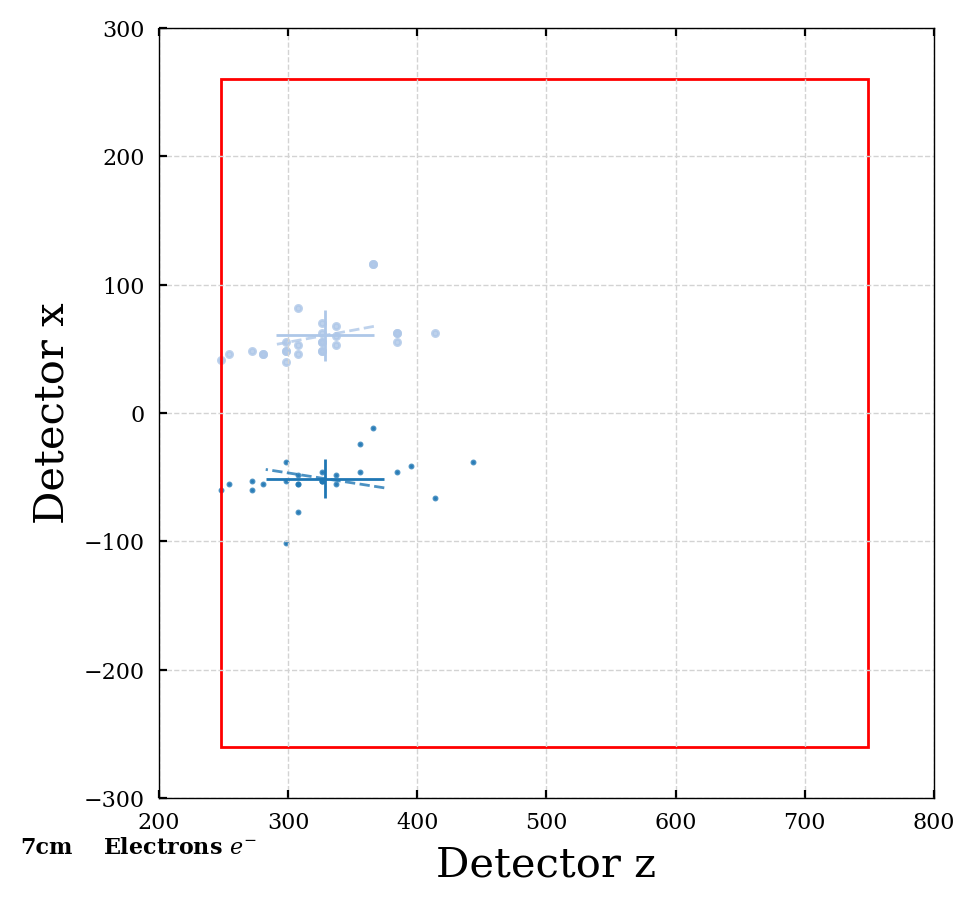

2
[54.8, 47.8, nan]


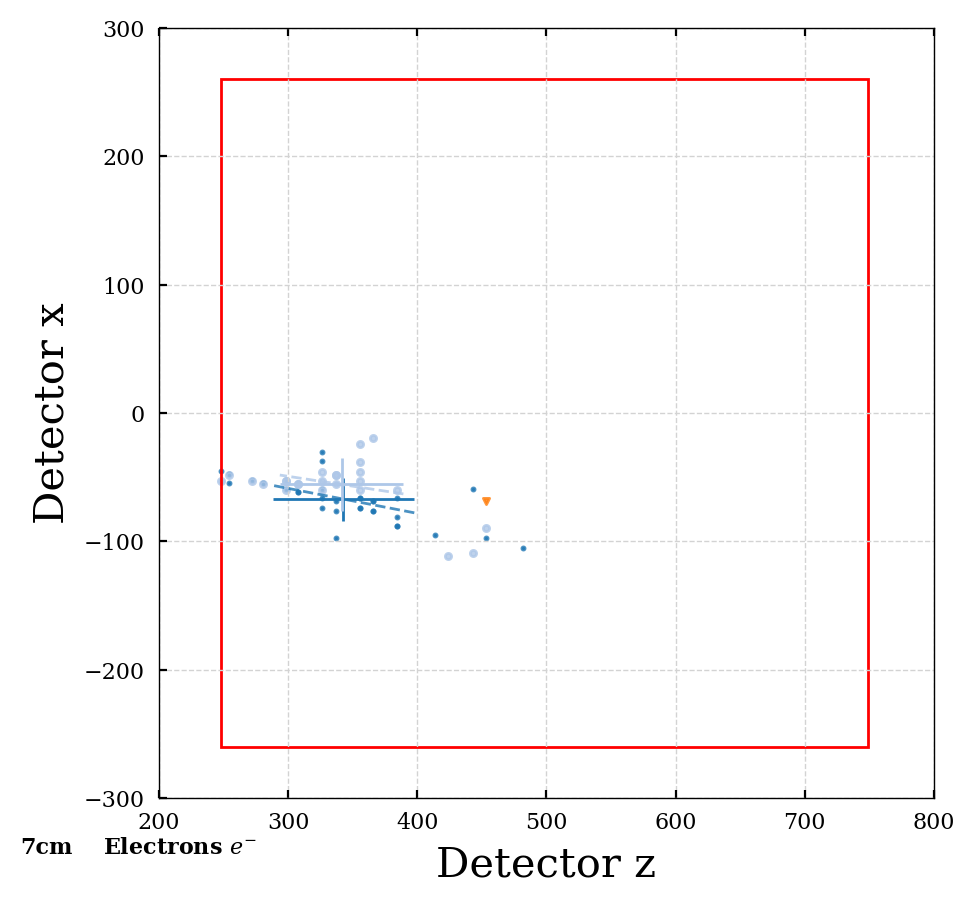

1
[42.9, 31]


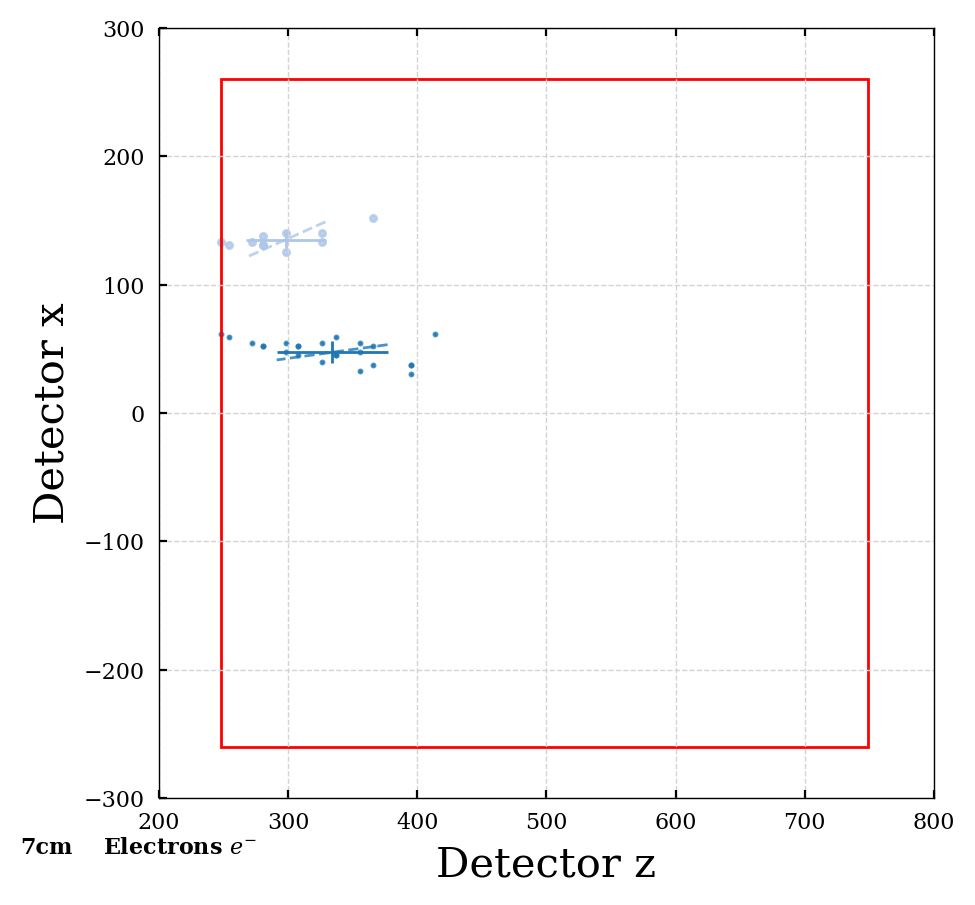

1
[38.9, 21]


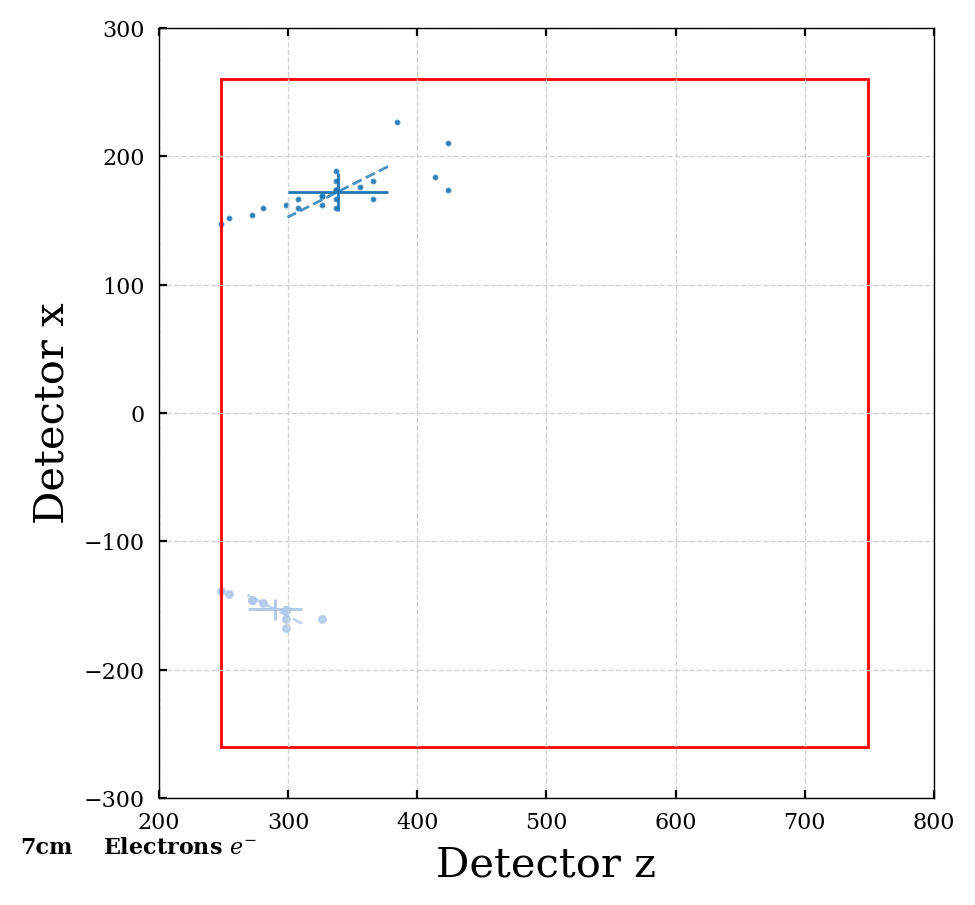

1
[46.6, 0]


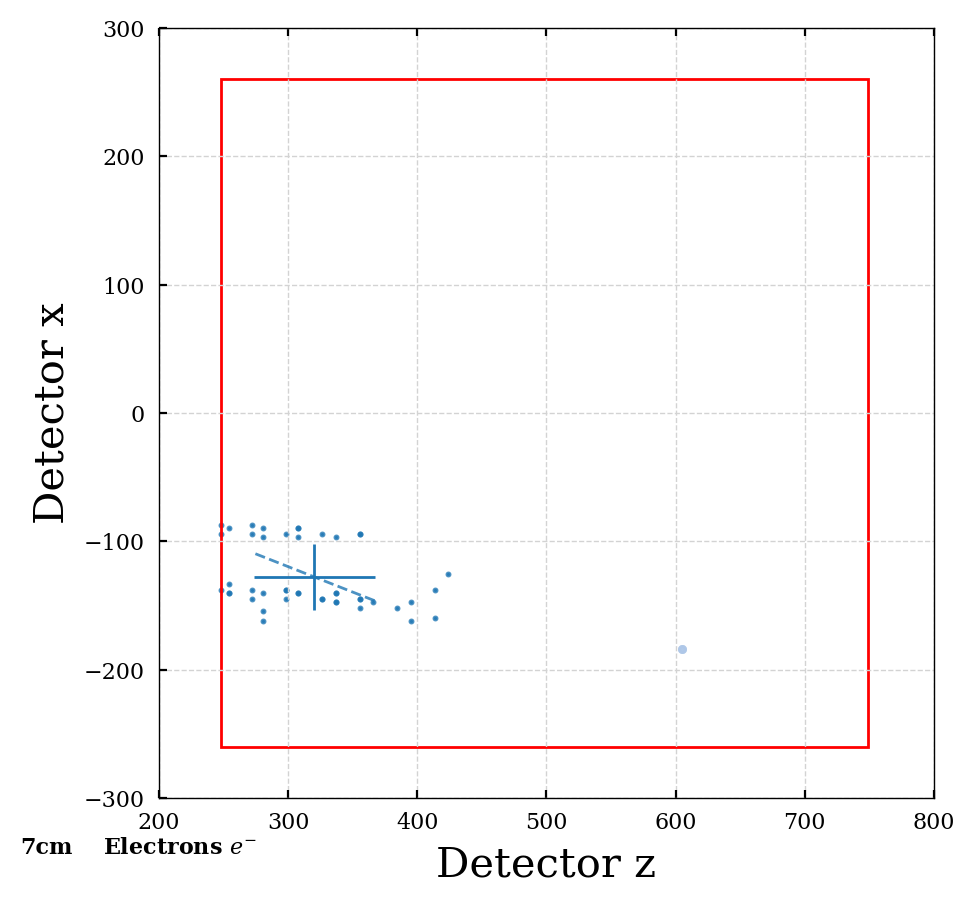

0
[16.3, 18.2]


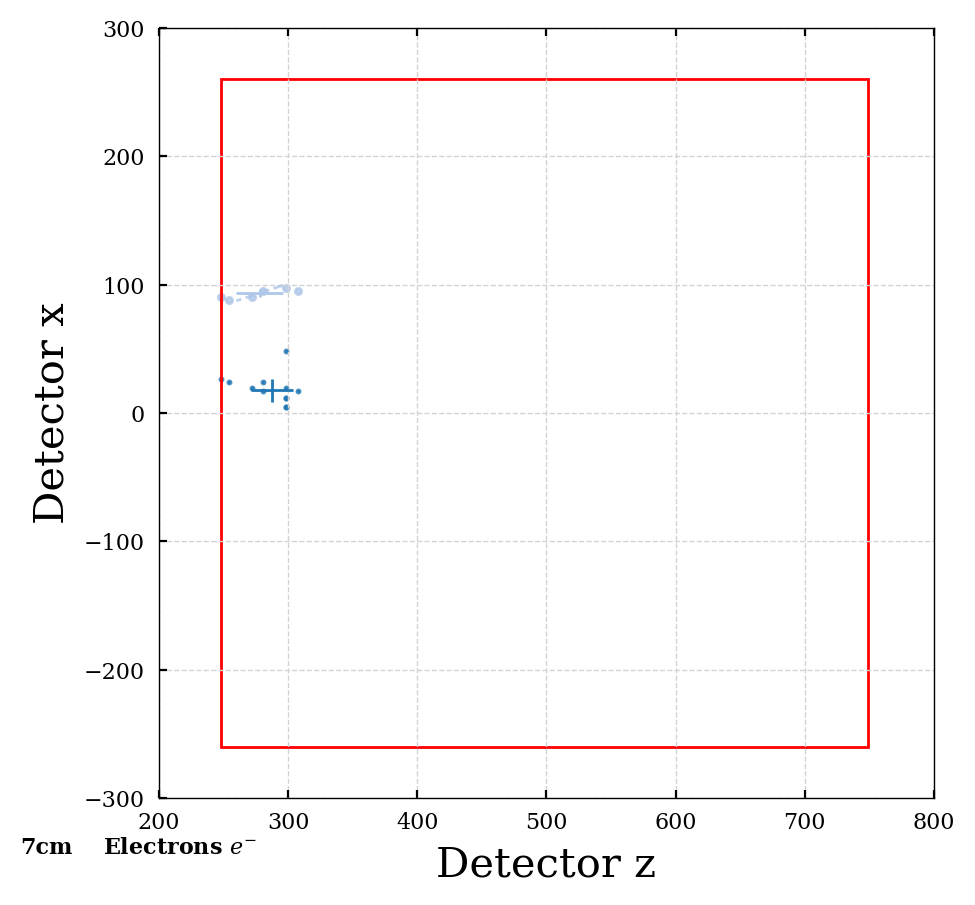

1
[41]


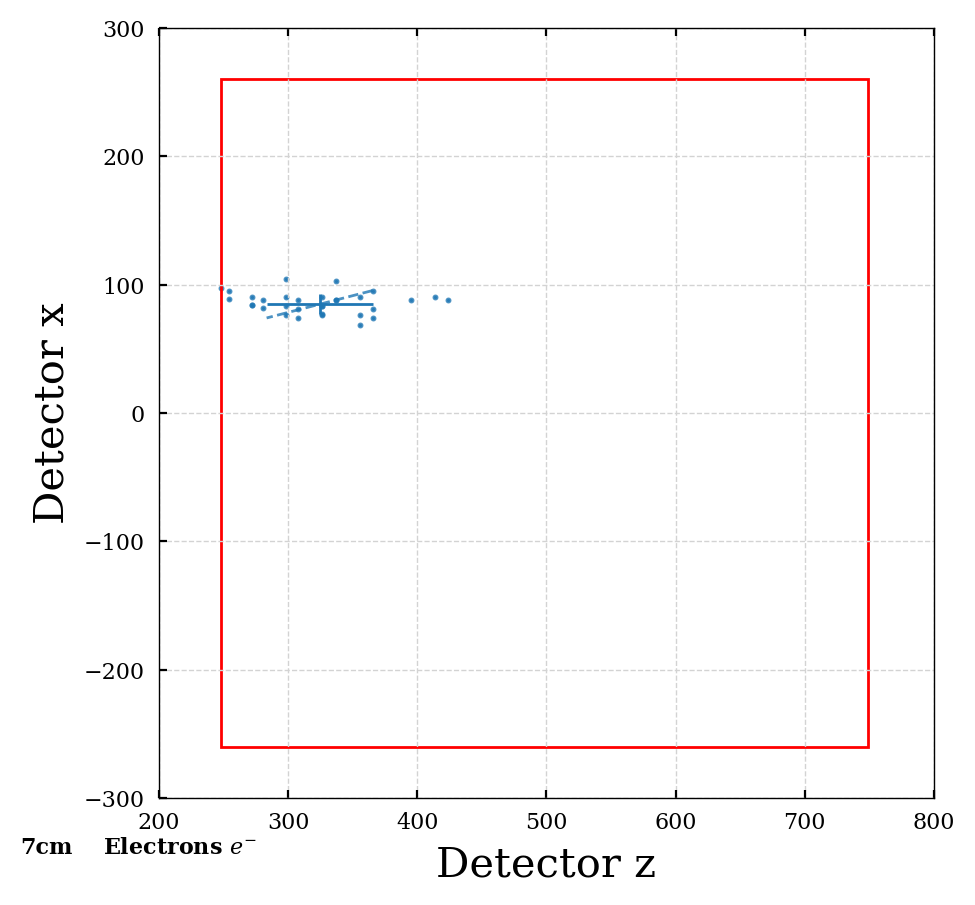

1
[52.6, 48.9, 9.26]


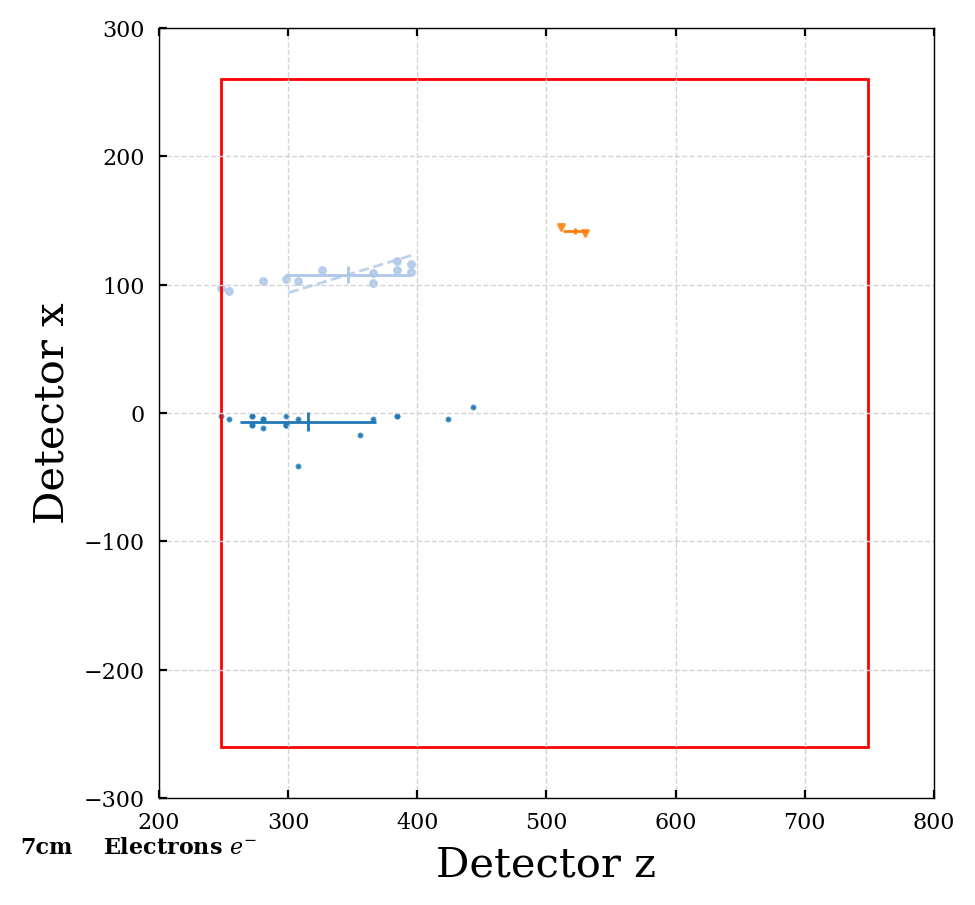

1
[37.9, 17.8]


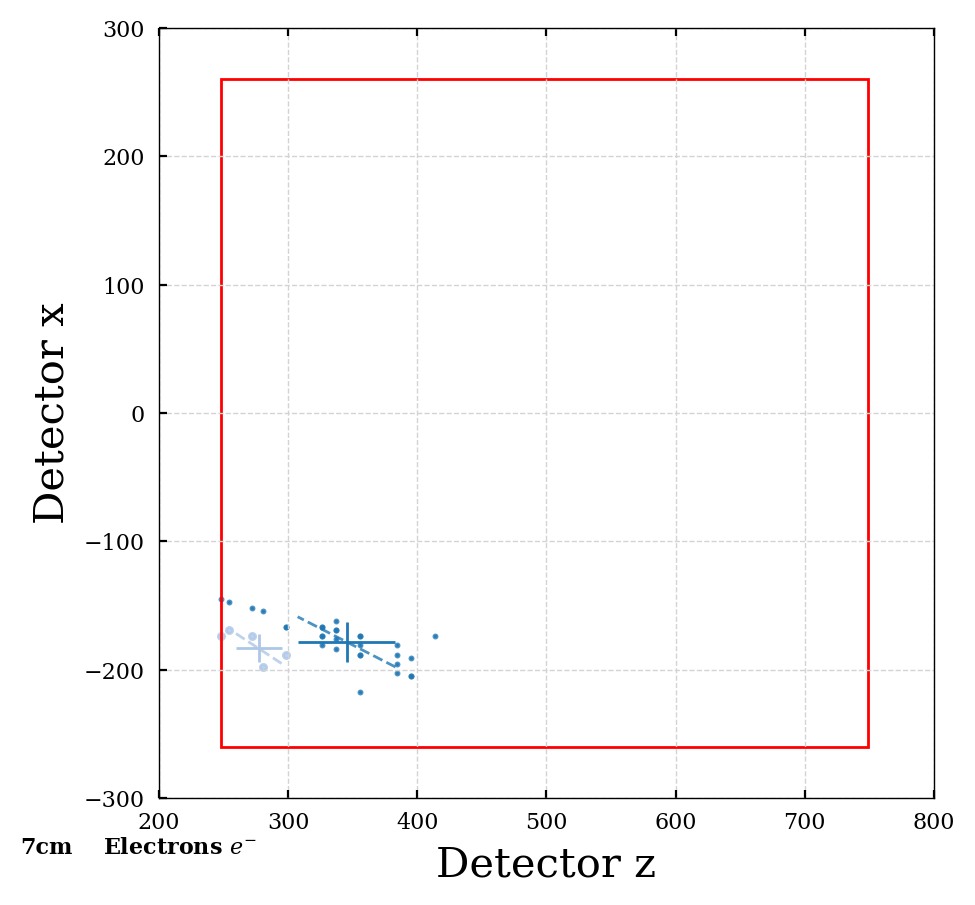

In [49]:
plot_cluster_dist(particles_dict_7cm, 7, spec_part='electrons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_7cm, 7, spec_part='electrons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[38, 44.6]


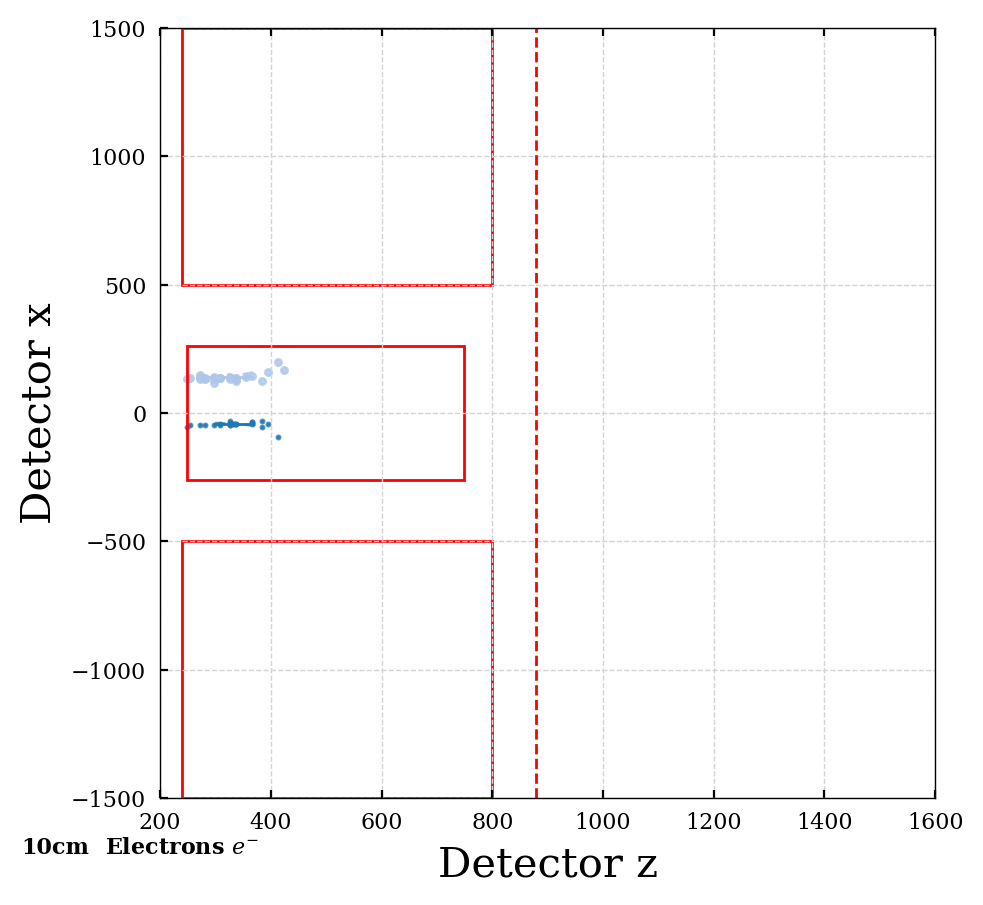

1
[40.1]


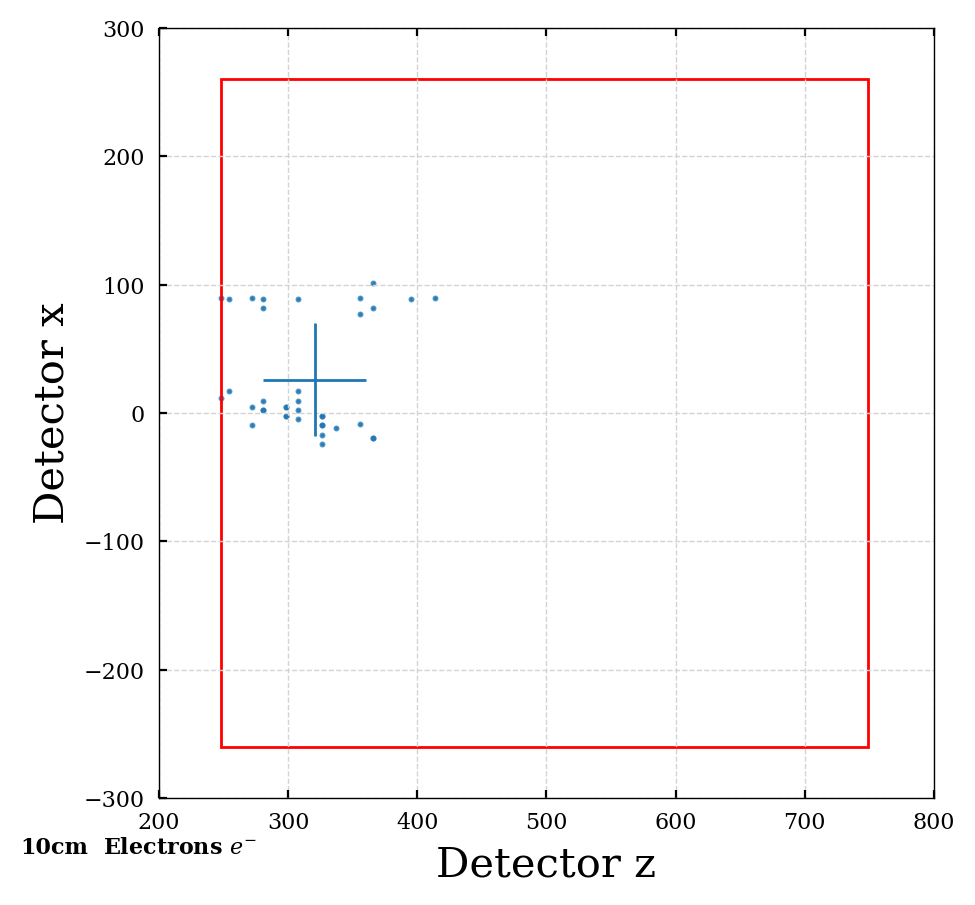

2
[46.3, 35.2]


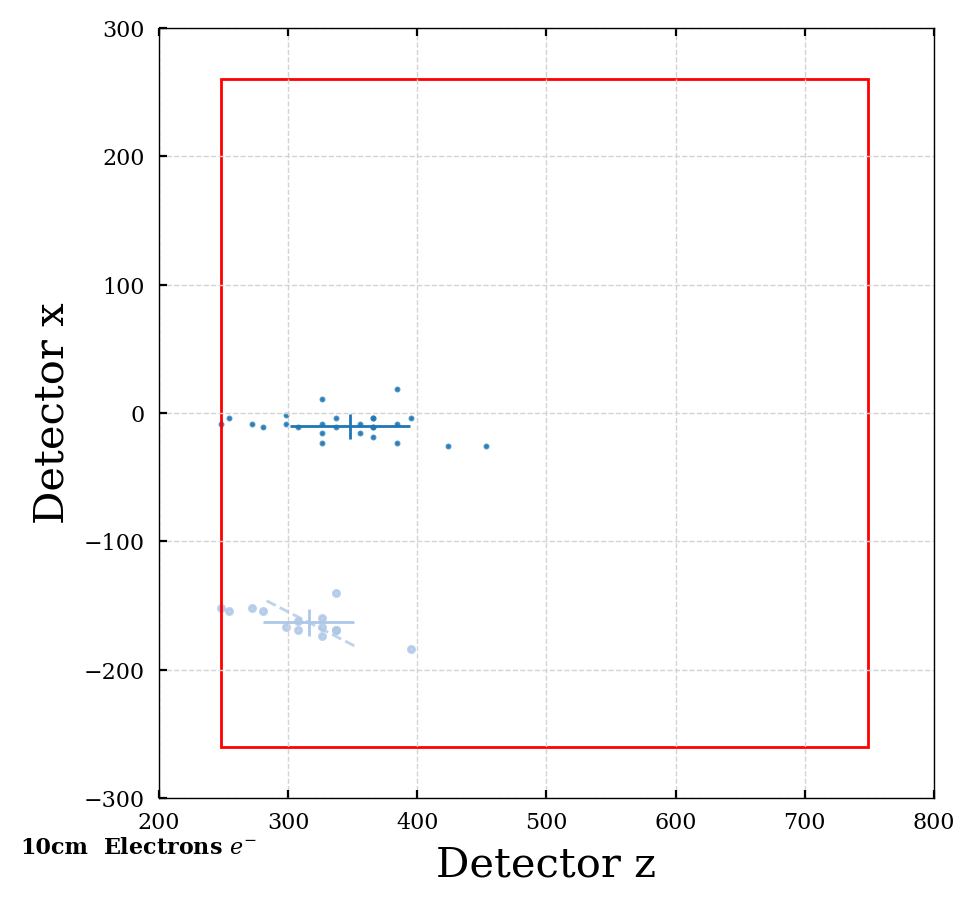

1
[21.7]


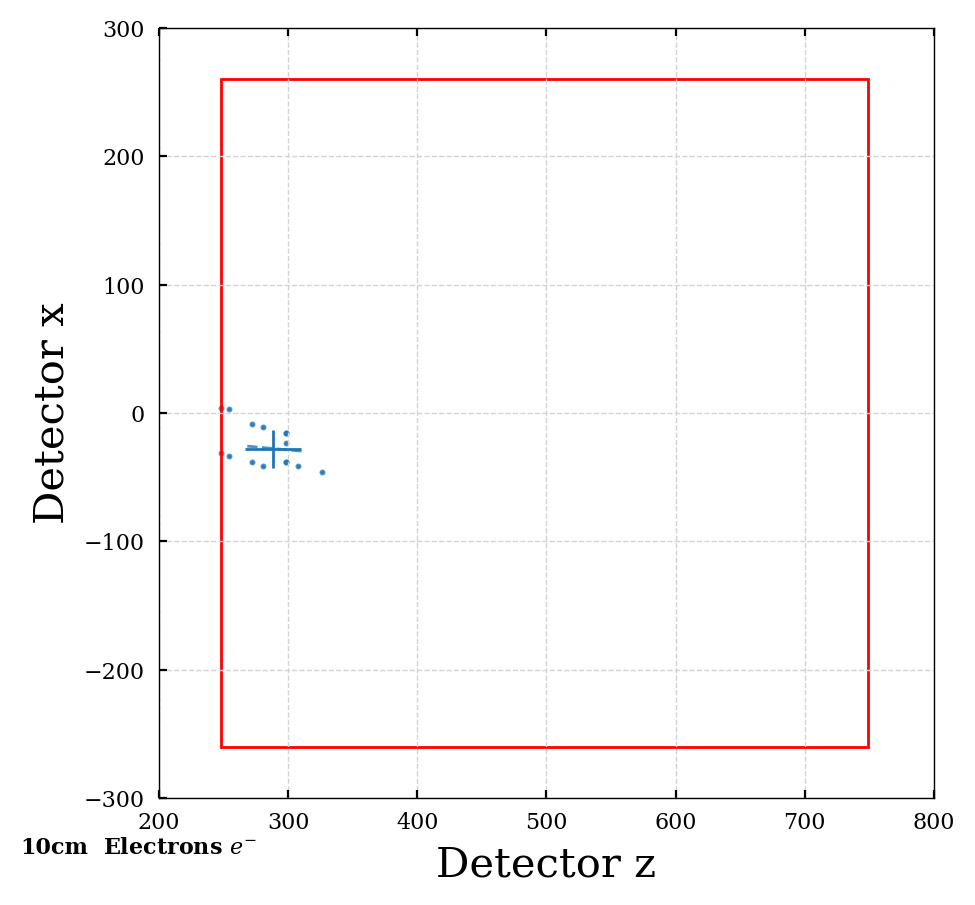

1
[51.8]


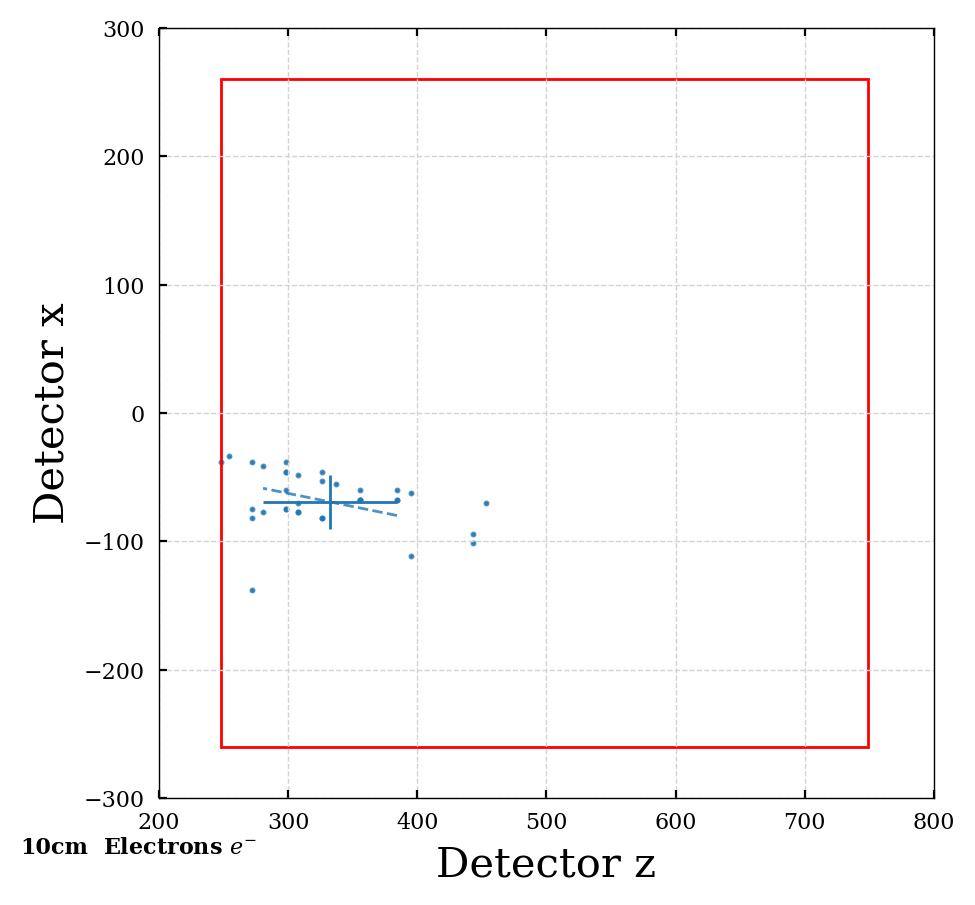

1
[31.3, 25.5]


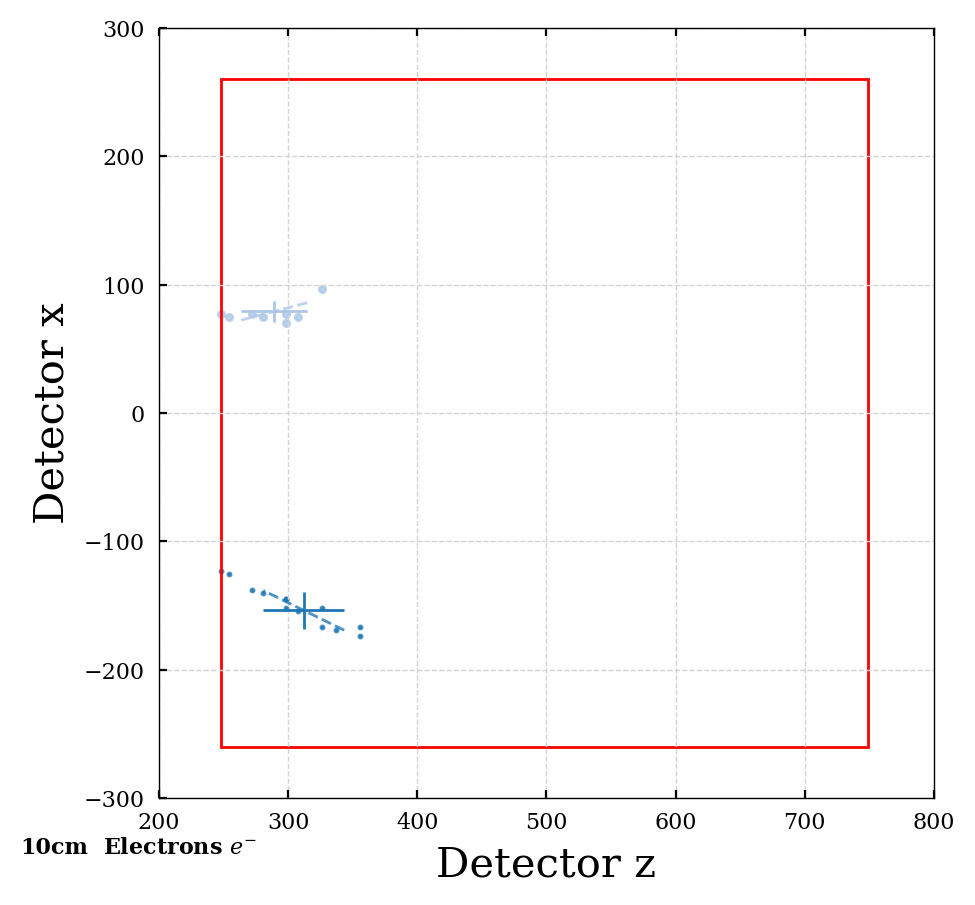

1
[81.1]


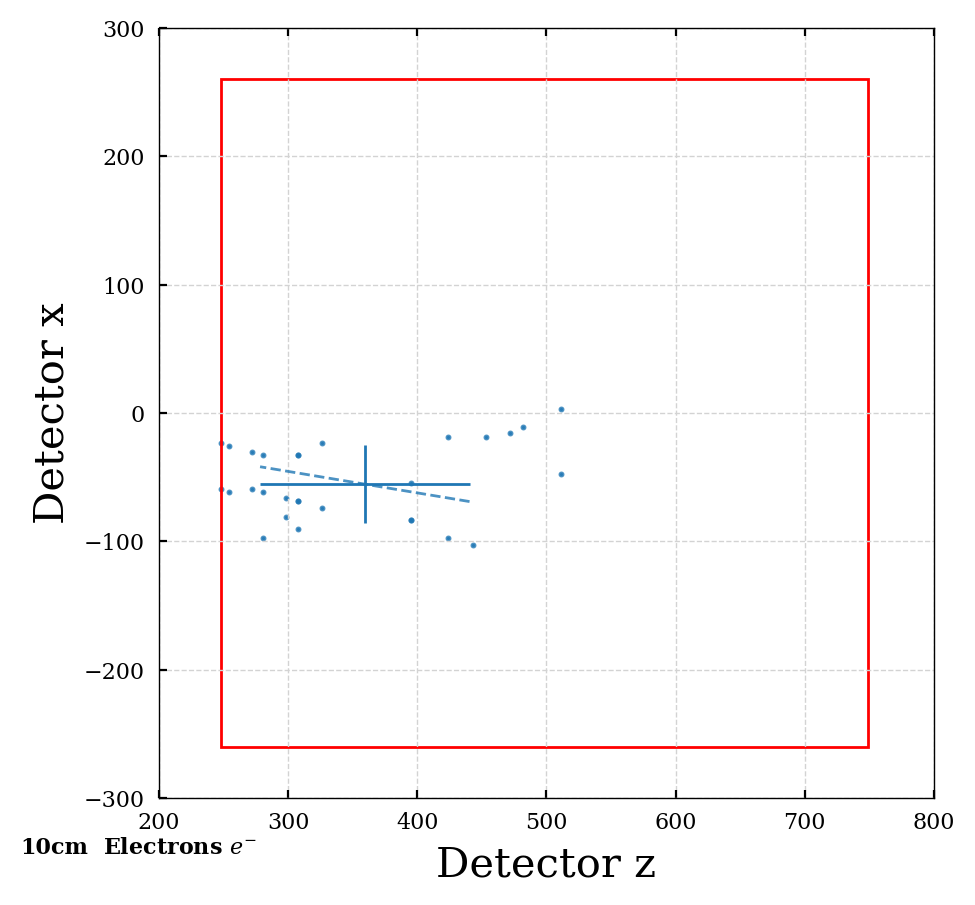

1
[35, 15.7]


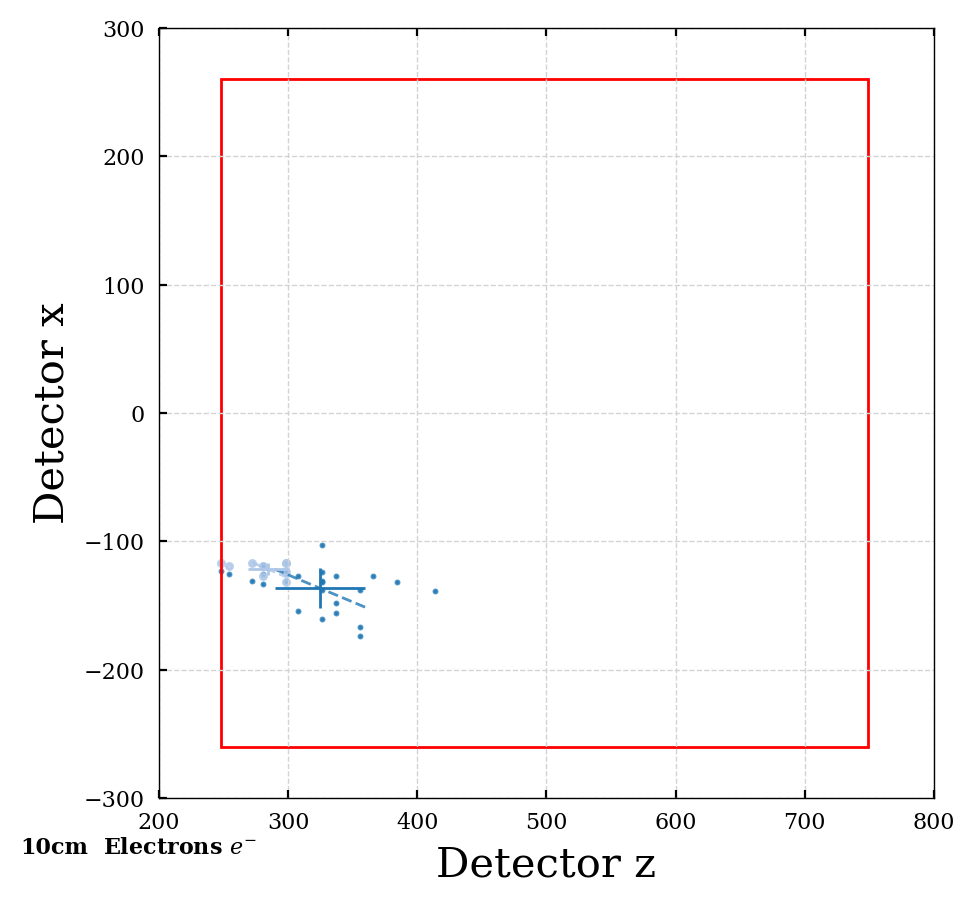

1
[38.8, 27]


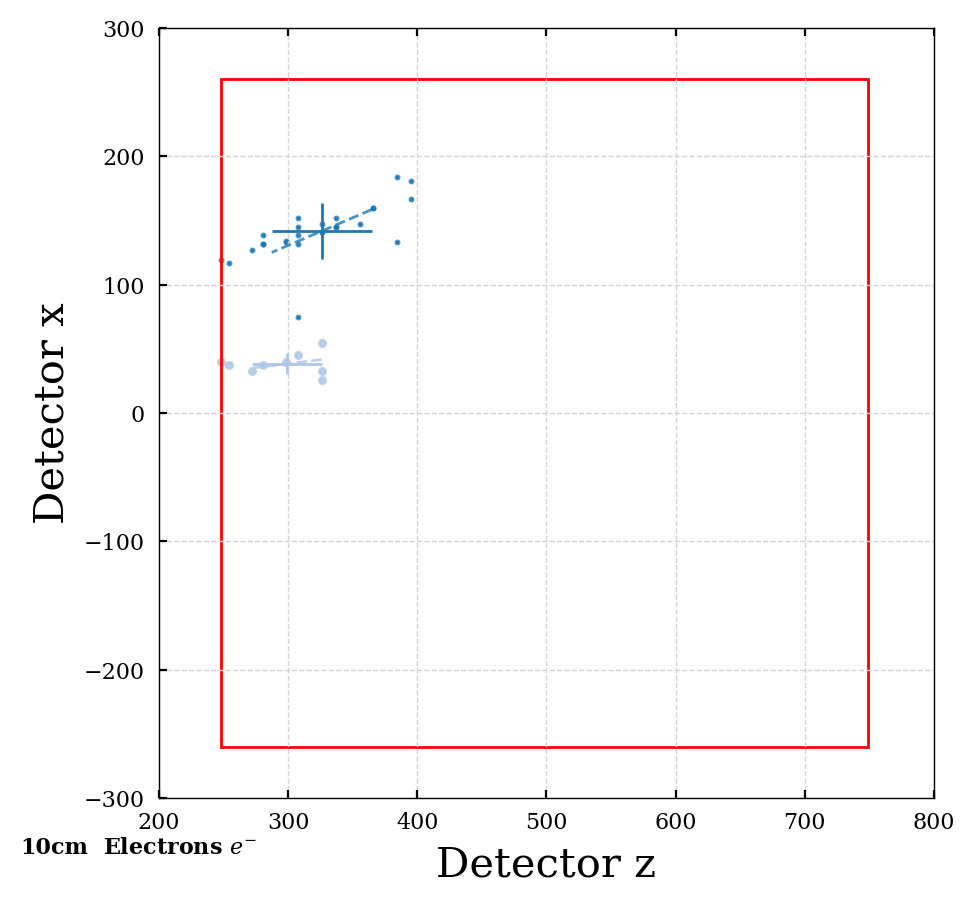

1
[38.8, 3.3]


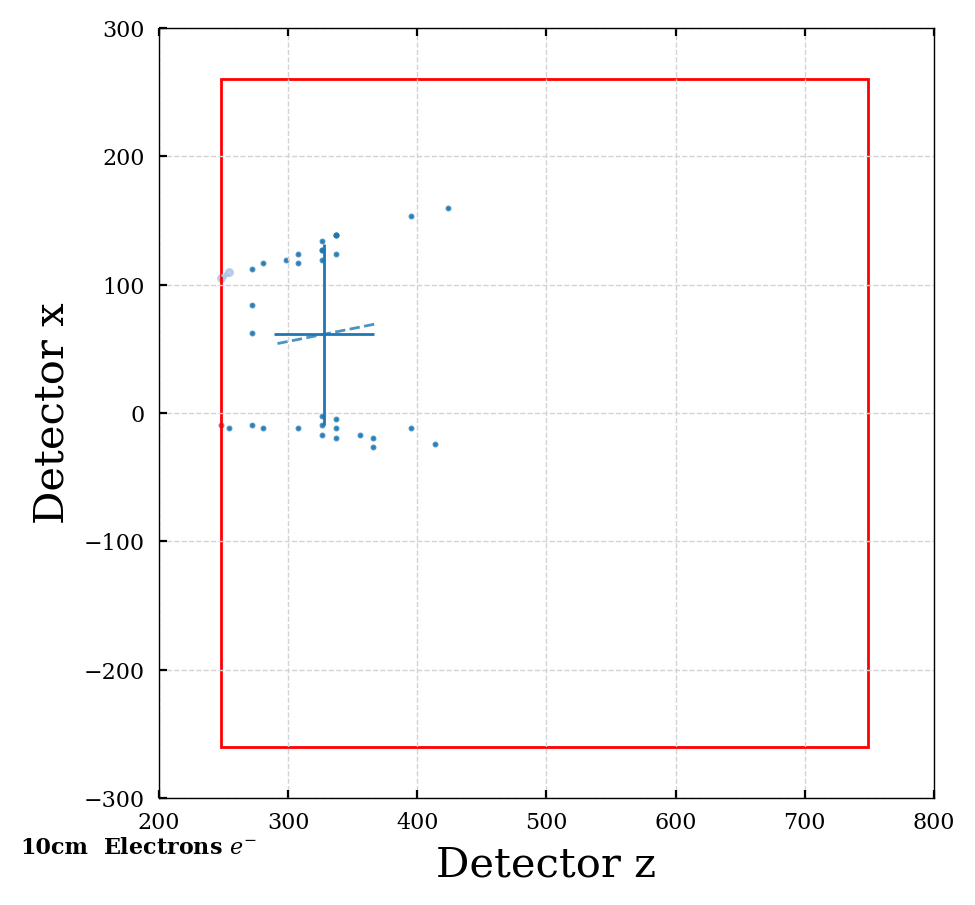

2
[48.7, 45.3, 14.4]


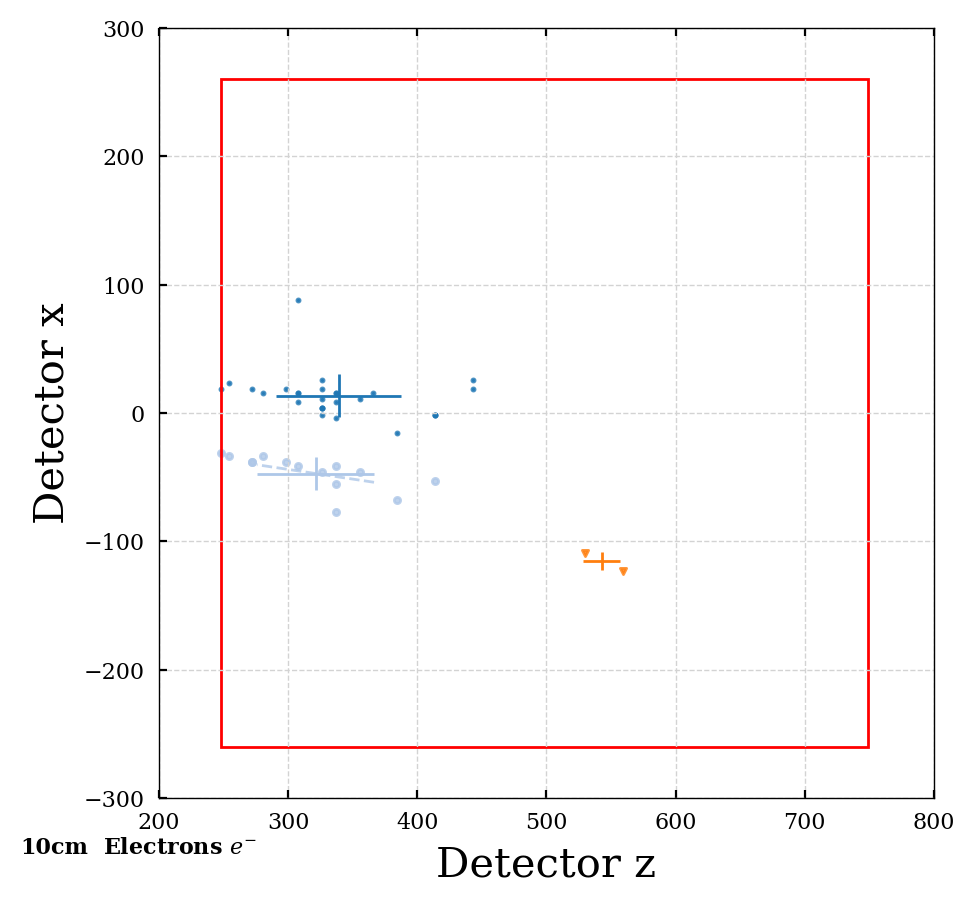

In [50]:
plot_cluster_dist(particles_dict_10cm, 10, spec_part='electrons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_10cm, 10, spec_part='electrons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

### Pions

2
[121, 148]


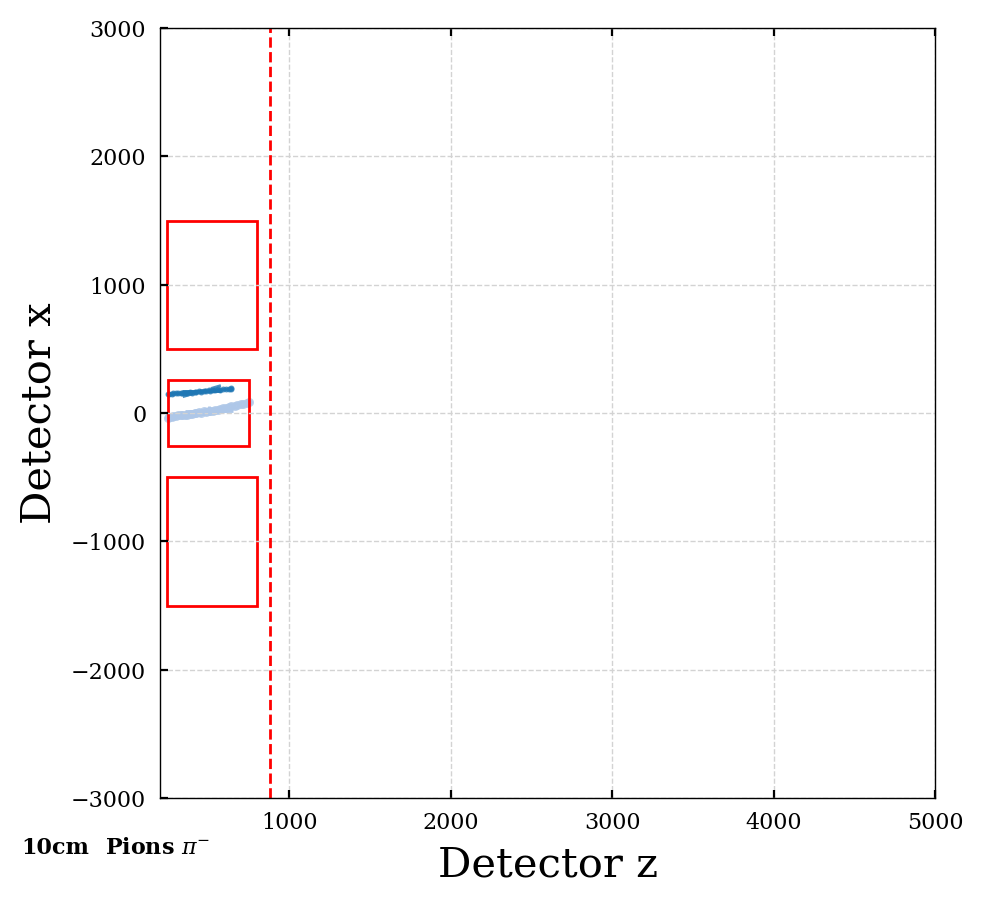

2
[135, 143]


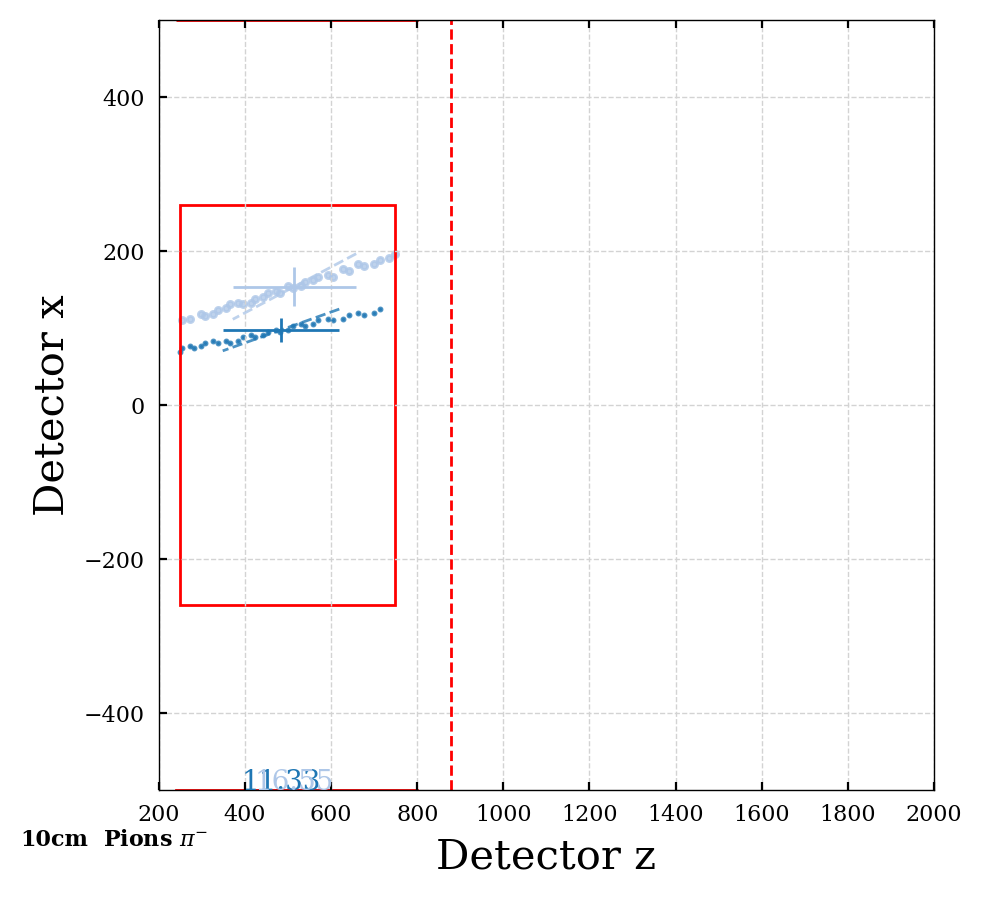

1
[145, 29.4]


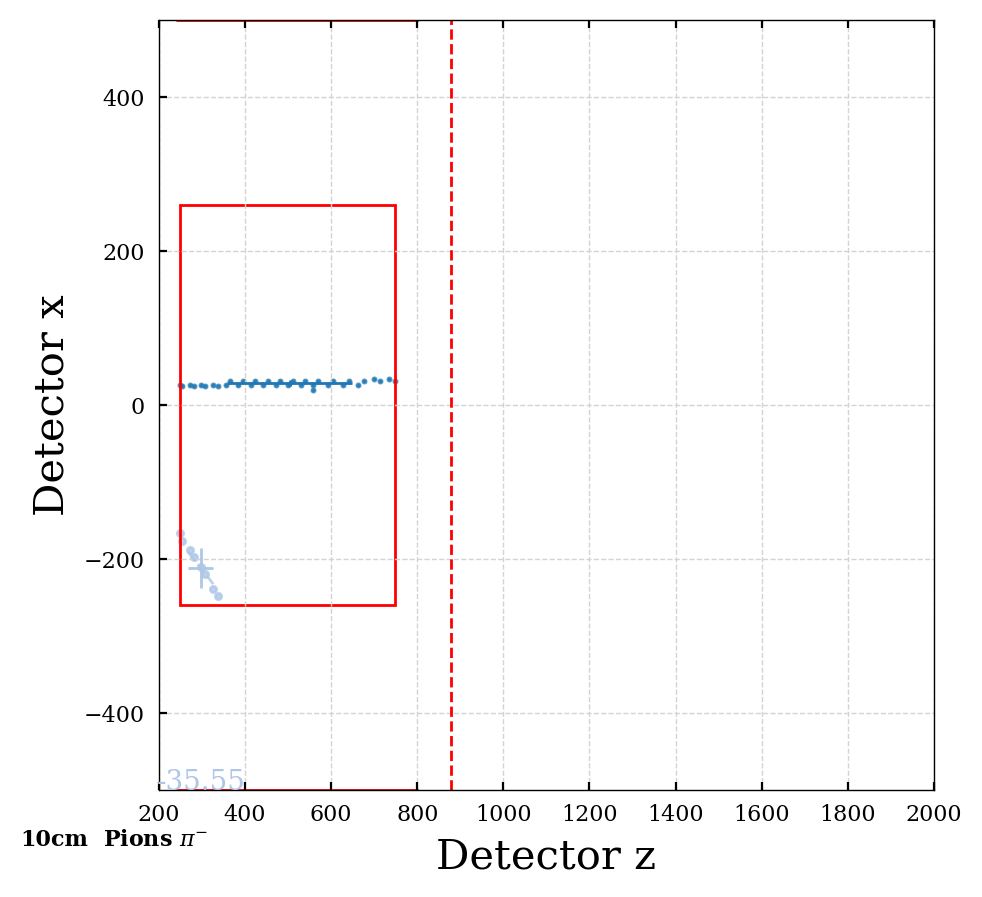

1
[152, 10.3]


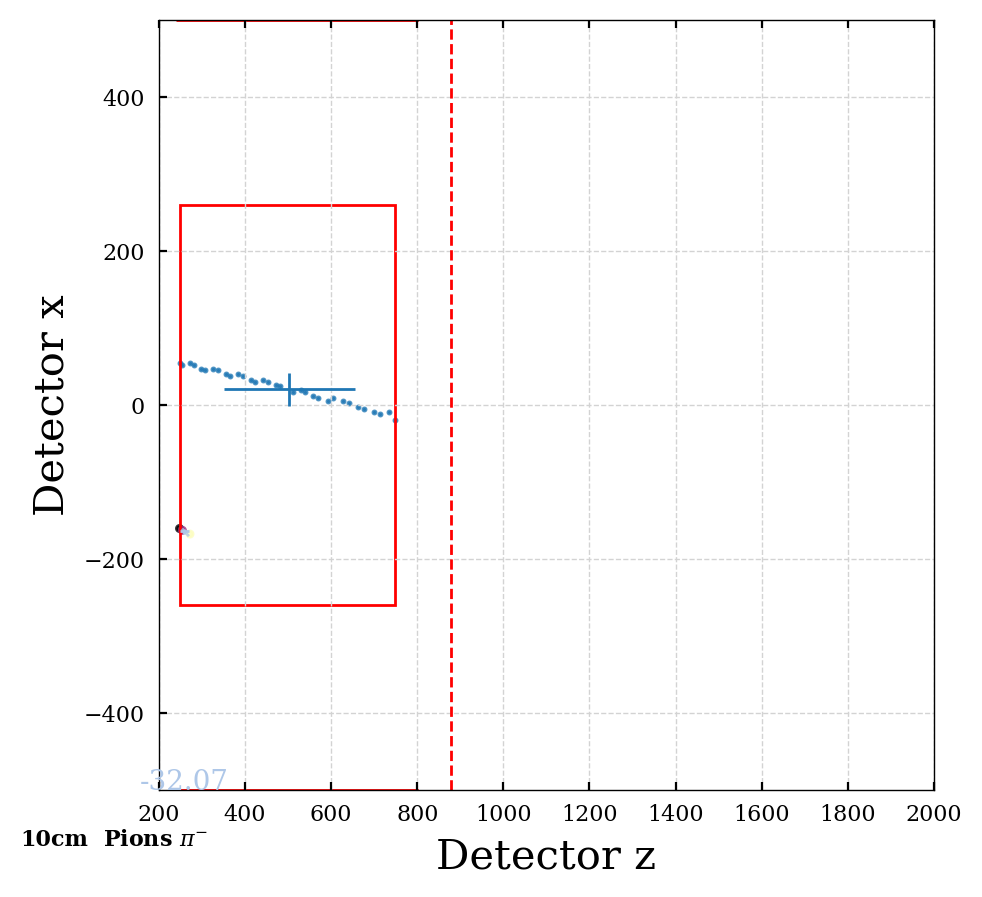

2
[151, 90.1]


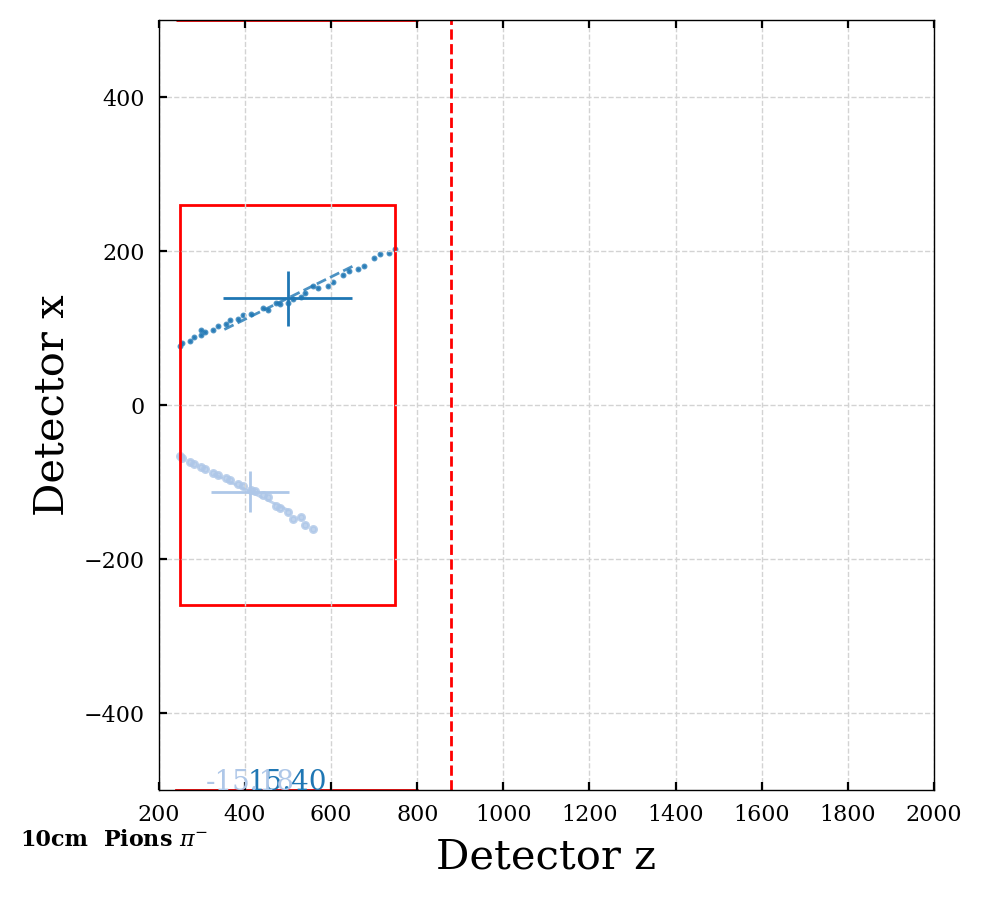

2
[148, 147]


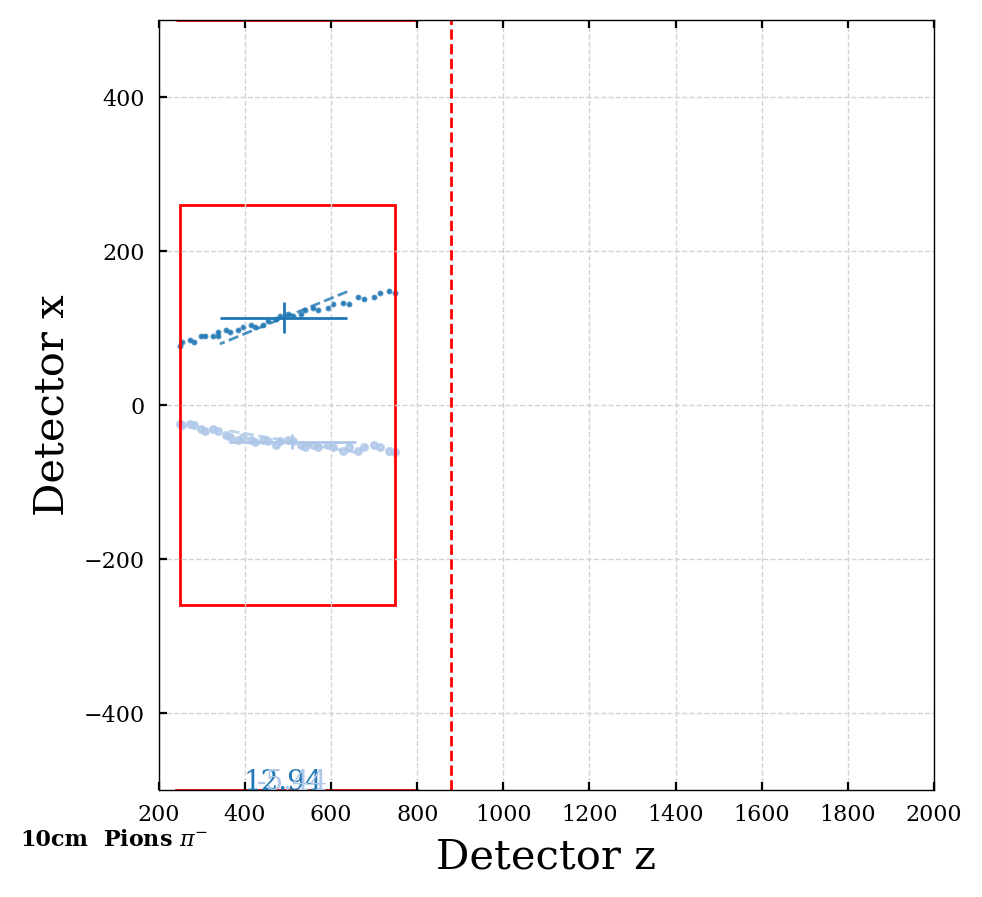

1
[146]


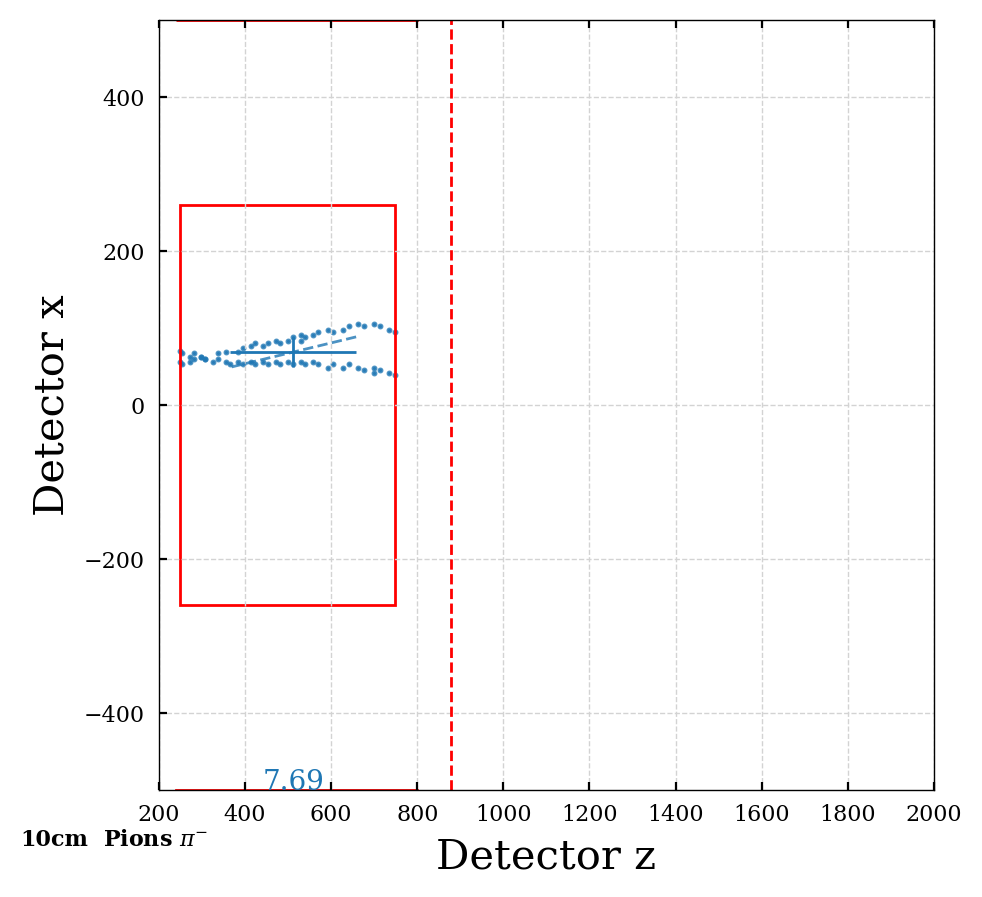

2
[148, 150]


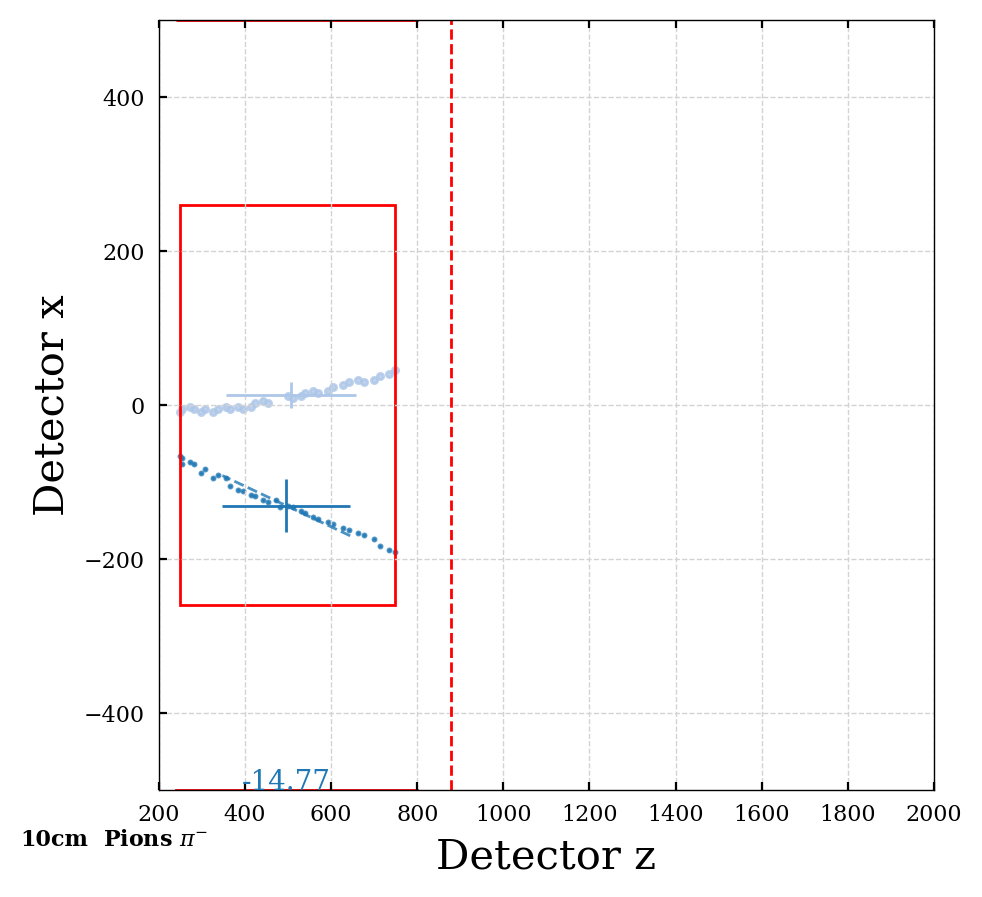

2
[146, 141]


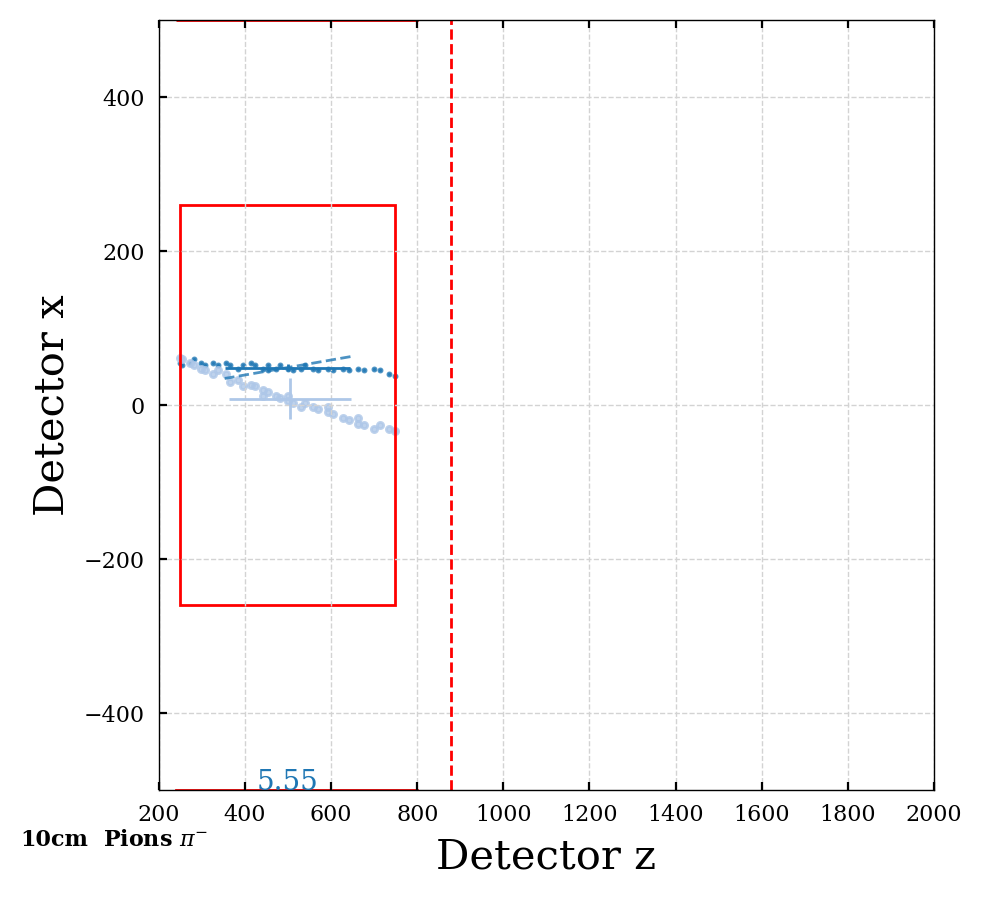

2
[152, 142]


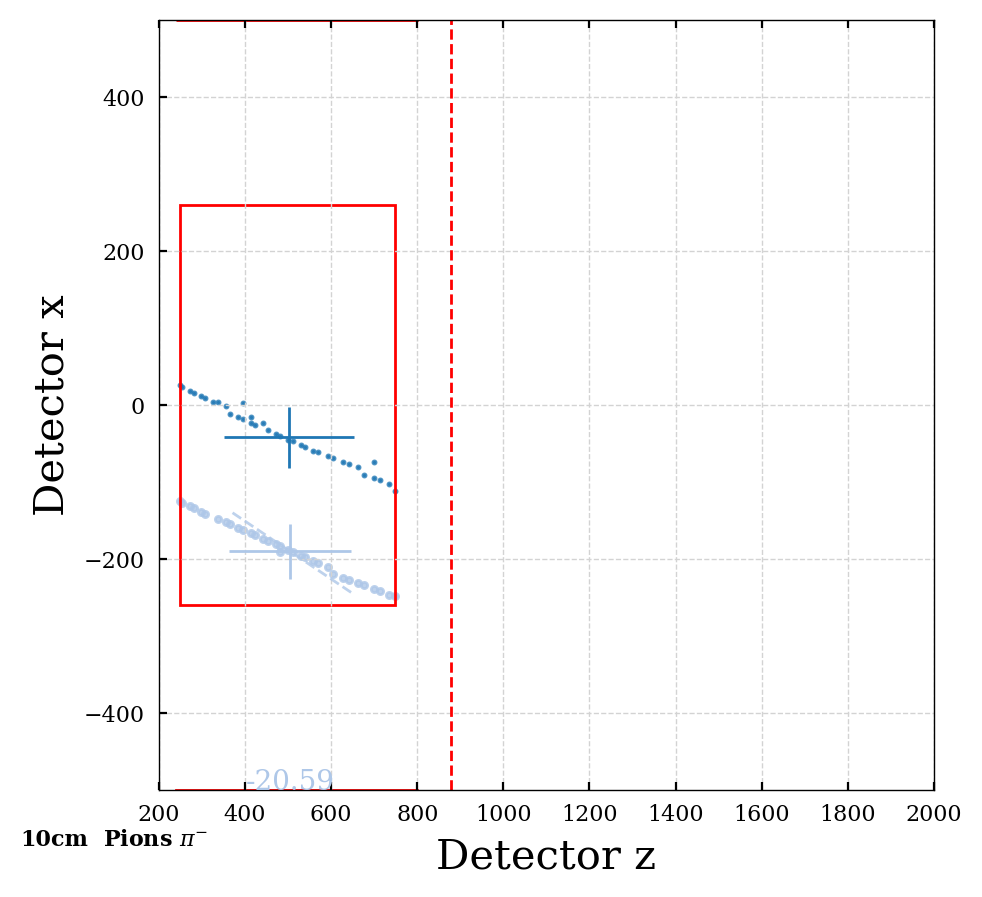

1
[119, 45.3]


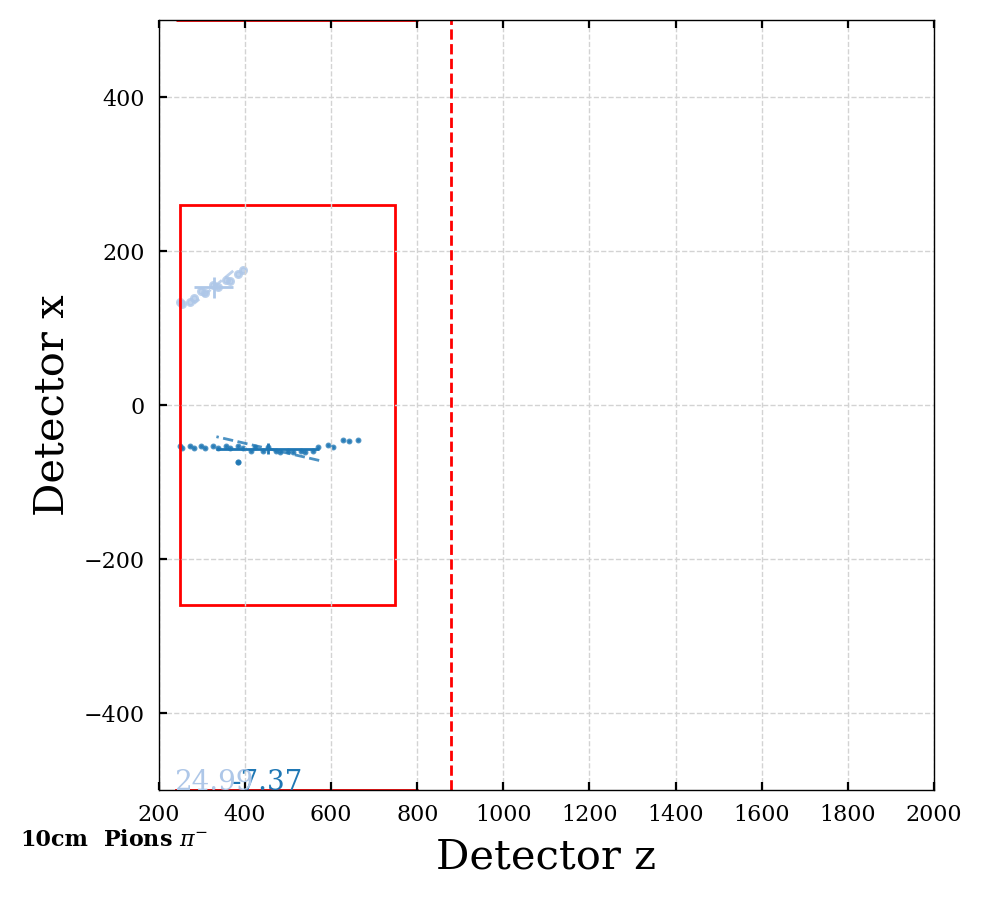

In [51]:
plot_cluster_dist(particles_dict_10cm, 10, spec_part='pions', ipart=None, xlim=5000, ylim=3000, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_10cm, 10, spec_part='pions', ipart=ipart, xlim=2000, ylim=500, angle_label=True)

3
[84.2, 53.8, 53.3]


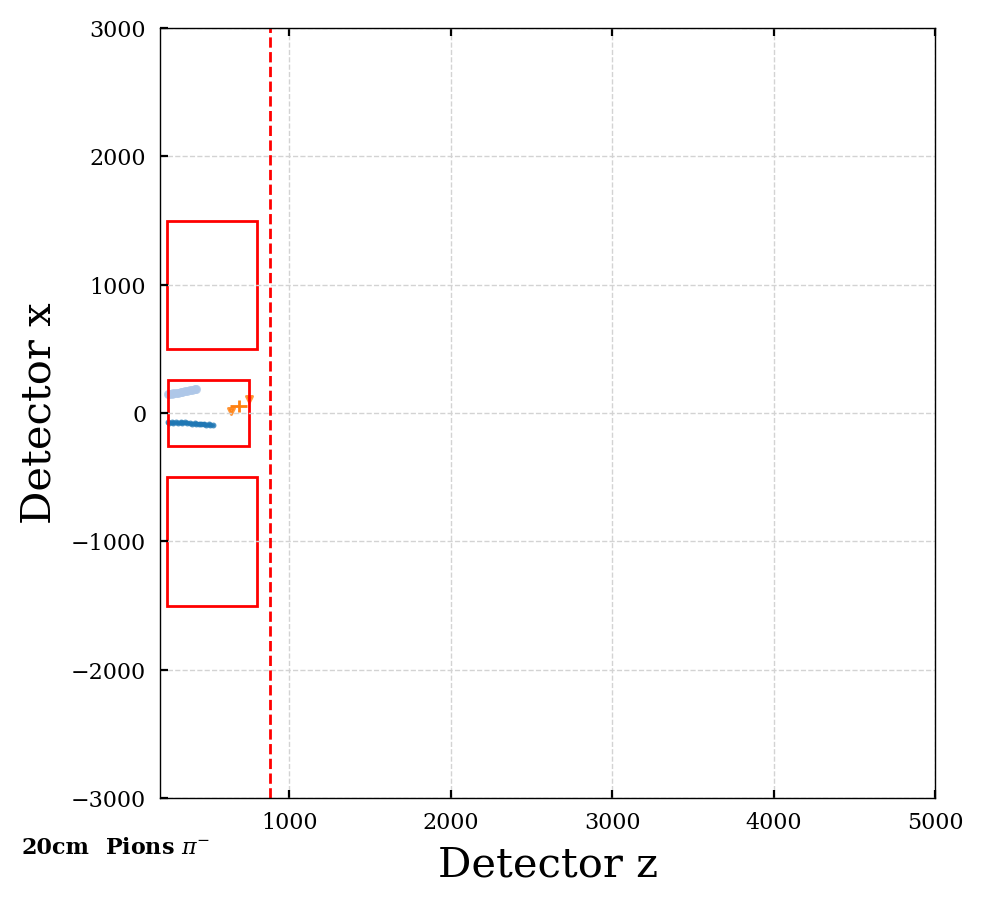

1
[140]


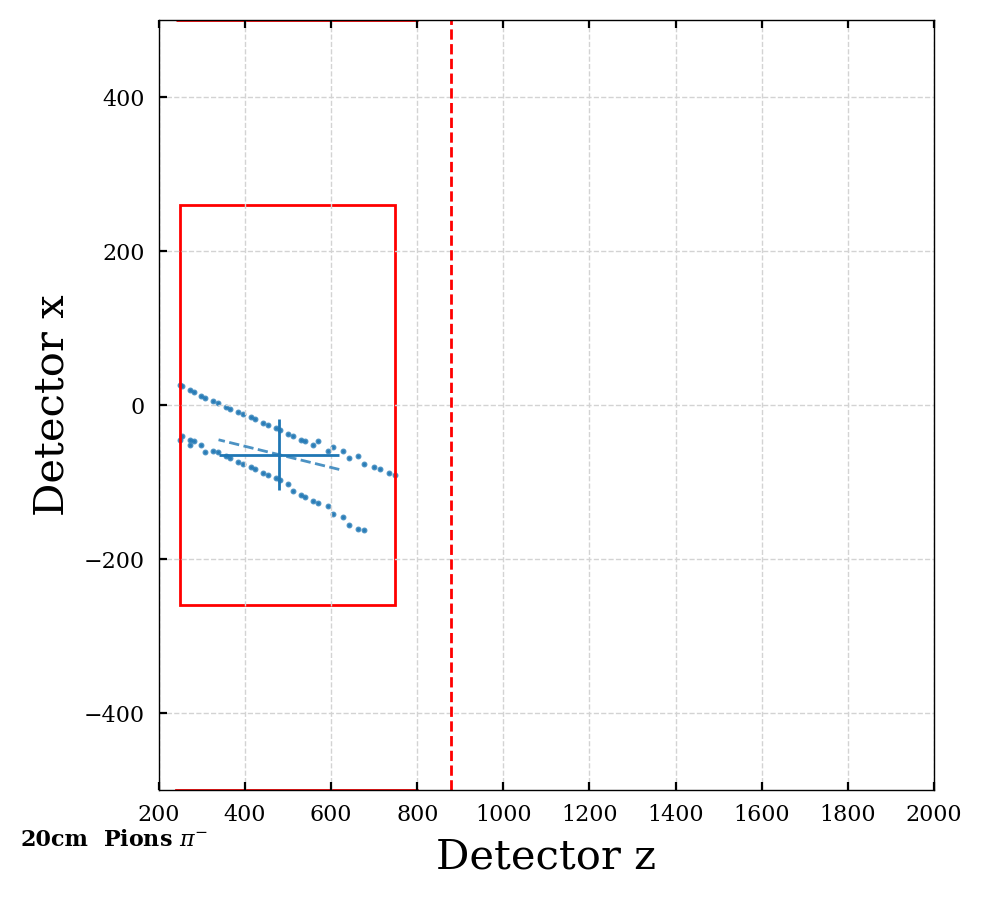

1
[145]


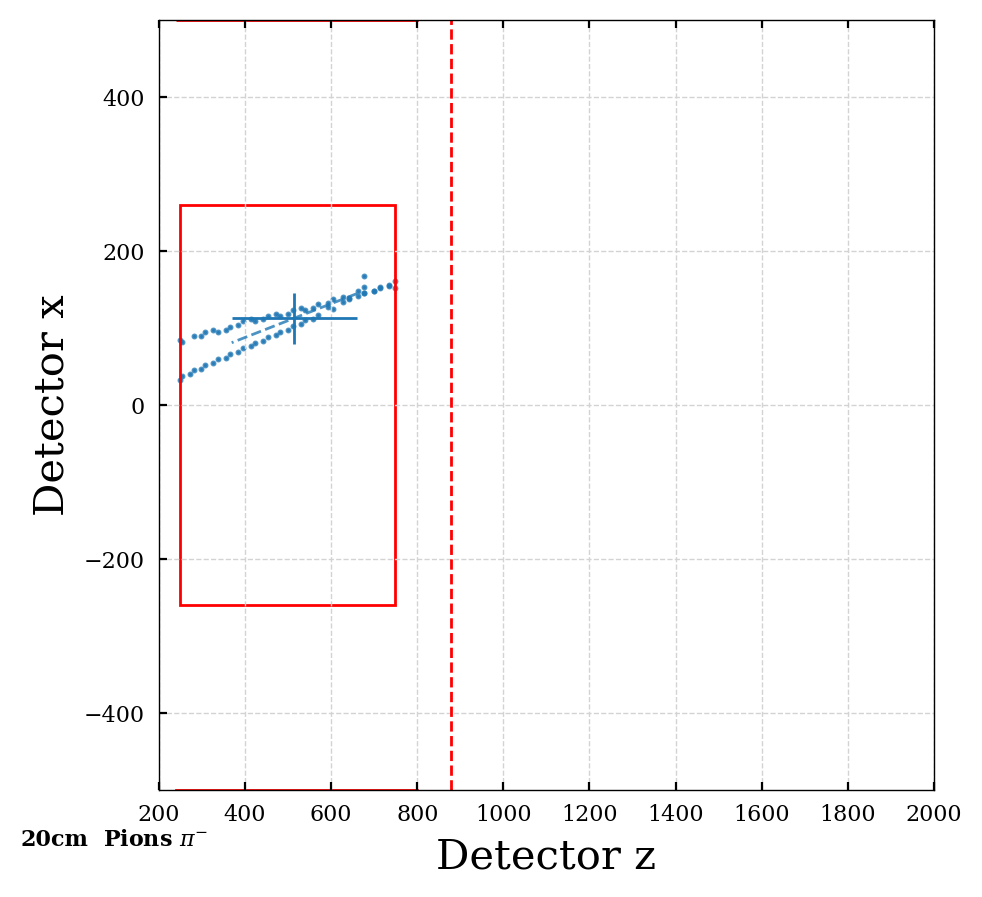

2
[140, 145]


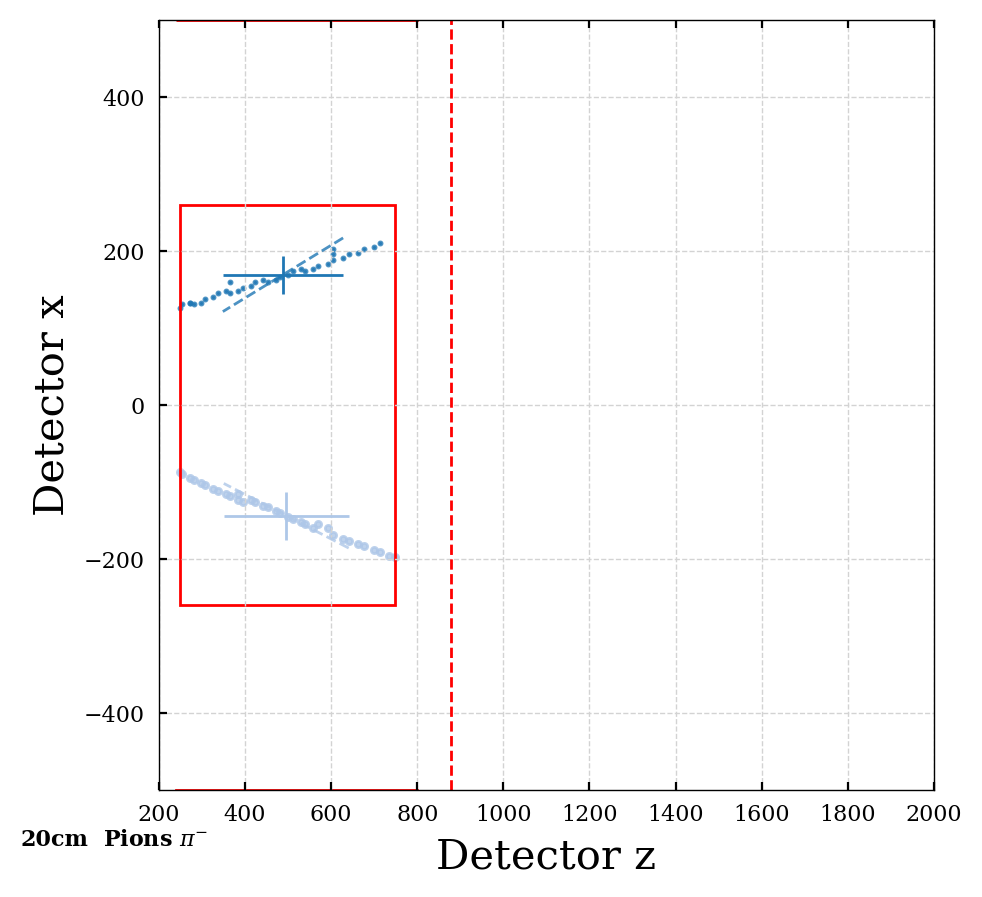

1
[145]


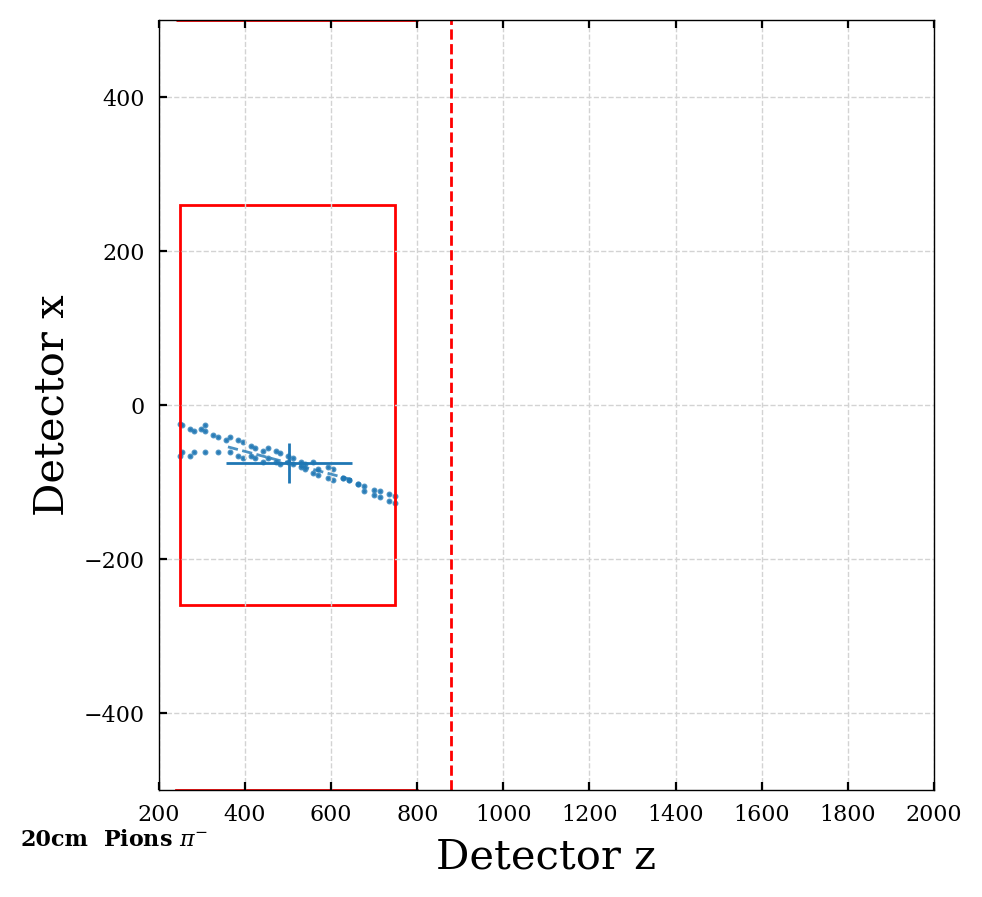

2
[143, 45.3]


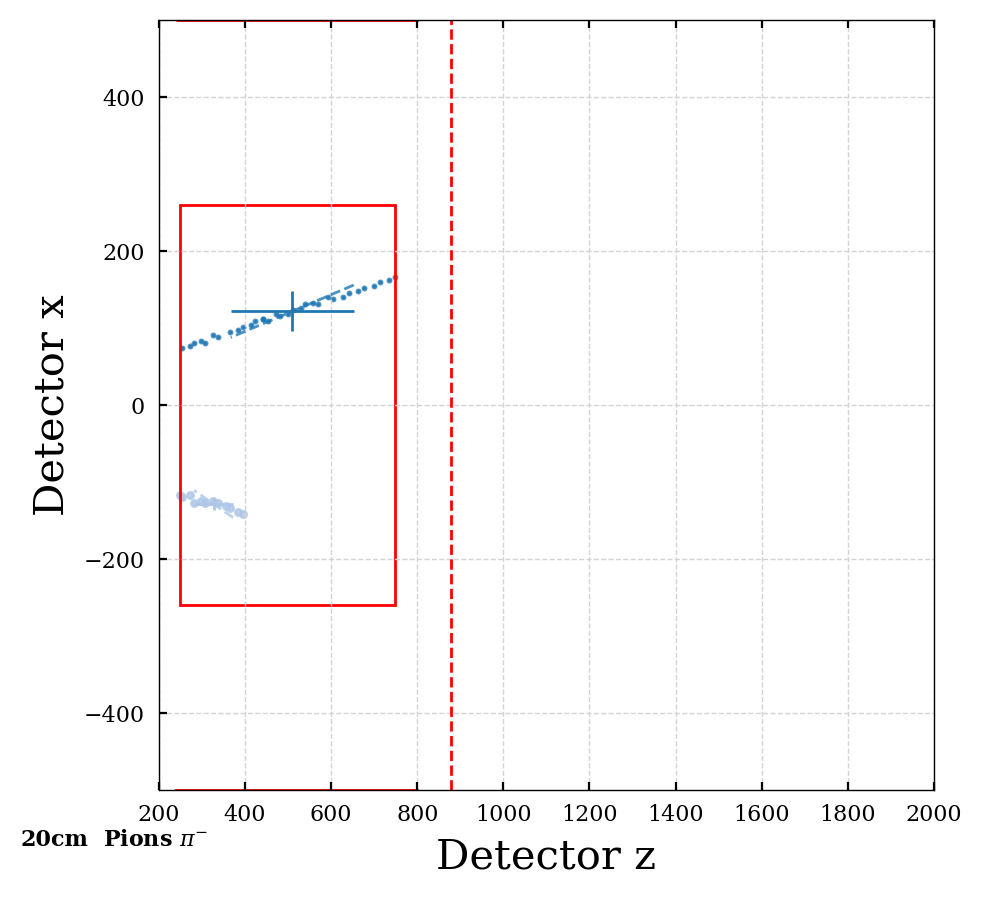

1
[143]


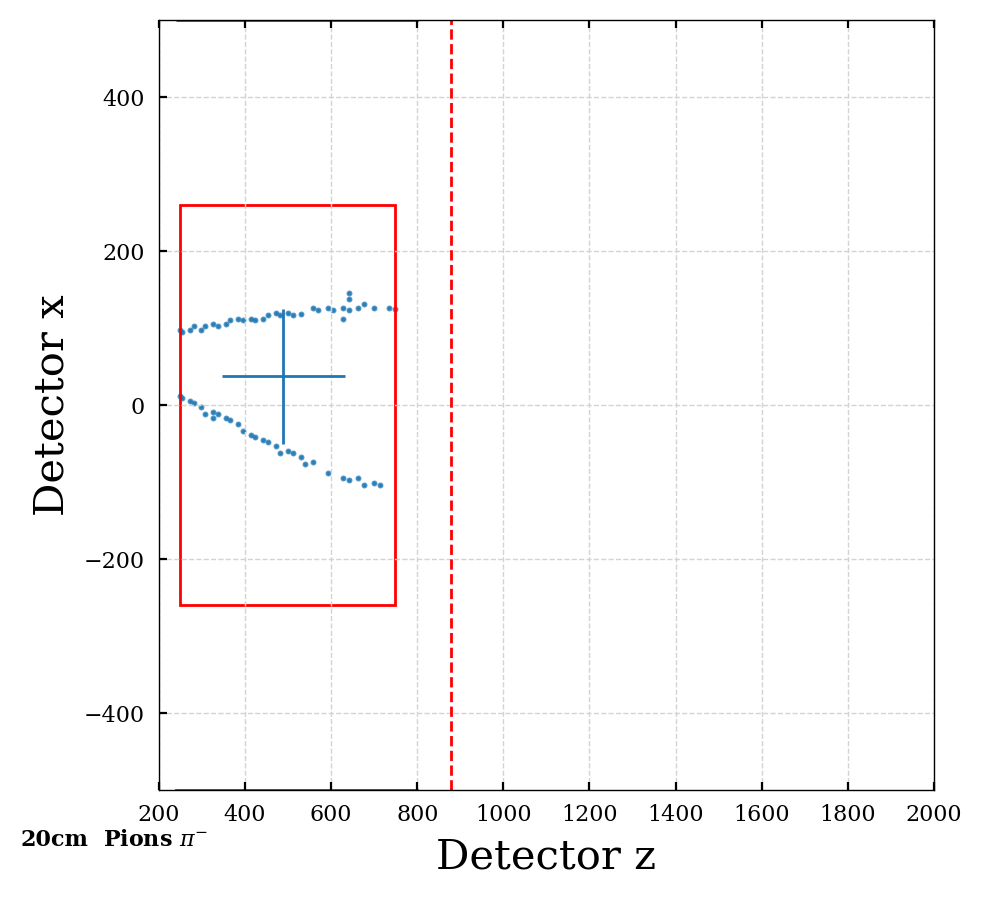

1
[117]


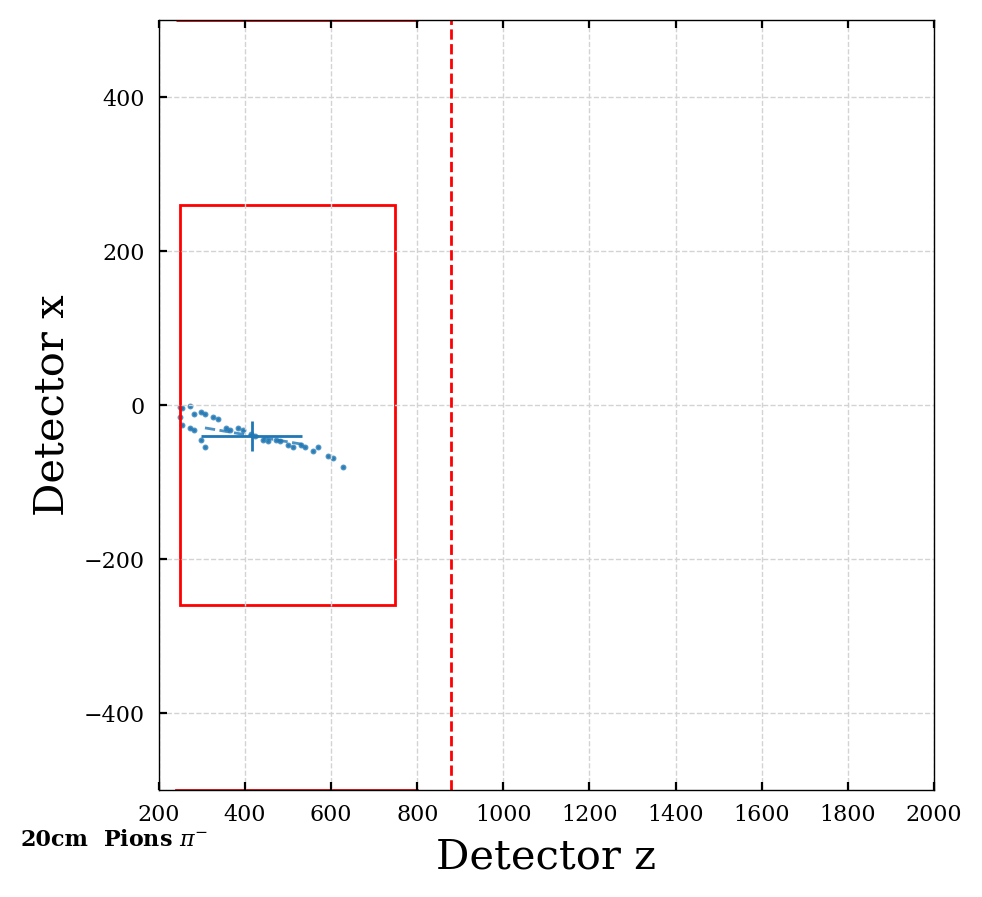

1
[149]


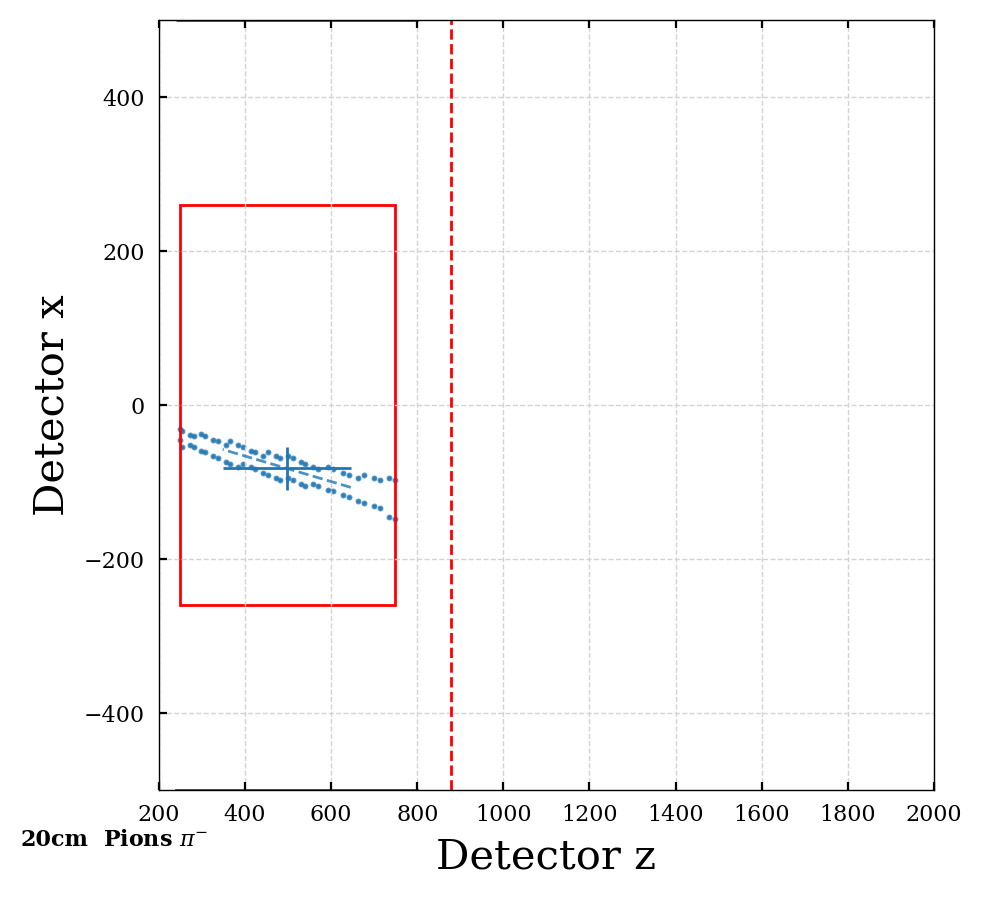

1
[102]


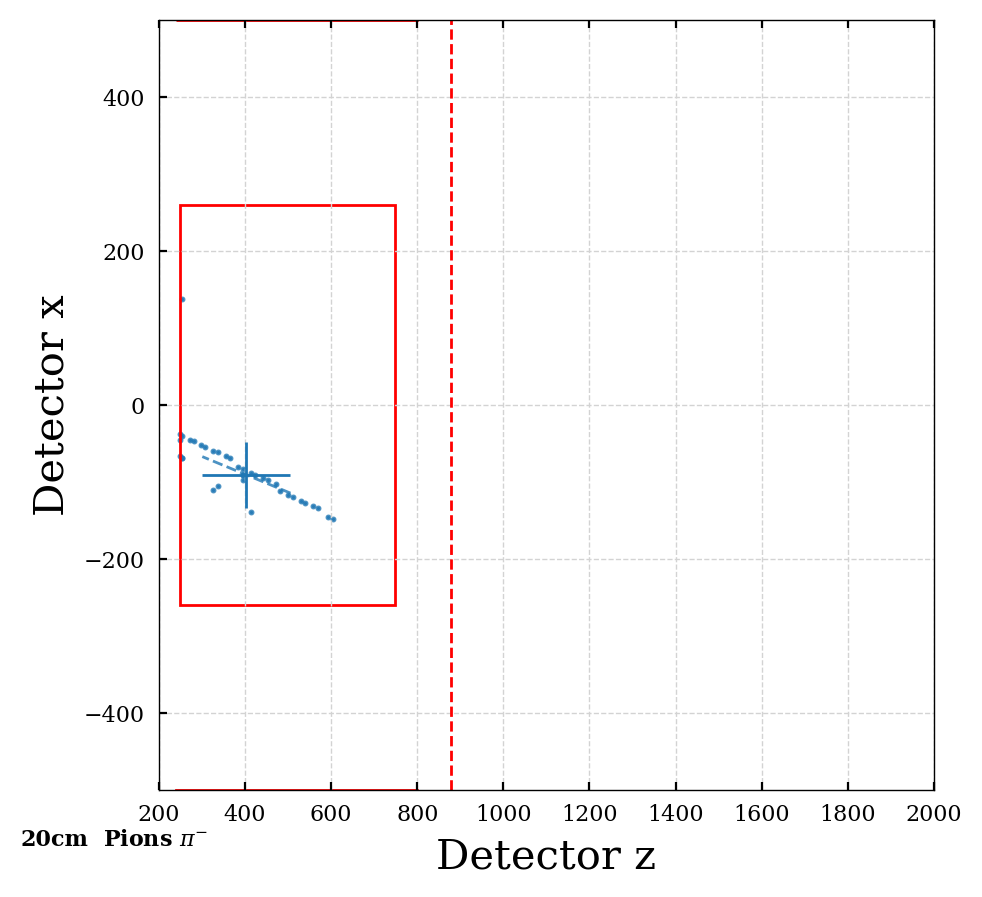

2
[94.4, 79.3]


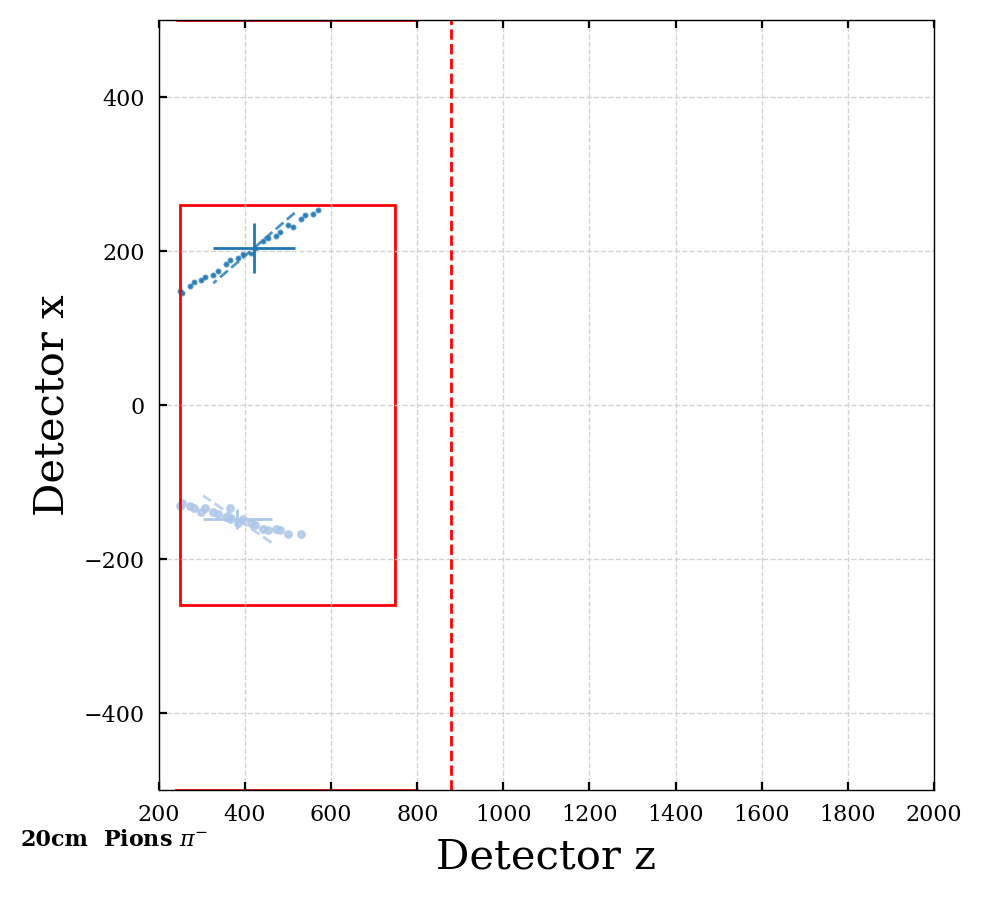

In [52]:
plot_cluster_dist(particles_dict_20cm, 20, spec_part='pions', ipart=None, xlim=5000, ylim=3000, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_20cm, 20, spec_part='pions', ipart=ipart, xlim=2000, ylim=500, angle_label=False)

### Neutrons

3
[41, 49.1, 37.3, 25, 24.7]


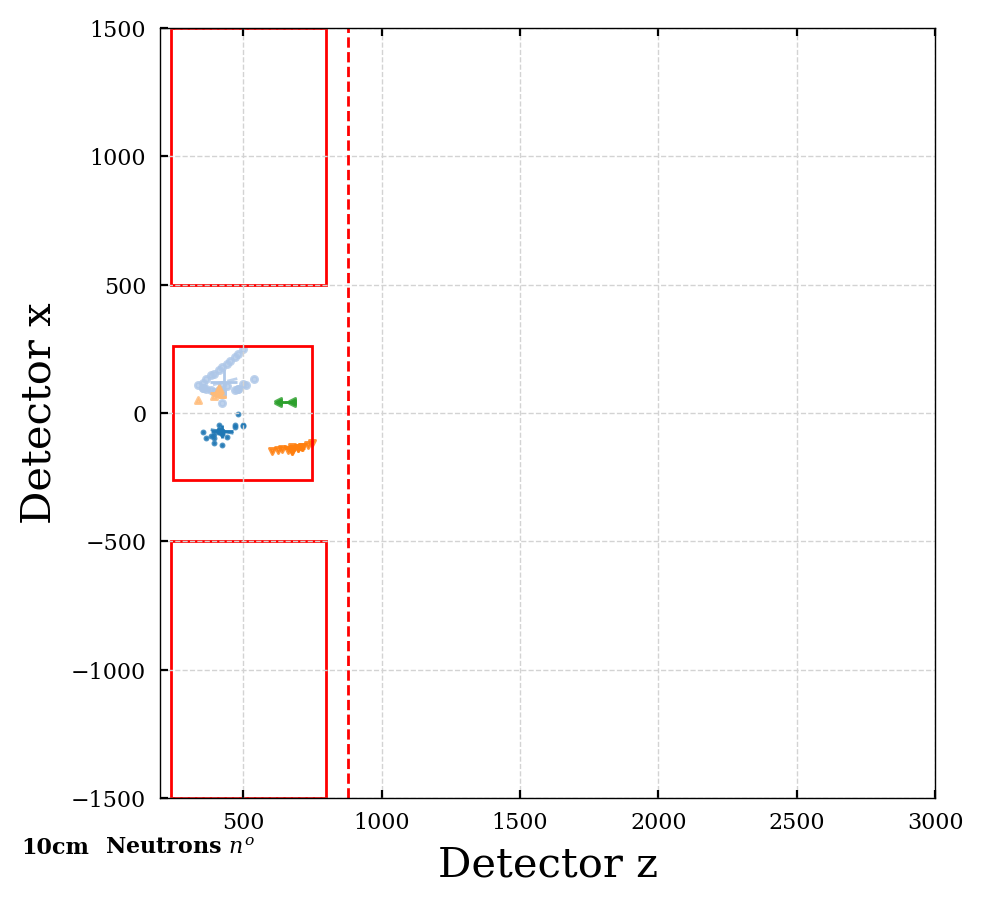

0
[None]


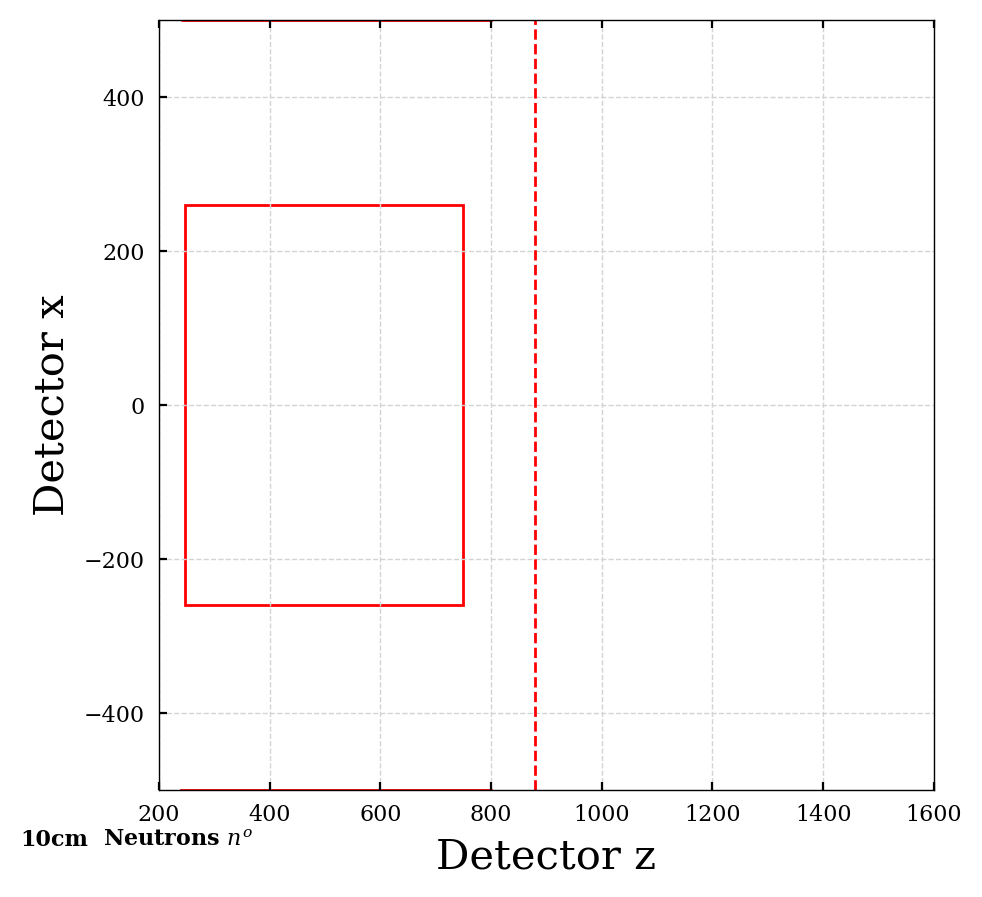

0
[7.51]


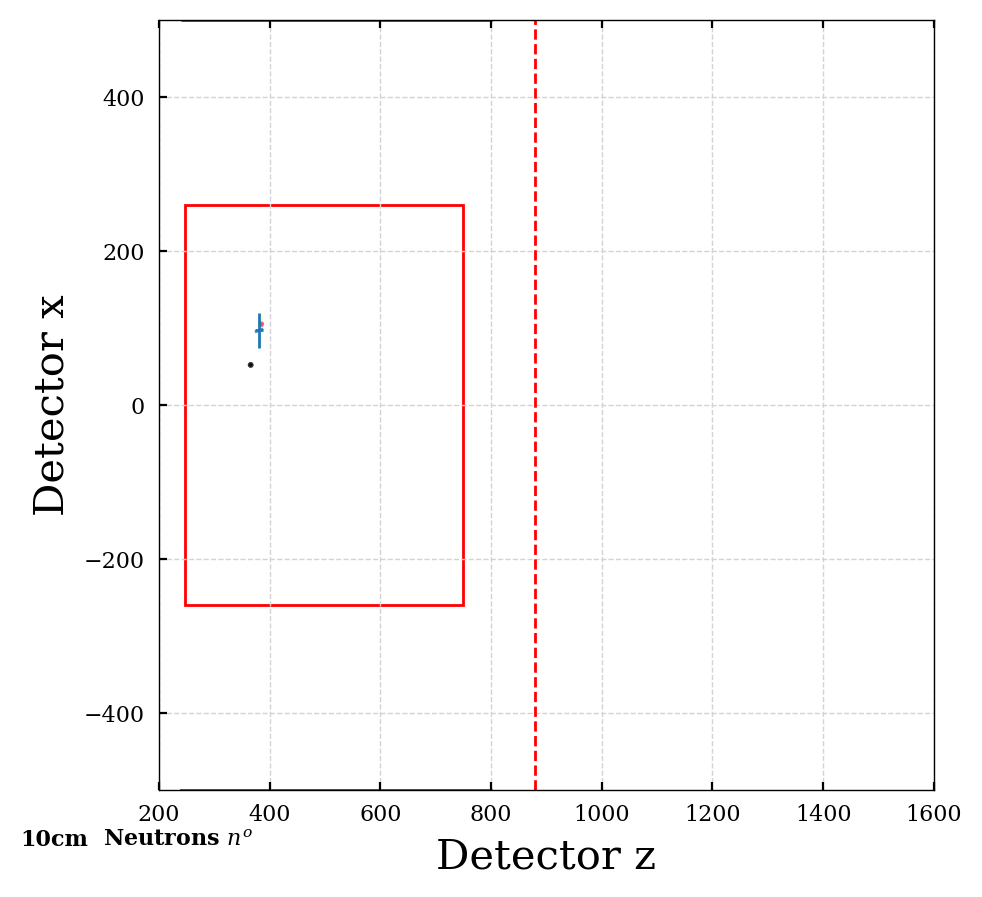

1
[26.6]


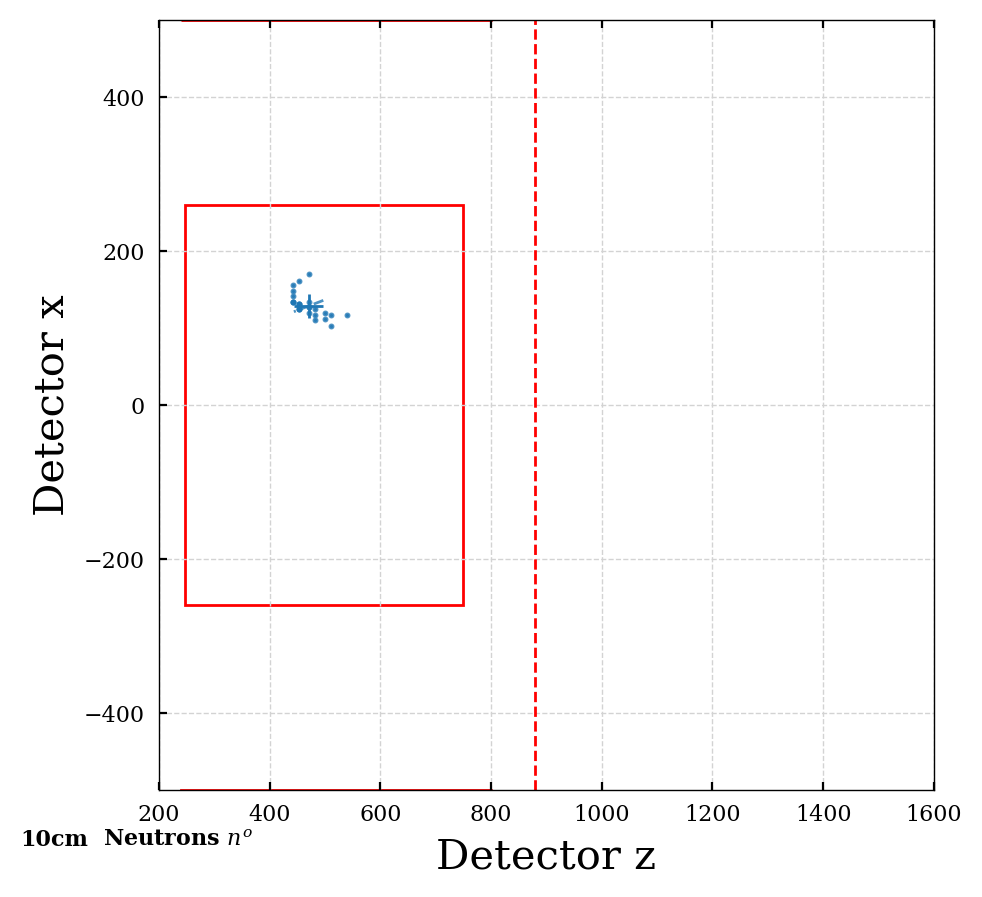

0
[12]


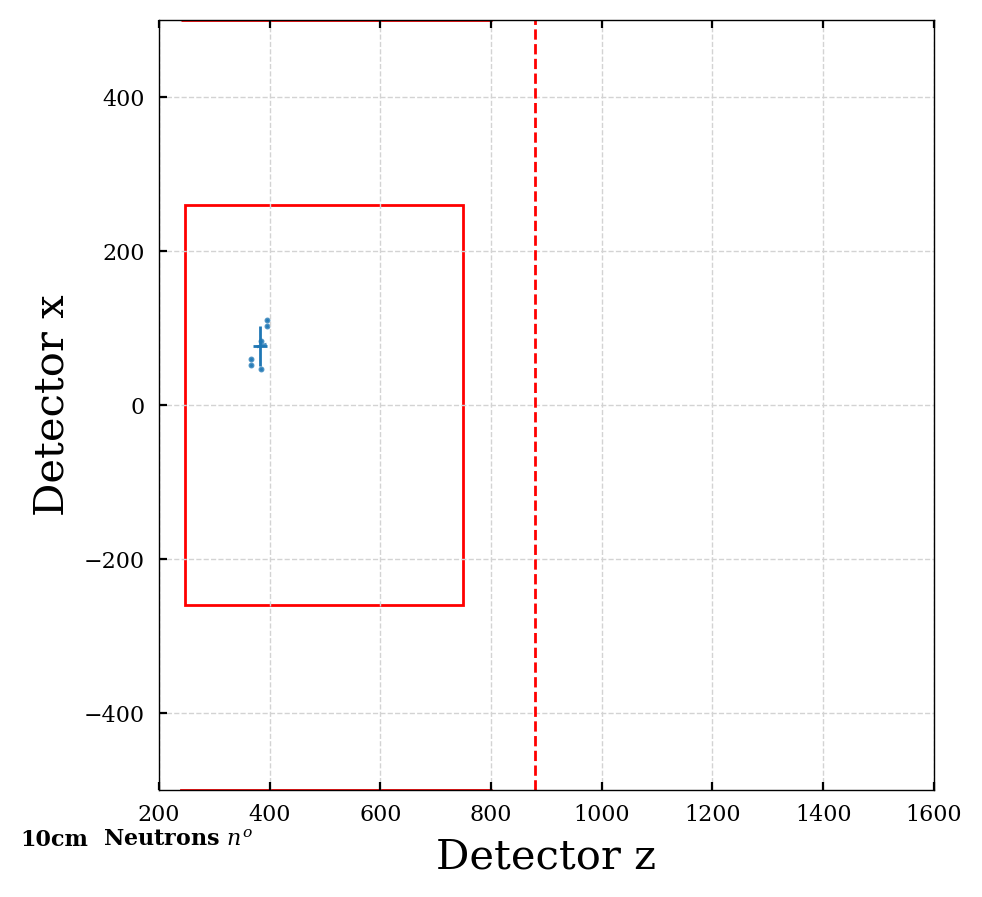

2
[181, 98.6]


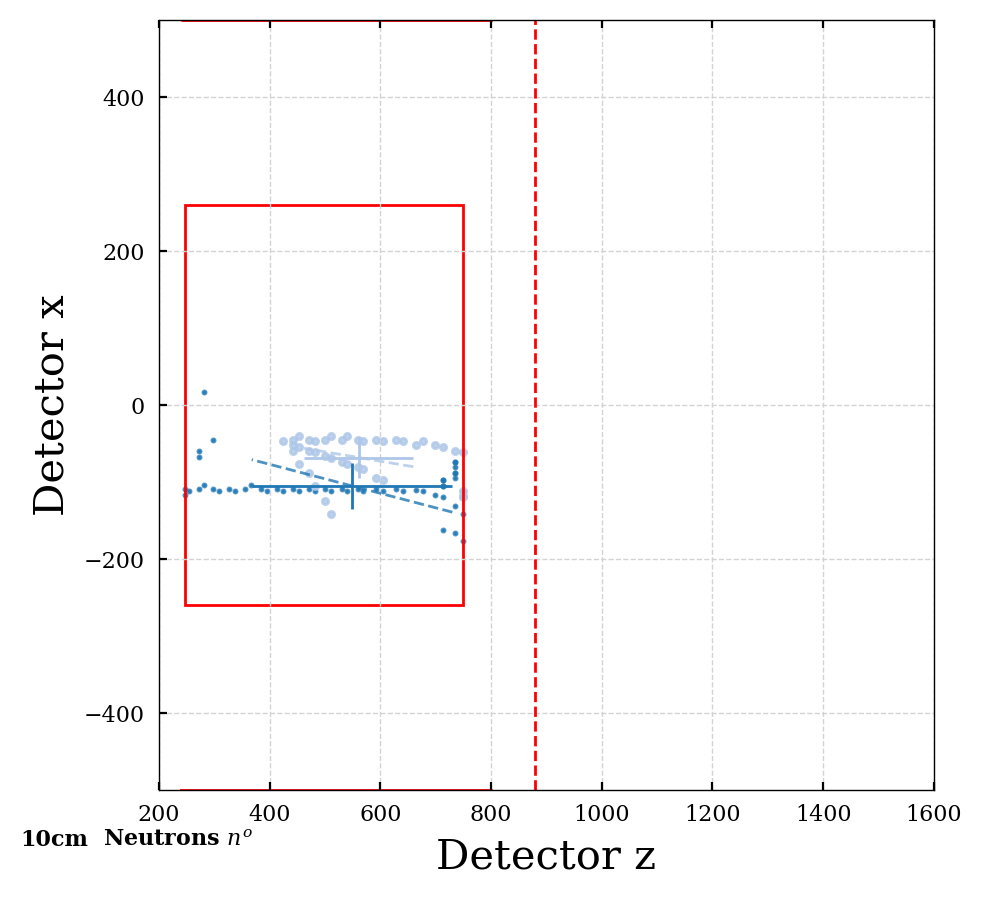

1
[50, 14.5]


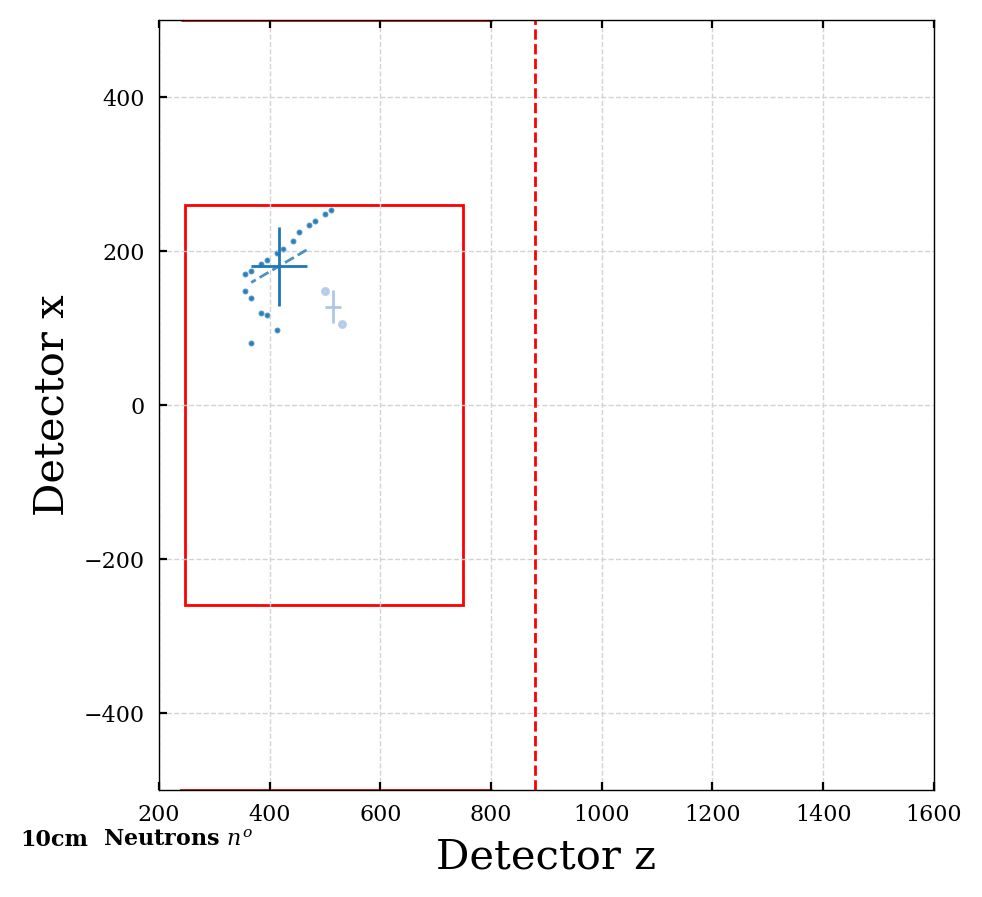

0
[17.4, 27.5, 20.3]


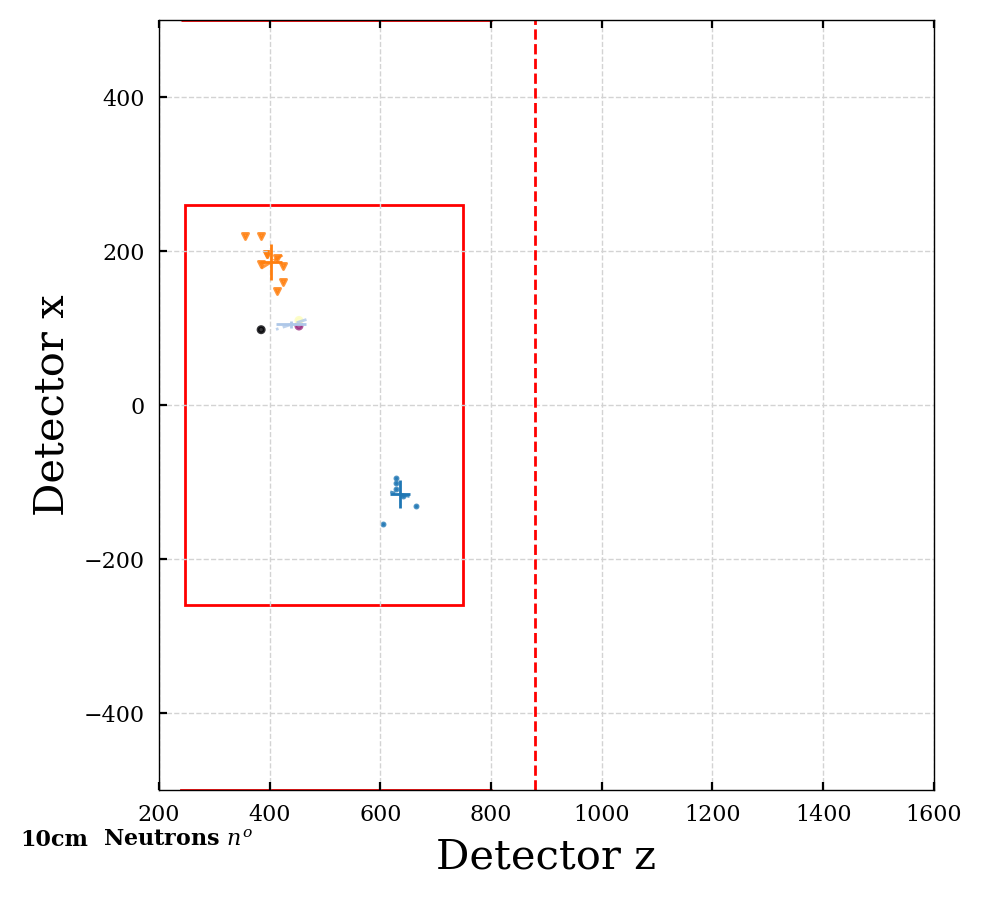

1
[50.9, nan]


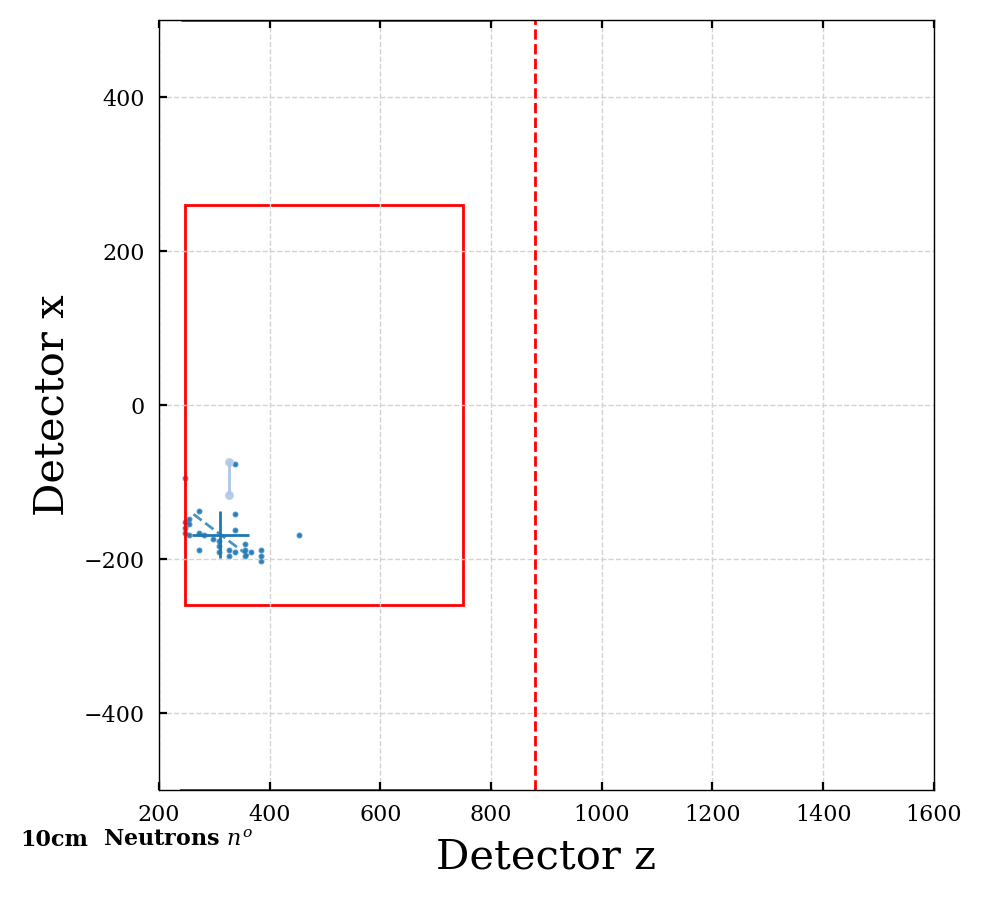

1
[61.1, 0.0569]


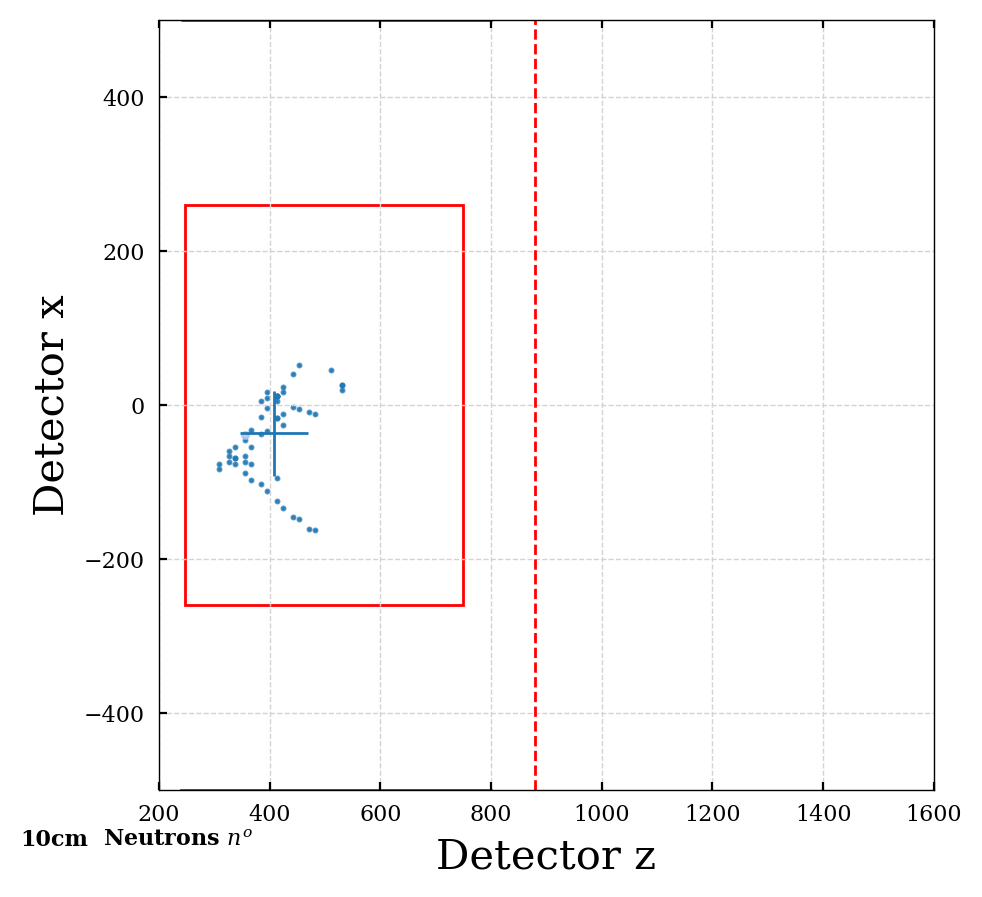

0
[23.2]


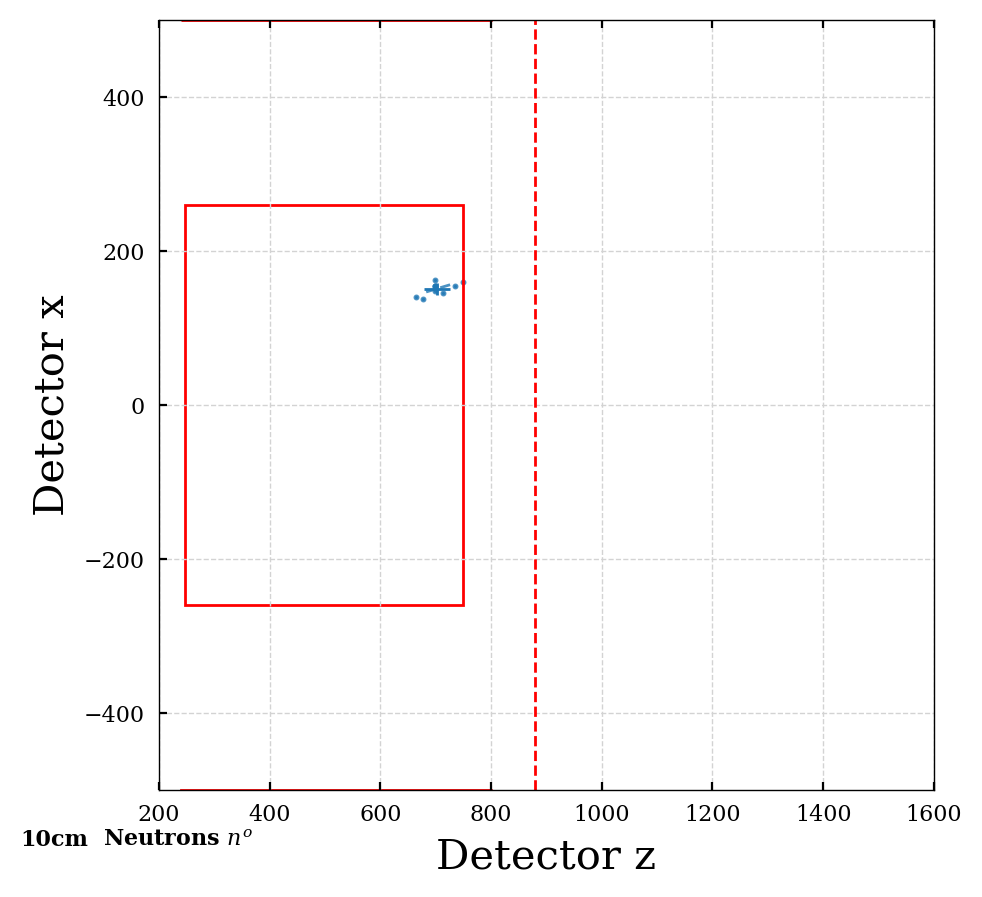

In [53]:
plot_cluster_dist(particles_dict_10cm, 10, spec_part='neutrons', ipart=None, xlim=3000, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_10cm, 10, spec_part='neutrons', ipart=ipart, xlim=1600, ylim=500, angle_label=False)

4
[27.3, 95.2, 27, 0.0343]


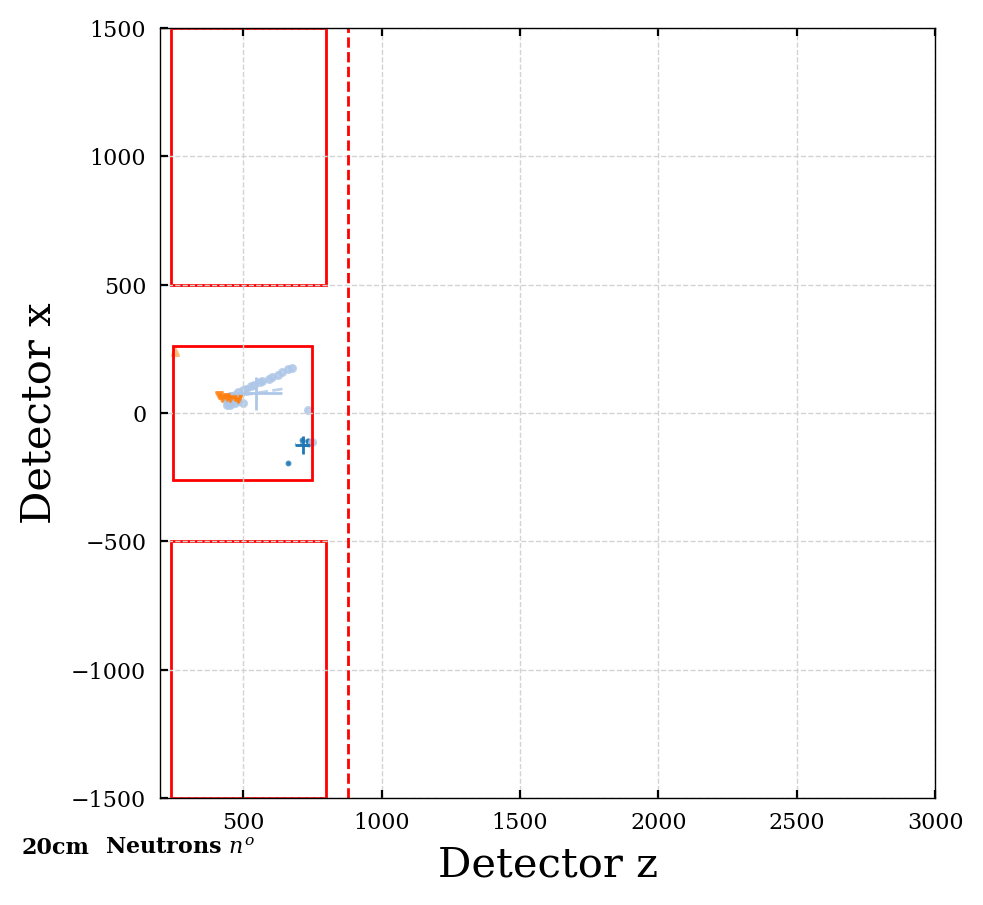

2
[49.9, 0.0218]


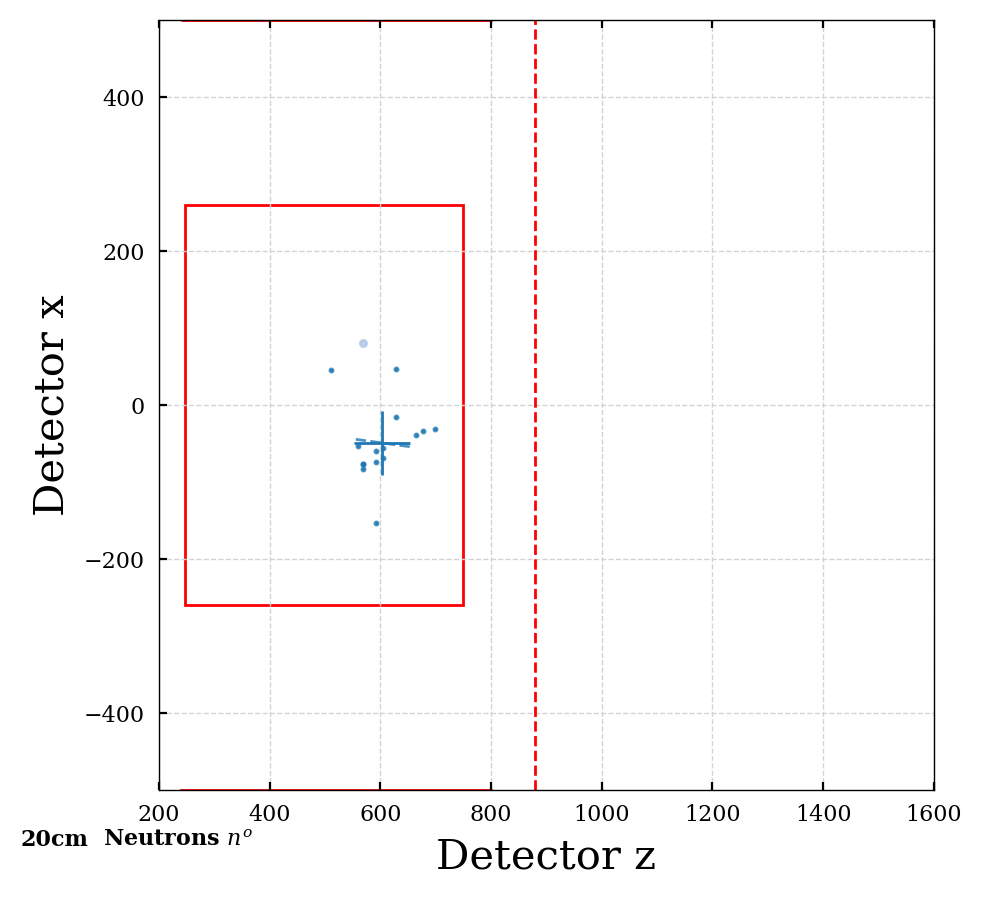

1
[26.6]


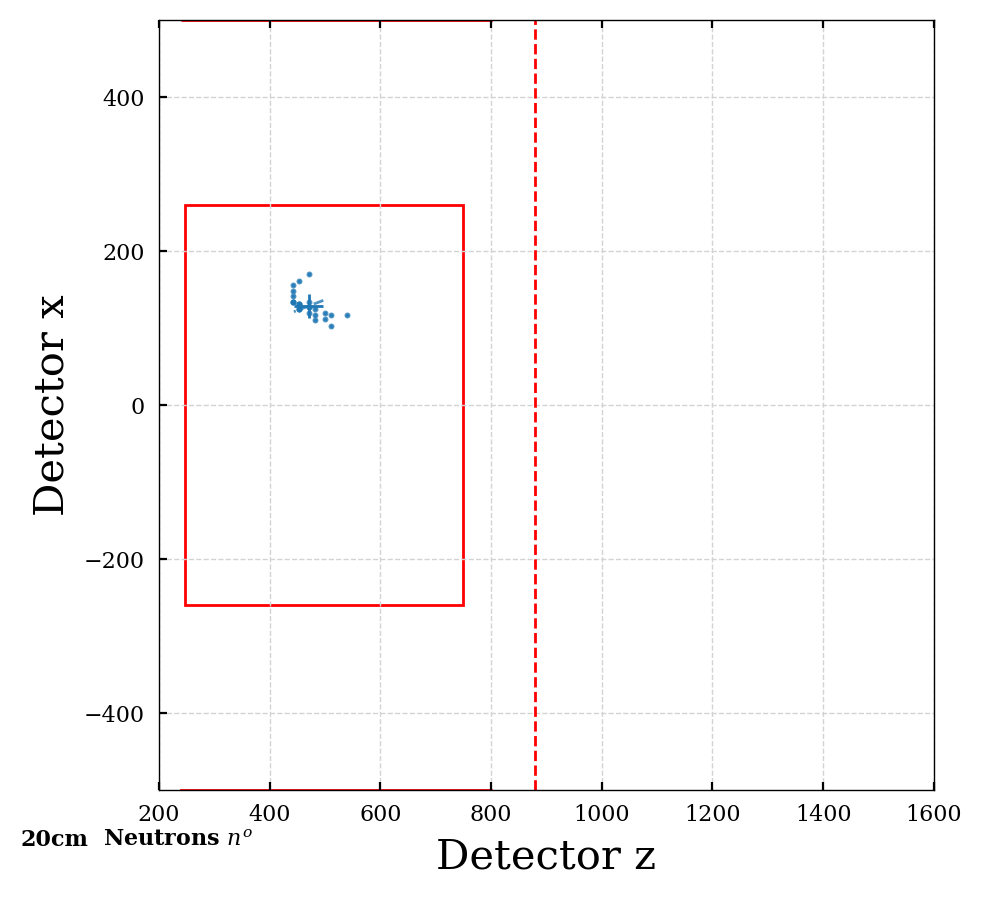

2
[53.4, 0.0988]


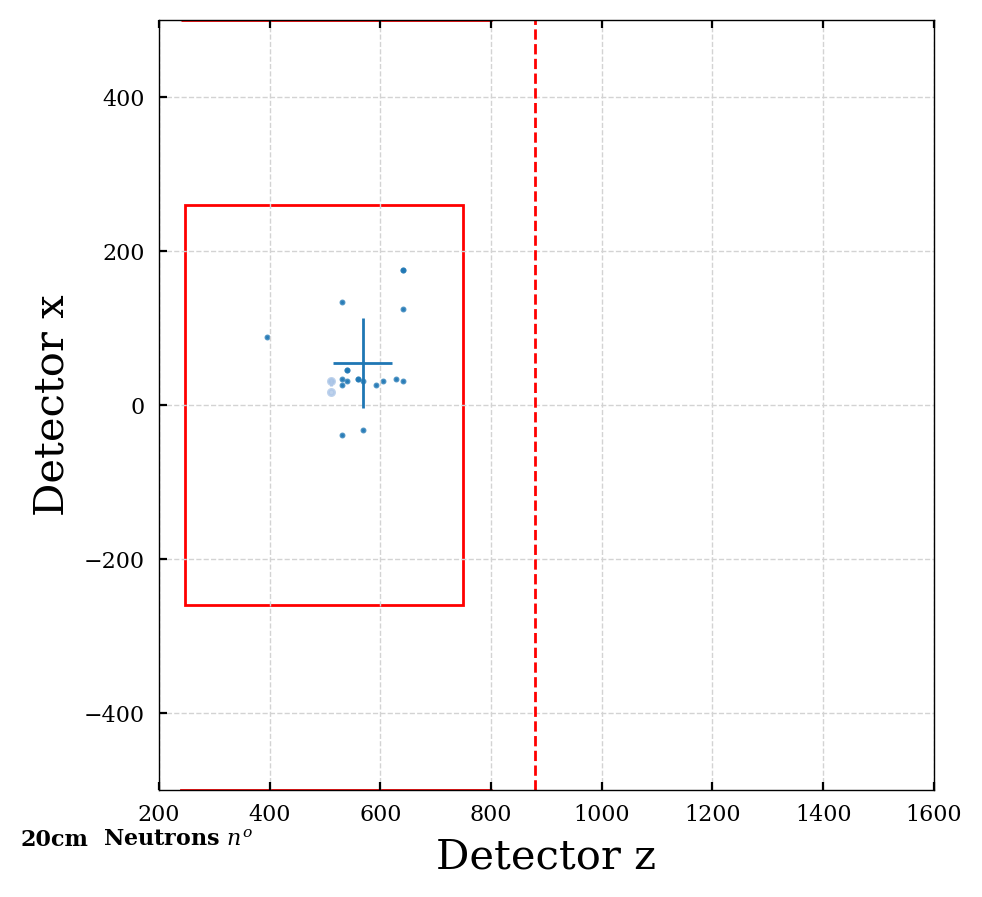

2
[87.3, 31.5]


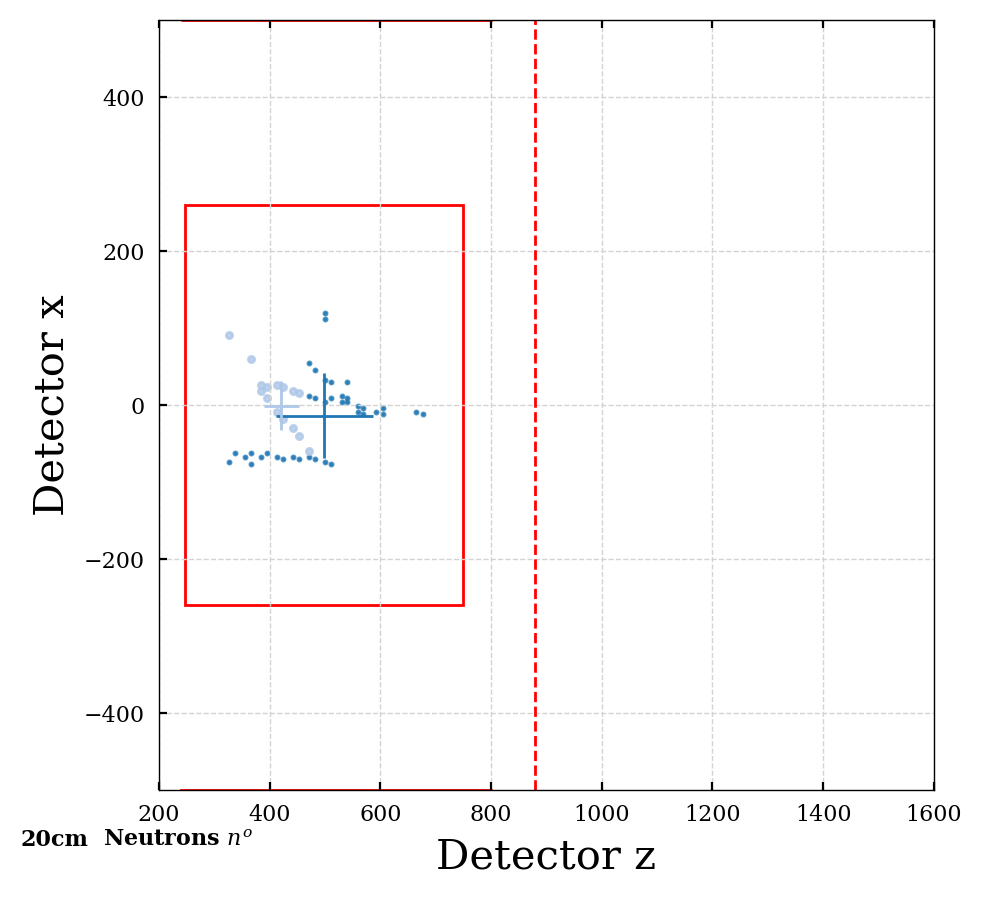

1
[133]


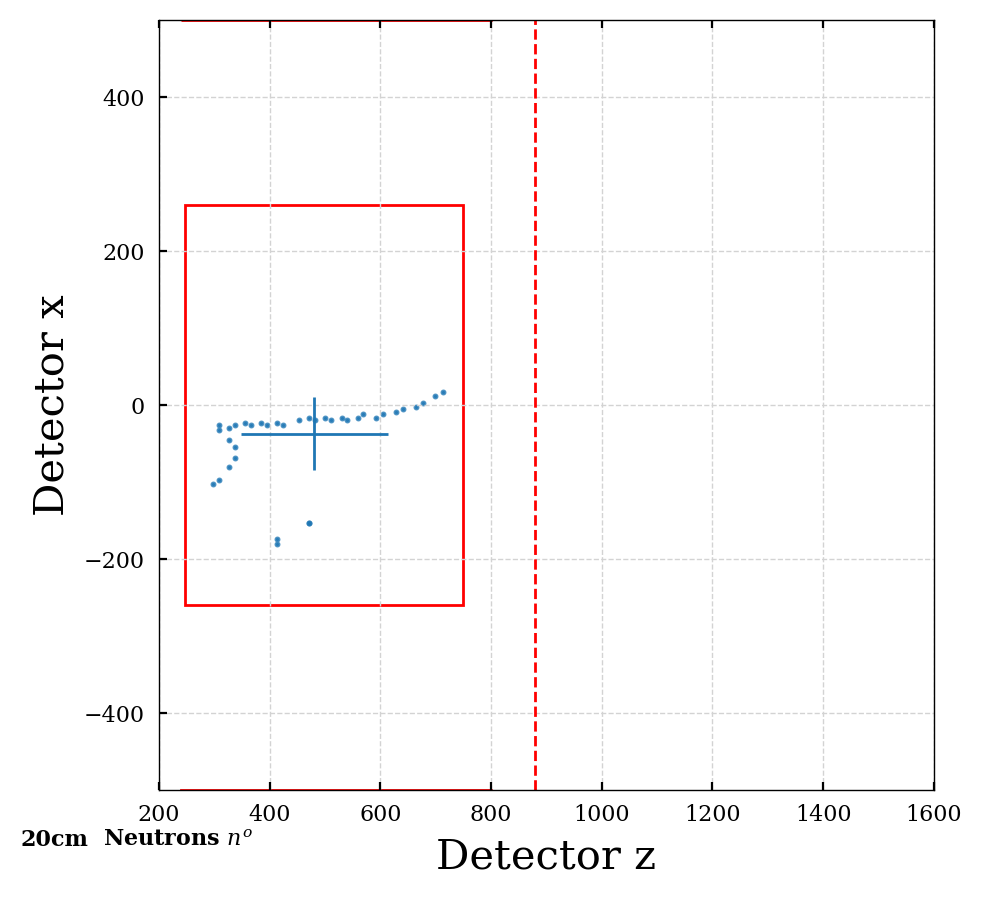

1
[80.8]


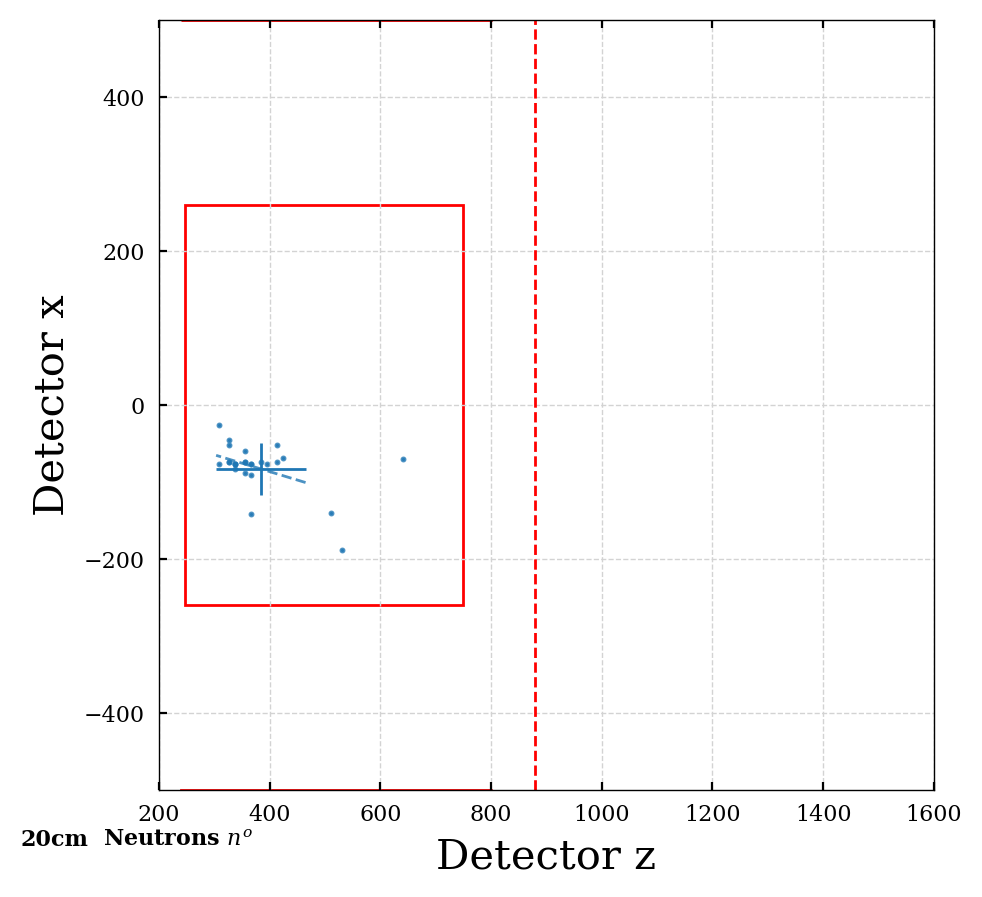

1
[4.65]


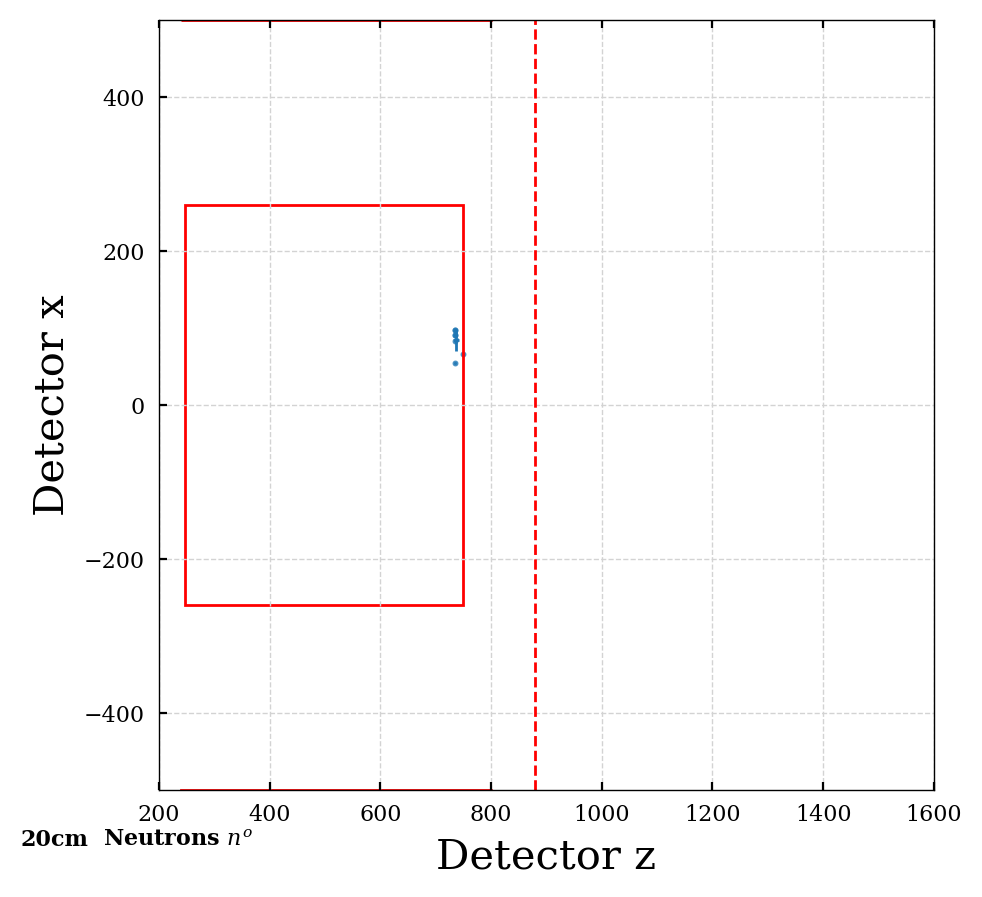

1
[86.5]


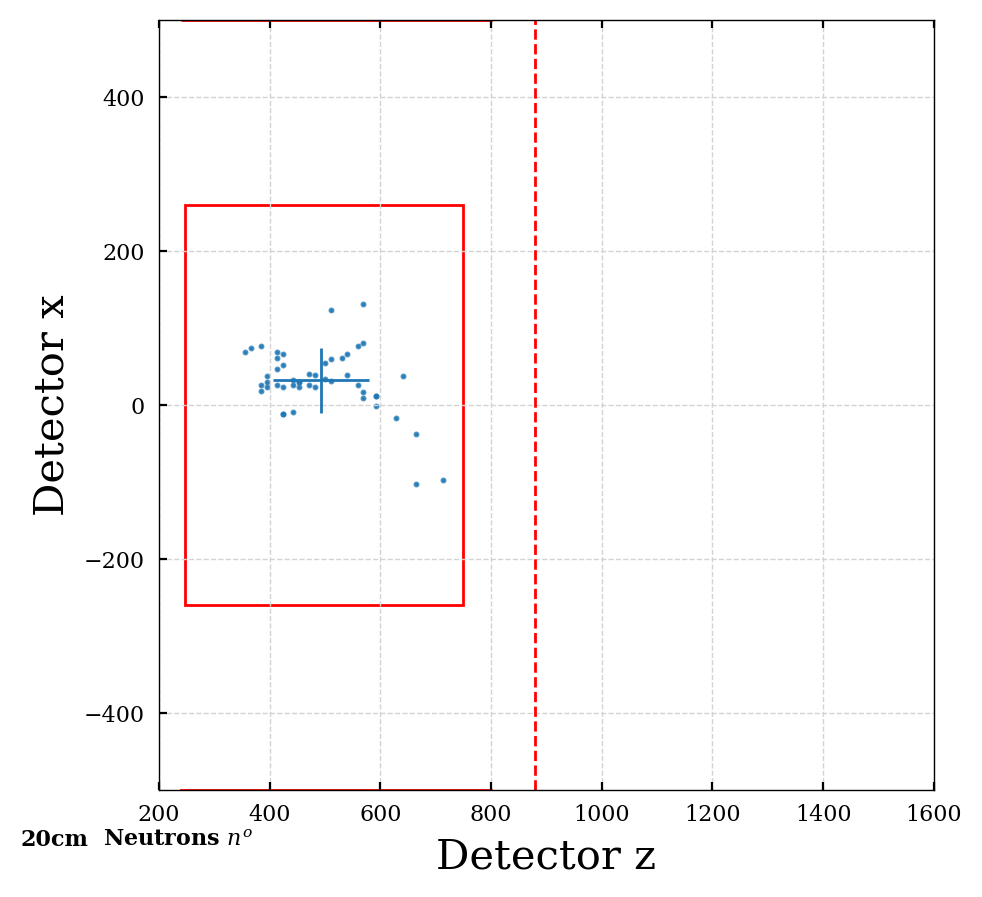

1
[54]


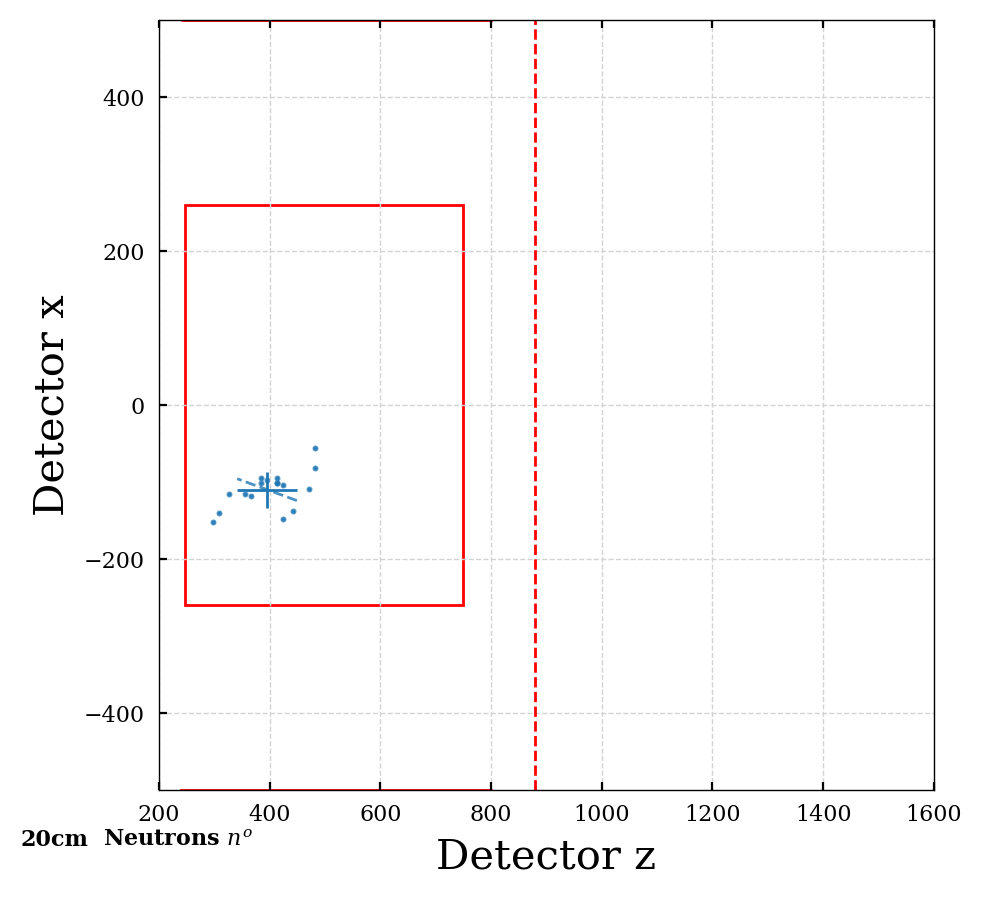

1
[47.5]


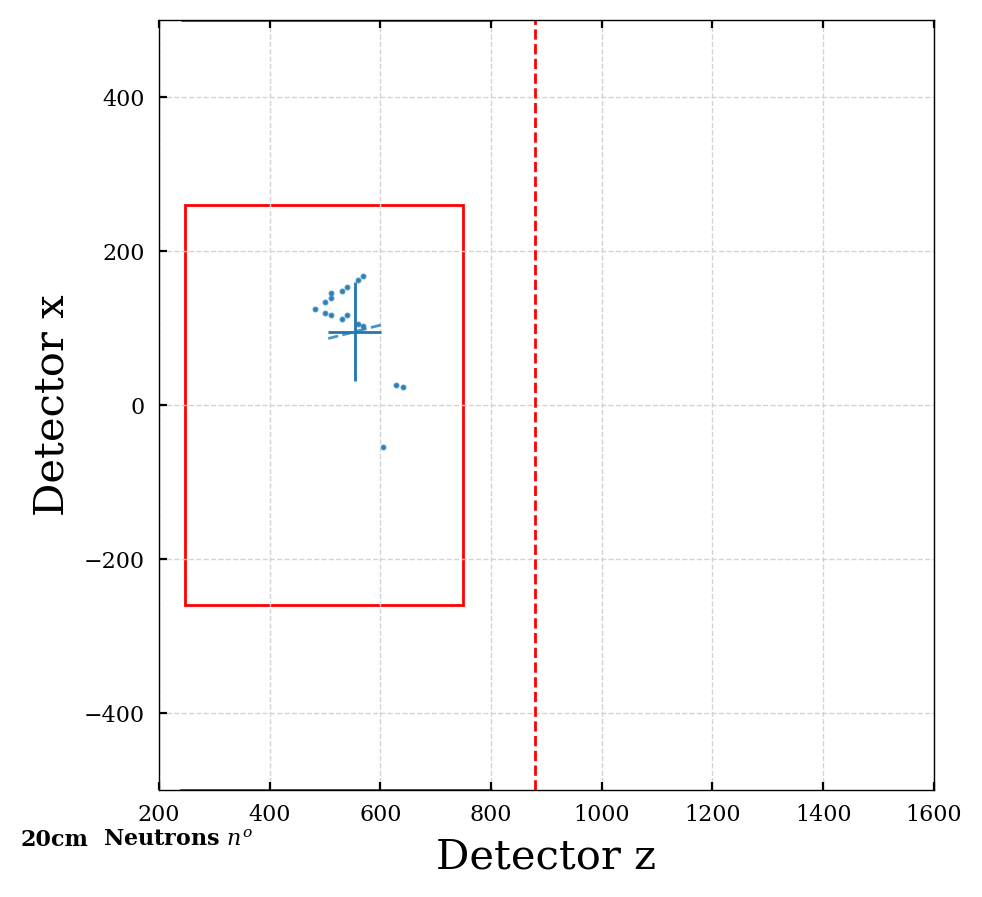

In [54]:
plot_cluster_dist(particles_dict_20cm, 20, spec_part='neutrons', ipart=None, xlim=3000, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_20cm, 20, spec_part='neutrons', ipart=ipart, xlim=1600, ylim=500, angle_label=False)

### Protons

2
[107, 96.3]


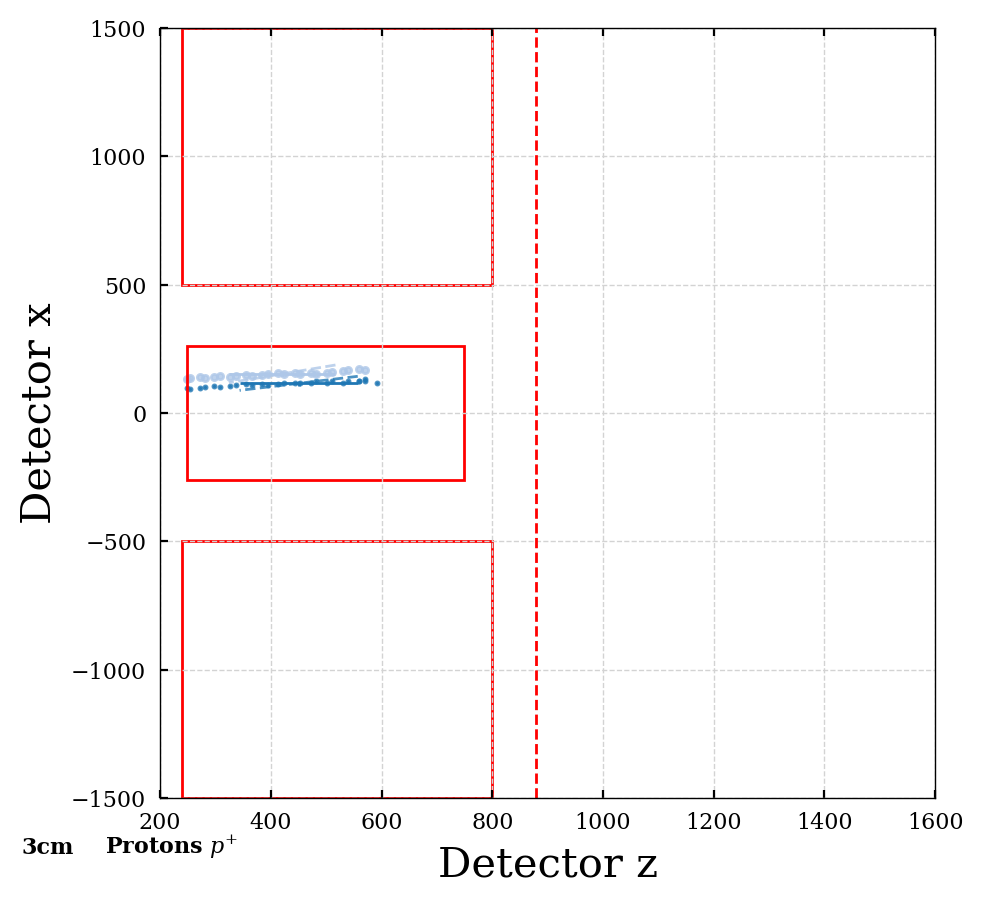

1
[98.6]


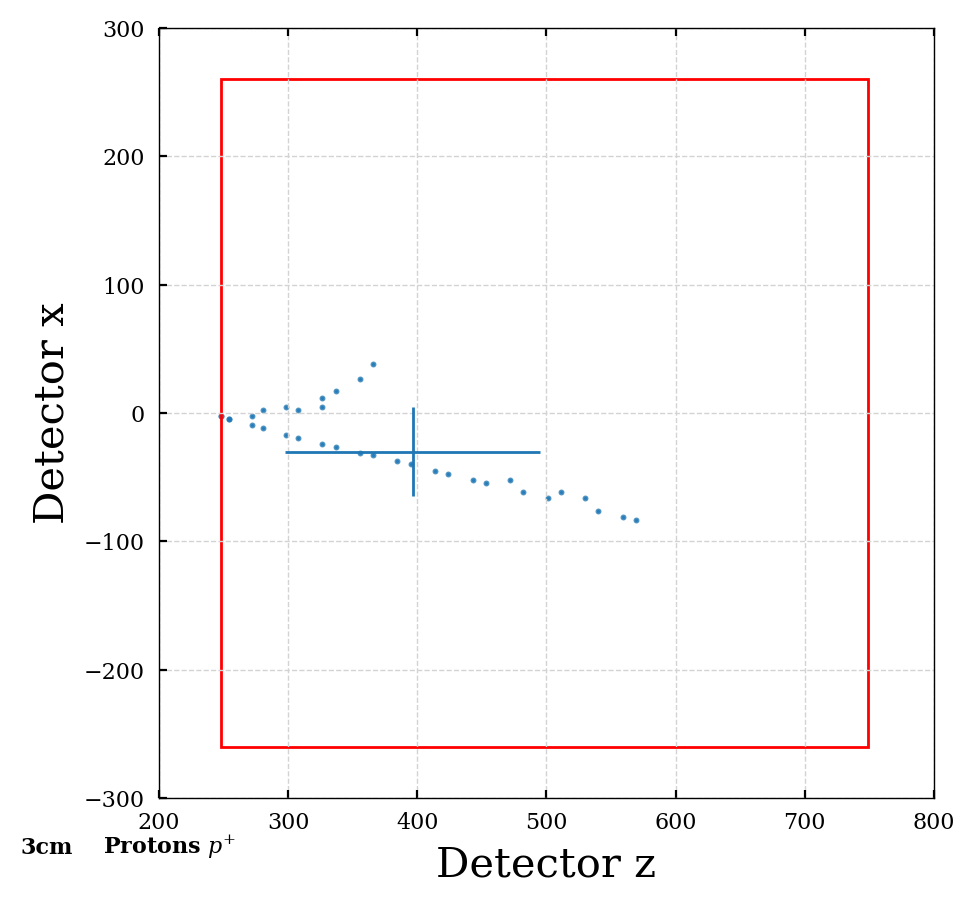

0
[70.9, 54.8, 0.0373]


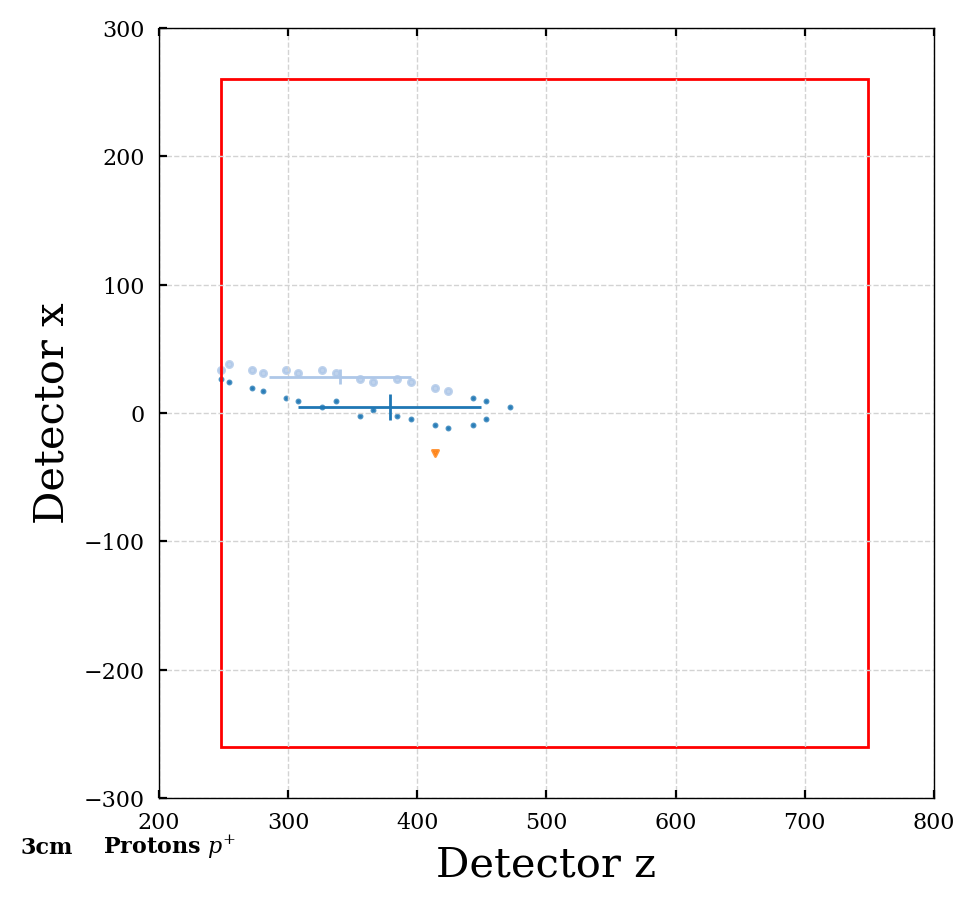

0
[28.5, 41.5]


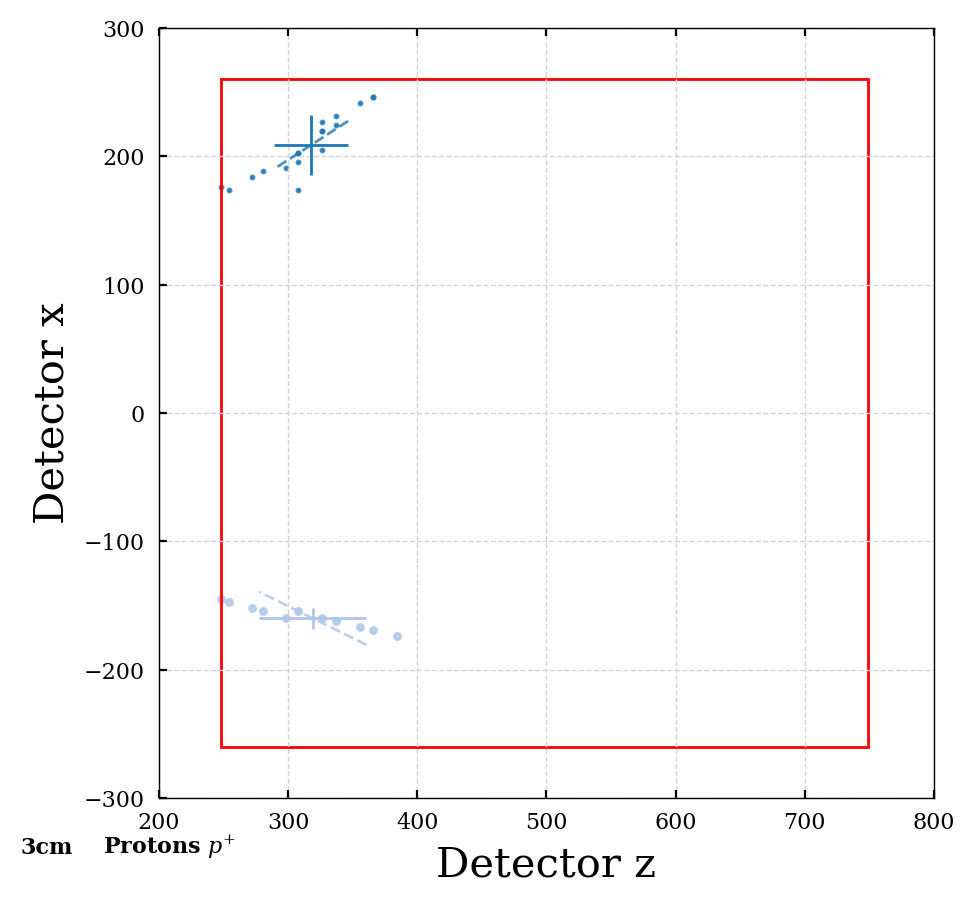

0
[25.8, 26.1]


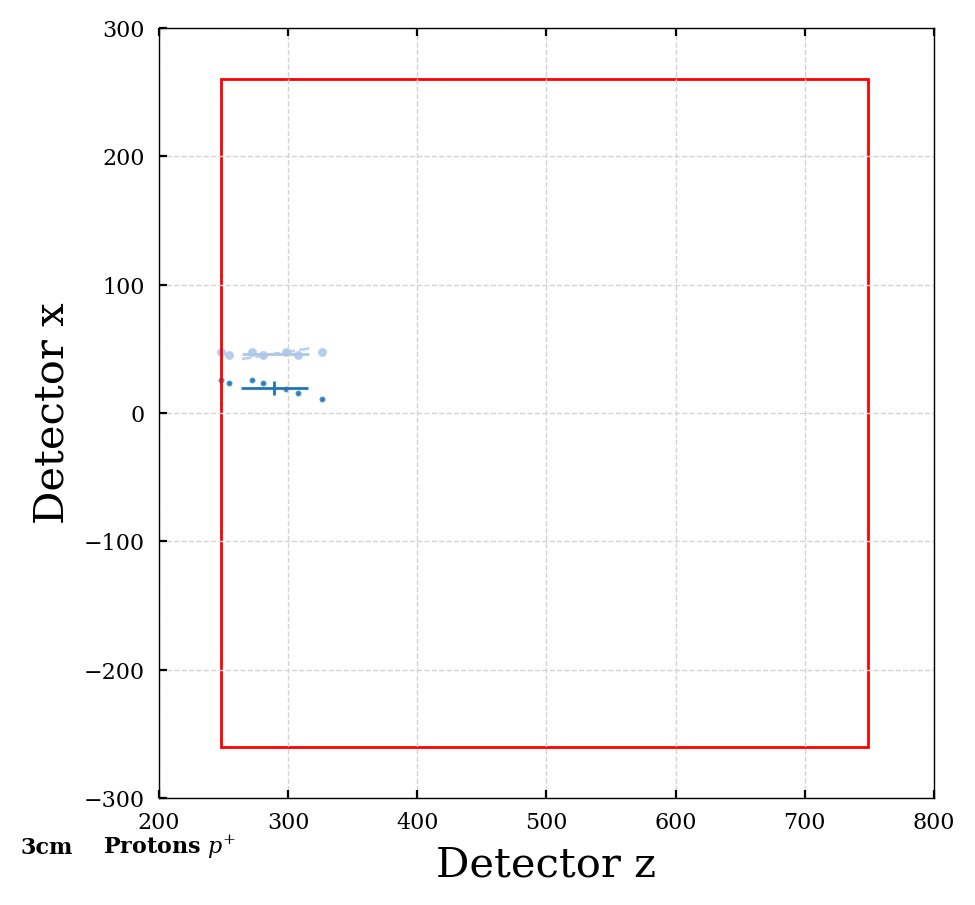

0
[47.2, 59.7]


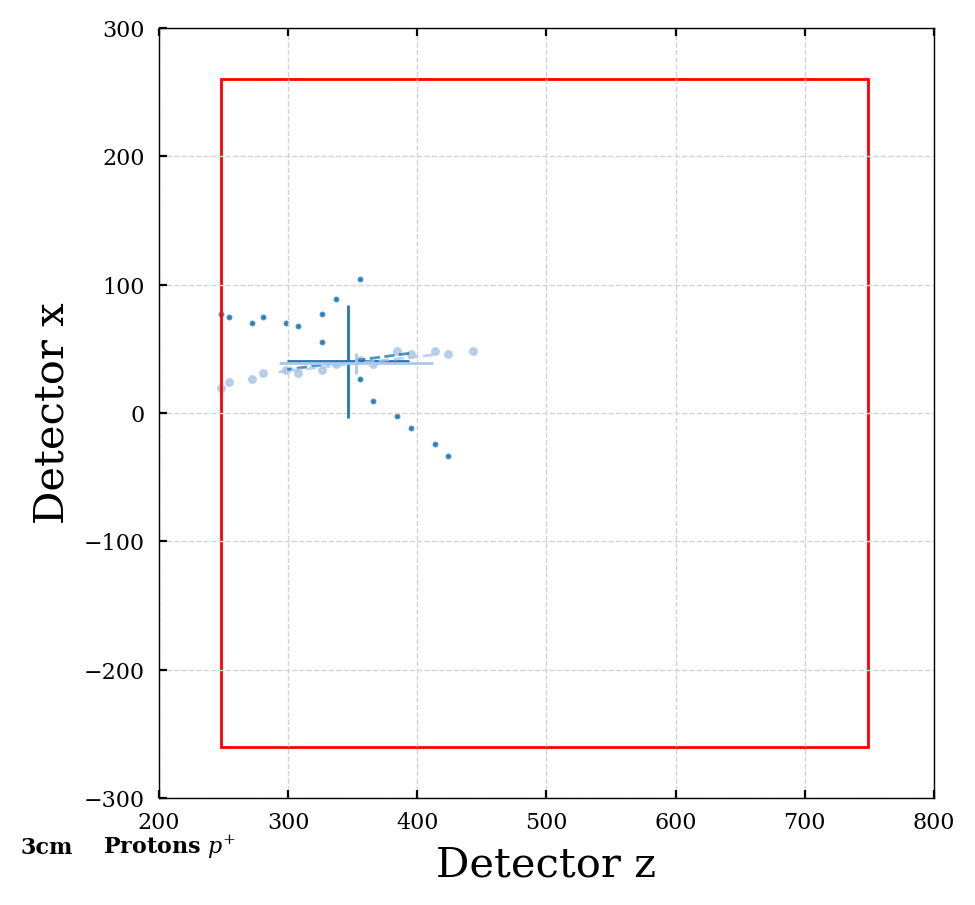

0
[34.5, 44]


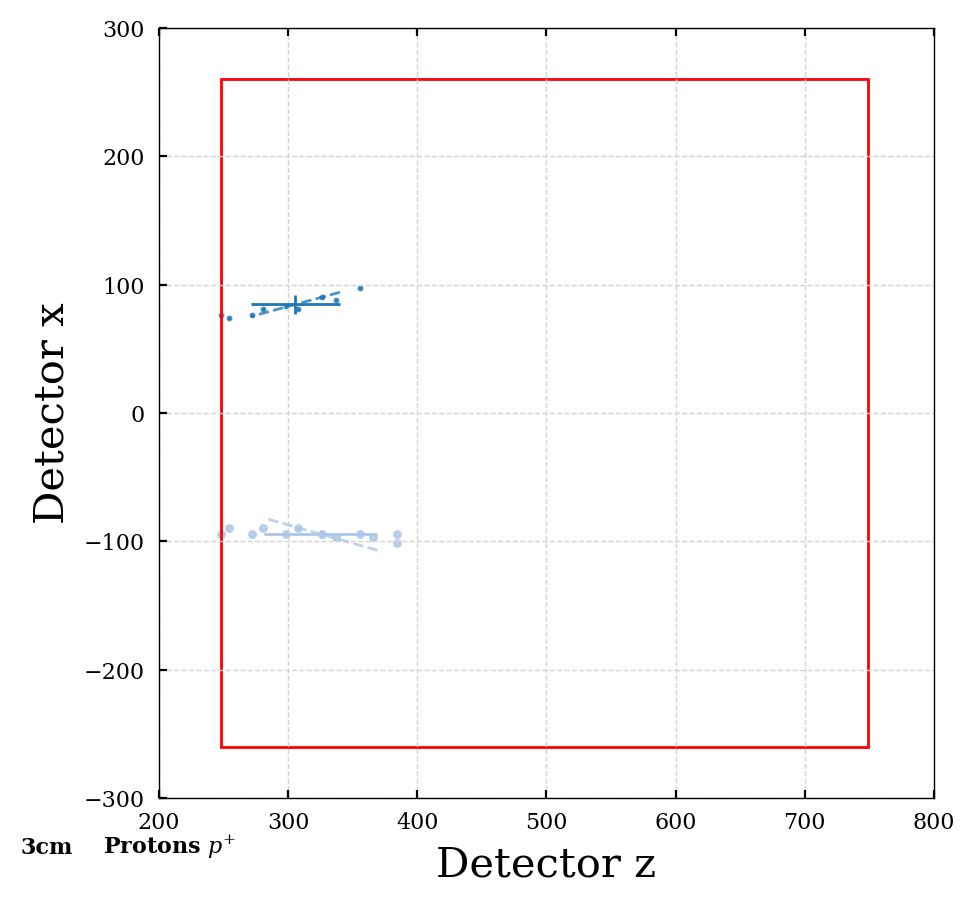

1
[109, 13]


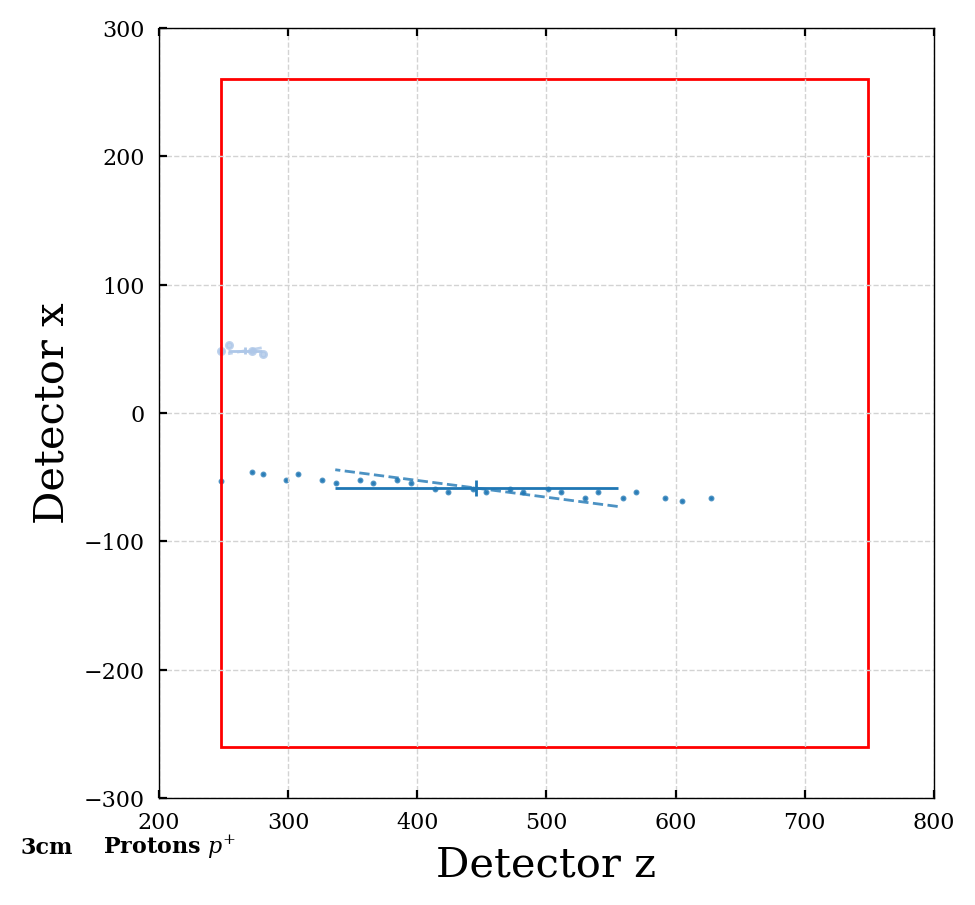

0
[83.2, 17.9, 22]


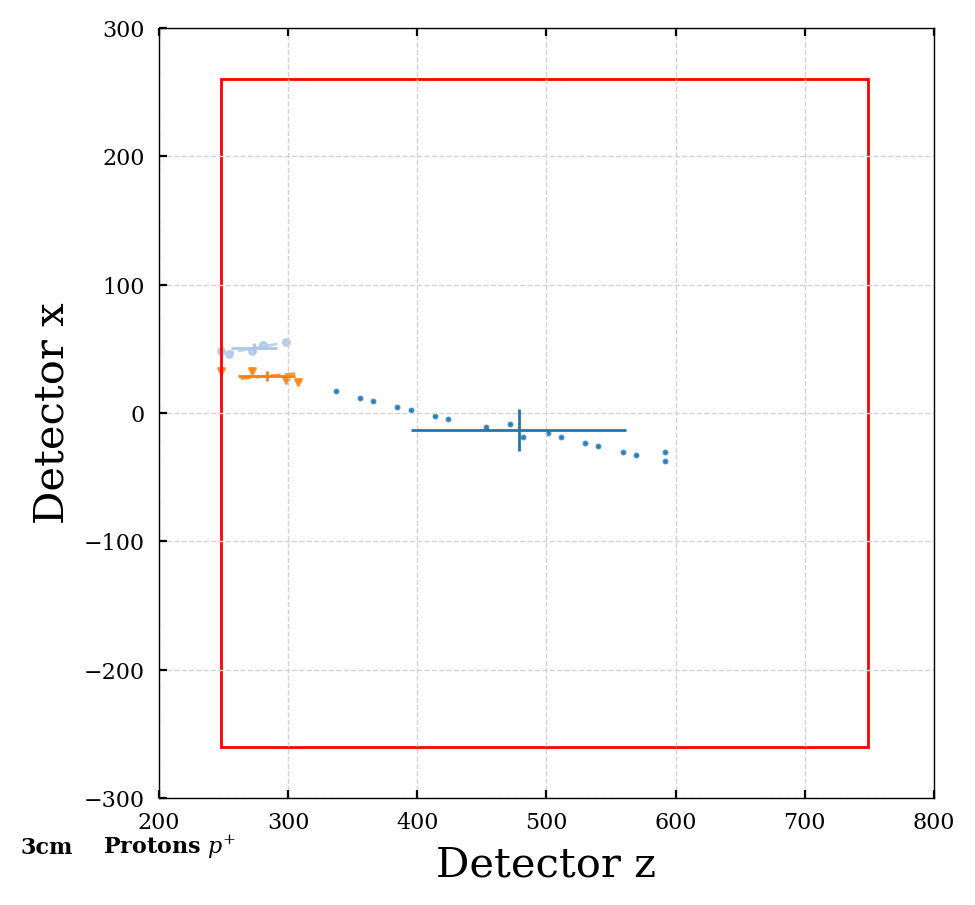

0
[76.5, 76.7, 8.48]


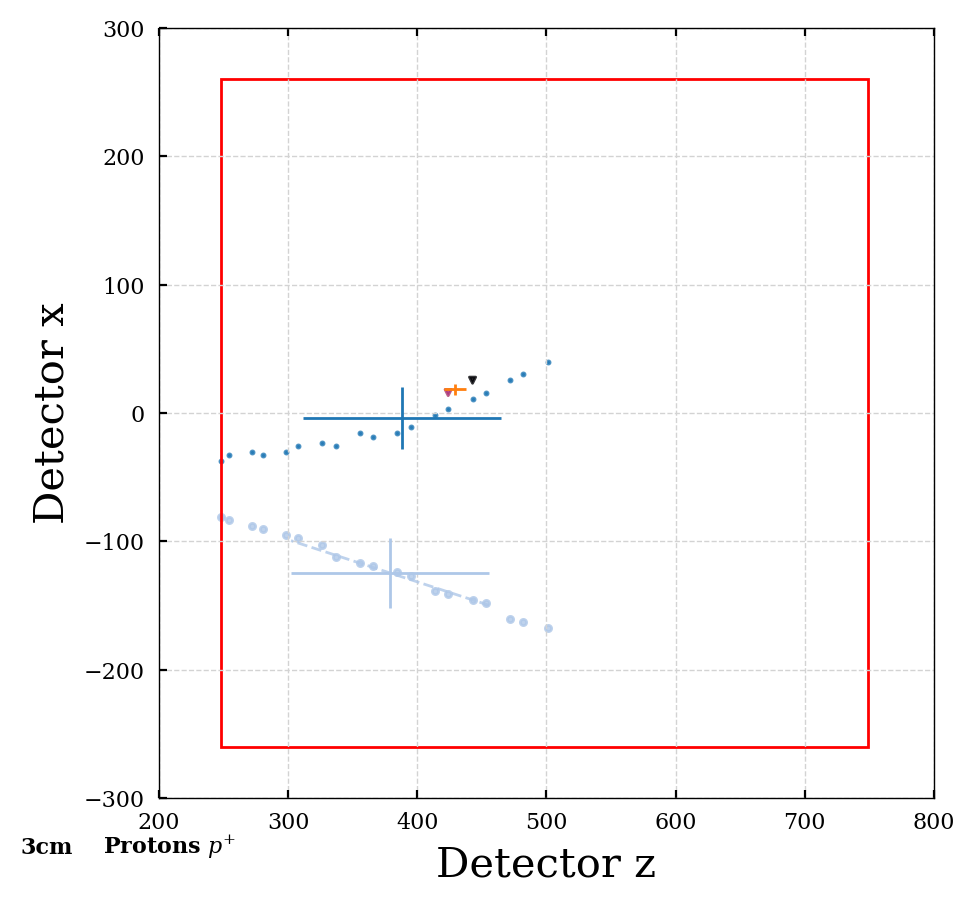

0
[18.5, 62.1, 20.6]


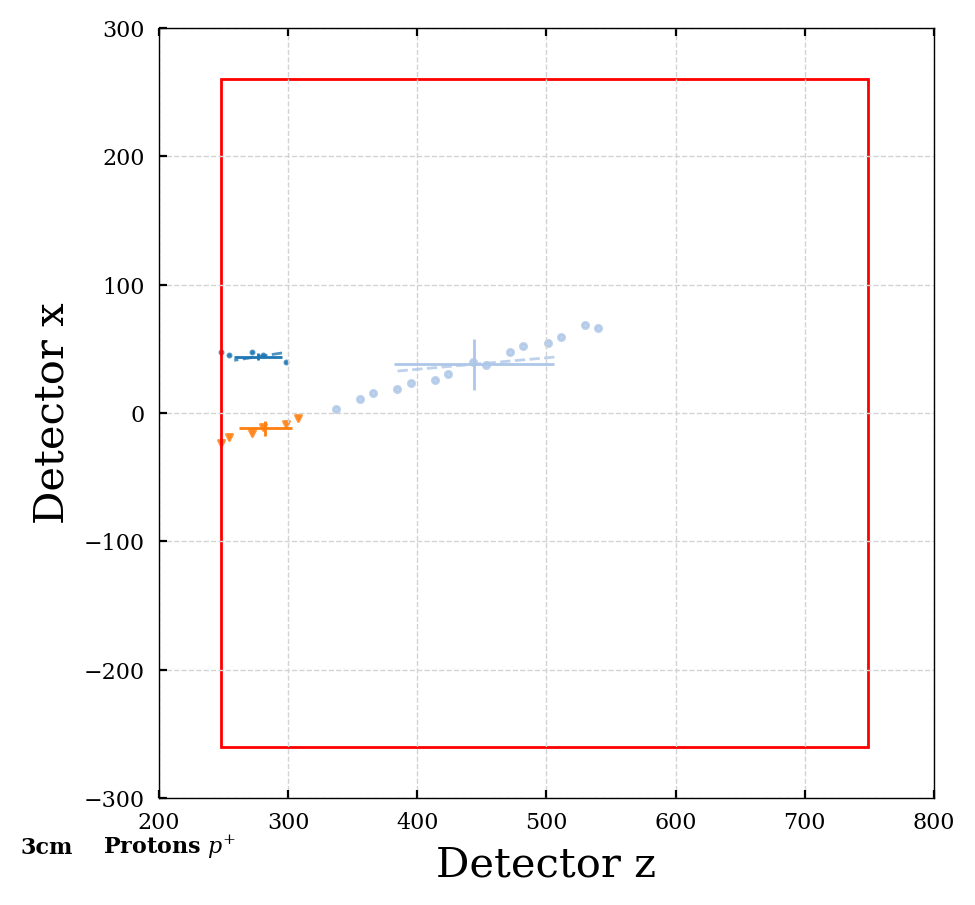

In [55]:
plot_cluster_dist(particles_dict_3cm, 3, spec_part='protons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_3cm, 3, spec_part='protons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[106, 65.6]


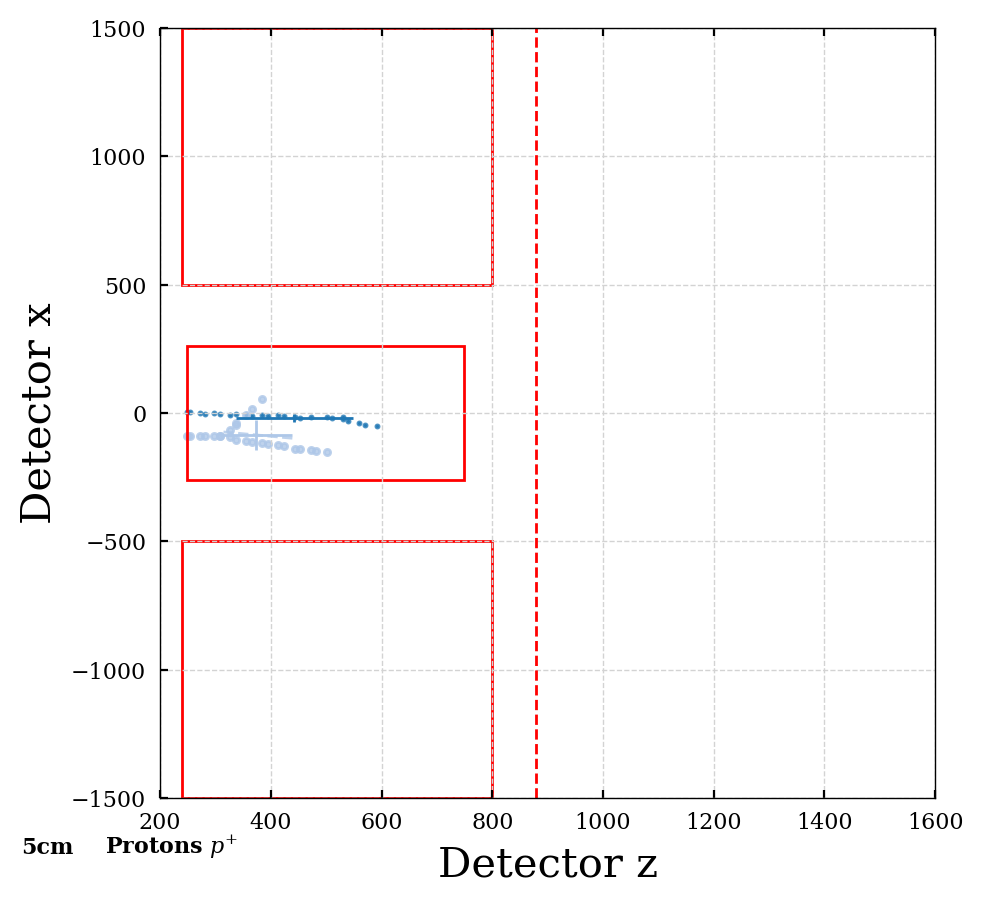

1
[136, 12.9]


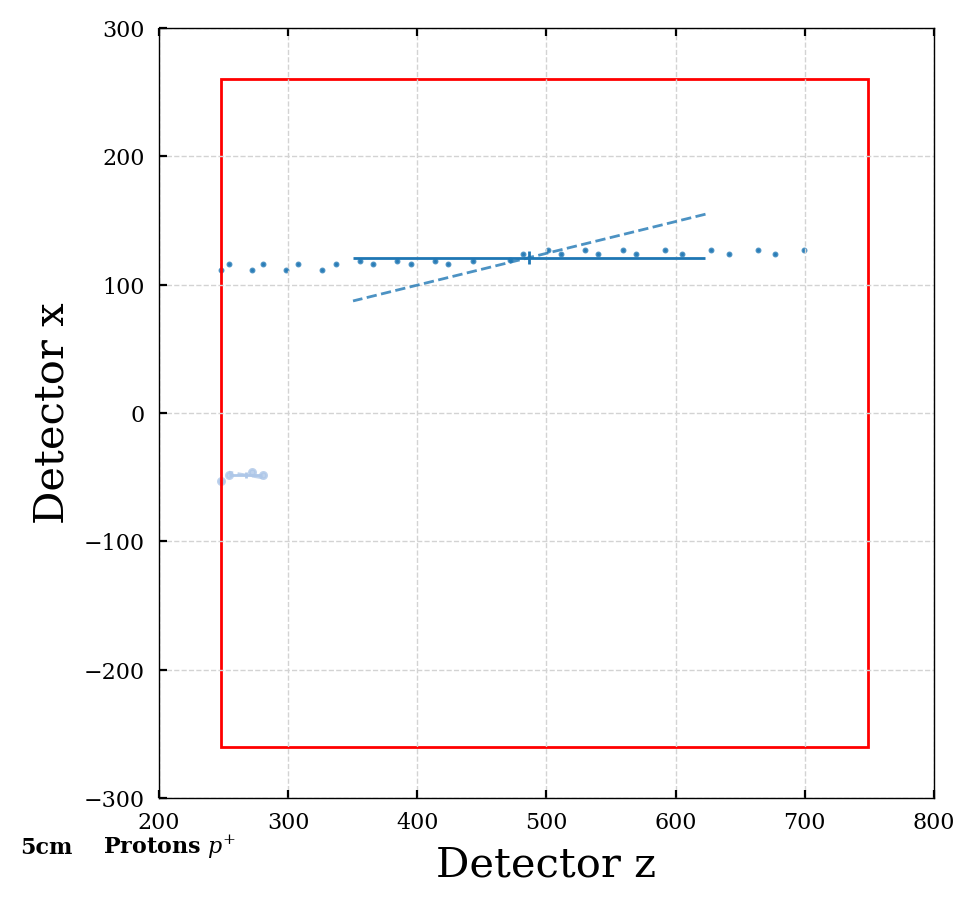

0
[64, 46.2]


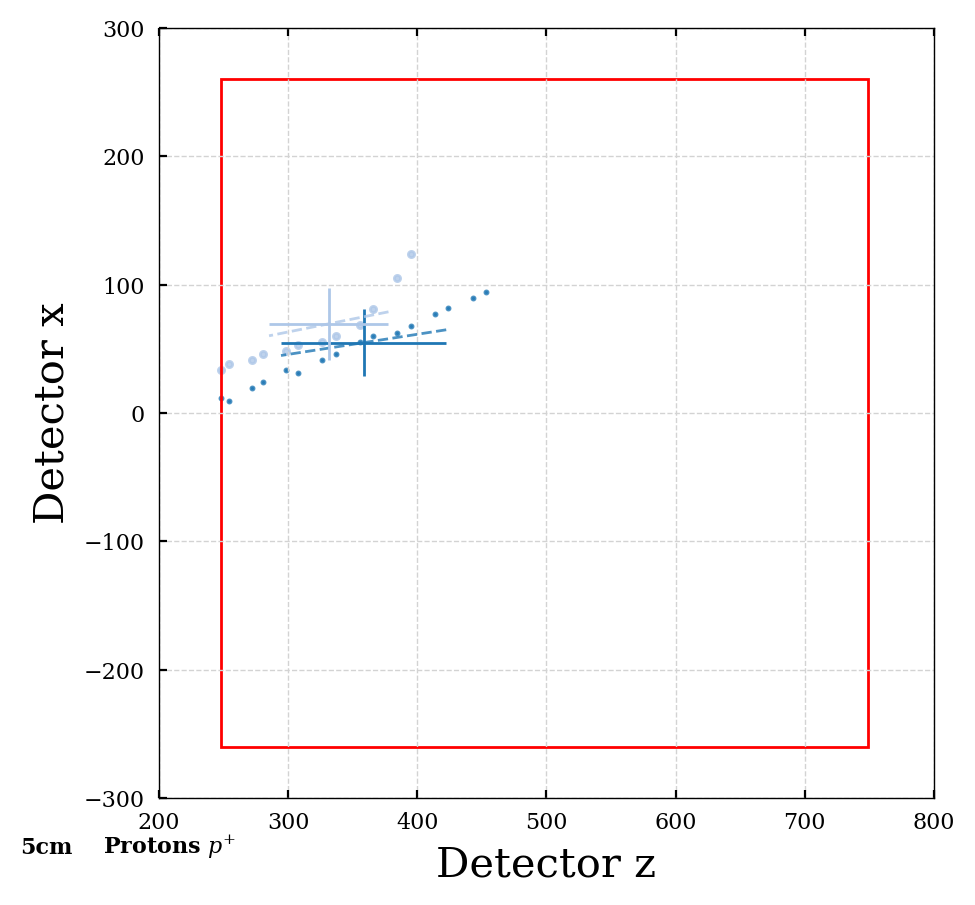

0
[50.7, 26.2]


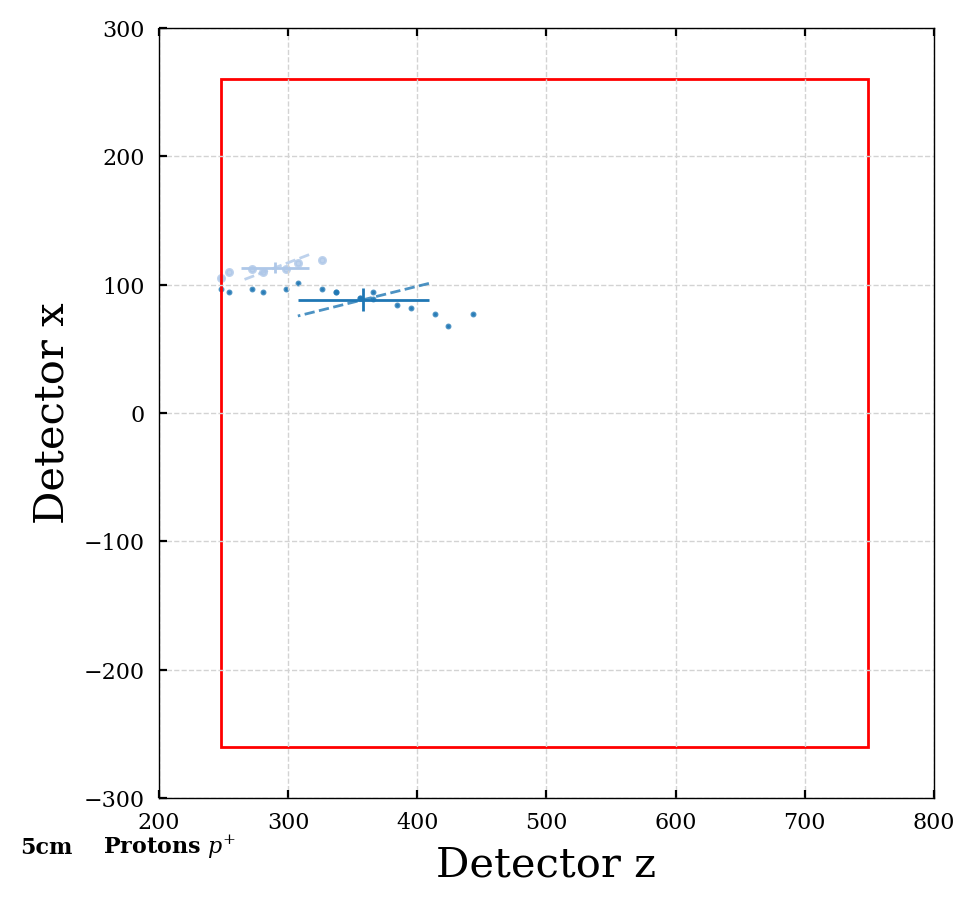

2
[147, 89.9]


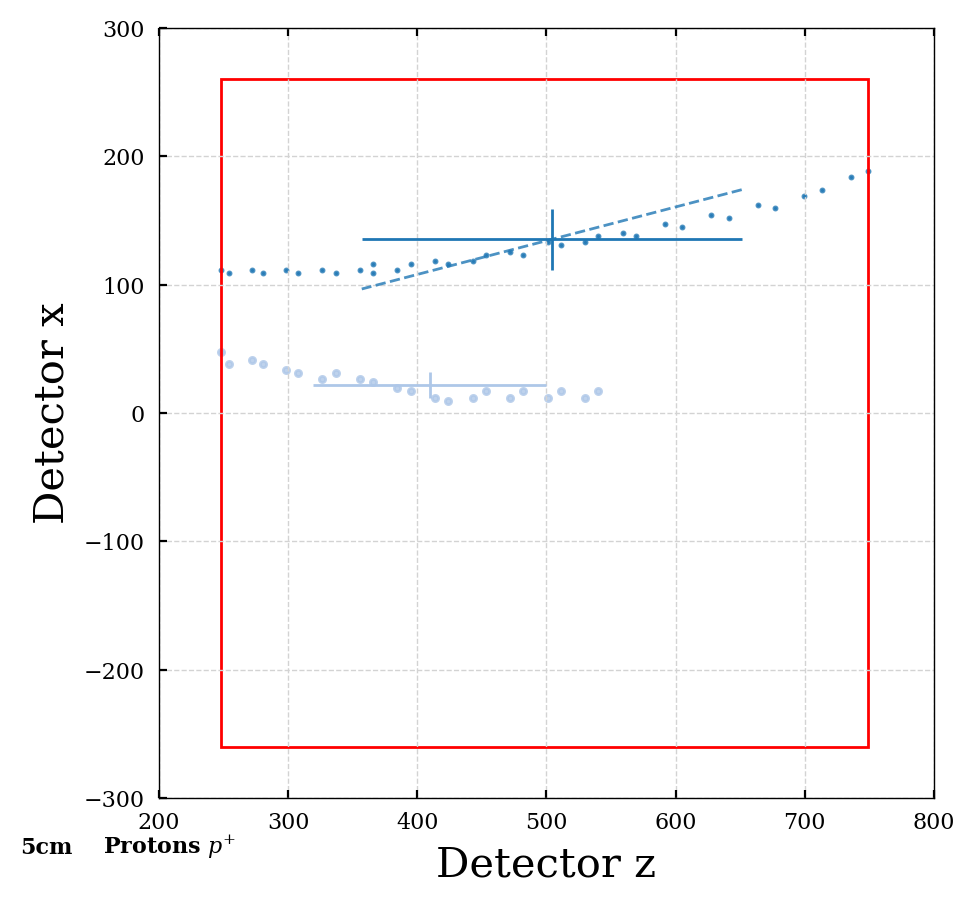

1
[72.9, 92.7]


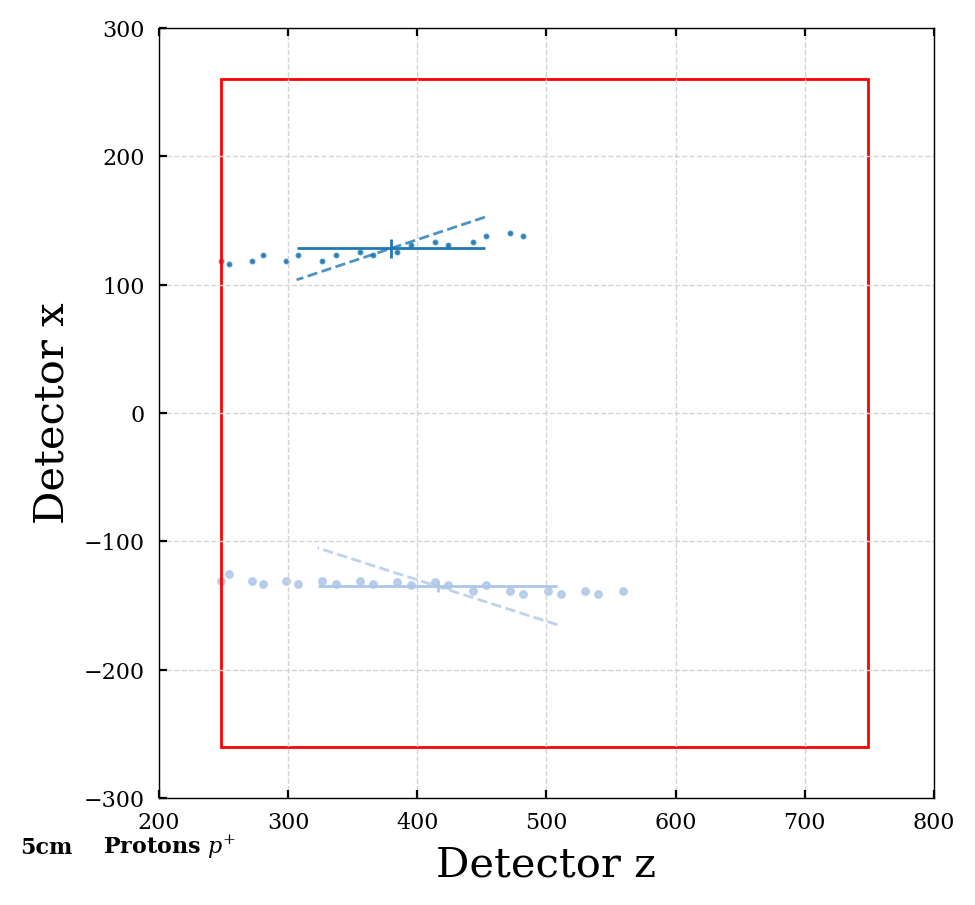

0
[72.1, 34.9]


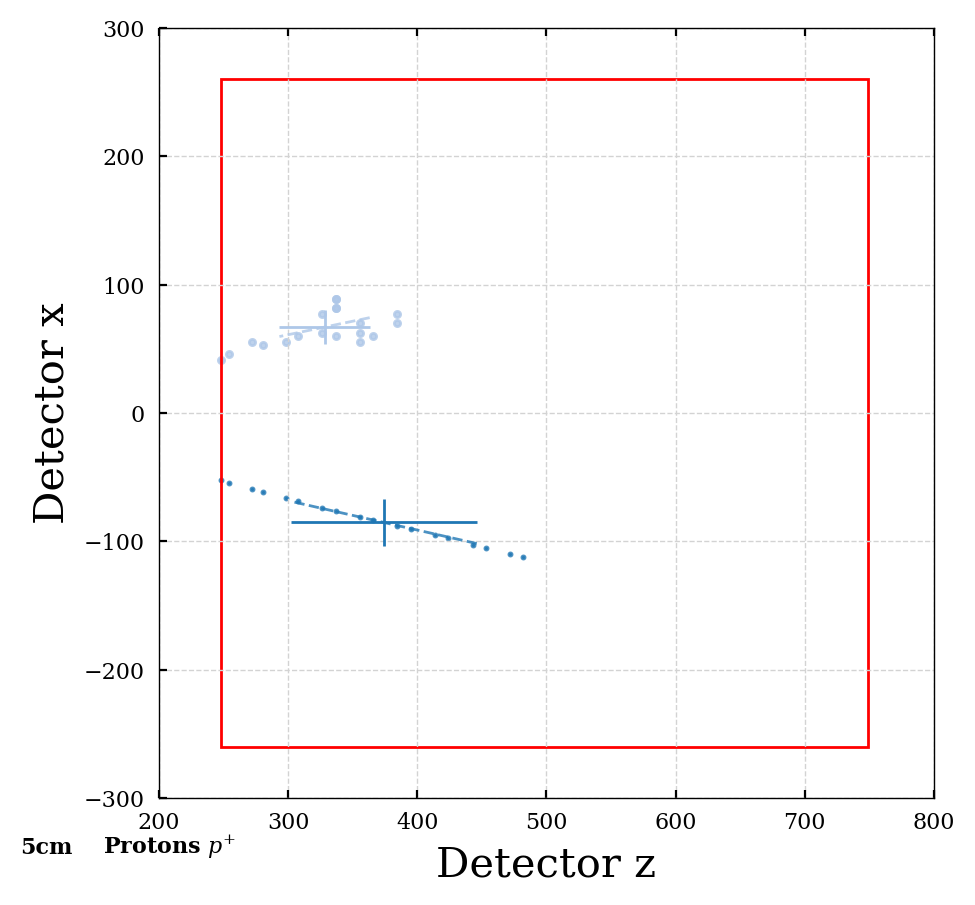

1
[133, 20.6]


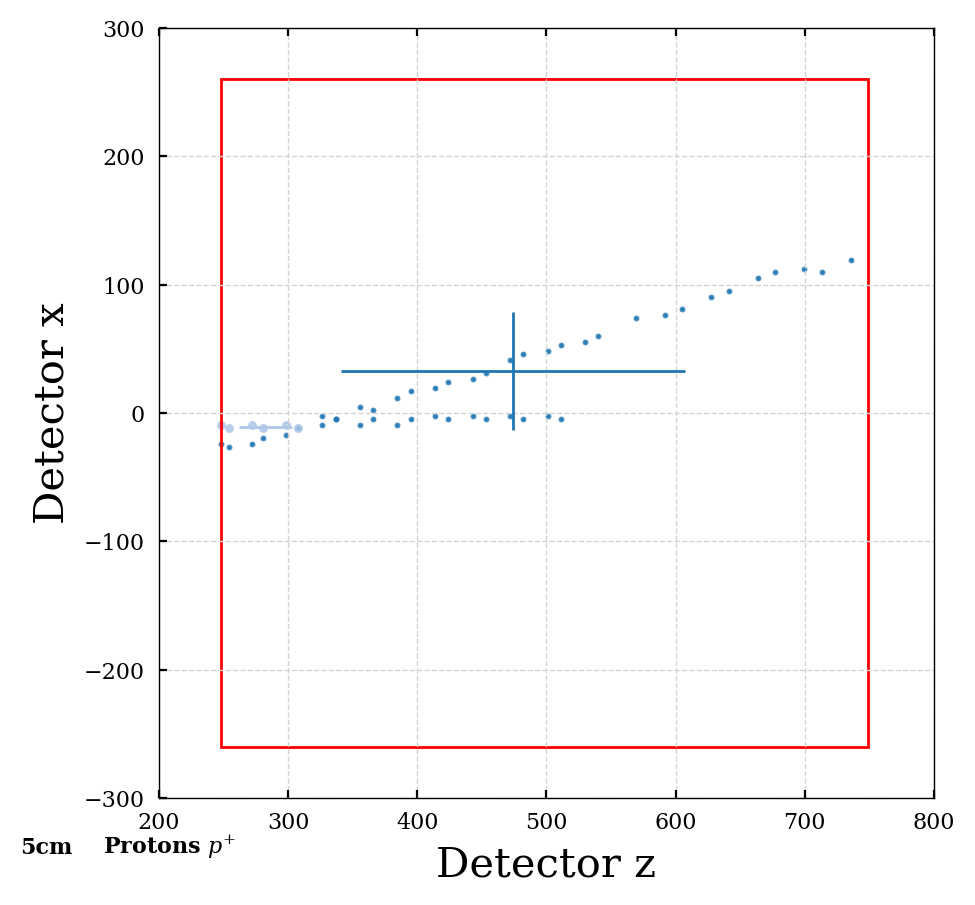

0
[34.7, 73.8]


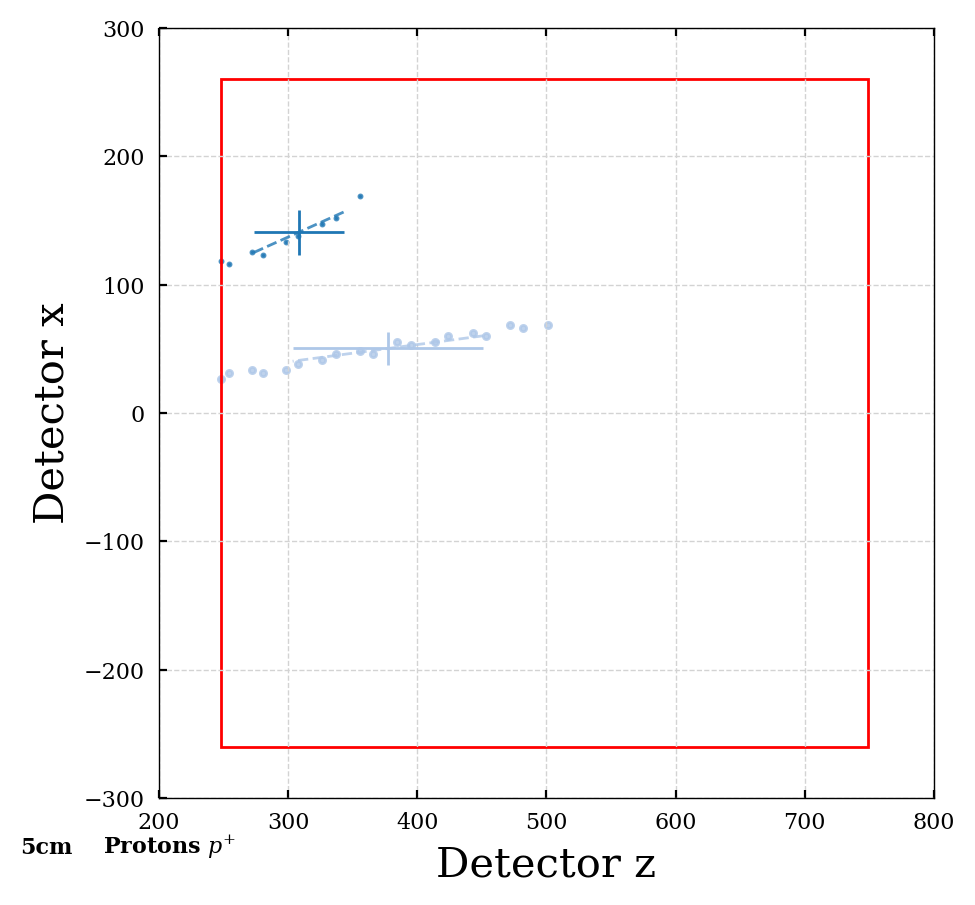

0
[67.8, 78.1, 5.08]


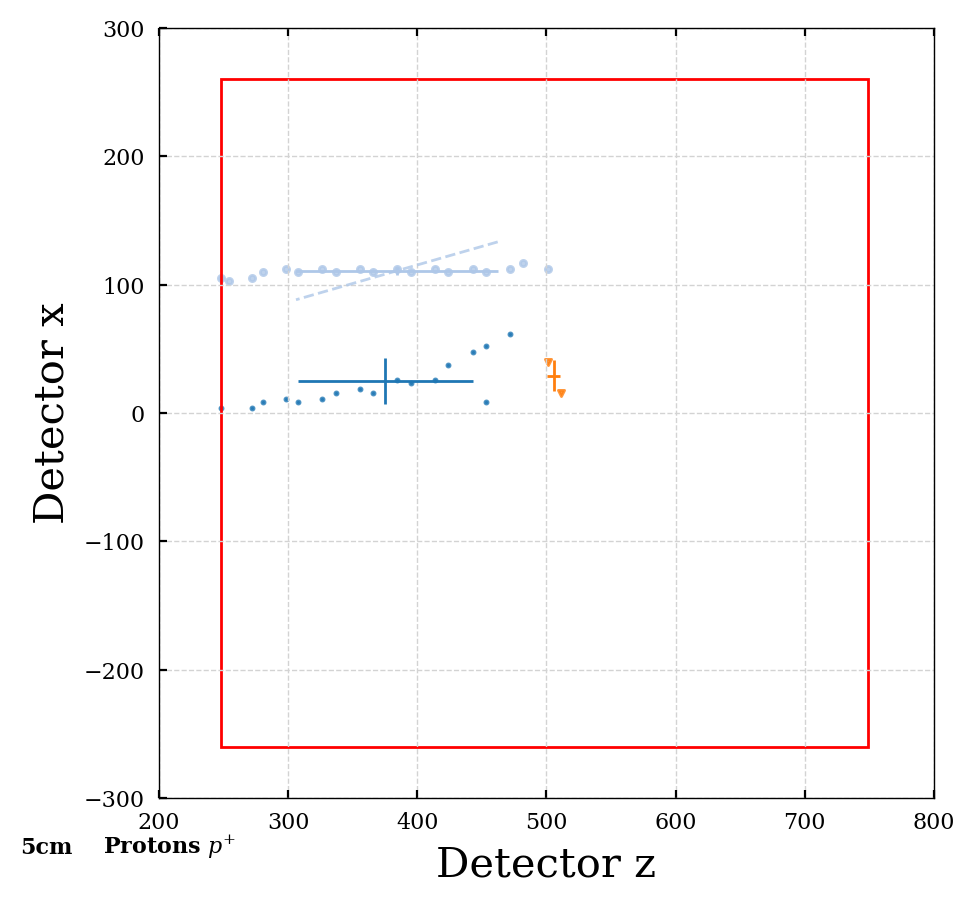

1
[80.8, 15.9]


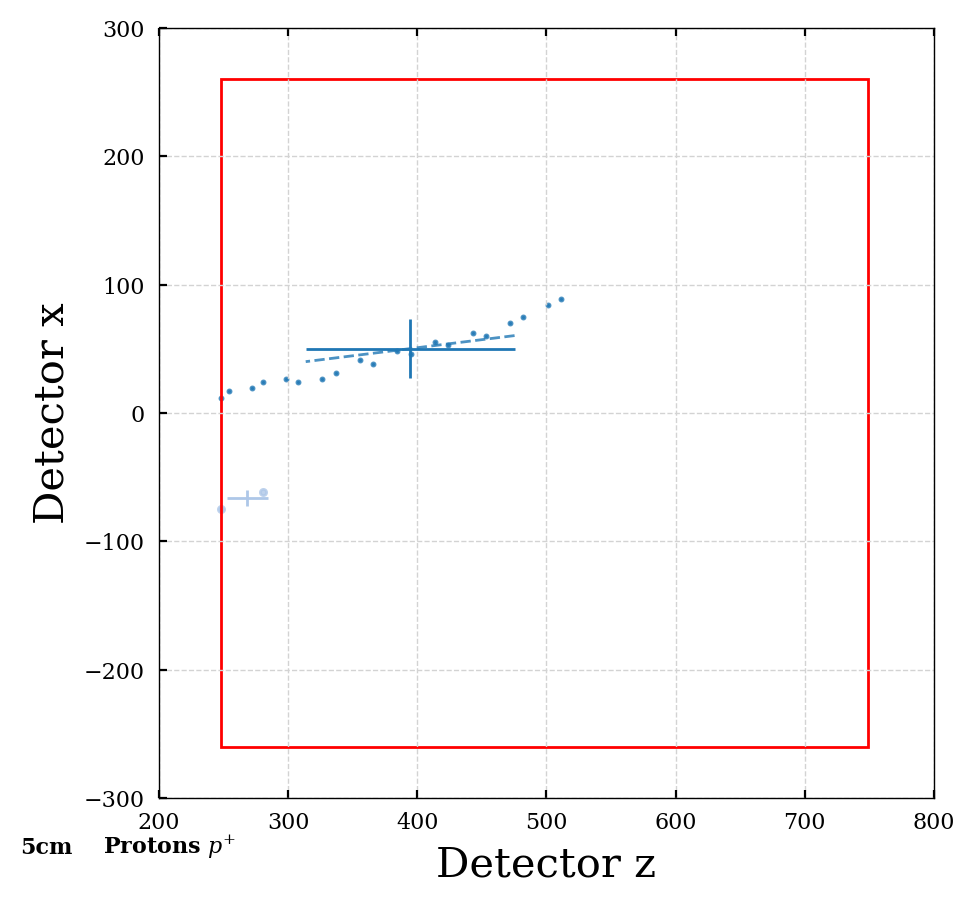

In [56]:
plot_cluster_dist(particles_dict_5cm, 5, spec_part='protons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_5cm, 5, spec_part='protons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

2
[64.4, 68.5]


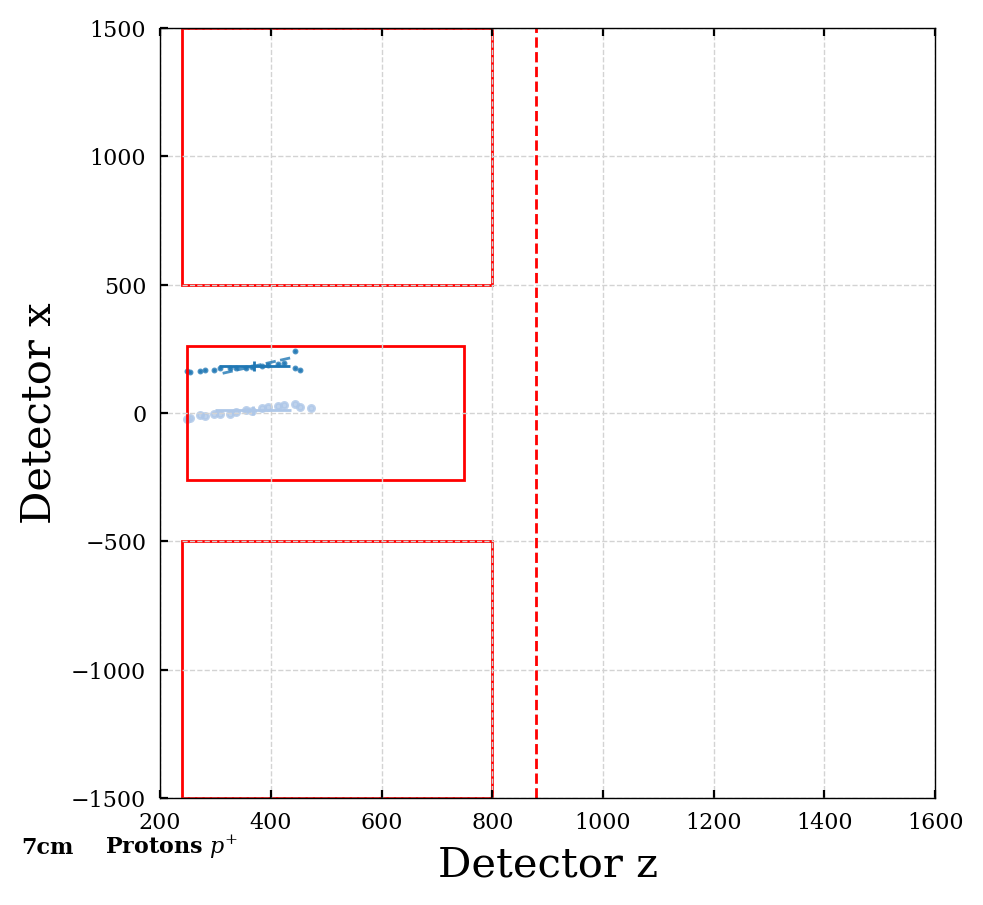

1
[64.4, 25.7]


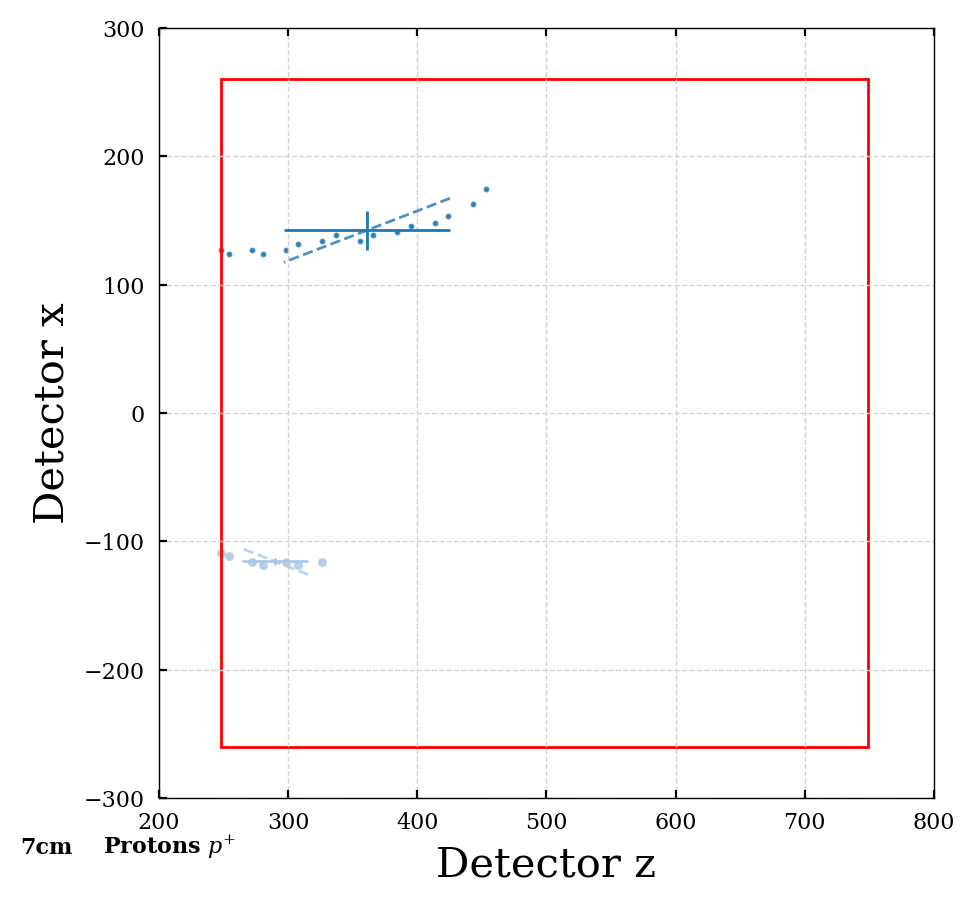

1
[129, 18]


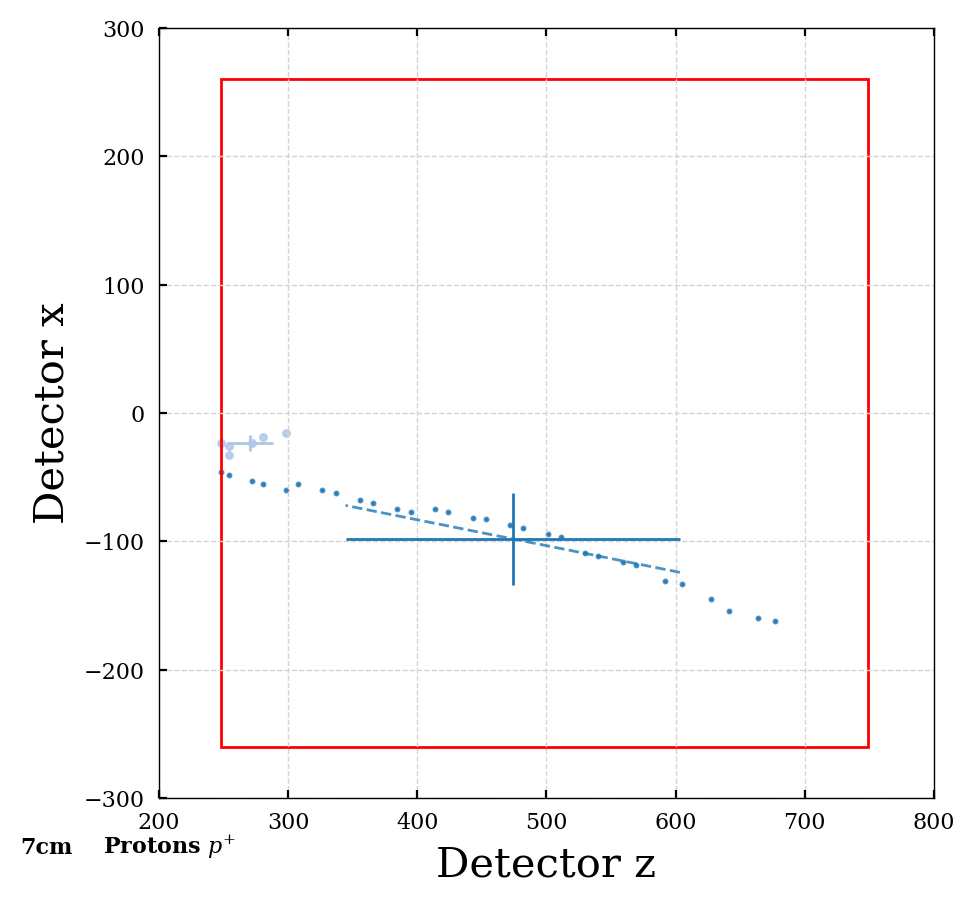

0
[27.4, 26.2]


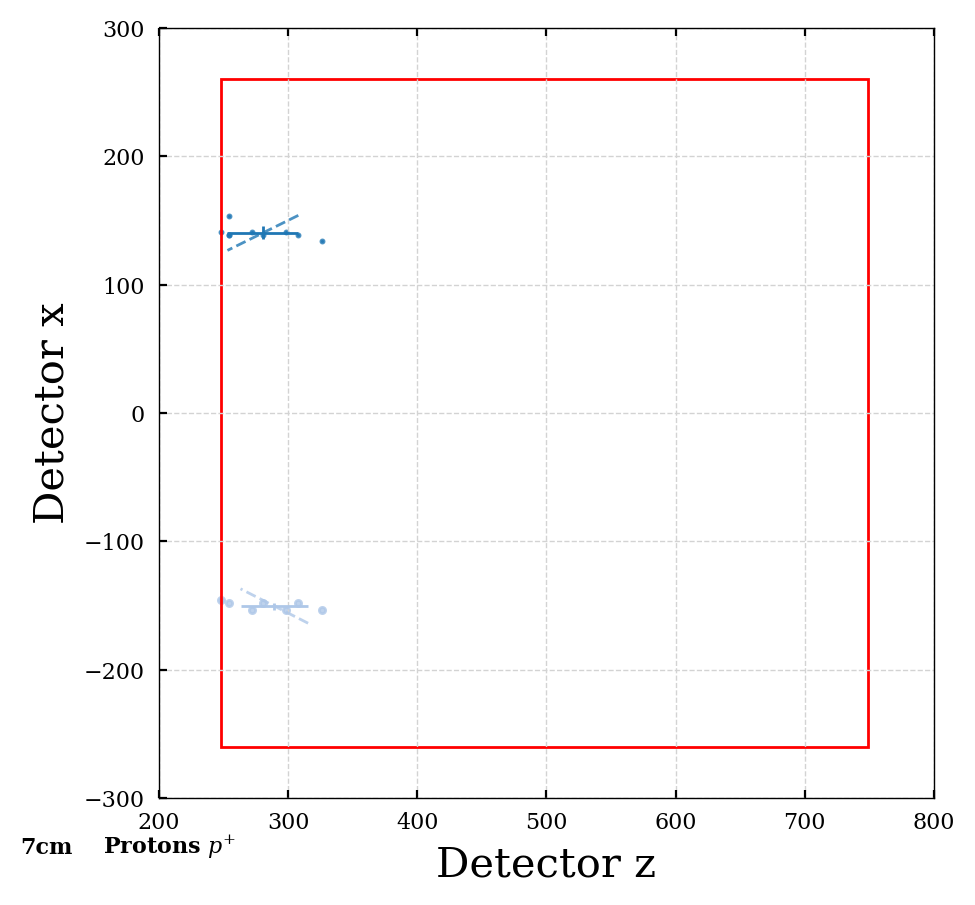

0
[46, 26.6]


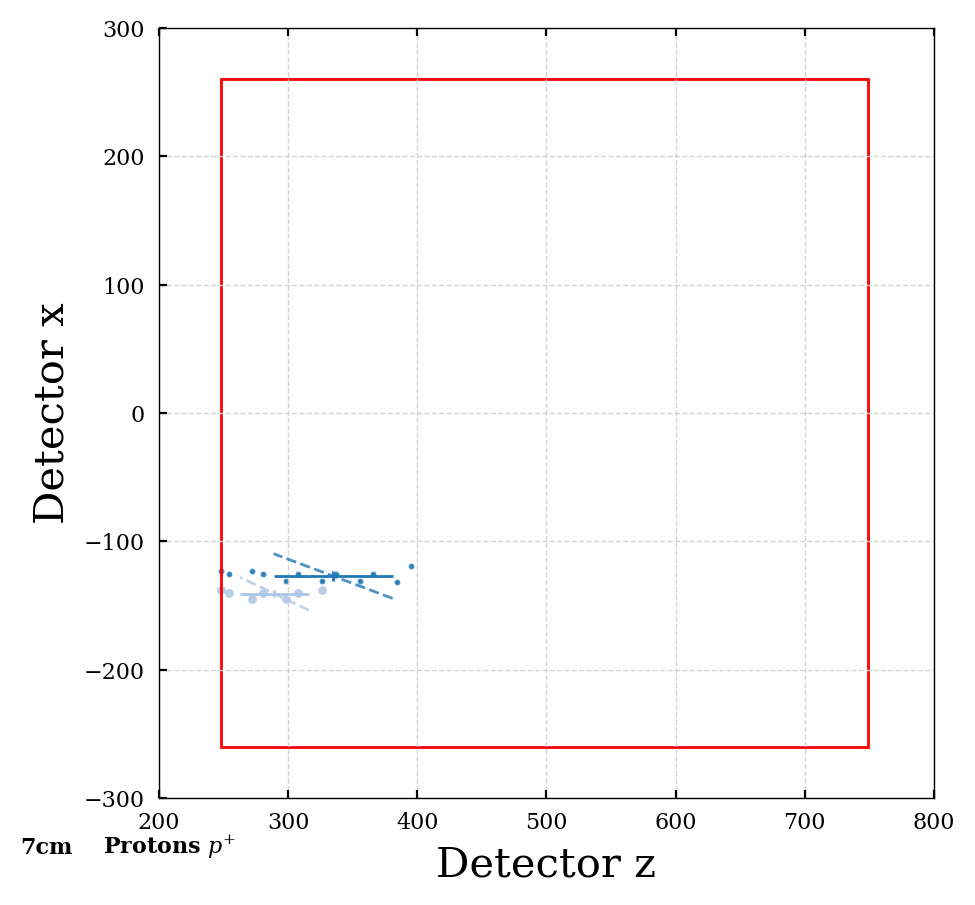

1
[75.3, 53.9]


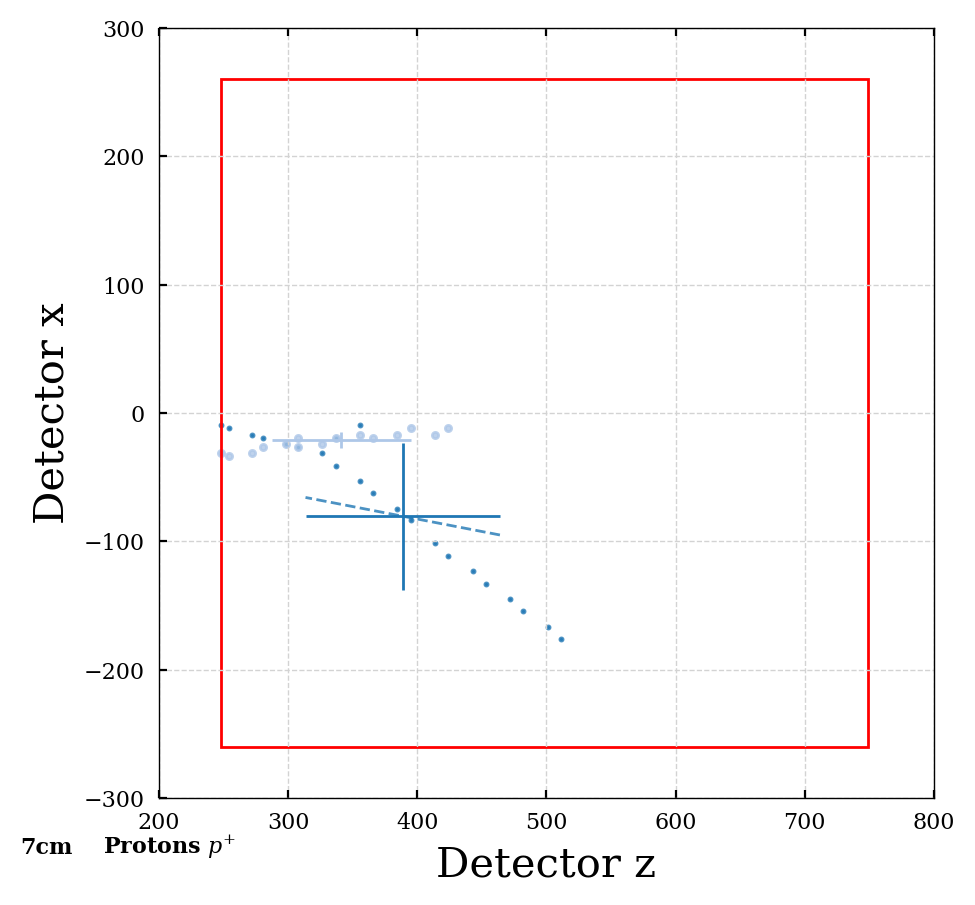

0
[20.7, 10.4]


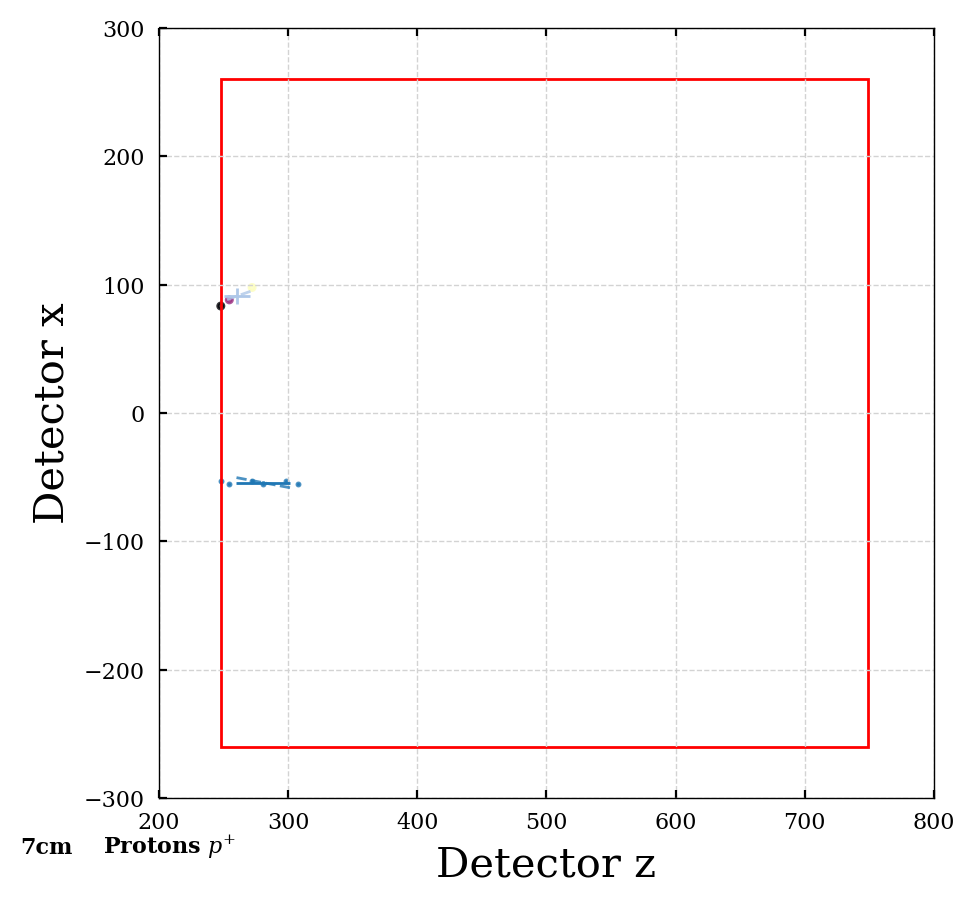

0
[38.2, 19.5]


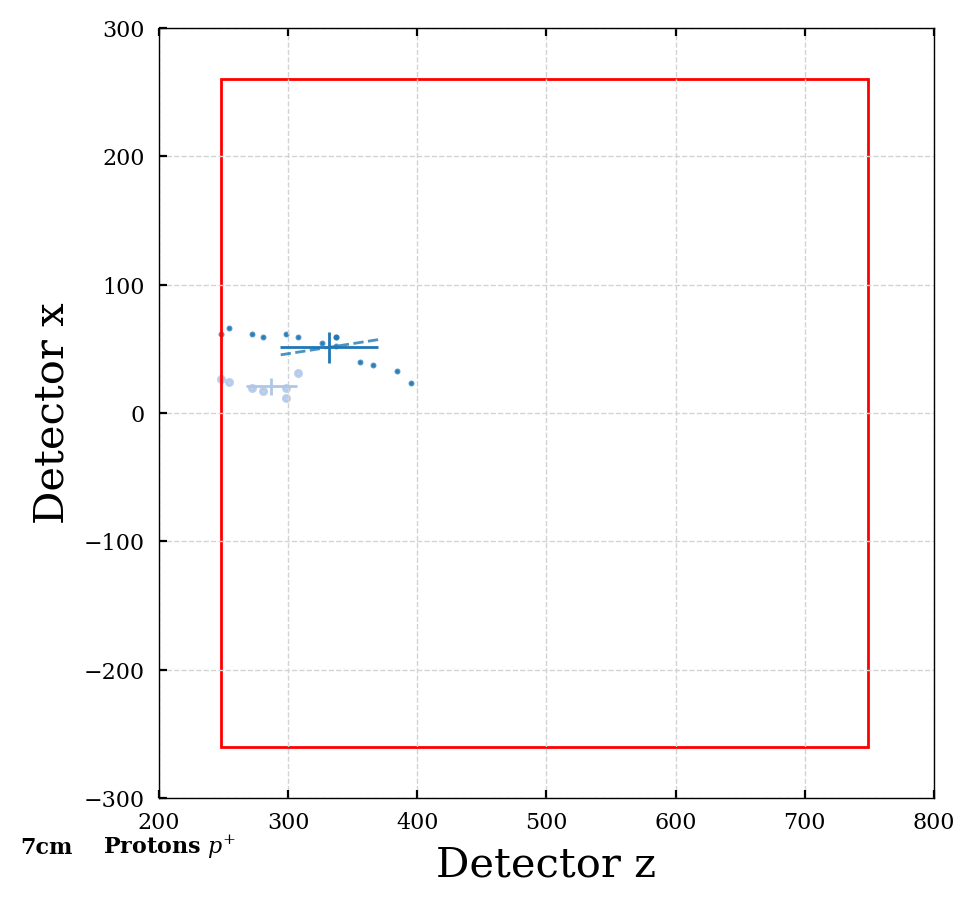

0
[21.2, 18]


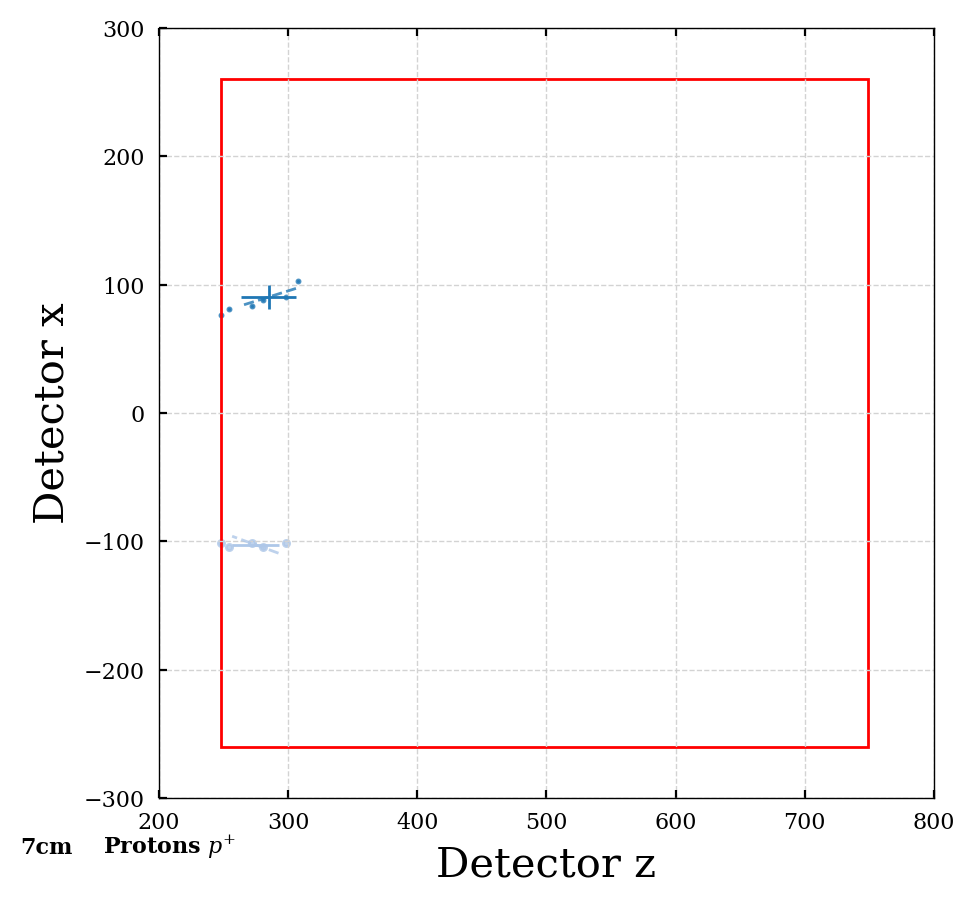

1
[107, 43.9]


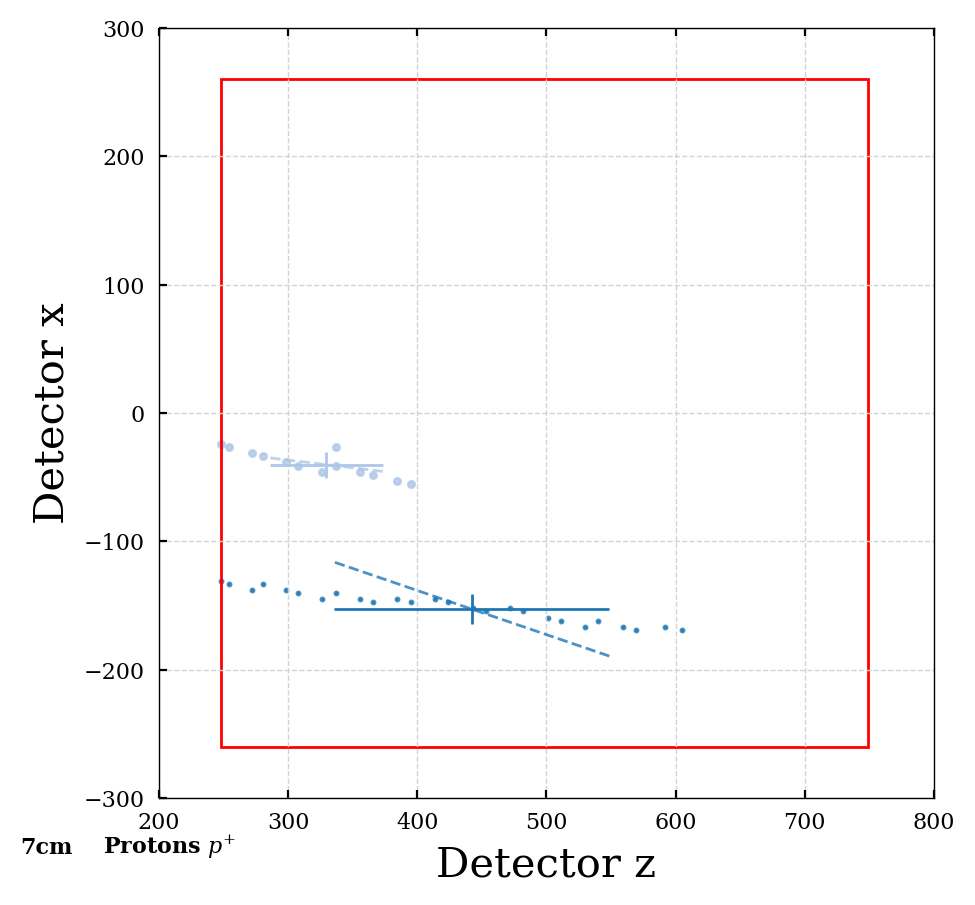

1
[77.5]


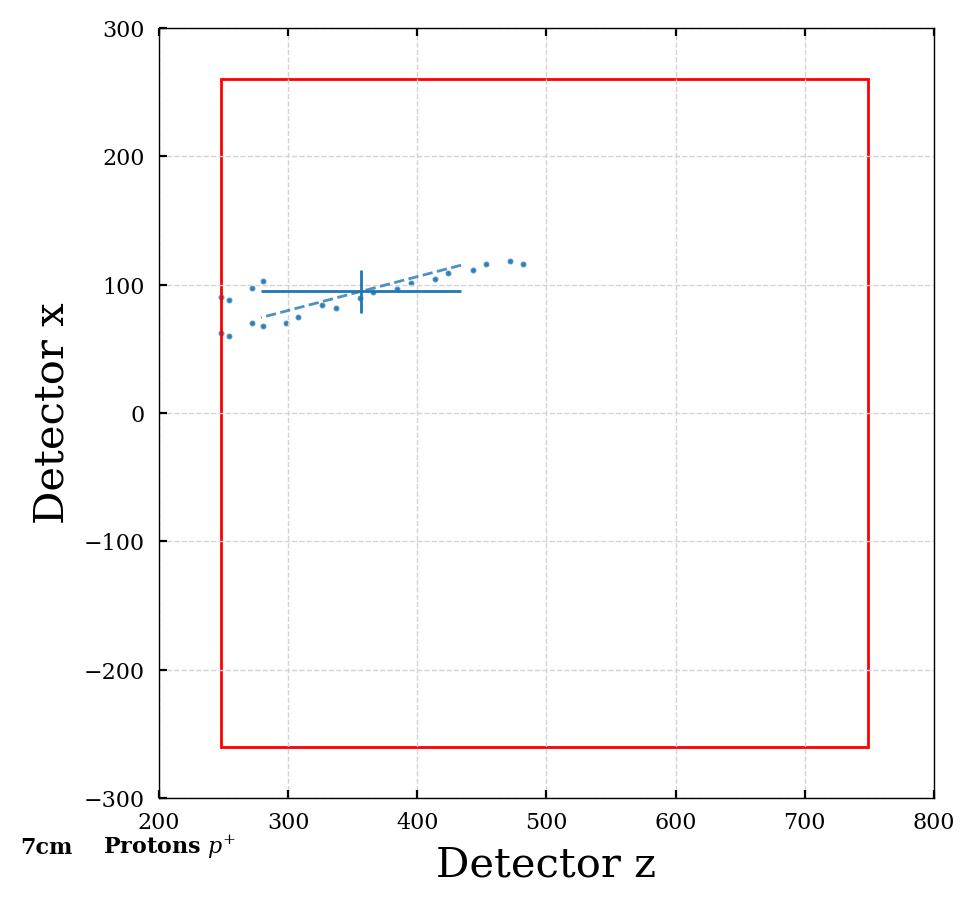

In [57]:
plot_cluster_dist(particles_dict_7cm, 7, spec_part='protons', ipart=None, xlim=1600, ylim=1500, angle_label=False)
# randomly select events
for ipart in np.random.randint(0, high=1e3, size=10, dtype=int):
    plot_cluster_dist(particles_dict_7cm, 7, spec_part='protons', ipart=ipart, xlim=800, ylim=300, angle_label=False)

# Cluster Merging Distance

$${\rm \#\ of\ clusters\ wrt.\ d_{xy}}$$

## Per cm

In [58]:
def percentile(fig, ax, X, Y, numbins=10, binwidth:float=None, floor=False, label:str=None, draw_grid=True,
               min_binsize=10, fmt='o-', style=0, color='blue', textpos=None):
    """
    The function overrides numbins if binwidth is provided
    """

    bin_min = np.nanmin(X)
    if floor:
        bin_min -= (bin_min % binwidth)
    if binwidth is not None:
        XY_bins = np.arange(start=bin_min, stop=np.nanmax(X), step=binwidth) # bins, including last element
        XY_bins = np.append(XY_bins, XY_bins[-1] + binwidth)
    else:
        XY_bins = np.linspace(bin_min, np.nanmax(X), numbins)  # bins
        binwidth = (np.nanmax(X) - bin_min) / numbins  # calculate bin width manually
    
    # define percentile functions
    def _16(arr): return np.nanquantile(arr, .159) # sigma CI
    def _84(arr): return np.nanquantile(arr, .841)
    def _05(arr): return np.nanquantile(arr, .025) # 95%, close to 2 sigma CI
    def _95(arr): return np.nanquantile(arr, .975)
    XY_avg = stats.binned_statistic(X, Y, statistic=np.nanmean, bins=XY_bins)[0] # mean
    XY_med = stats.binned_statistic(X, Y, statistic=np.nanmedian, bins=XY_bins)[0] # median
    XY_16 = stats.binned_statistic(X, Y, statistic=_16, bins=XY_bins)[0] # percentiles
    XY_84 = stats.binned_statistic(X, Y, statistic=_84, bins=XY_bins)[0]
    XY_05 = stats.binned_statistic(X, Y, statistic=_05, bins=XY_bins)[0]
    XY_95 = stats.binned_statistic(X, Y, statistic=_95, bins=XY_bins)[0]
    XY_bins_avg = [(a + b) / 2 for a, b in zip(XY_bins[::], XY_bins[1::])] # average of two consecutive elements in bins
    
    if draw_grid:
        plotting.grid()

    # plot the function depending which style is chosen
    XY_medm = XY_med - XY_16
    XY_medp = XY_84 - XY_med
    XY_rms = np.mean([XY_medm, XY_medp], axis=0)
    match style:
        case 0:
            # fills
            ax.plot(XY_bins_avg, XY_avg, c=color, ls=fmt[1:], linewidth=1.5, zorder=1, label=label)
            ax.fill_between(XY_bins_avg, XY_avg-XY_rms, XY_avg+XY_rms, color=color, edgecolor=None, alpha=0.2, zorder=1)
        case 1:
            # make line and error bar
            XY_bins_avg = [(a + b) / 2 for a, b in zip(XY_bins[::], XY_bins[1::])] # average of two consecutive elements in bins
            plotting.error_bar(fig, ax, x=XY_bins_avg, y=XY_avg, yerr=[XY_rms, XY_rms], ms=5, capsize=5, fmt=fmt, color=color, label=label)

    # scatter if smaller than bin size
    yhist, _ = np.histogram(X, bins=XY_bins) # histogram of data
    bin_num = 0 # index of x and y to scatter
    Xsortind = np.argsort(X).astype(int) # sorted versions of X and Y to graph
    Xsort = np.array(X)[Xsortind]
    Ysort = np.array(Y)[Xsortind]
    for ybin in yhist:
        if ybin <= min_binsize: # if few number of points in bin
            ax.scatter(Xsort[bin_num: bin_num+ybin], Ysort[bin_num: bin_num+ybin], s=5, alpha=0.5, color=color, zorder=2)
        bin_num += ybin

    # plot the bin size
    if textpos is not None:
        if textpos in ['auto', 'Auto', 'a', 'A']:
            textpos = [bin_min+(XY_bins[-1]-bin_min)/5, np.nanmin(Y)+(np.nanmax(Y)-np.nanmin(Y))*2/3]
        ax.hlines(y=textpos[1],
                xmin=textpos[0]-binwidth/2,
                xmax=textpos[0]+binwidth/2,
                color='black', lw=2, ls='--', zorder=2)
        ax.text(x=textpos[0], y=textpos[1]*1.02, s='Bin Size', fontsize=10, alpha=0.8, ha='center')

In [106]:
def plot_merging_dist_part(part_name='electrons', style=1, min_seps=[5, 10, 20]):
    def plot_merging_dist(fig, ax, particles, min_sep=5, color='blue'):
        # dxy
        length = len(particles.get('PFTruth_second_x'))
        xs = ak.to_numpy(particles.get('PFTruth_second_x')).astype(float).filled(np.nan).T
        ys = ak.to_numpy(particles.get('PFTruth_second_y')).astype(float).filled(np.nan).T
        dxy = np.abs(np.hypot(np.diff(xs, axis=0), np.diff(ys, axis=0))).flatten()
        
        # cluster count
        cluster_count = particles.get('PFEcalClusters_good_count')
    
        # make the plot
        print(cluster_count)
        percentile(fig, ax, dxy, cluster_count,
                   style=style, label=f'{min_sep}cm', color=color,
                   binwidth=20, min_binsize=20)

    from matplotlib import cm
    full_cmap = cm.get_cmap('tab10')
    color_list = [full_cmap(i)[:3] for i in range(full_cmap.N)]*10
    
    fig, ax = plt.subplots(figsize=(4, 3), dpi=200)
    plotting.style_ldmx(fig, ax)
    if 3 in min_seps: plot_merging_dist(fig, ax, particles_dict_3cm[part_name], 3, color=color_list[0])
    if 5 in min_seps: plot_merging_dist(fig, ax, particles_dict_5cm[part_name], 5, color=color_list[1])
    if 7 in min_seps: plot_merging_dist(fig, ax, particles_dict_7cm[part_name], 7, color=color_list[2])
    if 10 in min_seps: plot_merging_dist(fig, ax, particles_dict_10cm[part_name], 10, color=color_list[3])
    if 15 in min_seps: plot_merging_dist(fig, ax, particles_dict_15cm[part_name], 15, color=color_list[4])
    if 20 in min_seps: plot_merging_dist(fig, ax, particles_dict_20cm[part_name], 20, color=color_list[5])
    
    ax.annotate(text=labels_dict[part_name], xy=(-10, -25), xycoords='axes points', fontsize=10, weight='bold')
    ax.set_xlabel(r'$d_{xy} [mm]$', fontsize=10)
    ax.set_ylabel('Avg # of clusters', fontsize=10)
    ax.set_ylim([0.5, 2.5])
    ax.legend()
    plt.show()

[2 2 2 ... 1 2 2]
[2 2 2 ... 1 2 2]
[2 2 2 ... 2 2 2]
[2 2 2 ... 1 2 2]
[2 1 1 ... 1 1 1]
[1 1 1 ... 1 1 1]


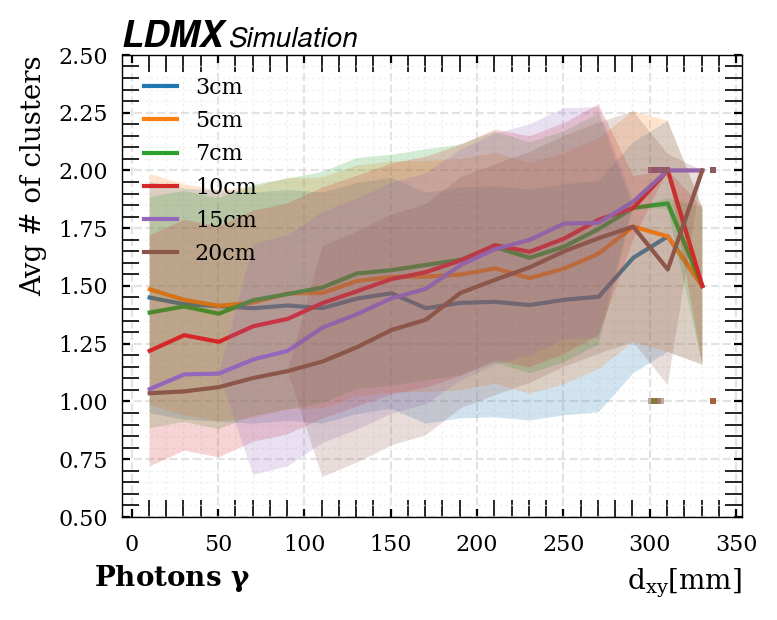

In [107]:
plot_merging_dist_part('photons', 0, [3, 5, 7, 10, 15, 20])

[0 0 0 ... 0 1 0]
[2 0 2 ... 1 2 0]
[2 1 2 ... 1 2 0]
[2 2 2 ... 1 2 1]
[1 1 1 ... 1 2 1]


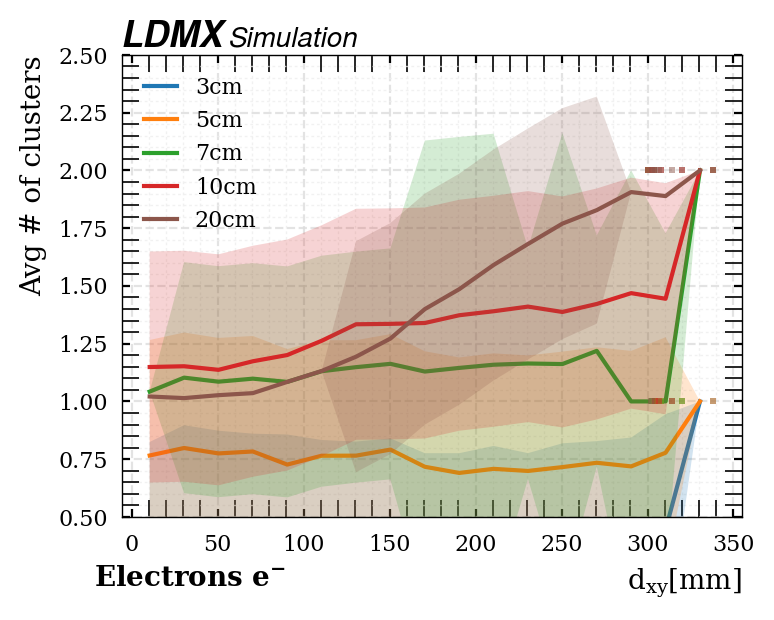

In [108]:
plot_merging_dist_part('electrons', 0, [3, 5, 7, 10, 20])

[2 1 1 ... 2 1 1]
[1 1 1 ... 1 1 1]


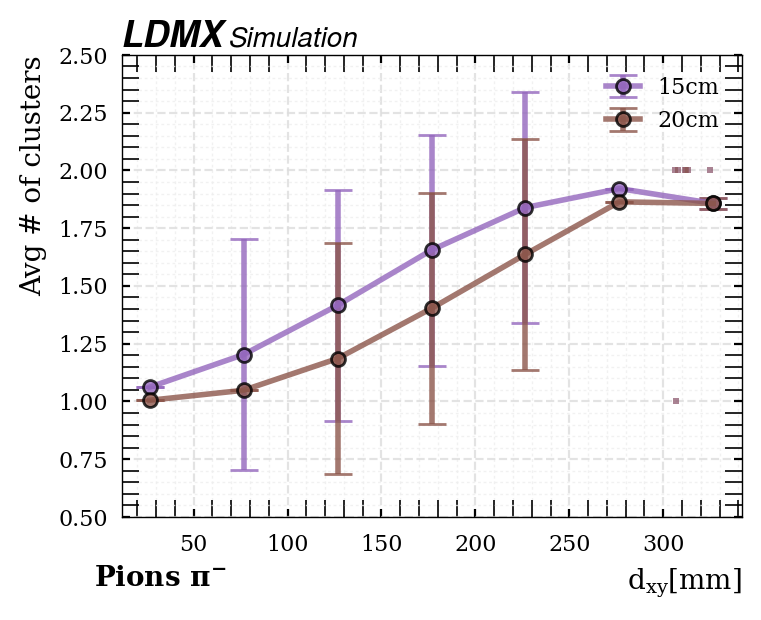

In [62]:
plot_merging_dist_part('pions', 1, [15, 20, 25])

[1 0 0 ... 2 0 1]
[2 0 0 ... 1 2 1]
[2 1 0 ... 1 1 1]


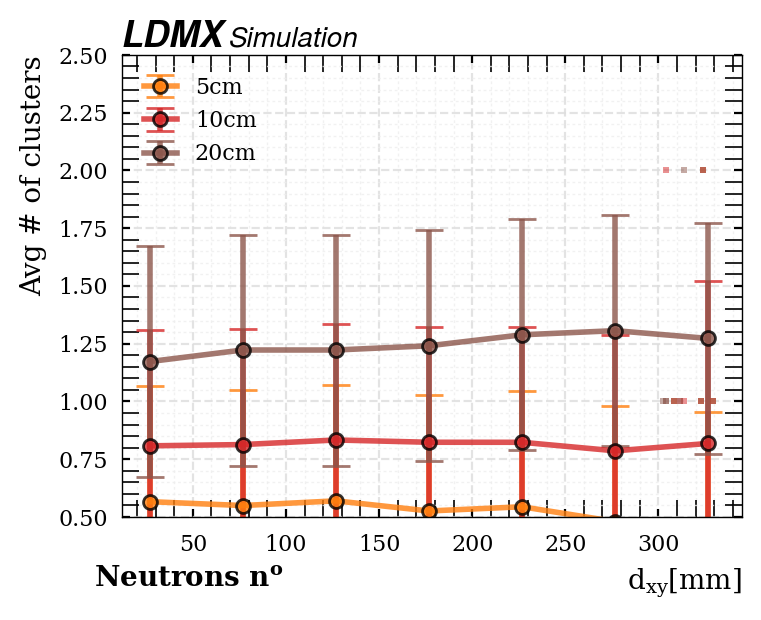

In [63]:
plot_merging_dist_part('neutrons', 1)

[0 0 1 ... 0 1 0]
[0 0 1 ... 0 1 0]
[2 0 1 ... 1 1 0]
[2 1 1 ... 2 1 0]
[1 1 1 ... 2 1 1]


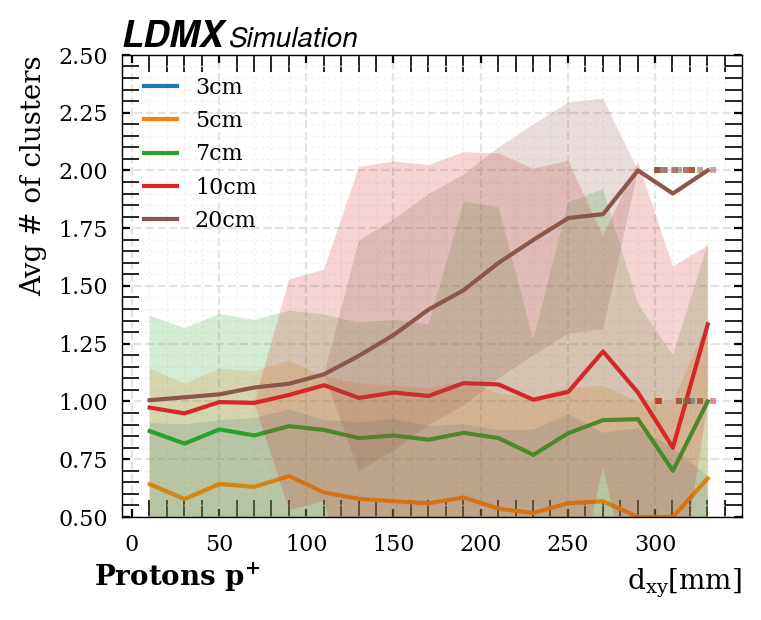

In [109]:
plot_merging_dist_part('protons', 0, [3, 5, 7, 10, 20])

## Per # of hits

In [65]:
def plot_merging_dist_part_(particles_dict=particles_dict_7cm, part_name='electrons', style=1, good_thress=[1, 3, 5, 10, 15, 20]):
    def plot_merging_dist_(fig, ax, particles, good_thres=5, color='blue'):
        # dxy
        length = len(particles.get('PFTruth_second_x'))
        xs = ak.to_numpy(particles.get('PFTruth_second_x')).astype(float).filled(np.nan).T
        ys = ak.to_numpy(particles.get('PFTruth_second_y')).astype(float).filled(np.nan).T
        dxy = np.abs(np.hypot(np.diff(xs, axis=0), np.diff(ys, axis=0))).flatten()
        
        # cluster count
        good_clusters_count = []  # good cluster count
        for clusters_nhits in particles.get('PFEcalClusters_nHits'):
            if np.any(clusters_nhits):
                num_clusters = len(clusters_nhits)
                num_good_clusters = np.sum(clusters_nhits >= good_thres)
                good_clusters_count.append(num_good_clusters)
            else:
                good_clusters_count.append(0)  # no clusters
    
        # make the plot
        percentile(fig, ax, dxy, good_clusters_count,
                   style=style, label=f'Good clust = {good_thres}', color=color,
                   binwidth=20, min_binsize=20)

    from matplotlib import cm
    full_cmap = cm.get_cmap('tab10')
    color_list = [full_cmap(i)[:3] for i in range(full_cmap.N)]*10
    
    fig, ax = plt.subplots(figsize=(4, 3), dpi=200)
    plotting.style_ldmx(fig, ax)
    
    for i, good_thres in enumerate(good_thress):
        plot_merging_dist_(fig, ax, particles_dict[part_name], good_thres, color=color_list[i])

    if particles_dict == particles_dict_3cm:
        sep=3
    elif particles_dict == particles_dict_5cm:
        sep=5
    elif particles_dict == particles_dict_7cm:
        sep=7
    elif particles_dict == particles_dict_10cm:
        sep=10
    elif particles_dict == particles_dict_15cm:
        sep=15
    elif particles_dict == particles_dict_20cm:
        sep=20
    ax.annotate(text=f'{labels_dict[part_name]} {sep}cm', xy=(-10, -25), xycoords='axes points', fontsize=10, weight='bold')
    ax.set_xlabel(r'$d_{xy} [mm]$', fontsize=10)
    ax.set_ylabel('Avg # of clusters', fontsize=10)
    ax.set_ylim([0.5, 2.5])
    ax.legend()
    plt.show()

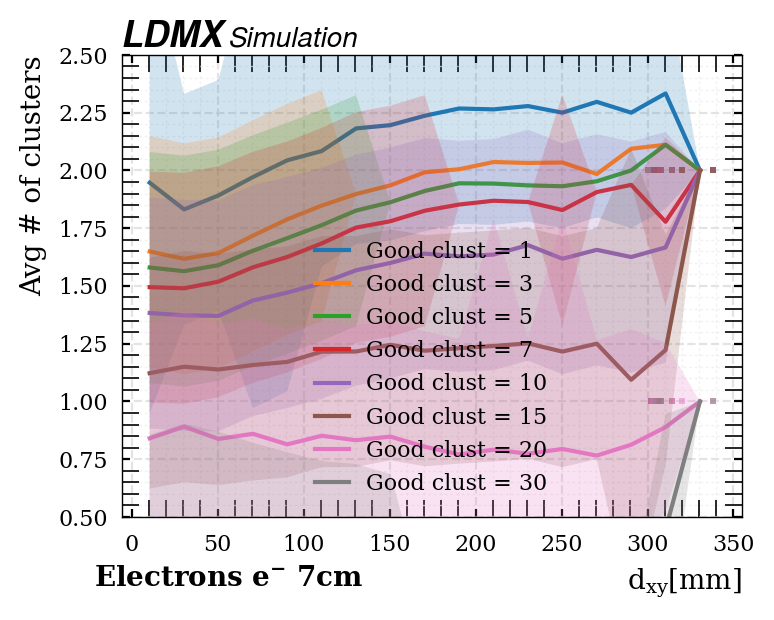

In [66]:
plot_merging_dist_part_(particles_dict_7cm, 'electrons', 0, [1, 3, 5, 7, 10, 15, 20, 30])

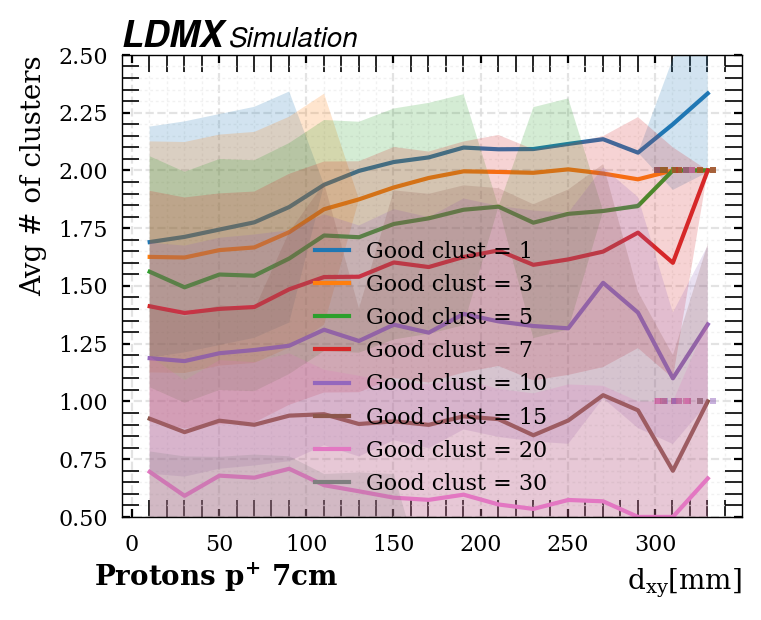

In [67]:
plot_merging_dist_part_(particles_dict_7cm, 'protons', 0, [1, 3, 5, 7, 10, 15, 20, 30])

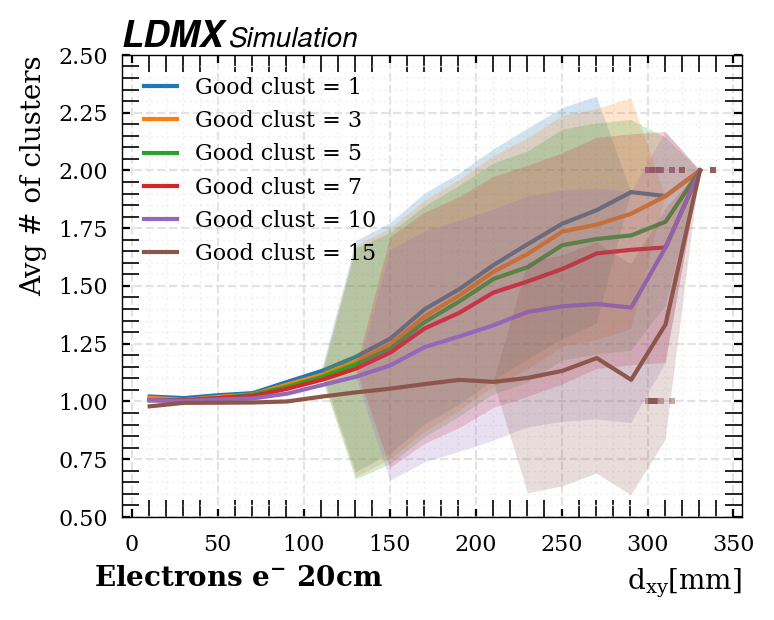

In [68]:
plot_merging_dist_part_(particles_dict_20cm, 'electrons', 0, [1, 3, 5, 7, 10, 15])

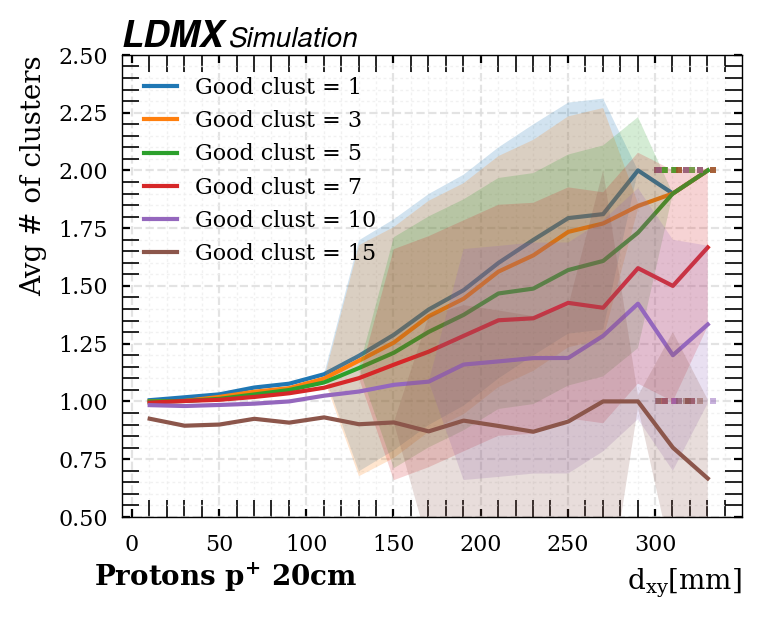

In [69]:
plot_merging_dist_part_(particles_dict_20cm, 'protons', 0, [1, 3, 5, 7, 10, 15])

# Good Cluster Energy

$$E_{\rm clust} / E_{\rm cal} \ {\rm wrt.} \ d_{xy}$$

In [70]:
particles_dict_20cm['electrons'].get('PFHcalClusters_energy')
particles_dict_20cm['electrons'].get('PFTruth_second_x')
a = (particles_dict_20cm['electrons'].get('PFHcalClusters_nHits') > 8)
b = ~a
ak.sum(ak.any([a, b], axis=0), axis=1)

<Array [0, 0, 0, 0, 0, 0, 1, 1, ..., 0, 0, 0, 0, 0, 1, 0] type='9214 * int64'>

In [115]:
def plot_goodclust_erg_part(part_name='electrons', style=1, min_seps=[5, 10, 20]):
    def plot_goodclust_erg(fig, ax, particles, min_sep=5, color='blue', good_cluster_crit=10):
        # truth positions
        length = len(particles.get('PFTruthEcal_x'))
        xs = ak.to_numpy(particles.get('PFTruthEcal_x')).astype(float).filled(np.nan).T
        ys = ak.to_numpy(particles.get('PFTruthEcal_y')).astype(float).filled(np.nan).T
        # dxy
        dxy = np.abs(np.hypot(np.diff(xs, axis=0), np.diff(ys, axis=0))).flatten()
        
        # truth info of each particle of x and y coordinates
        x1, x2 = xs
        y1, y2 = ys

        # projection
        ecal_clusterZ = particles.get('PFEcalClusters_centroidZ')
        ecal_clusterX = particles.get('PFEcalClusters_centroidX')
        ecal_clusterDXDZ = particles.get('PFEcalClusters_DXDZ')
        ecal_clusterY = particles.get('PFEcalClusters_centroidY')
        ecal_clusterDYDZ = particles.get('PFEcalClusters_DYDZ')
        # projected from each cluster
        truthz = particles.get('PFTruthEcal_z')[0][0]  # the z position to map onto
        proj_x = ecal_clusterX - (ecal_clusterZ - truthz) * ecal_clusterDXDZ
        proj_y = ecal_clusterY - (ecal_clusterZ - truthz) * ecal_clusterDYDZ

        # distance and cluster membership
        dist_1 = np.abs(np.hypot(proj_x - x1, proj_y - y1))
        dist_2 = np.abs(np.hypot(proj_x - x2, proj_y - y2))
        clust_member = np.where(dist_1 <= dist_2, 1, 2)  # cluster membership determination
        
        # mask the particles by cluster
        # good clusters mask
        good_mask = (particles.get('PFEcalClusters_nHits') >= good_cluster_crit)
        # cluster members
        clust1_mask = (clust_member == 1)
        clust2_mask = (clust_member == 2)
        clust1_erg = ak.sum(particles.get('PFEcalClusters_energy')[ak.all([good_mask, clust1_mask], axis=0)], axis=1)
        clust2_erg = ak.sum(particles.get('PFEcalClusters_energy')[ak.all([good_mask, clust2_mask], axis=0)], axis=1)

        # sort the two by energy
        clust1_erg, clust2_erg = np.sort([clust1_erg, clust2_erg], axis=0)[::-1]
        
        # calorimeter energy
        calo_erg = particles.get('EcalTotalEnergy')
    
        # make the plot
        percentile(fig, ax, dxy, (clust1_erg/calo_erg)*100,
                   style=style, label=f'{min_sep}cm', color=color,
                   binwidth=20, min_binsize=20)
        percentile(fig, ax, dxy, (clust2_erg/calo_erg)*100,
                   style=style, label='', color=color,
                   binwidth=20, min_binsize=20)
    
    from matplotlib import cm
    full_cmap = cm.get_cmap('tab10')
    color_list = [full_cmap(i)[:3] for i in range(full_cmap.N)]*10
    
    fig, ax = plt.subplots(figsize=(4, 3), dpi=200)
    plotting.style_ldmx(fig, ax)
    if 3 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_3cm[part_name], 3, color=color_list[0], good_cluster_crit=good_cluster_crit_dict[3])
    if 5 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_5cm[part_name], 5, color=color_list[1], good_cluster_crit=good_cluster_crit_dict[5])
    if 7 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_7cm[part_name], 7, color=color_list[2], good_cluster_crit=good_cluster_crit_dict[7])
    if 10 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_10cm[part_name], 10, color=color_list[3], good_cluster_crit=good_cluster_crit_dict[10])
    if 15 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_15cm[part_name], 15, color=color_list[4], good_cluster_crit=good_cluster_crit_dict[15])
    if 20 in min_seps: plot_goodclust_erg(fig, ax, particles_dict_20cm[part_name], 20, color=color_list[5], good_cluster_crit=good_cluster_crit_dict[20])
    
    ax.annotate(text=labels_dict [part_name], xy=(-60, -10), xycoords='axes points', fontsize=10, weight='bold')
    ax.set_xlabel(r'$d_{xy} [mm]$', fontsize=10)
    ax.set_ylabel(r'$E_{\rm clust} / E_{\rm calo} \%$', fontsize=10)
    ax.set_ylim([0, 100])
    ax.legend()
    plt.show()

In [72]:
partParam = "830.250.250.0"
partParam.split('.')[0]

'830'

In [73]:
clusTag = '.5.3cm'
clusTag[:-2].split('.')[1]
clusTag[:-2].split('.')[2]

'3'

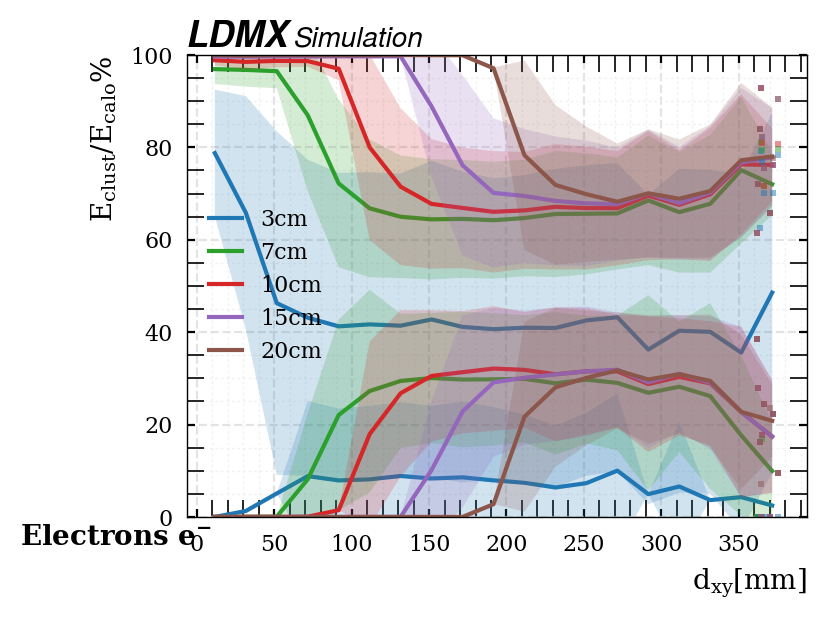

In [116]:
plot_goodclust_erg_part('electrons', 0, [3, 7, 10, 15, 20])

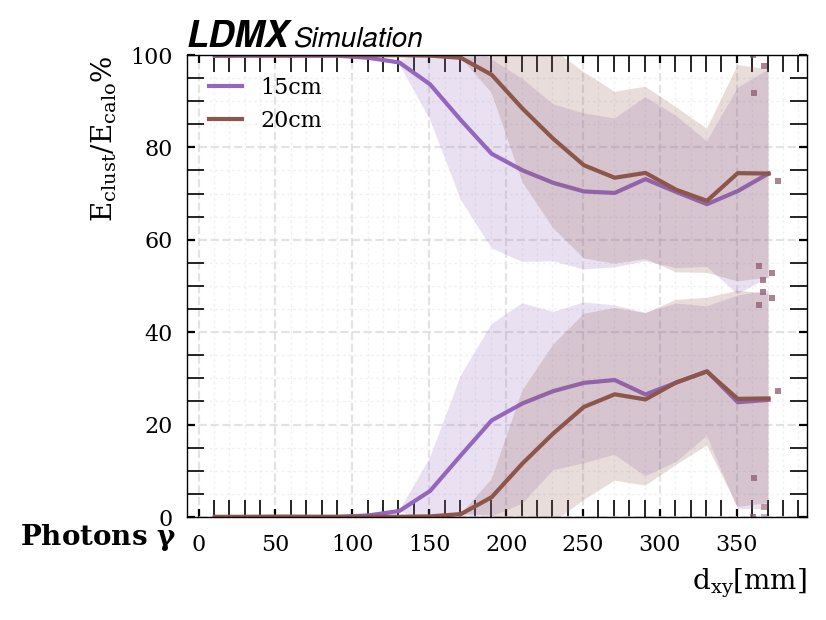

In [75]:
plot_goodclust_erg_part('photons', 0, [15, 20, 25])

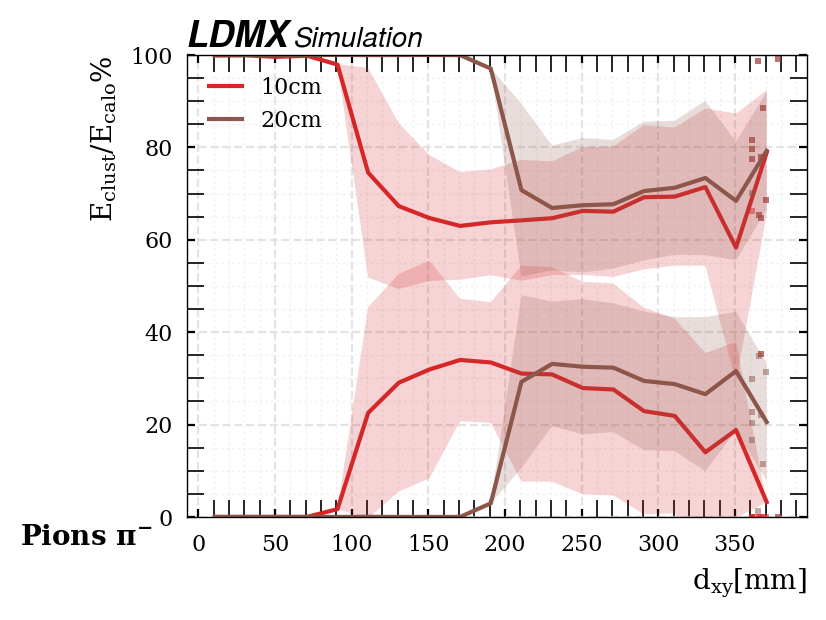

In [76]:
plot_goodclust_erg_part('pions', 0, [10, 20])

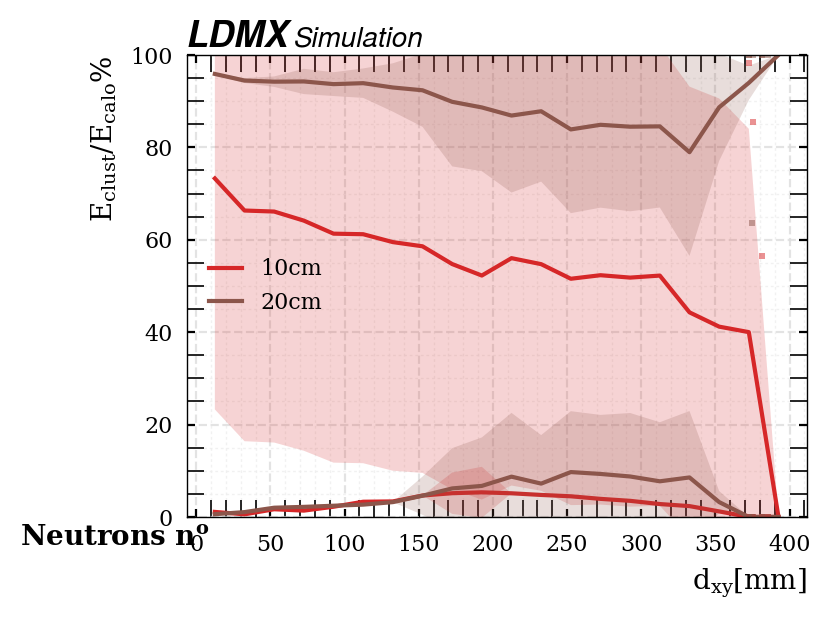

In [77]:
plot_goodclust_erg_part('neutrons', 0, [10, 20])

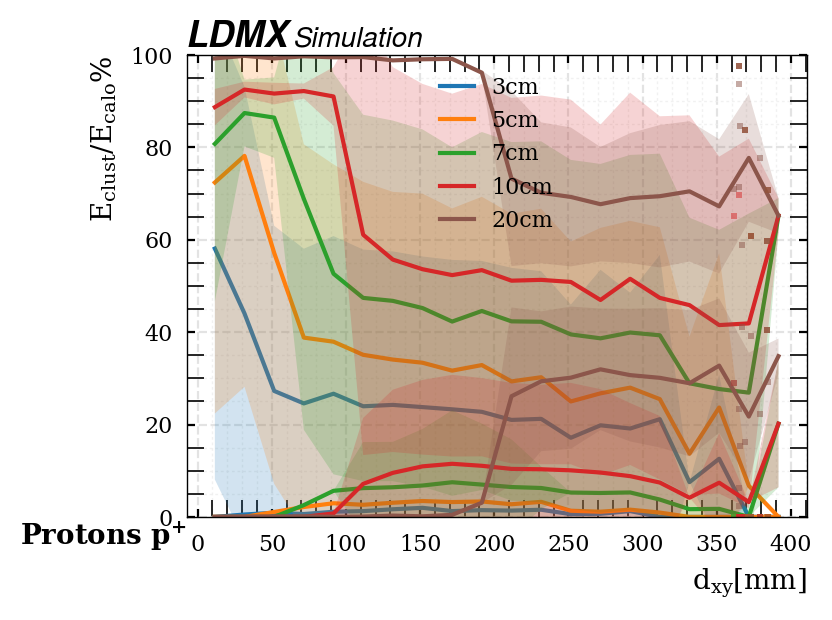

In [78]:
plot_goodclust_erg_part('protons', 0, [3, 5, 7, 10, 20])

# Energy Proportion of Cluster / Calorimeter

In [110]:
# the dictionary of minimum hits
good_cluster_crit_dict = {
    3:15,
    5:15,
    7:7,  # the first one good for protons
    10:5,
    15:5,
    20:1
}

In [111]:
def plot_cluster_erg(particles_dict=particles_dict_5cm, min_sep=5, figsize=(5, 3), cmap='tab10', fs=8, ylim=100, text=False):

    fig1, ax1 = plt.subplots(figsize=figsize, dpi=200)
    fig2, ax2 = plt.subplots(figsize=figsize, dpi=200)
    fig3, ax3 = plt.subplots(figsize=figsize, dpi=200)
    ax1.grid(visible=False)
    ax2.grid(visible=False)
    ax3.grid(visible=False)
    labels_list = []
    ecal_max_erg_list = []
    for i, particles in enumerate(particles_name_list):
        # for each particle in the list
        # energy bins
        from matplotlib import cm
        

        ecal_max_erg = particles_dict[particles].get('PFEcalClusters_energy_lc')
        ecal_sum_erg = [np.nansum(_) for _ in particles_dict[particles].get('PFEcalClusters_energy')]
        # good cluster energy
        ecal_good_erg = [np.nansum(_) for _ in particles_dict[particles].get('PFEcalClusters_energy')[particles_dict[particles].get('PFEcalClusters_nHits') >= good_cluster_crit_dict[min_sep]]]
        ecal_tot_erg = particles_dict[particles].get('EcalTotalEnergy')

        avg_frac_max = np.nanmean(ecal_max_erg/ecal_tot_erg)
        std_frac_max = np.nanstd(ecal_max_erg/ecal_tot_erg)

        avg_frac_sum = np.nanmean(ecal_sum_erg/ecal_tot_erg)
        std_frac_sum = np.nanstd(ecal_sum_erg/ecal_tot_erg)

        avg_frac_good = np.nanmean(ecal_good_erg/ecal_tot_erg)
        std_frac_good = np.nanstd(ecal_good_erg/ecal_tot_erg)
        
        ax1.bar(i, avg_frac_max * 100, yerr=std_frac_max*100, ec='black', lw=0.2, capsize=10, error_kw={'elinewidth':0.5,'capthick':0.5}, align='center', width=1, alpha=0.8)
        ax1.text(i, 1, f'{avg_frac_max * 100:.1f}', ha="center", va="bottom", fontsize=10)
        ecal_max_erg_list.append(f'{np.nanmean(ecal_max_erg):.2f}')
        labels_list.append(labels_dict[particles])

        ax2.bar(i, avg_frac_good * 100, yerr=std_frac_good*100, ec='black', lw=0.2, capsize=10, error_kw={'elinewidth':0.5,'capthick':0.5}, align='center', width=1, alpha=0.8)
        ax2.text(i, 1, f'{avg_frac_good * 100:.1f}', ha="center", va="bottom", fontsize=10)
        
        ax3.bar(i, avg_frac_sum * 100, yerr=std_frac_sum*100, ec='black', lw=0.2, capsize=10, error_kw={'elinewidth':0.5,'capthick':0.5}, align='center', width=1, alpha=0.8)
        ax3.text(i, 1, f'{avg_frac_sum * 100:.1f}', ha="center", va="bottom", fontsize=10)


    # labels
    if text:
         # legend
        ax1.bar(0, 0, color='None', ec='None', label='ECal Energy')
        rects = ax1.patches
        for rect, label in zip(rects, ecal_max_erg_list):
            height = rect.get_height()
            ax1.text(rect.get_x() + rect.get_width() / 2, height, label, ha="center", va="bottom")
        ax1.legend()

    ax1.annotate(text=f'{min_sep}cm samples', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
    ax1.set_ylim(0, ylim)
    ax1.set_xticks(range(len(particles_name_list)))
    ax1.set_xticklabels(labels_list, fontsize=8)
    ax1.set_xlabel('Particles', fontsize=10)
    ax1.set_ylabel('% of energy in lead clust', fontsize=10)

    ax2.annotate(text=f'{min_sep}cm samples', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
    ax2.set_ylim(0, ylim)
    ax2.set_xticks(range(len(particles_name_list)))
    ax2.set_xticklabels(labels_list, fontsize=8)
    ax2.set_xlabel('Particles', fontsize=10)
    ax2.set_ylabel('% of energy in GOOD clust', fontsize=10)

    ax3.annotate(text=f'{min_sep}cm samples', xy=(-50, -20), xycoords='axes points', fontsize=8, weight='bold')
    ax3.set_ylim(0, ylim)
    ax3.set_xticks(range(len(particles_name_list)))
    ax3.set_xticklabels(labels_list, fontsize=8)
    ax3.set_xlabel('Particles', fontsize=10)
    ax3.set_ylabel('% of energy in ALL clust', fontsize=10)

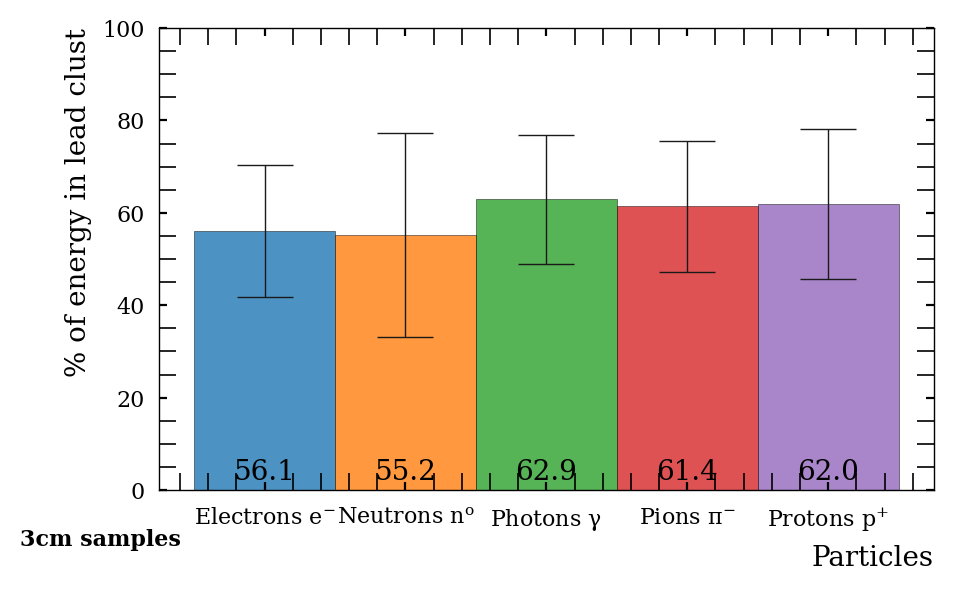

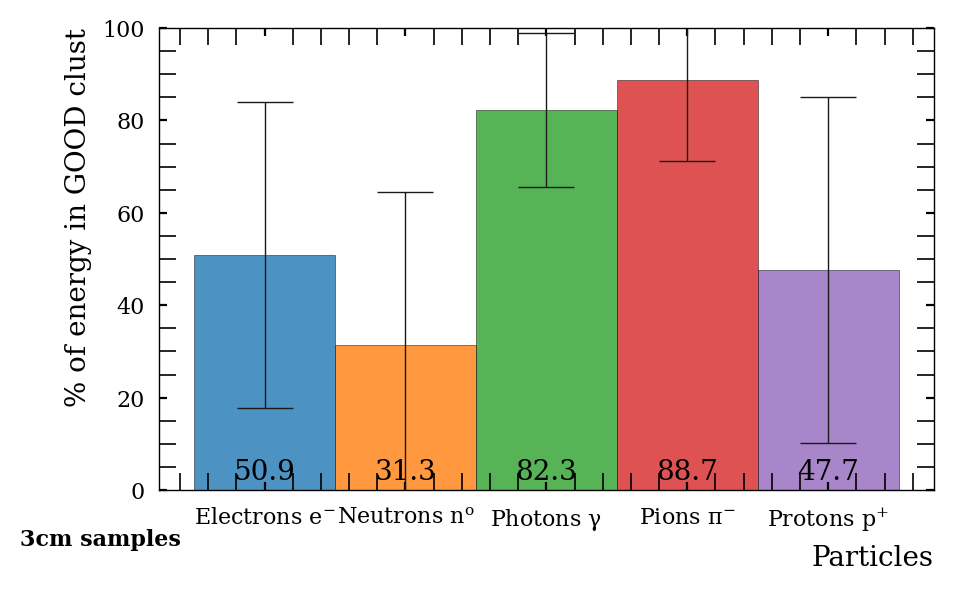

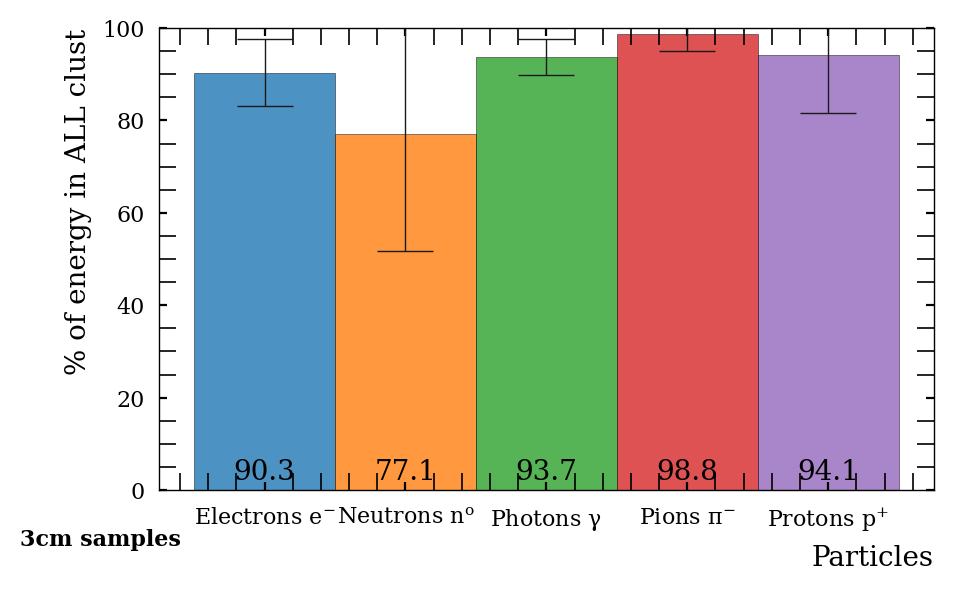

In [112]:
plot_cluster_erg(particles_dict_3cm, 3, (5, 3), 'tab10', fs=5)
plt.show()

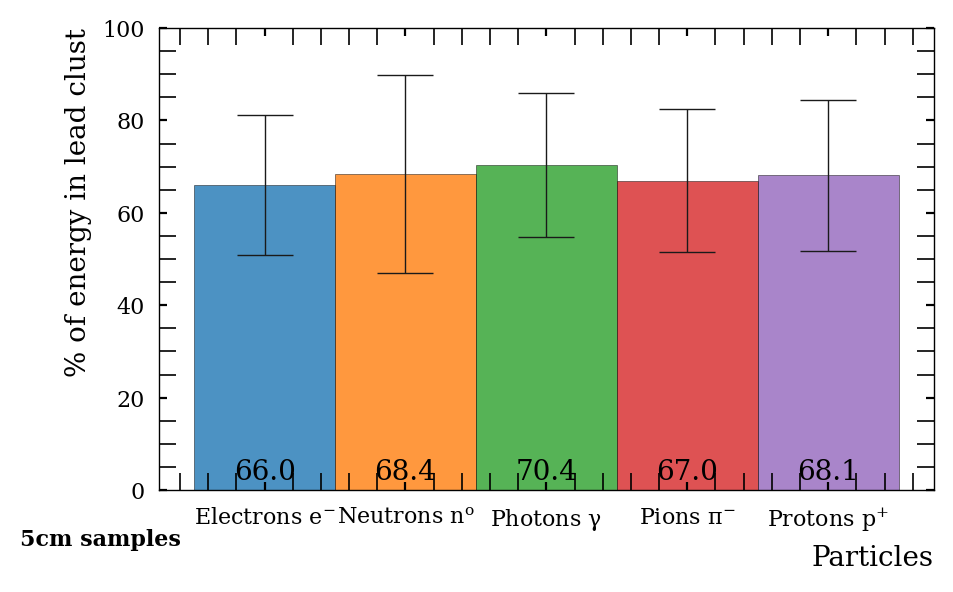

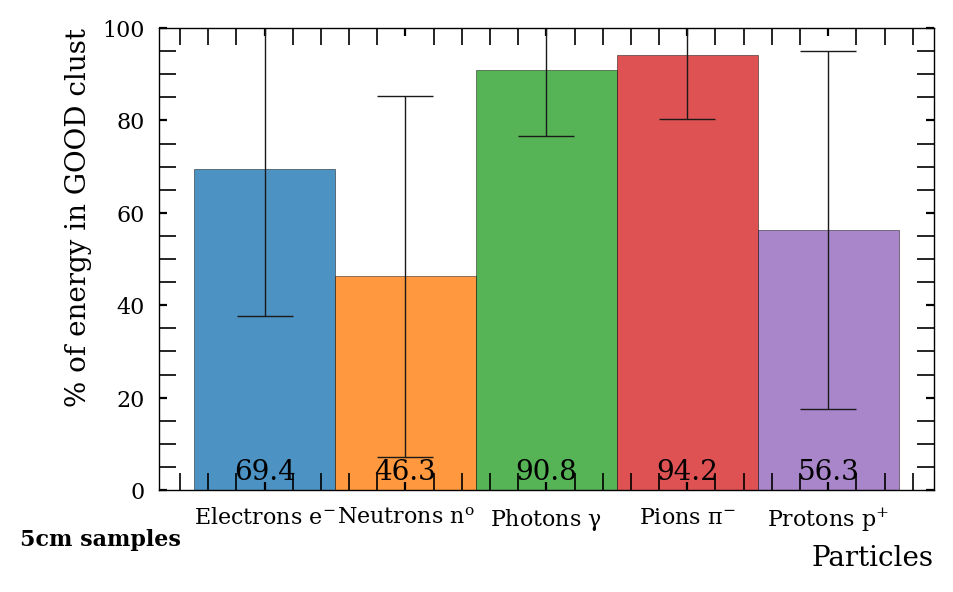

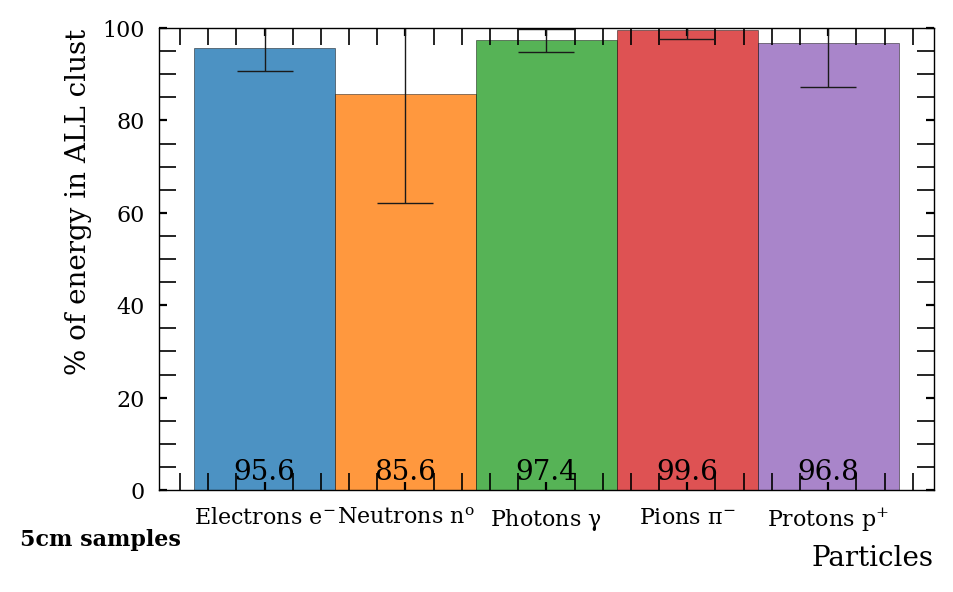

In [114]:
plot_cluster_erg(particles_dict_5cm, 5, (5, 3), 'tab10', fs=5)
plt.show()

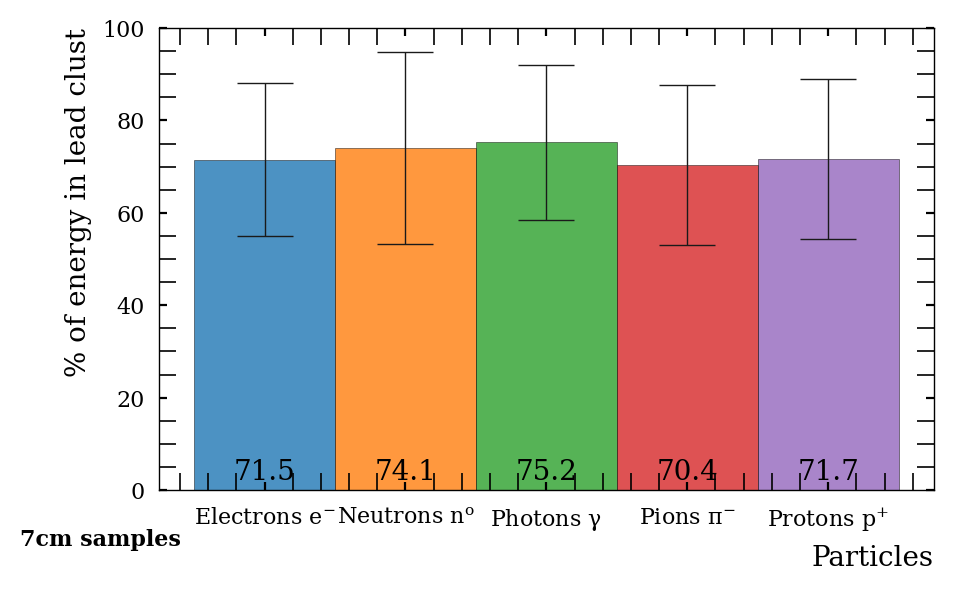

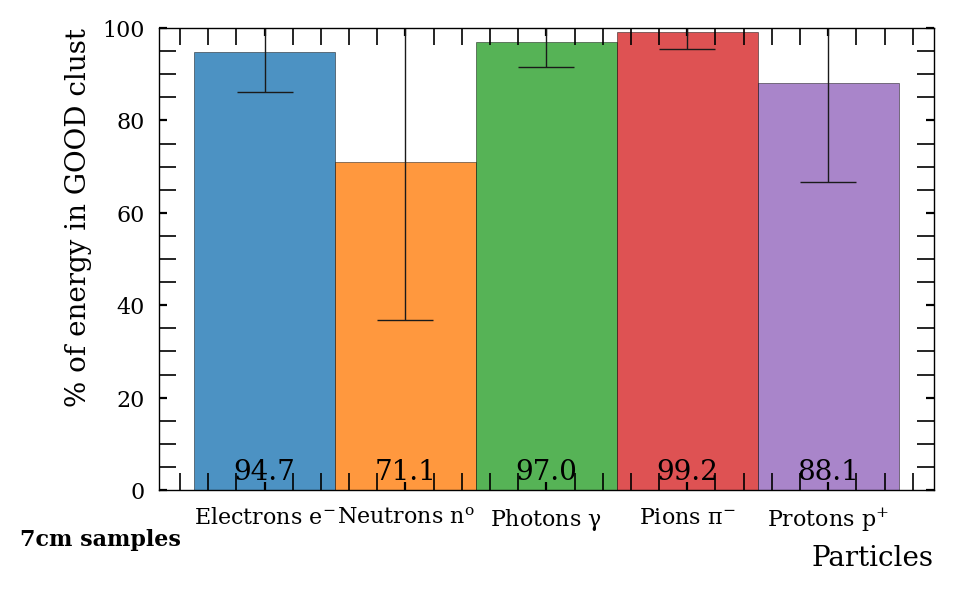

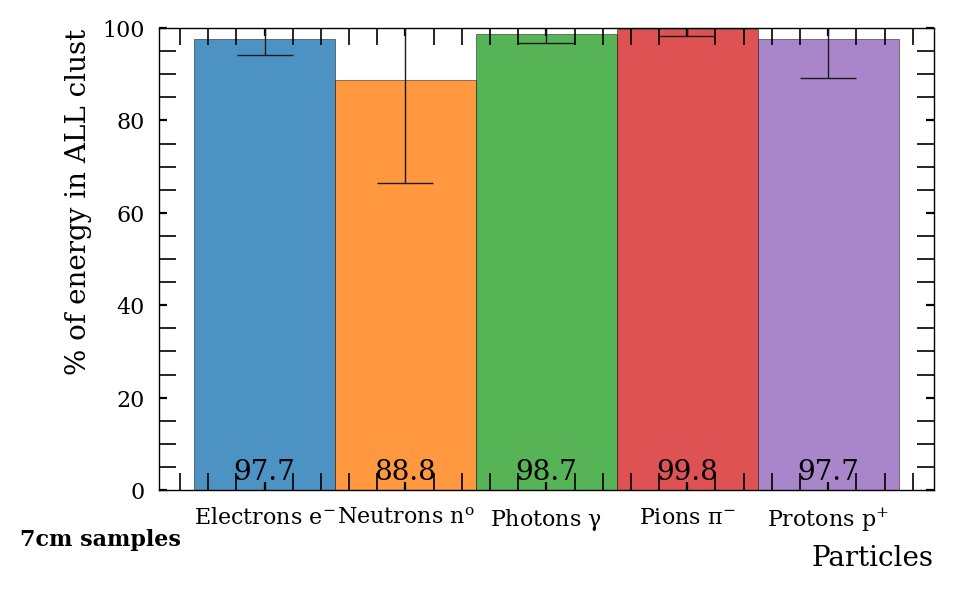

In [113]:
plot_cluster_erg(particles_dict_7cm, 7, (5, 3), 'tab10', fs=5)
plt.show()

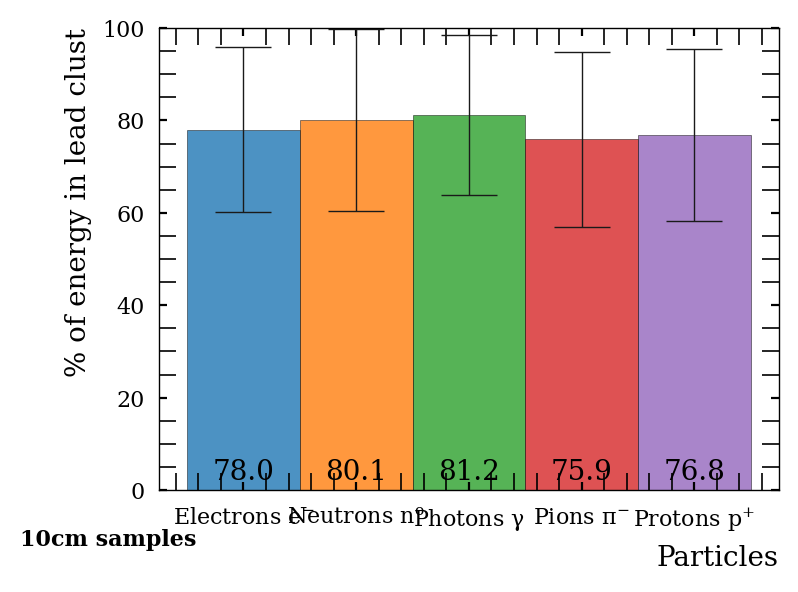

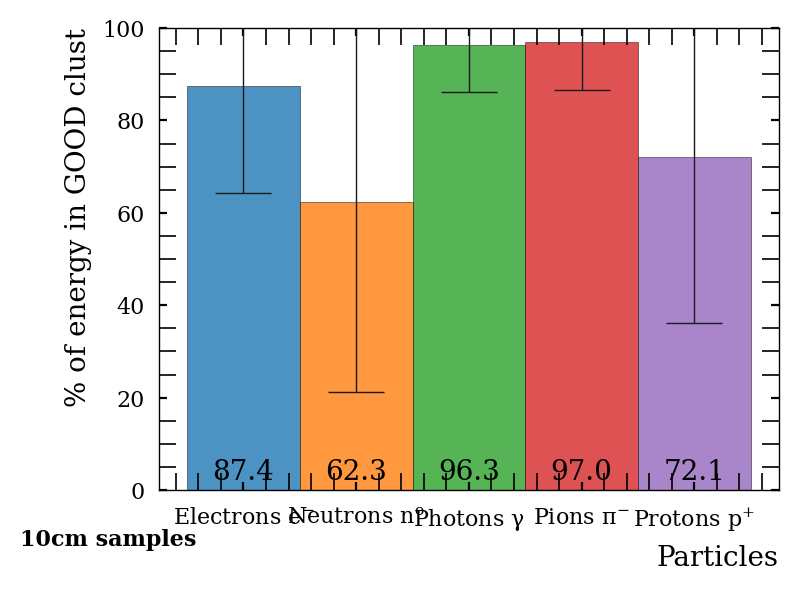

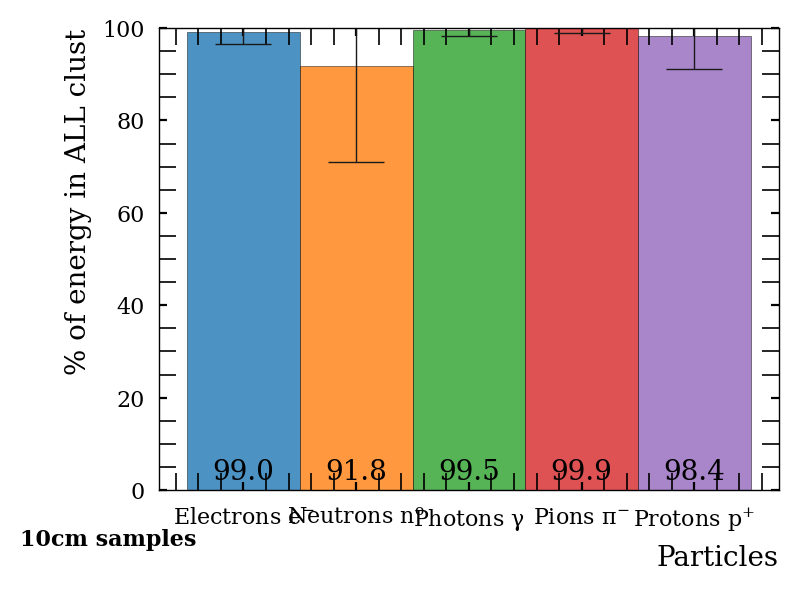

In [83]:
plot_cluster_erg(particles_dict_10cm, 10, (4, 3), 'tab10', fs=5)
plt.show()

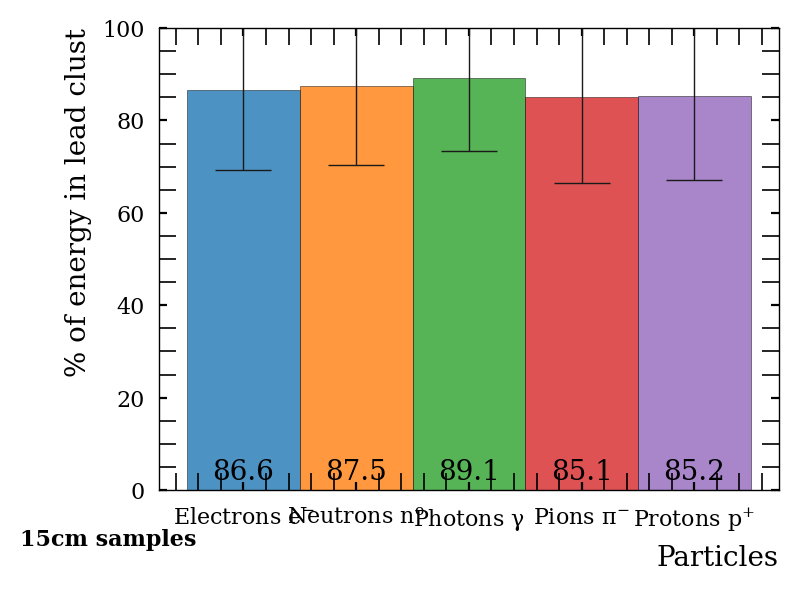

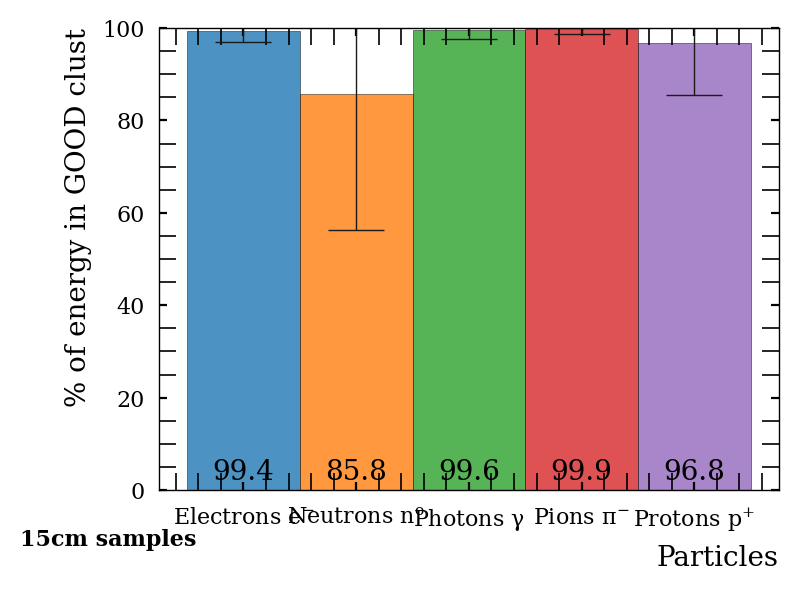

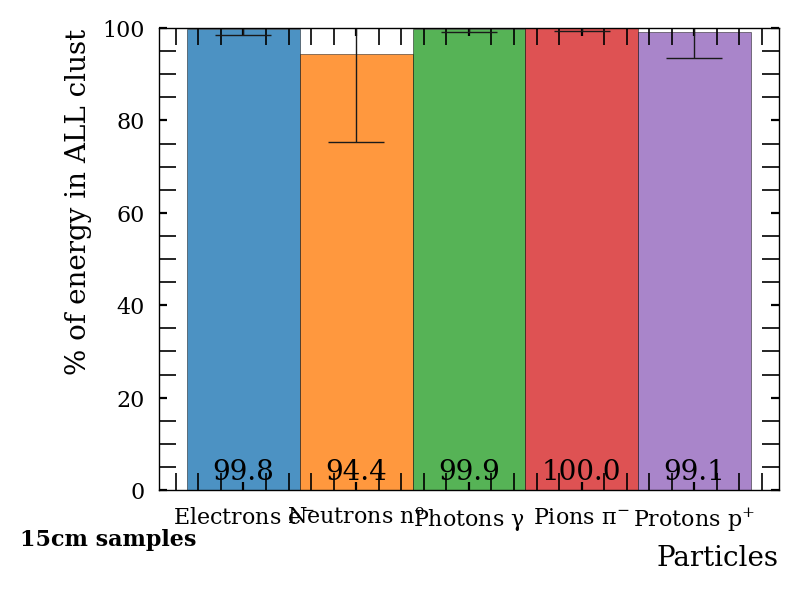

In [84]:
plot_cluster_erg(particles_dict_15cm, 15, (4, 3), 'tab10', fs=5)
plt.show()

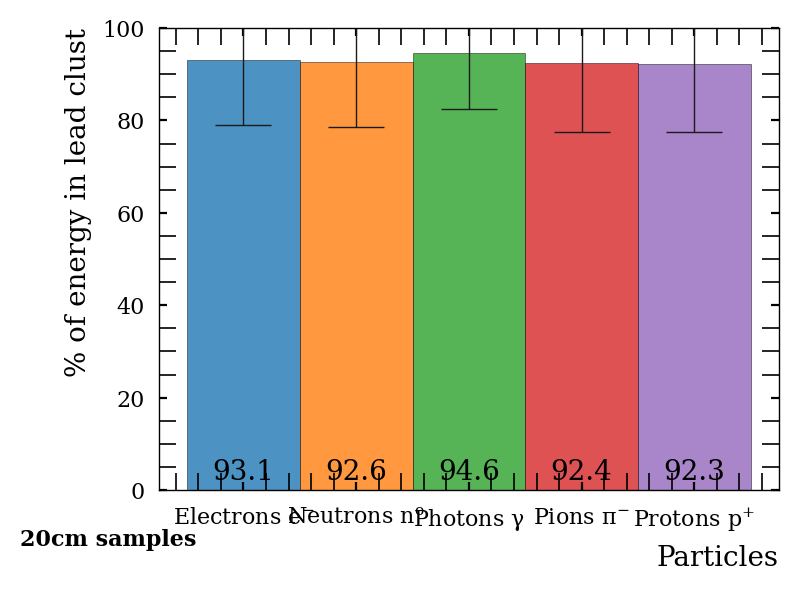

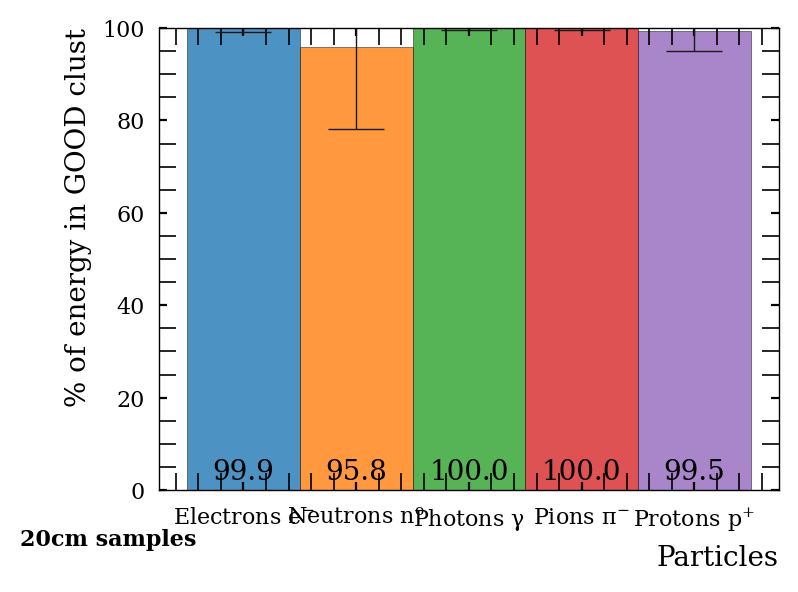

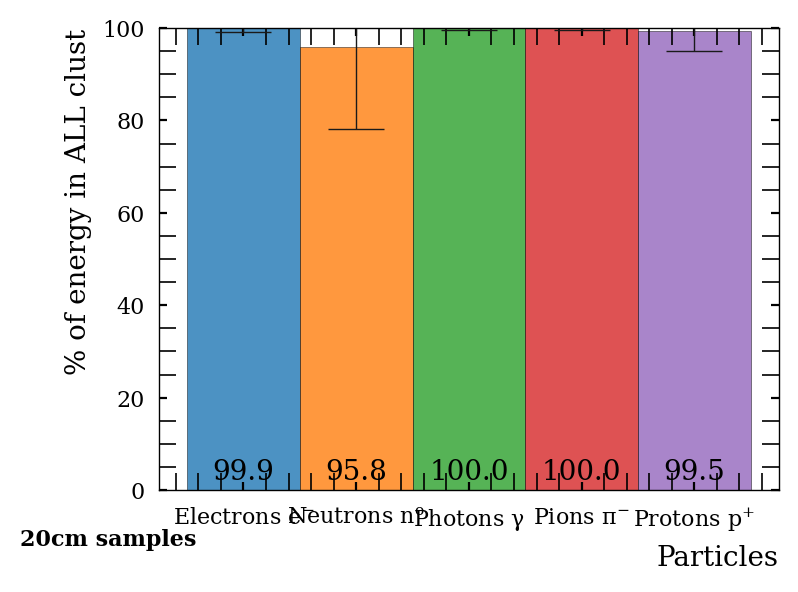

In [85]:
plot_cluster_erg(particles_dict_20cm, 20, (4, 3), 'tab10', fs=5)
plt.show()